In [81]:
sns.set()  #Set aesthetic parameters in one step.
import datetime #datetime in Python is the combination between dates and times.
import numpy as np #NumPy is the fundamental package for scientific computing in Python. 
import pandas as pd #pandas is a fast, powerful, flexible and easy to use open source data analysis and manipulation tool
import seaborn as sns #Seaborn is a Python data visualization library based on matplotlib.
import tensorflow as tf #TensorFlow is an open-source end-to-end framework for building Machine Learning apps.
from simple_colors import * # to print colored , bolded and underlined text
from tensorflow import keras#Keras is a high-level, deep learning API developed by Google for implementing neural networks.
import matplotlib.pyplot as plt #Is a comprehensive library for creating static, animated, and interactive visualizations.
from keras.regularizers import l2 
from keras.models import Sequential
# sklearn is an open source data analysis library, and the gold standard for Machine Learning (ML) in the Python ecosystem.
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from tensorflow.keras.layers import Input , Dense , Flatten ,Dropout
from tensorflow.keras.optimizers import  SGD, Adam, Adagrad, Adadelta, Adamax

In [82]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [83]:
data= pd.read_csv("/content/drive/MyDrive/leaf_proj/train.csv")
data

,id,species,margin1,margin2,margin3,margin4,margin5,margin6,margin7,margin8,...,texture55,texture56,texture57,texture58,texture59,texture60,texture61,texture62,texture63,texture64
0,1,Acer_Opalus,0.007812,0.023438,0.023438,0.003906,0.011719,0.009766,0.027344,0.0,...,0.007812,0.000000,0.002930,0.002930,0.035156,0.000000,0.000000,0.004883,0.000000,0.025391
1,2,Pterocarya_Stenoptera,0.005859,0.000000,0.031250,0.015625,0.025391,0.001953,0.019531,0.0,...,0.000977,0.000000,0.000000,0.000977,0.023438,0.000000,0.000000,0.000977,0.039062,0.022461
2,3,Quercus_Hartwissiana,0.005859,0.009766,0.019531,0.007812,0.003906,0.005859,0.068359,0.0,...,0.154300,0.000000,0.005859,0.000977,0.007812,0.000000,0.000000,0.000000,0.020508,0.002930
3,5,Tilia_Tomentosa,0.000000,0.003906,0.023438,0.005859,0.021484,0.019531,0.023438,0.0,...,0.000000,0.000977,0.000000,0.000000,0.020508,0.000000,0.000000,0.017578,0.000000,0.047852
4,6,Quercus_Variabilis,0.005859,0.003906,0.048828,0.009766,0.013672,0.015625,0.005859,0.0,...,0.096680,0.000000,0.021484,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.031250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
985,1575,Magnolia_Salicifolia,0.060547,0.119140,0.007812,0.003906,0.000000,0.148440,0.017578,0.0,...,0.242190,0.000000,0.034180,0.000000,0.010742,0.000000,0.000000,0.000000,0.000000,0.018555
986,1578,Acer_Pictum,0.001953,0.003906,0.021484,0.107420,0.001953,0.000000,0.000000,0.0,...,0.170900,0.000000,0.018555,0.000000,0.011719,0.000000,0.000000,0.000977,0.000000,0.021484
987,1581,Alnus_Maximowiczii,0.001953,0.003906,0.000000,0.021484,0.078125,0.003906,0.007812,0.0,...,0.004883,0.000977,0.004883,0.027344,0.016602,0.007812,0.000000,0.027344,0.000000,0.001953
988,1582,Quercus_Rubra,0.000000,0.000000,0.046875,0.056641,0.009766,0.000000,0.000000,0.0,...,0.083008,0.030273,0.000977,0.002930,0.014648,0.000000,0.041992,0.000000,0.001953,0.002930


In [87]:
data.isna().sum().any()

False

In [85]:
data.shape

(990, 194)

In [88]:
data.head()


,id,species,margin1,margin2,margin3,margin4,margin5,margin6,margin7,margin8,...,texture55,texture56,texture57,texture58,texture59,texture60,texture61,texture62,texture63,texture64
0,1,Acer_Opalus,0.007812,0.023438,0.023438,0.003906,0.011719,0.009766,0.027344,0.0,...,0.007812,0.000000,0.002930,0.002930,0.035156,0.0,0.0,0.004883,0.000000,0.025391
1,2,Pterocarya_Stenoptera,0.005859,0.000000,0.031250,0.015625,0.025391,0.001953,0.019531,0.0,...,0.000977,0.000000,0.000000,0.000977,0.023438,0.0,0.0,0.000977,0.039062,0.022461
2,3,Quercus_Hartwissiana,0.005859,0.009766,0.019531,0.007812,0.003906,0.005859,0.068359,0.0,...,0.154300,0.000000,0.005859,0.000977,0.007812,0.0,0.0,0.000000,0.020508,0.002930
3,5,Tilia_Tomentosa,0.000000,0.003906,0.023438,0.005859,0.021484,0.019531,0.023438,0.0,...,0.000000,0.000977,0.000000,0.000000,0.020508,0.0,0.0,0.017578,0.000000,0.047852
4,6,Quercus_Variabilis,0.005859,0.003906,0.048828,0.009766,0.013672,0.015625,0.005859,0.0,...,0.096680,0.000000,0.021484,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.031250


In [53]:
data.duplicated().sum()

0

In [54]:
data.shape

(990, 194)

In [55]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 990 entries, 0 to 989
Columns: 194 entries, id to texture64
dtypes: float64(192), int64(1), object(1)
memory usage: 1.5+ MB


In [56]:
data.describe()

,id,margin1,margin2,margin3,margin4,margin5,margin6,margin7,margin8,margin9,...,texture55,texture56,texture57,texture58,texture59,texture60,texture61,texture62,texture63,texture64
count,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,...,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000
mean,799.595960,0.017412,0.028539,0.031988,0.023280,0.014264,0.038579,0.019202,0.001083,0.007167,...,0.036501,0.005024,0.015944,0.011586,0.016108,0.014017,0.002688,0.020291,0.008989,0.019420
std,452.477568,0.019739,0.038855,0.025847,0.028411,0.018390,0.052030,0.017511,0.002743,0.008933,...,0.063403,0.019321,0.023214,0.025040,0.015335,0.060151,0.011415,0.039040,0.013791,0.022768
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,415.250000,0.001953,0.001953,0.013672,0.005859,0.001953,0.000000,0.005859,0.000000,0.001953,...,0.000000,0.000000,0.000977,0.000000,0.004883,0.000000,0.000000,0.000000,0.000000,0.000977
50%,802.500000,0.009766,0.011719,0.025391,0.013672,0.007812,0.015625,0.015625,0.000000,0.005859,...,0.004883,0.000000,0.005859,0.000977,0.012695,0.000000,0.000000,0.003906,0.002930,0.011719
75%,1195.500000,0.025391,0.041016,0.044922,0.029297,0.017578,0.056153,0.029297,0.000000,0.007812,...,0.043701,0.000000,0.022217,0.009766,0.021484,0.000000,0.000000,0.023438,0.012695,0.029297
max,1584.000000,0.087891,0.205080,0.156250,0.169920,0.111330,0.310550,0.091797,0.031250,0.076172,...,0.429690,0.202150,0.172850,0.200200,0.106450,0.578130,0.151370,0.375980,0.086914,0.141600


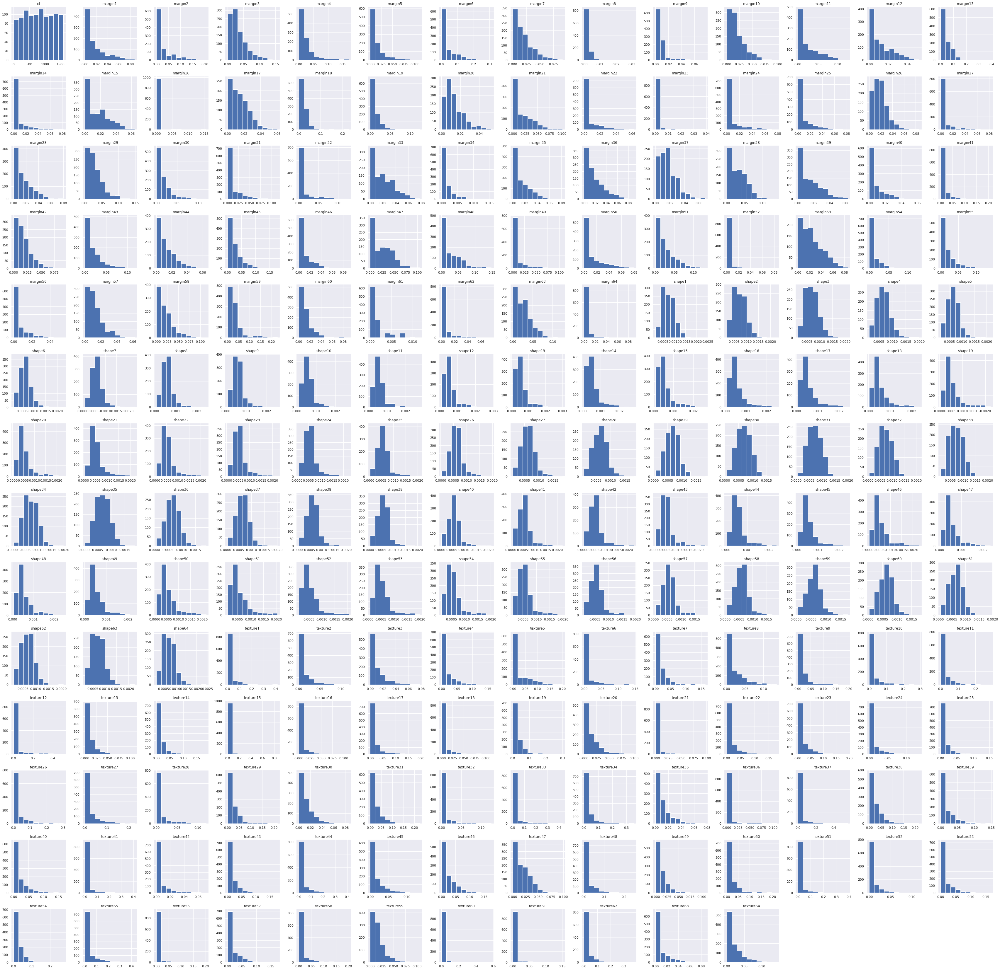

In [89]:
 data.hist(figsize=(60,60));

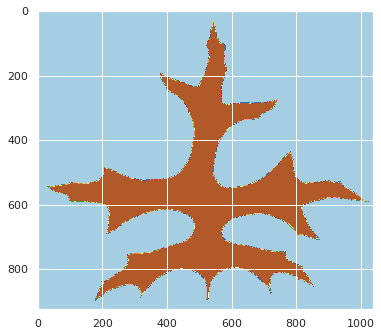

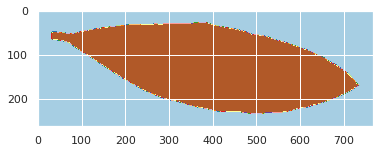

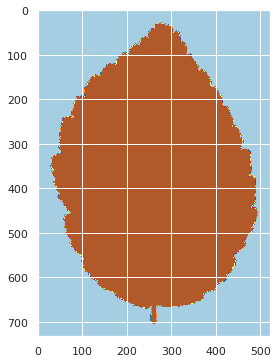

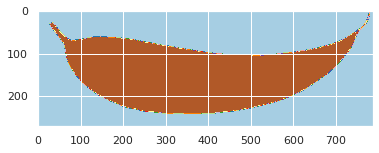

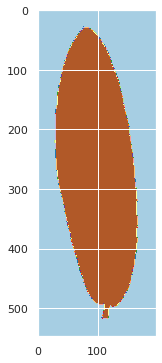

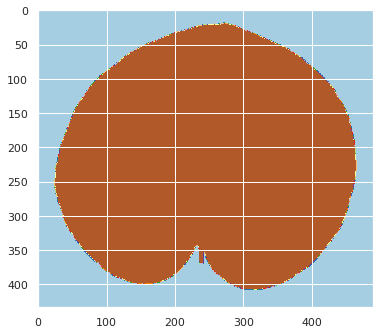

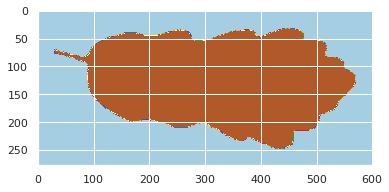

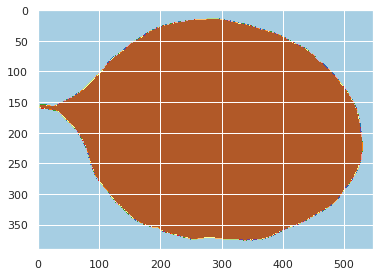

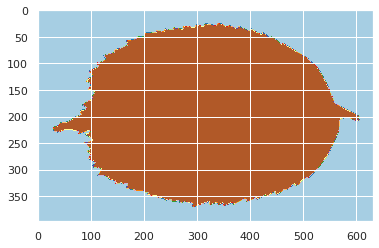

In [90]:
# imports
import matplotlib.image as mpimg       # reading images to numpy arrays
import matplotlib.patches as mpatches  # to draw a circle at the mean contour
from skimage import measure            # to find shape contour
import scipy.ndimage as ndi            # to determine shape centrality

# matplotlib setup
%matplotlib inline
from pylab import rcParams
rcParams['figure.figsize'] = (6, 6)      # setting default size of plots

list_images = ['53','54', '55', '56', '57', '58', '59', '60', '61']
for i in list_images:
    img = mpimg.imread('/content/drive/MyDrive/leaf_proj/images/'+i+'.jpg')


    plt.imshow(img, cmap='Paired')
    plt.show()

In [91]:
 Corr_Mat = data.corr()
Corr_Mat.style.background_gradient(cmap="PiYG")

Text(0.5, 1.0, 'Correlation\xa0Matrix')

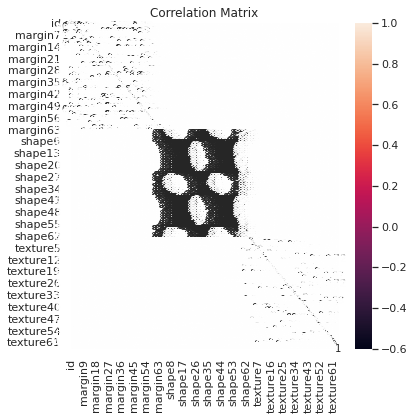

In [93]:
sns.heatmap(data.corr(), annot =True)
plt.title('Correlation Matrix')

In [60]:
data.species.value_counts()

Acer_Opalus                    10
Crataegus_Monogyna             10
Acer_Mono                      10
Magnolia_Heptapeta             10
Acer_Capillipes                10
                               ..
Alnus_Rubra                    10
Rhododendron_x_Russellianum    10
Cytisus_Battandieri            10
Liriodendron_Tulipifera        10
Sorbus_Aria                    10
Name: species, Length: 99, dtype: int64

In [61]:
from sklearn.preprocessing import OneHotEncoder
# creating instance of one-hot-encoder
enc = OneHotEncoder(handle_unknown='ignore')
# passing species column (label encoded values of bridge_types)
y = pd.DataFrame(enc.fit_transform(data[['species']]).toarray())

In [62]:
X = data.iloc[:, :]
X.drop(['species', 'id'], axis = 1, inplace = True) # drop the columns of species
X.head()

,margin1,margin2,margin3,margin4,margin5,margin6,margin7,margin8,margin9,margin10,...,texture55,texture56,texture57,texture58,texture59,texture60,texture61,texture62,texture63,texture64
0,0.007812,0.023438,0.023438,0.003906,0.011719,0.009766,0.027344,0.0,0.001953,0.033203,...,0.007812,0.000000,0.002930,0.002930,0.035156,0.0,0.0,0.004883,0.000000,0.025391
1,0.005859,0.000000,0.031250,0.015625,0.025391,0.001953,0.019531,0.0,0.000000,0.007812,...,0.000977,0.000000,0.000000,0.000977,0.023438,0.0,0.0,0.000977,0.039062,0.022461
2,0.005859,0.009766,0.019531,0.007812,0.003906,0.005859,0.068359,0.0,0.000000,0.044922,...,0.154300,0.000000,0.005859,0.000977,0.007812,0.0,0.0,0.000000,0.020508,0.002930
3,0.000000,0.003906,0.023438,0.005859,0.021484,0.019531,0.023438,0.0,0.013672,0.017578,...,0.000000,0.000977,0.000000,0.000000,0.020508,0.0,0.0,0.017578,0.000000,0.047852
4,0.005859,0.003906,0.048828,0.009766,0.013672,0.015625,0.005859,0.0,0.000000,0.005859,...,0.096680,0.000000,0.021484,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.031250


In [63]:
# from sklearn.preprocessing import StandardScaler

# scaler = StandardScaler()
# X_train = scaler.fit_transform(X_train)
# X_test = scaler.transform(X_test)

In [64]:
input_dim = X.shape[1]
print(input_dim)

192


In [65]:
X.shape[1]

192

In [66]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train,  X_val, y_train, y_val = train_test_split(X_train,y_train,test_size=0.1)

In [76]:
y_train

,0,1,2,3,4,5,6,7,8,9,...,89,90,91,92,93,94,95,96,97,98
660,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
572,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
754,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
303,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
46,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
374,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
106,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
814,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
945,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [77]:
from tensorflow.keras.optimizers import Adam , RMSprop , SGD

def MLP_Model(Optimizer= Adam , Batch_size = 32,  Hidden_size = 512, Dropout_rate = 0.5):
    
    model = Sequential()
  # In layer_1 our activation function is 'tanh' with default 512 neurons and kernel_initializer 'glorot_uniform'
    model.add(Dense(Hidden_size, activation='tanh', input_dim=192))
  #dropout some nerouns to avoid overfitting
    model.add(Dropout(Dropout_rate))
  #output layer with softmax activation function and has 99 nodes for output shape
    model.add(Dense(99 , activation='softmax', name = 'Output'))
  #Apply one of the optimizer and choose the learning rate inside each one 
    if Optimizer == Adam:
        lr_schedule = keras.optimizers.schedules.ExponentialDecay(initial_learning_rate=1e-3, decay_steps=10000, decay_rate=0.9)
        Optimizer = Adam(learning_rate = lr_schedule)
    elif Optimizer == RMSprop:
        Optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.01,rho=0.9,momentum=0.0,epsilon=1e-07,centered=False)
    elif Optimizer == SGD:
        Optimizer = tf.keras.optimizers.SGD(learning_rate=0.9, momentum=0.0, nesterov=False)
    #compile the model with sparse_categorical_crossentropy loss function and accuracy metrics 
    model.compile(optimizer = Optimizer ,loss='categorical_crossentropy' , metrics=['accuracy'])

  #fit the model with 100 epoch
    history = model.fit(X_train , y_train , epochs=100 , batch_size=Batch_size , validation_data=(X_val, y_val))

  #return the training model and the history
    return model, history

def Virtualization_Acc(model_name, history):
    model_history = pd.DataFrame(history.history)
    model_history['epoch'] = history.epoch
    fig, ax = plt.subplots(figsize=(14,8))
    num_epochs = model_history.shape[0]
    ax.plot(np.arange(0, num_epochs), model_history["accuracy"], label="Training accuracy", lw=3, color='#f4b400')
    ax.plot(np.arange(0, num_epochs), model_history["val_accuracy"], label="Validation accuracy", lw=3, color='#0f9d58')
    ax.legend()
    plt.tight_layout()
    plt.show()
    
def Virtualization_Loss(model_name, history):
    model_history = pd.DataFrame(history.history)
    model_history['epoch'] = history.epoch
    fig, ax = plt.subplots(figsize=(14,8))
    num_epochs = model_history.shape[0]
    ax.plot(np.arange(0, num_epochs), model_history["loss"], label="Training loss", lw=3, color='#f4b400')
    ax.plot(np.arange(0, num_epochs), model_history["val_loss"], label="Validation loss", lw=3, color='#0f9d58')
    ax.legend()
    plt.tight_layout()
    plt.show()

In [78]:
#!pip install simple-colors

from simple_colors import * # to print colored , bolded and underlined text

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5878 - accuracy: 0.0154 - val_loss: 4.5817 - val_accuracy: 0.0375
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5622 - accuracy: 0.0829 - val_loss: 4.5635 - val_accuracy: 0.1000
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5312 - accuracy: 0.1671 - val_loss: 4.5357 - val_accuracy: 0.1250
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4890 - accuracy: 0.2149 - val_loss: 4.4959 - val_accuracy: 0.1250
Epoch 5/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4303 - accuracy: 0.2289 - val_loss: 4.4393 - val_accuracy: 0.1375
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3510 - accuracy: 0.2500 - val_loss: 4.3636 - val_accuracy: 0.1500
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2539 -

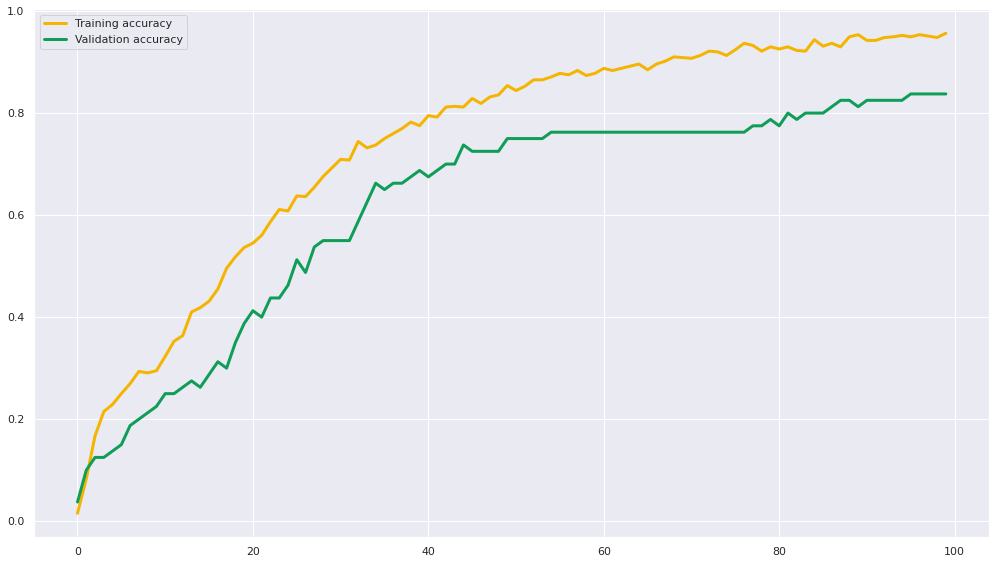

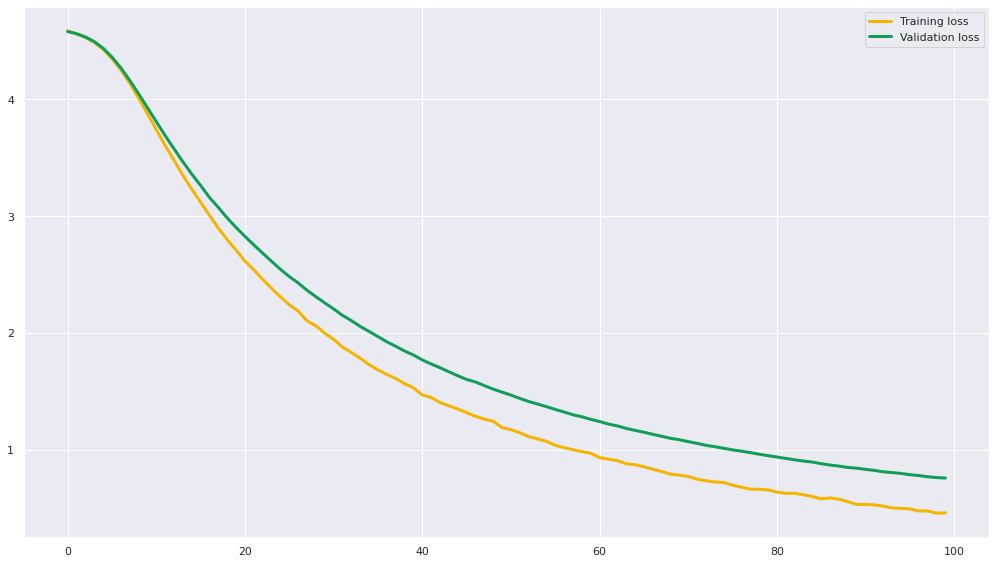

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5890 - accuracy: 0.0267 - val_loss: 4.5829 - val_accuracy: 0.0500
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5655 - accuracy: 0.0927 - val_loss: 4.5629 - val_accuracy: 0.0875
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5360 - accuracy: 0.1601 - val_loss: 4.5346 - val_accuracy: 0.1250
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4953 - accuracy: 0.1840 - val_loss: 4.4928 - val_accuracy: 0.1250
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4364 - accuracy: 0.2008 - val_loss: 4.4326 - val_accuracy: 0.1250
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3597 - accuracy: 0.2261 - val_loss: 4.3578 - val_accuracy: 0.1250
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2580 -

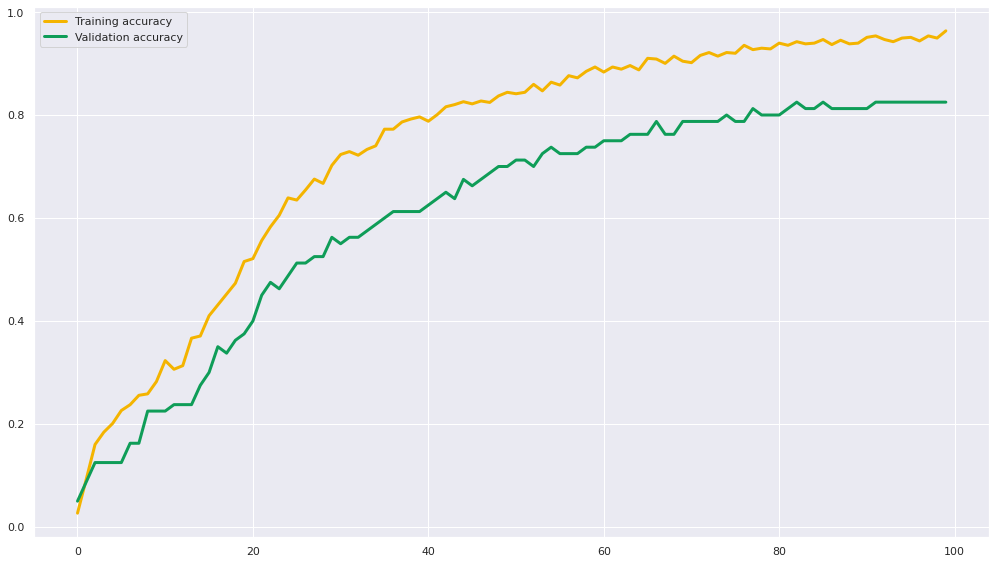

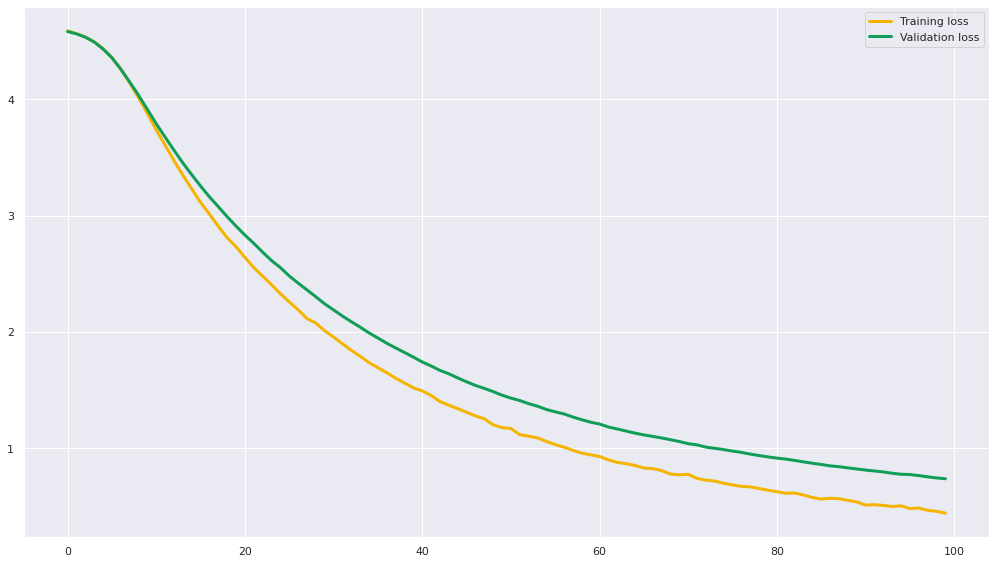

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5873 - accuracy: 0.0253 - val_loss: 4.5798 - val_accuracy: 0.0375
Epoch 2/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5634 - accuracy: 0.0955 - val_loss: 4.5622 - val_accuracy: 0.0750
Epoch 3/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5347 - accuracy: 0.1587 - val_loss: 4.5357 - val_accuracy: 0.1250
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4949 - accuracy: 0.2458 - val_loss: 4.4985 - val_accuracy: 0.1750
Epoch 5/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4402 - accuracy: 0.2851 - val_loss: 4.4435 - val_accuracy: 0.1875
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3644 - accuracy: 0.3020 - val_loss: 4.3705 - val_accuracy: 0.2375
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2695 -

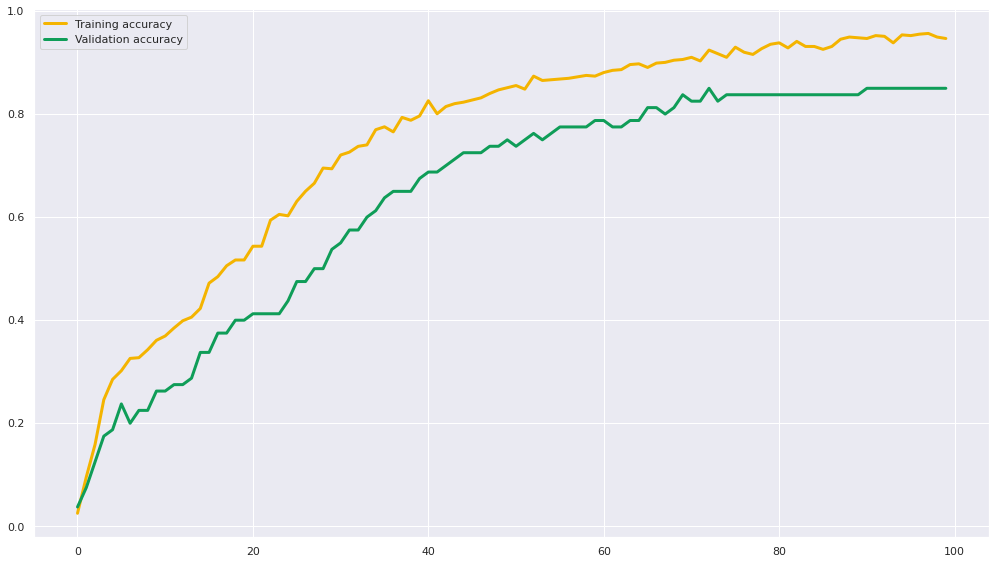

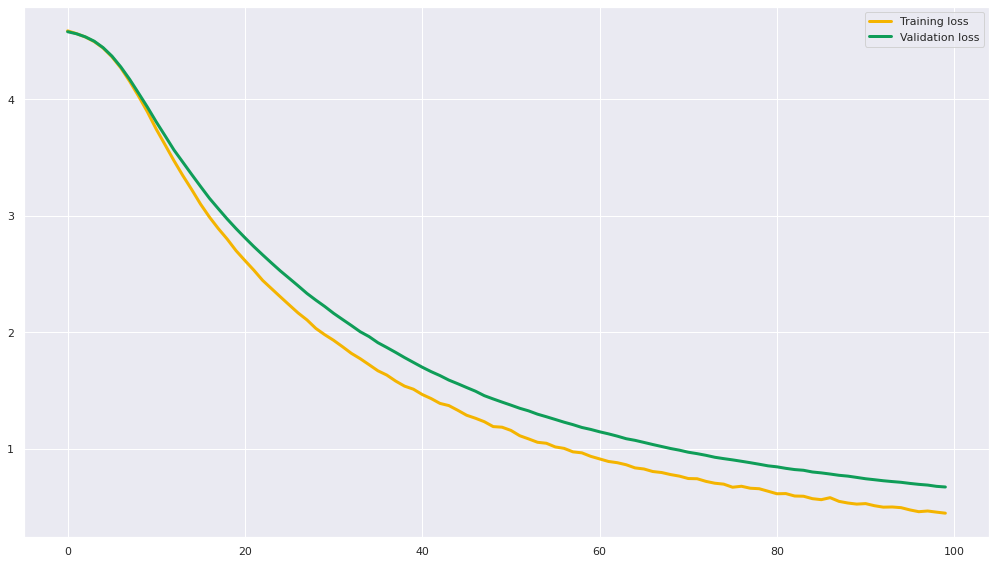

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5902 - accuracy: 0.0140 - val_loss: 4.5797 - val_accuracy: 0.0375
Epoch 2/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5711 - accuracy: 0.0534 - val_loss: 4.5653 - val_accuracy: 0.0500
Epoch 3/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5476 - accuracy: 0.0969 - val_loss: 4.5454 - val_accuracy: 0.0625
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5185 - accuracy: 0.1404 - val_loss: 4.5182 - val_accuracy: 0.0875
Epoch 5/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4776 - accuracy: 0.1573 - val_loss: 4.4814 - val_accuracy: 0.0625
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4279 - accuracy: 0.1629 - val_loss: 4.4295 - val_accuracy: 0.1125
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3598 -

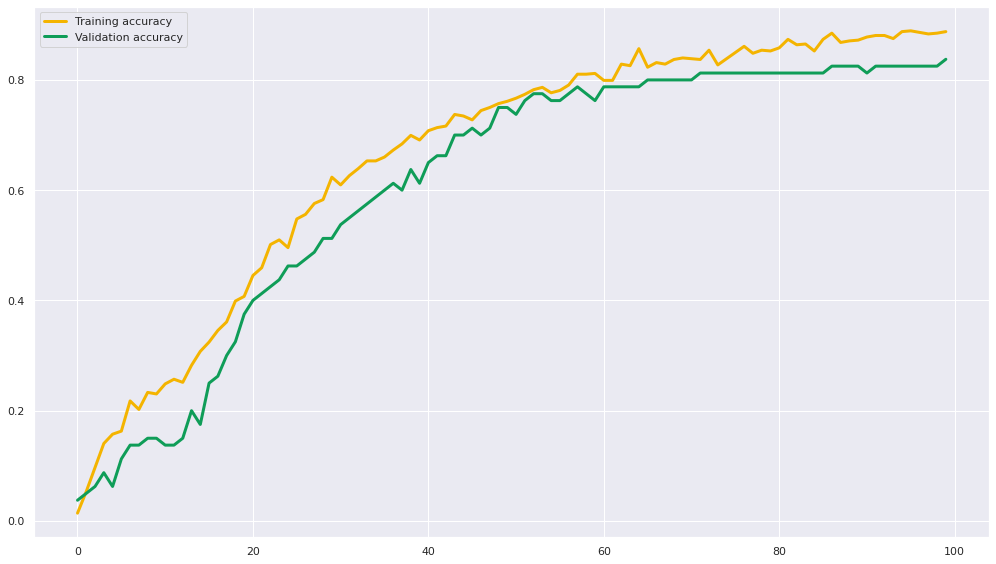

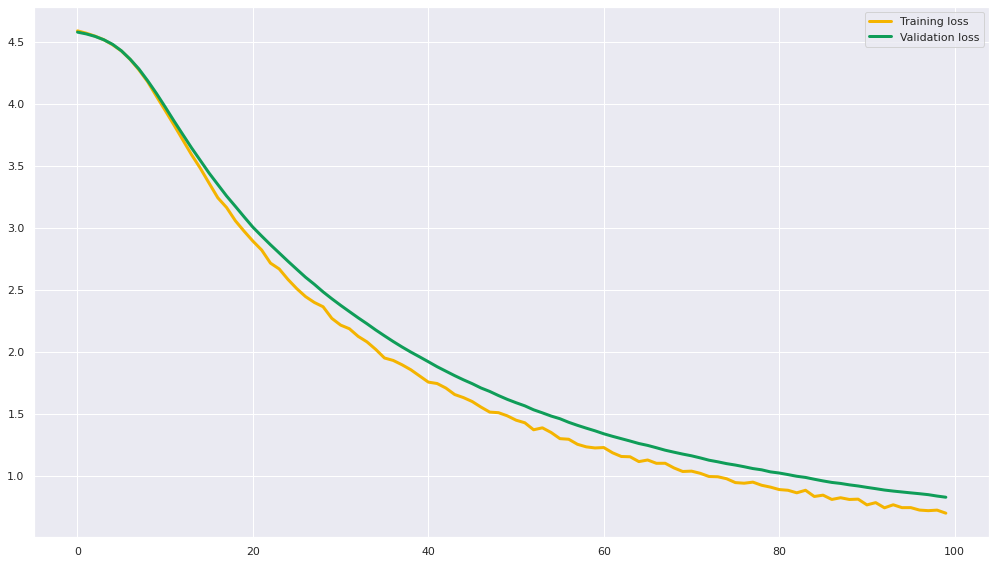

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5899 - accuracy: 0.0098 - val_loss: 4.5845 - val_accuracy: 0.0500
Epoch 2/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5692 - accuracy: 0.0449 - val_loss: 4.5677 - val_accuracy: 0.0375
Epoch 3/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5454 - accuracy: 0.1039 - val_loss: 4.5476 - val_accuracy: 0.0750
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5139 - accuracy: 0.1545 - val_loss: 4.5163 - val_accuracy: 0.1250
Epoch 5/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4705 - accuracy: 0.2051 - val_loss: 4.4740 - val_accuracy: 0.1500
Epoch 6/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4120 - accuracy: 0.2360 - val_loss: 4.4168 - val_accuracy: 0.1500
Epoch 7/100
45/45 [==============================] - 0s 2ms/step - loss: 4.3427 -

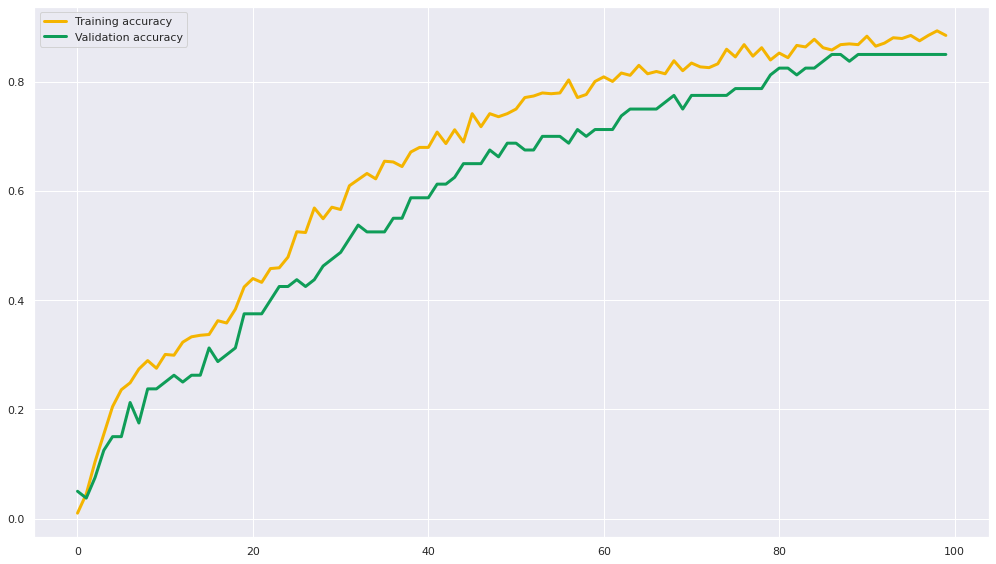

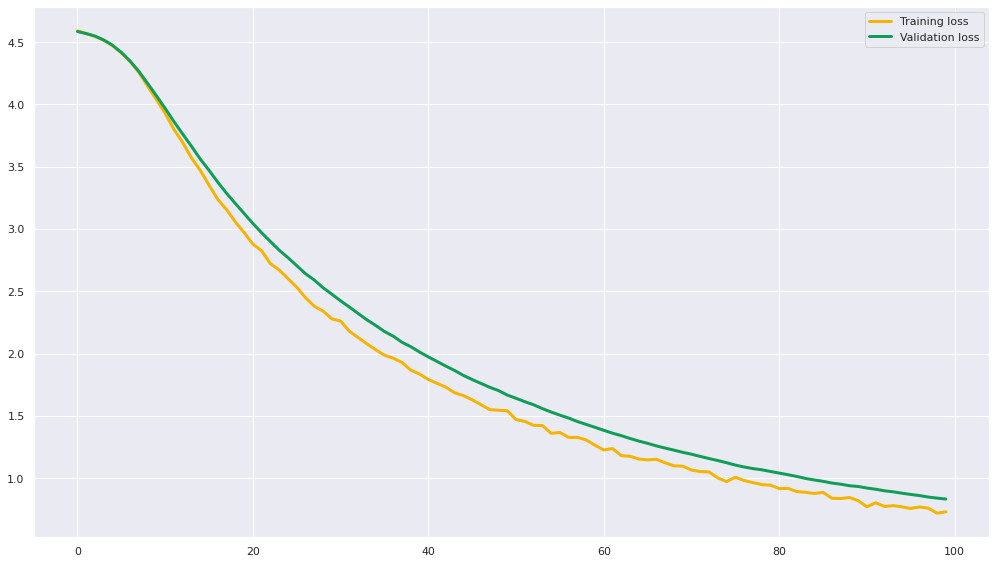

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 3s 30ms/step - loss: 4.5906 - accuracy: 0.0112 - val_loss: 4.5856 - val_accuracy: 0.0000e+00
Epoch 2/100
45/45 [==============================] - 0s 10ms/step - loss: 4.5701 - accuracy: 0.0534 - val_loss: 4.5702 - val_accuracy: 0.0625
Epoch 3/100
45/45 [==============================] - 1s 15ms/step - loss: 4.5481 - accuracy: 0.0997 - val_loss: 4.5494 - val_accuracy: 0.0750
Epoch 4/100
45/45 [==============================] - 0s 7ms/step - loss: 4.5159 - accuracy: 0.1475 - val_loss: 4.5211 - val_accuracy: 0.1125
Epoch 5/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4739 - accuracy: 0.1728 - val_loss: 4.4813 - val_accuracy: 0.1125
Epoch 6/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4154 - accuracy: 0.1966 - val_loss: 4.4259 - val_accuracy: 0.1375
Epoch 7/100
45/45 [==============================] - 0s 2ms/step - loss: 4

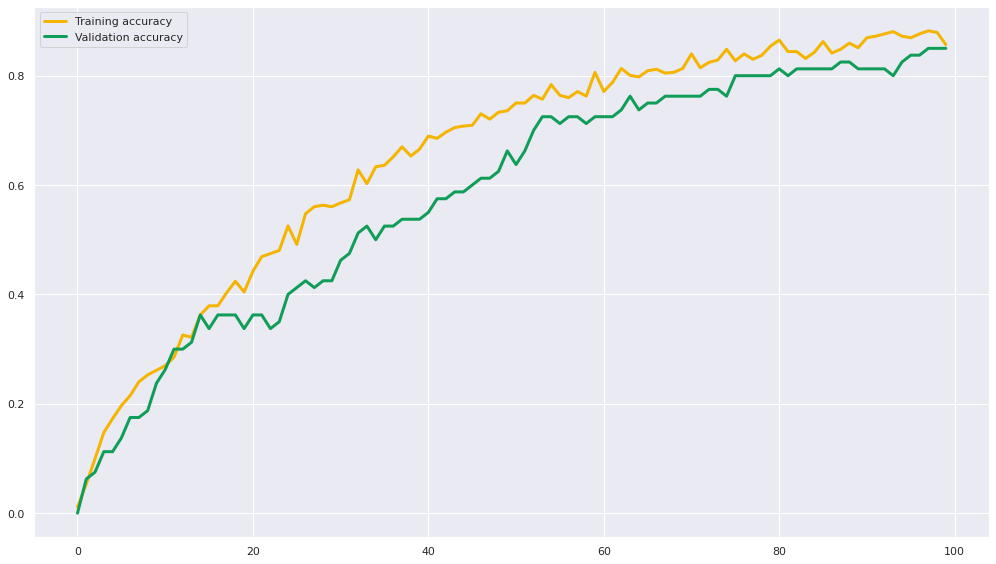

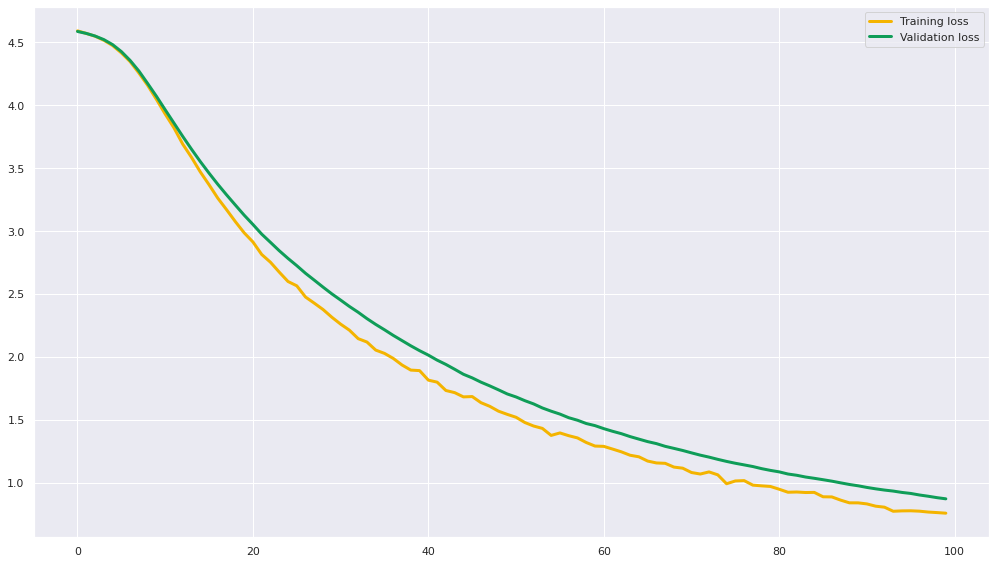

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5936 - accuracy: 0.0140 - val_loss: 4.5845 - val_accuracy: 0.0125
Epoch 2/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5764 - accuracy: 0.0337 - val_loss: 4.5705 - val_accuracy: 0.0625
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5571 - accuracy: 0.0548 - val_loss: 4.5541 - val_accuracy: 0.1125
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5347 - accuracy: 0.0801 - val_loss: 4.5336 - val_accuracy: 0.1125
Epoch 5/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5027 - accuracy: 0.1292 - val_loss: 4.5048 - val_accuracy: 0.1500
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4658 - accuracy: 0.1264 - val_loss: 4.4672 - val_accuracy: 0.1500
Epoch 7/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4117 -

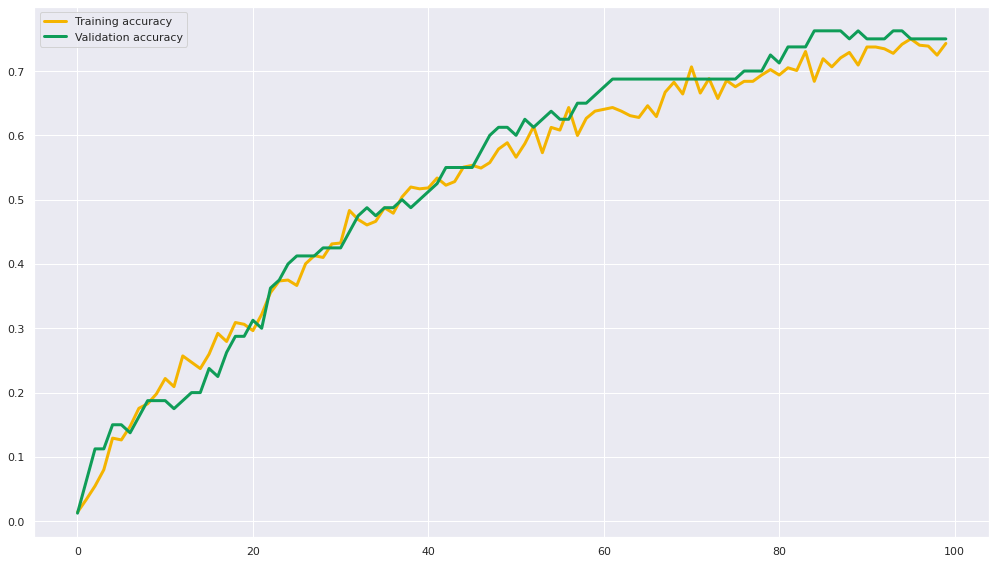

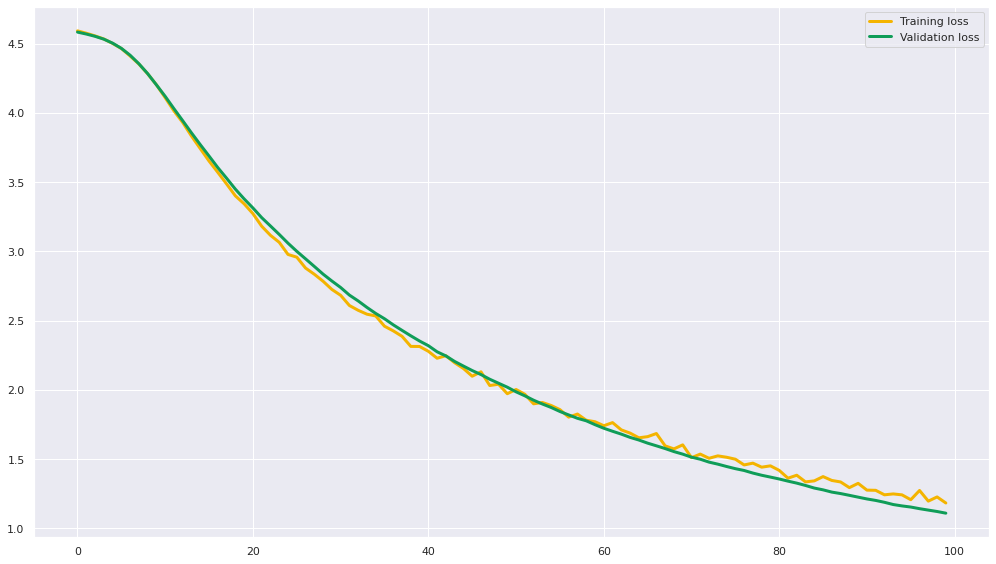

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5950 - accuracy: 0.0098 - val_loss: 4.5848 - val_accuracy: 0.0375
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5771 - accuracy: 0.0435 - val_loss: 4.5726 - val_accuracy: 0.0625
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5583 - accuracy: 0.0688 - val_loss: 4.5572 - val_accuracy: 0.1125
Epoch 4/100
45/45 [==============================] - 0s 4ms/step - loss: 4.5349 - accuracy: 0.0997 - val_loss: 4.5375 - val_accuracy: 0.1000
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5049 - accuracy: 0.1404 - val_loss: 4.5090 - val_accuracy: 0.1125
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4674 - accuracy: 0.1461 - val_loss: 4.4736 - val_accuracy: 0.1125
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4209 -

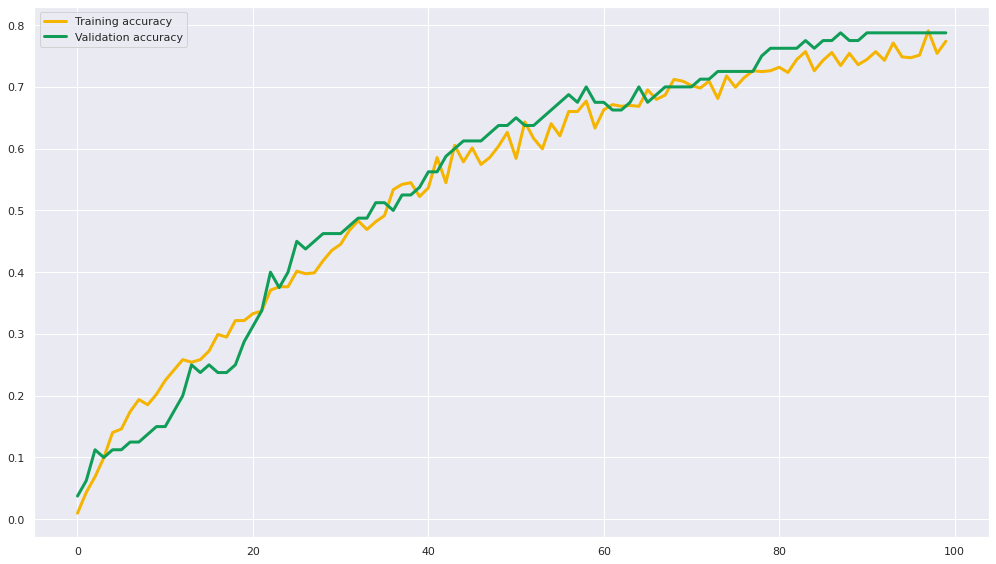

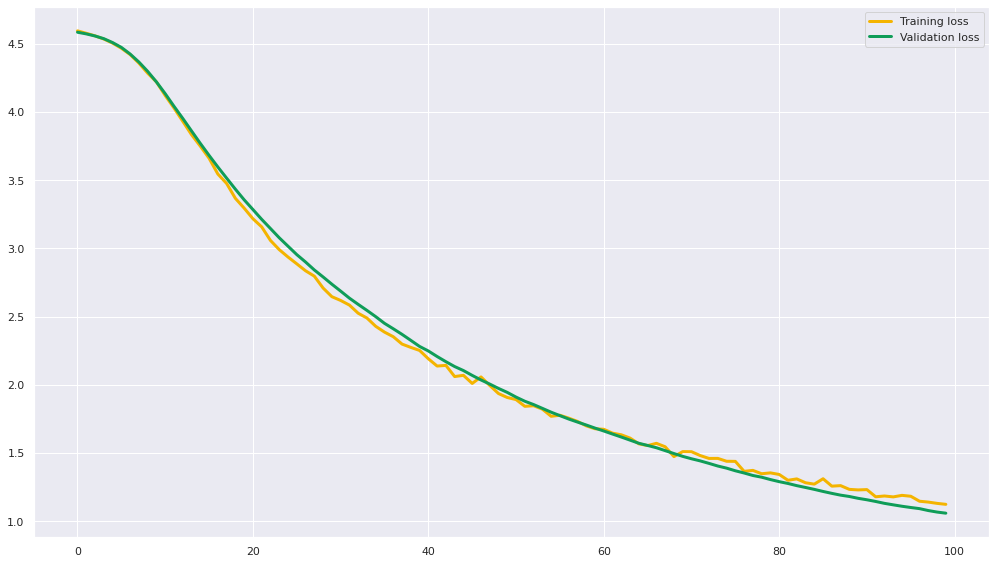

The batch_size is: 16, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5940 - accuracy: 0.0070 - val_loss: 4.5835 - val_accuracy: 0.0250
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5751 - accuracy: 0.0323 - val_loss: 4.5716 - val_accuracy: 0.0500
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5553 - accuracy: 0.0913 - val_loss: 4.5557 - val_accuracy: 0.1125
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5352 - accuracy: 0.0997 - val_loss: 4.5360 - val_accuracy: 0.1125
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5051 - accuracy: 0.1517 - val_loss: 4.5081 - val_accuracy: 0.1125
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 4.4686 - accuracy: 0.1475 - val_loss: 4.4752 - val_accuracy: 0.1375
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4218 -

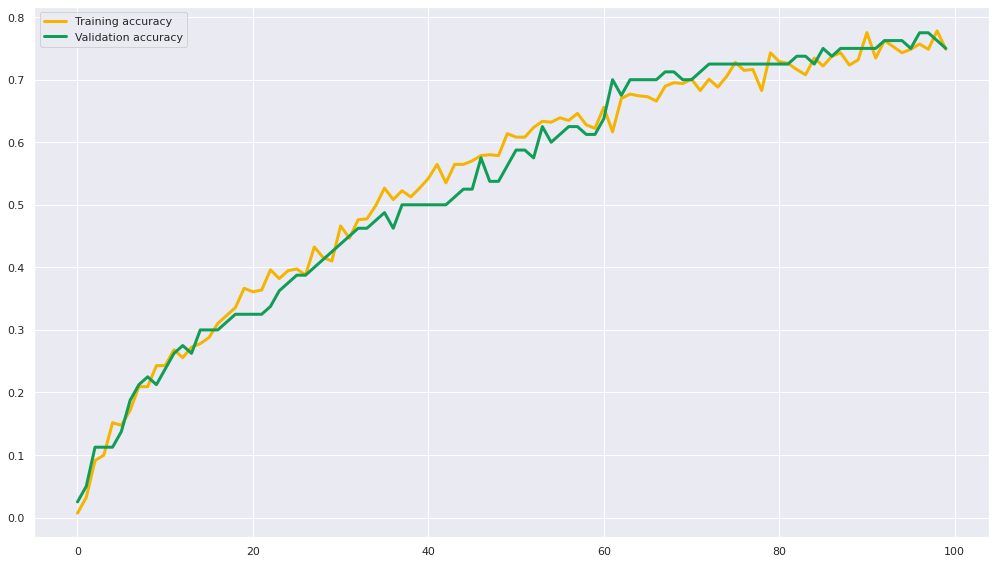

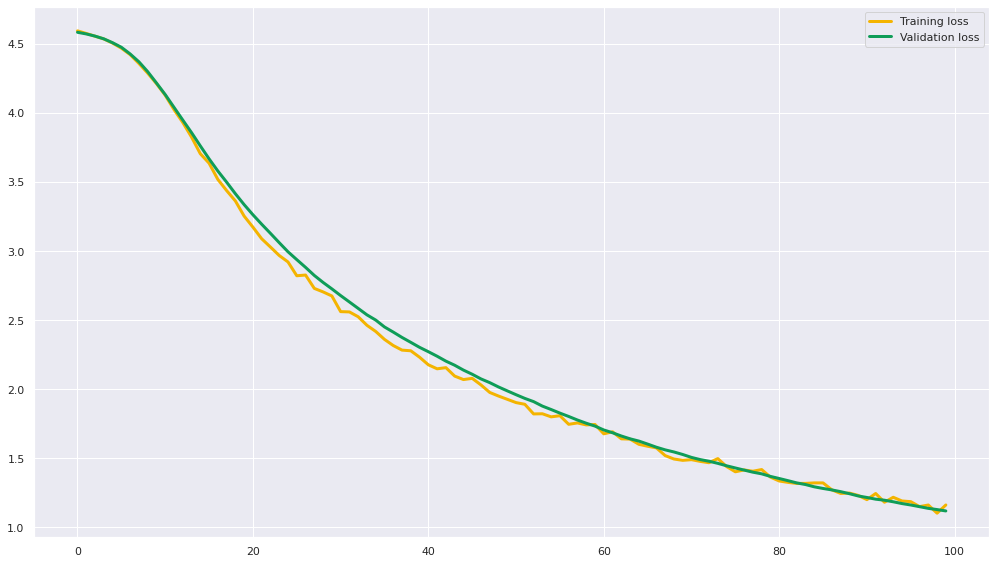

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5825 - accuracy: 0.0323 - val_loss: 4.5730 - val_accuracy: 0.0875
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5414 - accuracy: 0.1503 - val_loss: 4.5390 - val_accuracy: 0.1875
Epoch 3/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4909 - accuracy: 0.3048 - val_loss: 4.4885 - val_accuracy: 0.2250
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4187 - accuracy: 0.3357 - val_loss: 4.4147 - val_accuracy: 0.2375
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3150 - accuracy: 0.3483 - val_loss: 4.3108 - val_accuracy: 0.2750
Epoch 6/100
45/45 [==============================] - 0s 2ms/step - loss: 4.1813 - accuracy: 0.4073 - val_loss: 4.1747 - val_accuracy: 0.3375
Epoch 7/100
45/45 [==============================] - 0s 2ms/step - loss: 4.0117 -

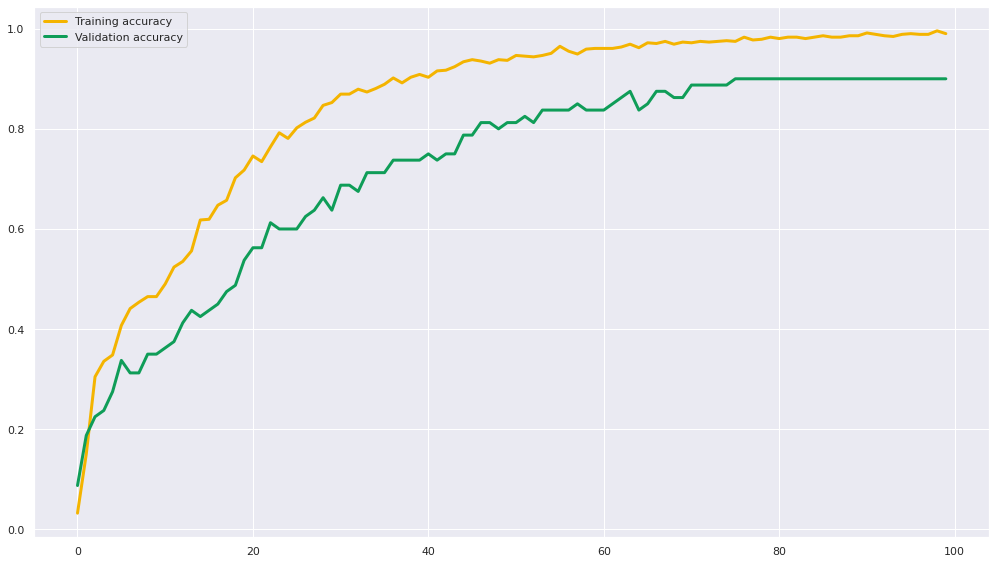

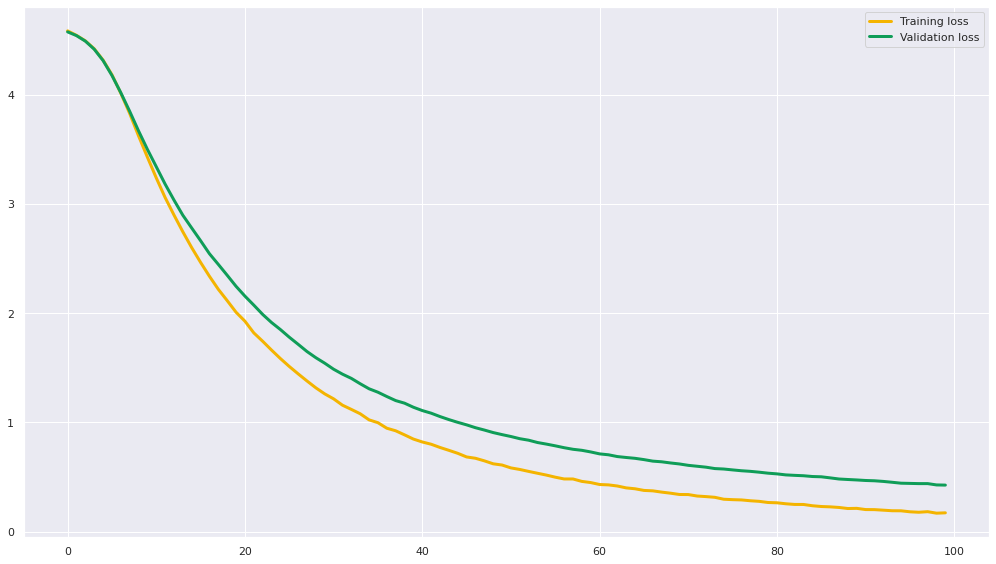

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5860 - accuracy: 0.0267 - val_loss: 4.5662 - val_accuracy: 0.0625
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5447 - accuracy: 0.1433 - val_loss: 4.5302 - val_accuracy: 0.1750
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4928 - accuracy: 0.2500 - val_loss: 4.4774 - val_accuracy: 0.2000
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4198 - accuracy: 0.3076 - val_loss: 4.4007 - val_accuracy: 0.2250
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3148 - accuracy: 0.3343 - val_loss: 4.2937 - val_accuracy: 0.2625
Epoch 6/100
45/45 [==============================] - 0s 2ms/step - loss: 4.1748 - accuracy: 0.3989 - val_loss: 4.1519 - val_accuracy: 0.3125
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0064 -

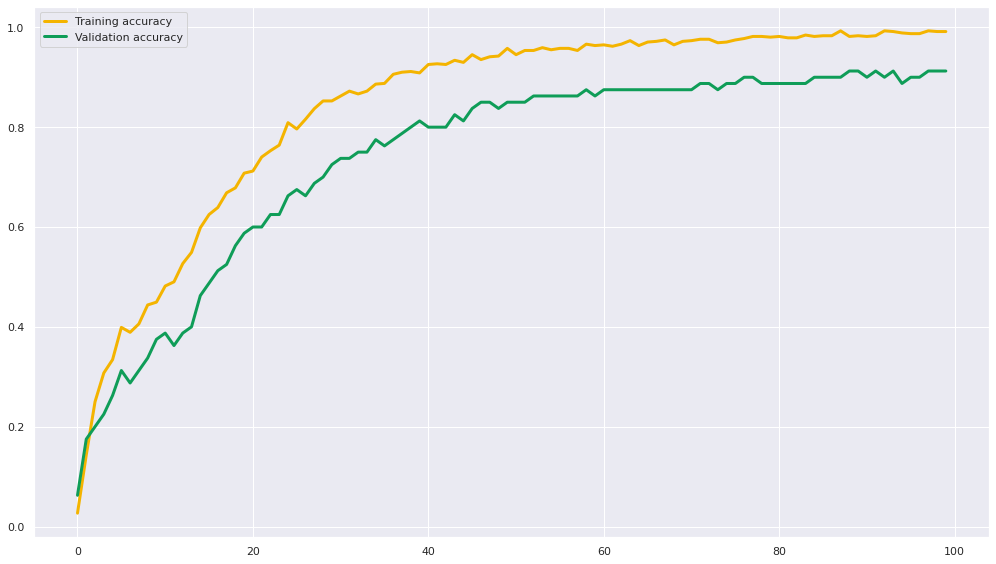

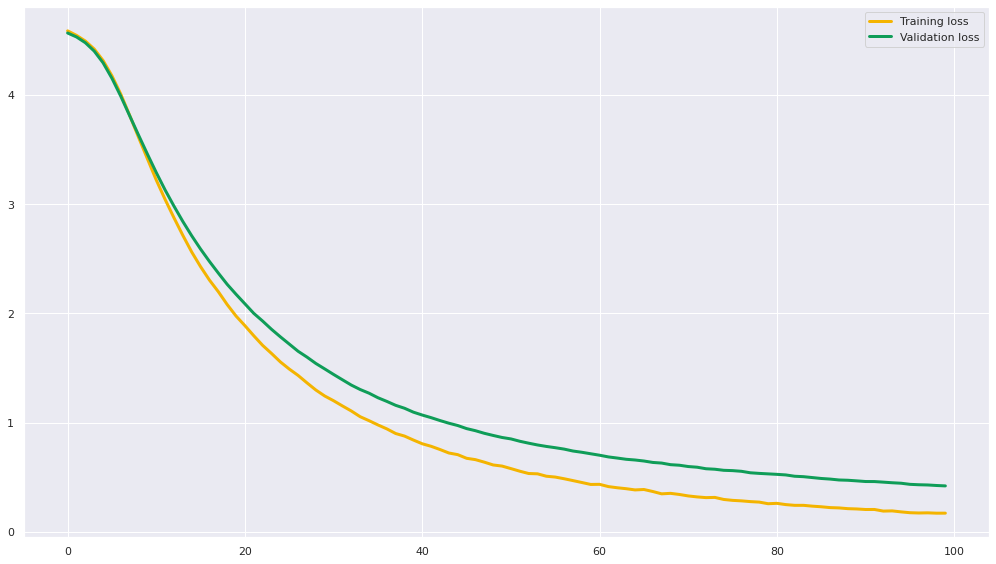

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5885 - accuracy: 0.0211 - val_loss: 4.5731 - val_accuracy: 0.0500
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5475 - accuracy: 0.1447 - val_loss: 4.5385 - val_accuracy: 0.1375
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4971 - accuracy: 0.2500 - val_loss: 4.4904 - val_accuracy: 0.1500
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4270 - accuracy: 0.3202 - val_loss: 4.4181 - val_accuracy: 0.2000
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3262 - accuracy: 0.3258 - val_loss: 4.3145 - val_accuracy: 0.1875
Epoch 6/100
45/45 [==============================] - 0s 2ms/step - loss: 4.1878 - accuracy: 0.3385 - val_loss: 4.1798 - val_accuracy: 0.2250
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0208 -

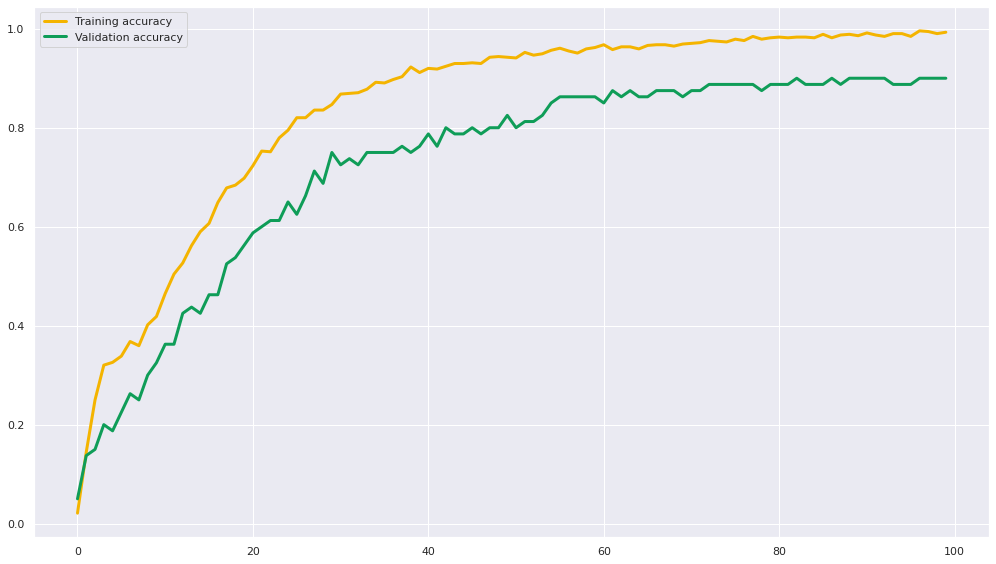

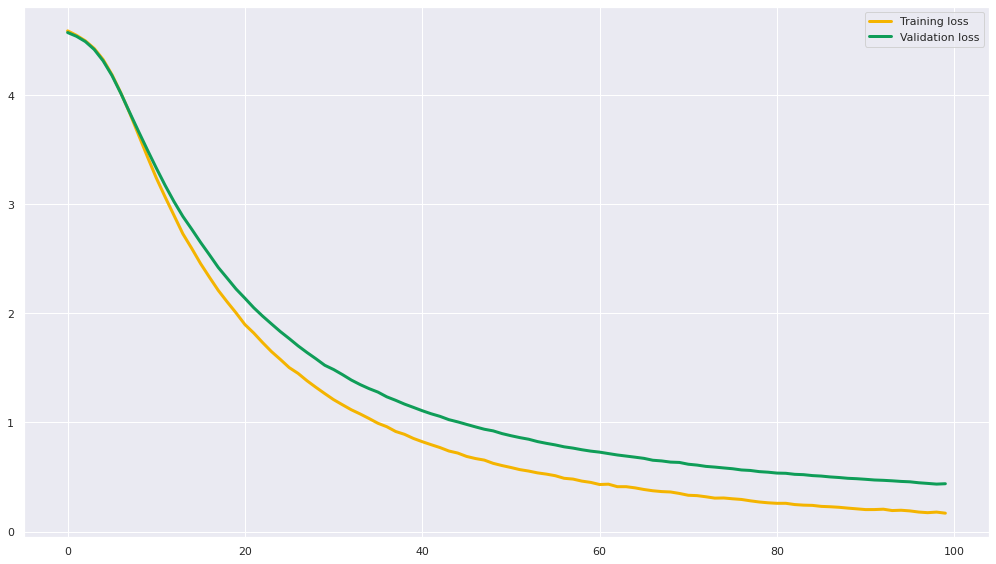

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5880 - accuracy: 0.0281 - val_loss: 4.5735 - val_accuracy: 0.0750
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5490 - accuracy: 0.1081 - val_loss: 4.5458 - val_accuracy: 0.1250
Epoch 3/100
45/45 [==============================] - 0s 2ms/step - loss: 4.5051 - accuracy: 0.1784 - val_loss: 4.5042 - val_accuracy: 0.1375
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.4475 - accuracy: 0.2233 - val_loss: 4.4466 - val_accuracy: 0.1750
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3641 - accuracy: 0.2317 - val_loss: 4.3624 - val_accuracy: 0.1875
Epoch 6/100
45/45 [==============================] - 0s 2ms/step - loss: 4.2580 - accuracy: 0.2683 - val_loss: 4.2524 - val_accuracy: 0.2250
Epoch 7/100
45/45 [==============================] - 0s 2ms/step - loss: 4.1168 -

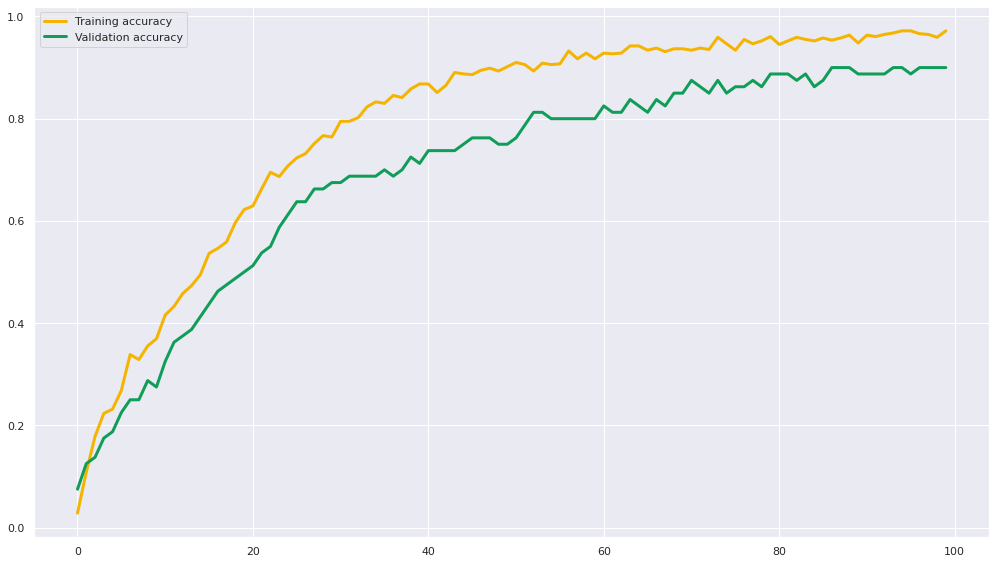

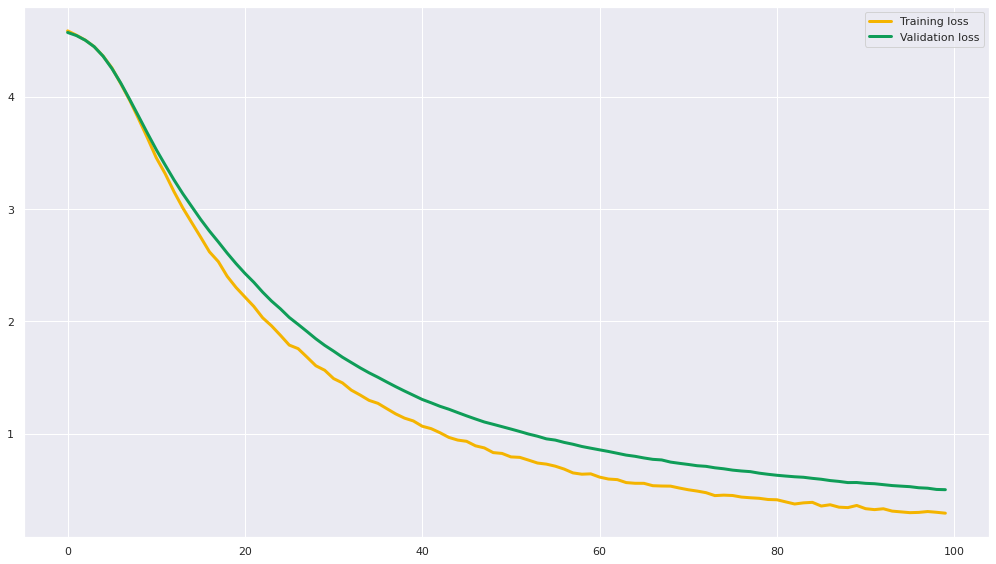

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5871 - accuracy: 0.0169 - val_loss: 4.5723 - val_accuracy: 0.0875
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5502 - accuracy: 0.0955 - val_loss: 4.5404 - val_accuracy: 0.1750
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5038 - accuracy: 0.1938 - val_loss: 4.5001 - val_accuracy: 0.2000
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4456 - accuracy: 0.2598 - val_loss: 4.4405 - val_accuracy: 0.2625
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3614 - accuracy: 0.2978 - val_loss: 4.3579 - val_accuracy: 0.2625
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2532 - accuracy: 0.3469 - val_loss: 4.2532 - val_accuracy: 0.2375
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1225 -

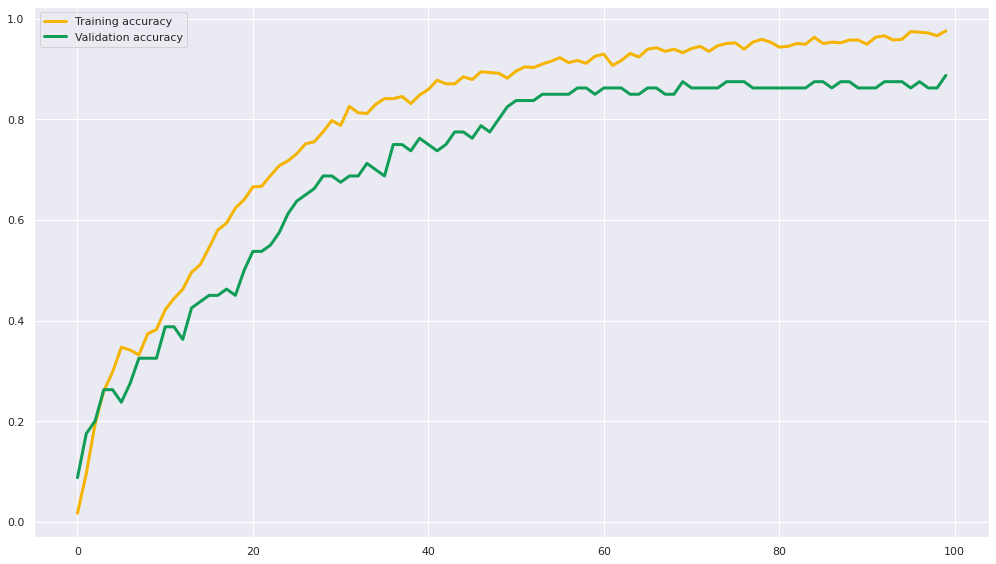

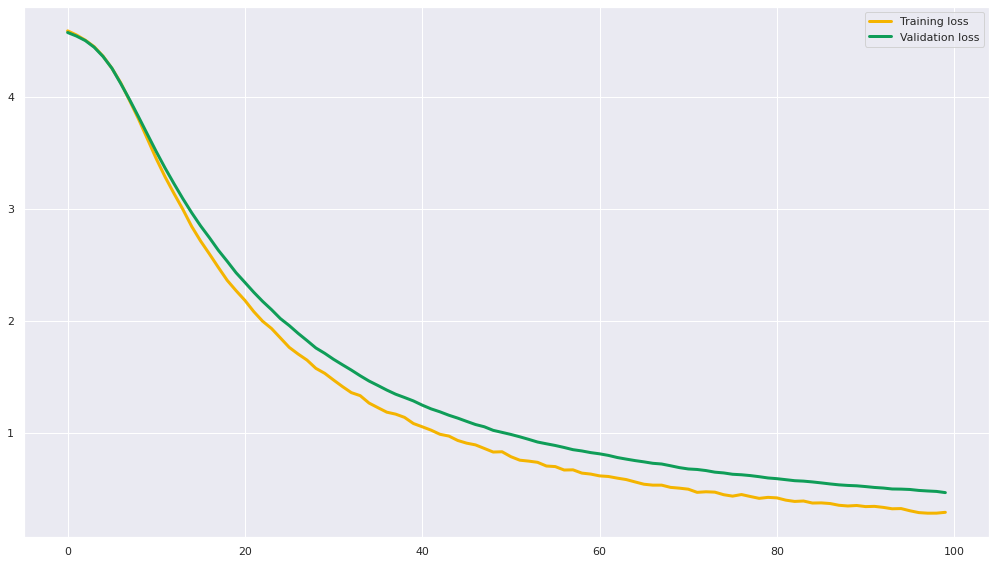

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 4.5857 - accuracy: 0.0309 - val_loss: 4.5709 - val_accuracy: 0.0625
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5463 - accuracy: 0.1306 - val_loss: 4.5400 - val_accuracy: 0.1375
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.5033 - accuracy: 0.1840 - val_loss: 4.4958 - val_accuracy: 0.1500
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4387 - accuracy: 0.2346 - val_loss: 4.4327 - val_accuracy: 0.1750
Epoch 5/100
45/45 [==============================] - 0s 4ms/step - loss: 4.3550 - accuracy: 0.2669 - val_loss: 4.3453 - val_accuracy: 0.1750
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2422 - accuracy: 0.2935 - val_loss: 4.2335 - val_accuracy: 0.1875
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 4.1022 -

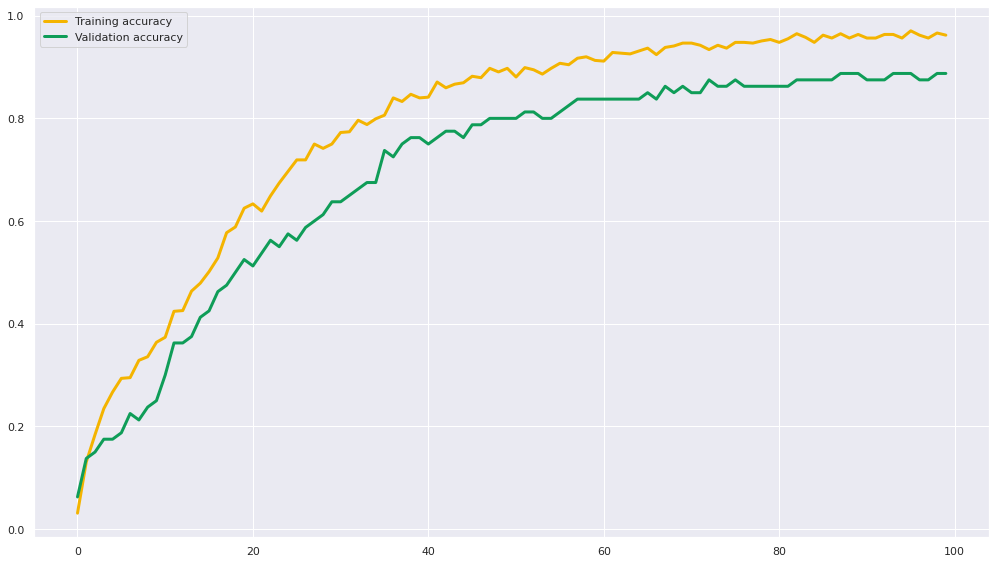

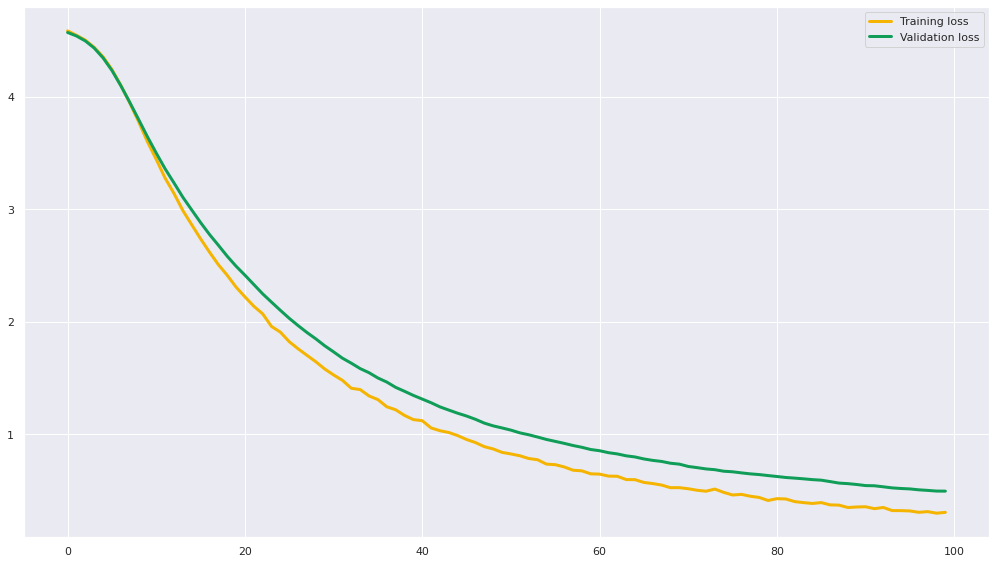

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5851 - accuracy: 0.0169 - val_loss: 4.5763 - val_accuracy: 0.0250
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5582 - accuracy: 0.0660 - val_loss: 4.5505 - val_accuracy: 0.1125
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5202 - accuracy: 0.1348 - val_loss: 4.5175 - val_accuracy: 0.1000
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4735 - accuracy: 0.1966 - val_loss: 4.4727 - val_accuracy: 0.1375
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4156 - accuracy: 0.2472 - val_loss: 4.4100 - val_accuracy: 0.1875
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3383 - accuracy: 0.2514 - val_loss: 4.3321 - val_accuracy: 0.2125
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2389 -

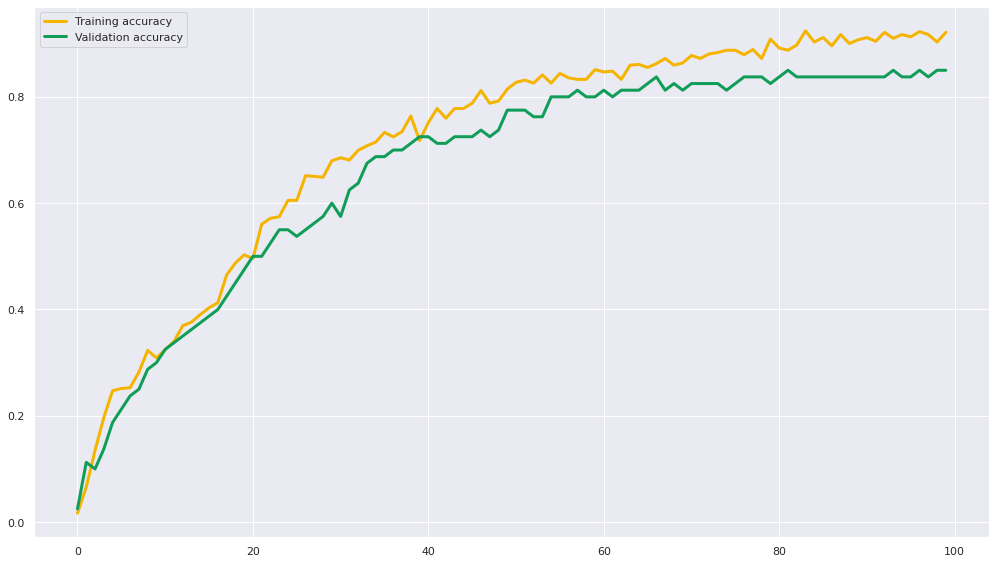

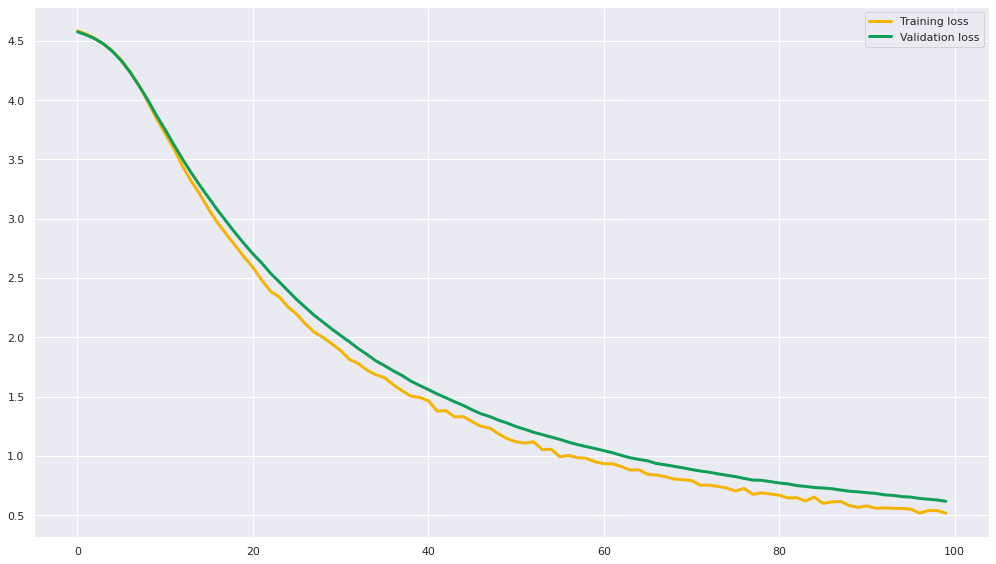

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5913 - accuracy: 0.0169 - val_loss: 4.5703 - val_accuracy: 0.0750
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5582 - accuracy: 0.0646 - val_loss: 4.5471 - val_accuracy: 0.1625
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5258 - accuracy: 0.1025 - val_loss: 4.5162 - val_accuracy: 0.1250
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4835 - accuracy: 0.1756 - val_loss: 4.4746 - val_accuracy: 0.2000
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4348 - accuracy: 0.2079 - val_loss: 4.4221 - val_accuracy: 0.2125
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3589 - accuracy: 0.2697 - val_loss: 4.3487 - val_accuracy: 0.2625
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2689 -

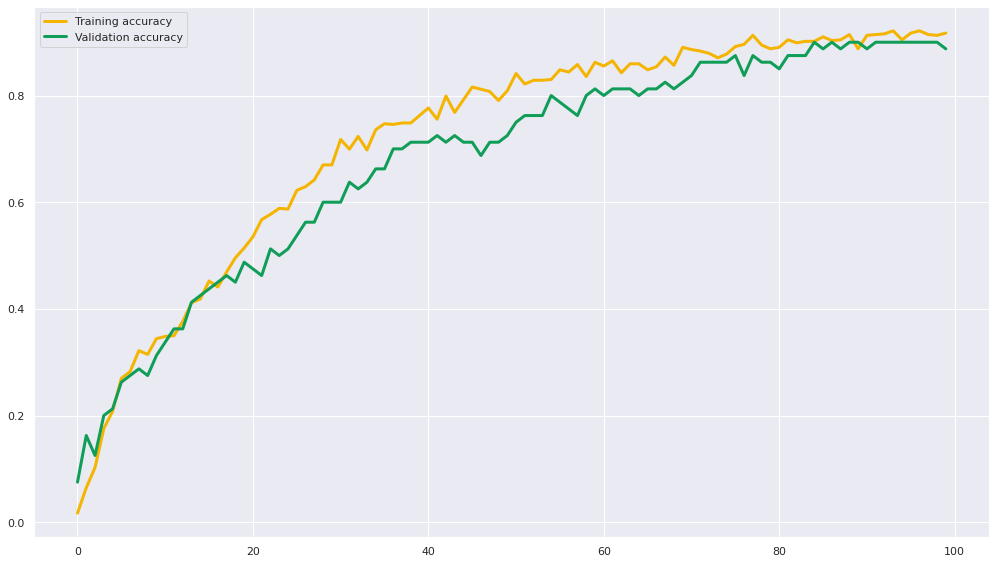

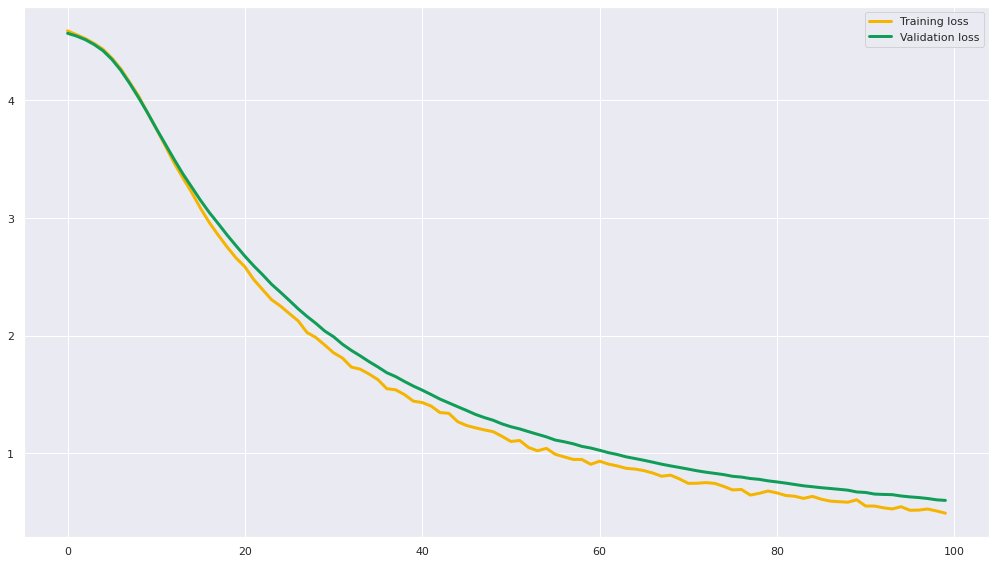

The batch_size is: 16, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 4.5905 - accuracy: 0.0295 - val_loss: 4.5752 - val_accuracy: 0.0500
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5617 - accuracy: 0.0576 - val_loss: 4.5527 - val_accuracy: 0.1375
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5238 - accuracy: 0.1503 - val_loss: 4.5214 - val_accuracy: 0.1750
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4855 - accuracy: 0.1419 - val_loss: 4.4797 - val_accuracy: 0.2000
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4230 - accuracy: 0.2107 - val_loss: 4.4223 - val_accuracy: 0.2125
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3551 - accuracy: 0.2205 - val_loss: 4.3484 - val_accuracy: 0.2000
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2659 -

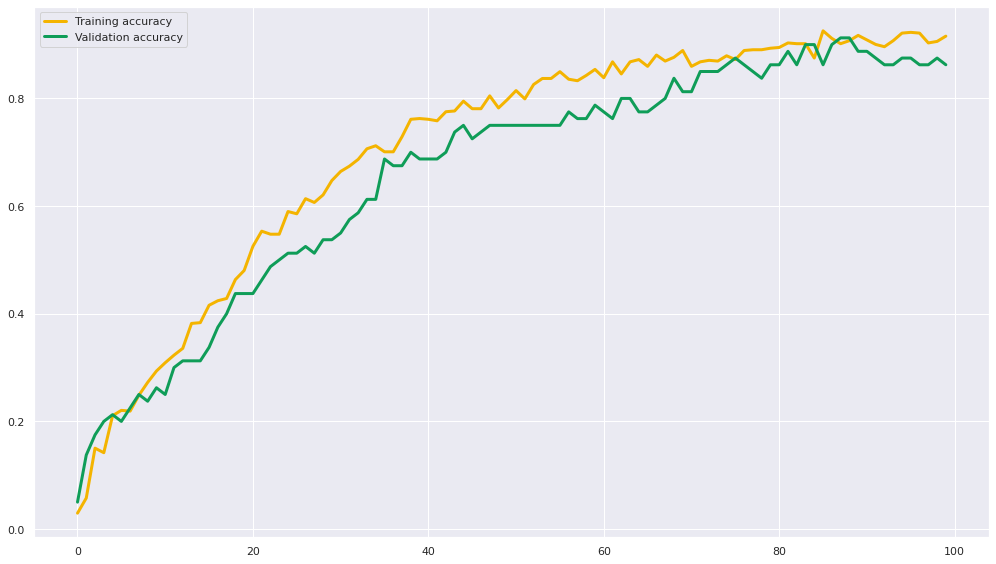

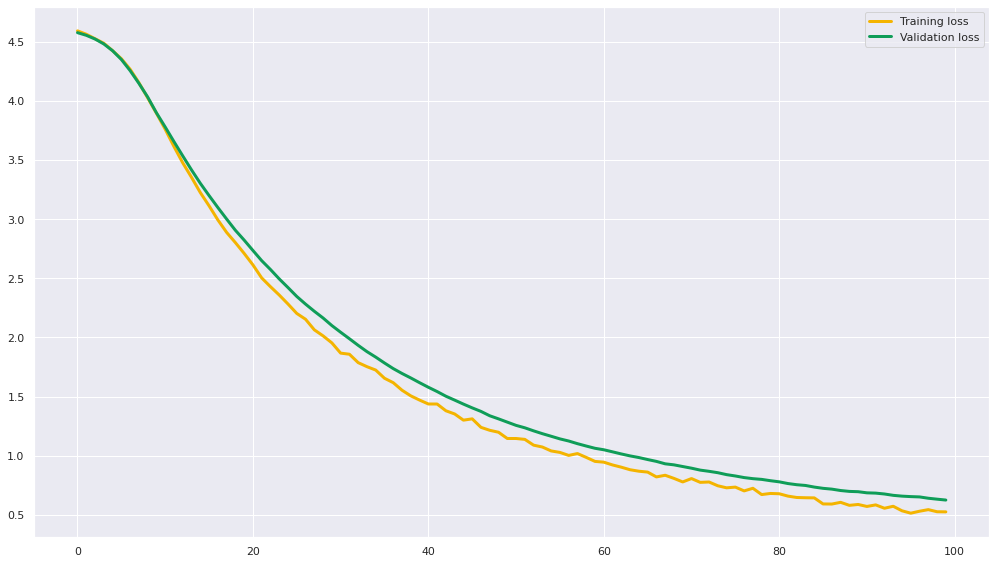

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5785 - accuracy: 0.0492 - val_loss: 4.5486 - val_accuracy: 0.1500
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5052 - accuracy: 0.2416 - val_loss: 4.4865 - val_accuracy: 0.2000
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4099 - accuracy: 0.3539 - val_loss: 4.3884 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2664 - accuracy: 0.3834 - val_loss: 4.2423 - val_accuracy: 0.2625
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0659 - accuracy: 0.4157 - val_loss: 4.0481 - val_accuracy: 0.3000
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.8163 - accuracy: 0.4185 - val_loss: 3.8113 - val_accuracy: 0.2875
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.5421 

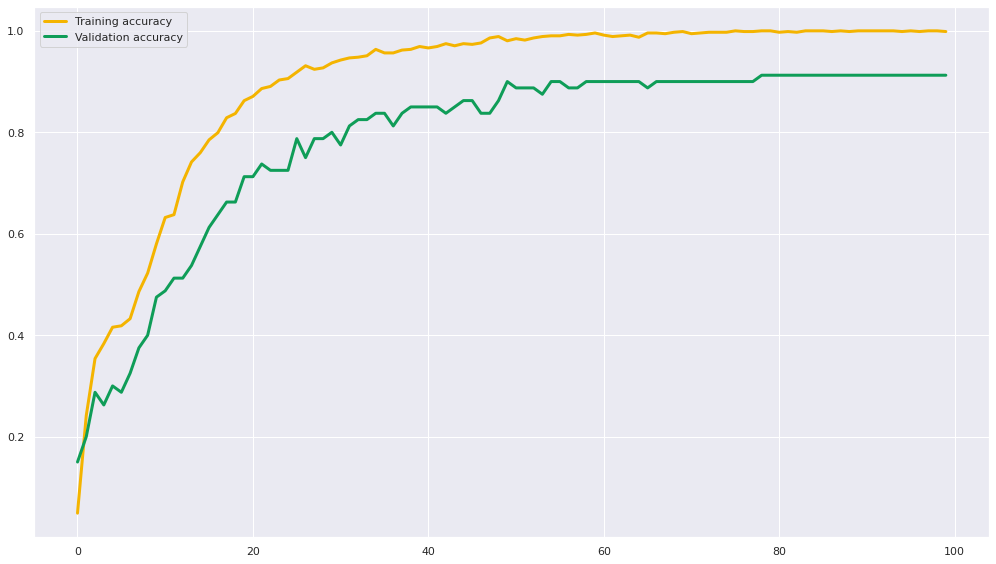

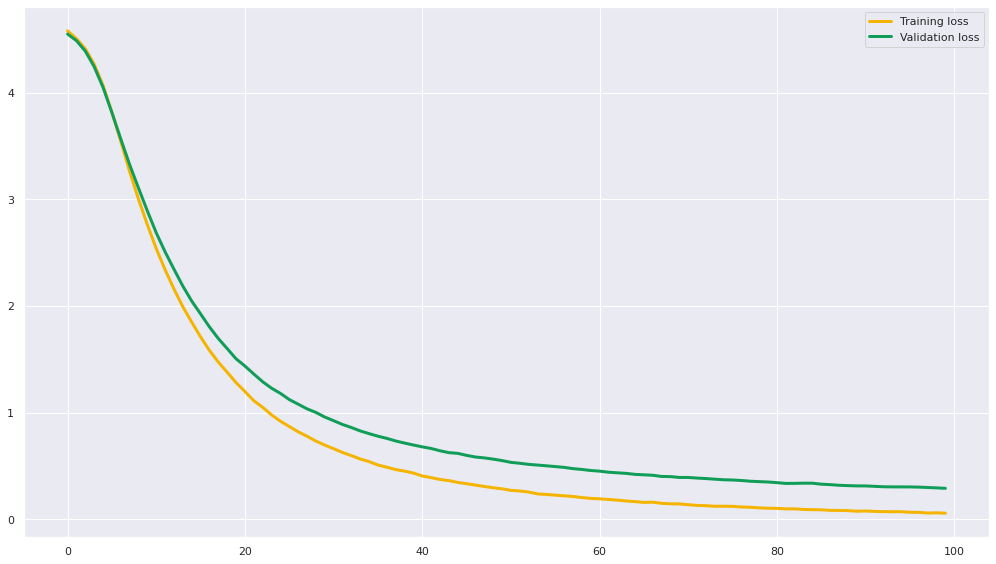

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 4.5730 - accuracy: 0.0435 - val_loss: 4.5410 - val_accuracy: 0.1625
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4987 - accuracy: 0.2654 - val_loss: 4.4760 - val_accuracy: 0.1625
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4018 - accuracy: 0.3202 - val_loss: 4.3729 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2552 - accuracy: 0.3806 - val_loss: 4.2213 - val_accuracy: 0.3250
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0558 - accuracy: 0.3834 - val_loss: 4.0197 - val_accuracy: 0.3375
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.8133 - accuracy: 0.4607 - val_loss: 3.7826 - val_accuracy: 0.3750
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.5399 

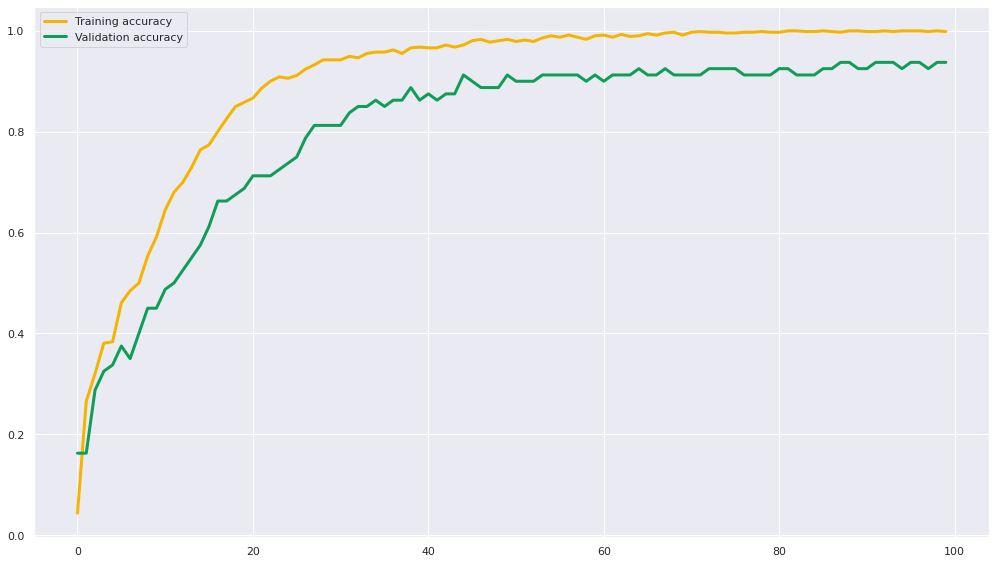

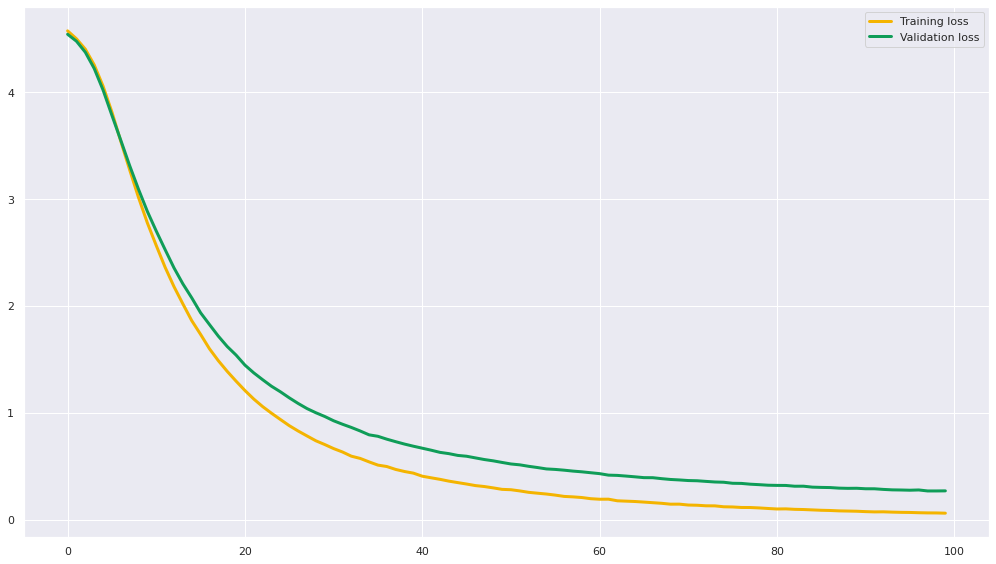

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5757 - accuracy: 0.0534 - val_loss: 4.5513 - val_accuracy: 0.1500
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5014 - accuracy: 0.2500 - val_loss: 4.4844 - val_accuracy: 0.3000
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4065 - accuracy: 0.3174 - val_loss: 4.3871 - val_accuracy: 0.2750
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2639 - accuracy: 0.3596 - val_loss: 4.2440 - val_accuracy: 0.2750
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0670 - accuracy: 0.3862 - val_loss: 4.0432 - val_accuracy: 0.3250
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.8250 - accuracy: 0.4213 - val_loss: 3.8137 - val_accuracy: 0.2875
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.5594 

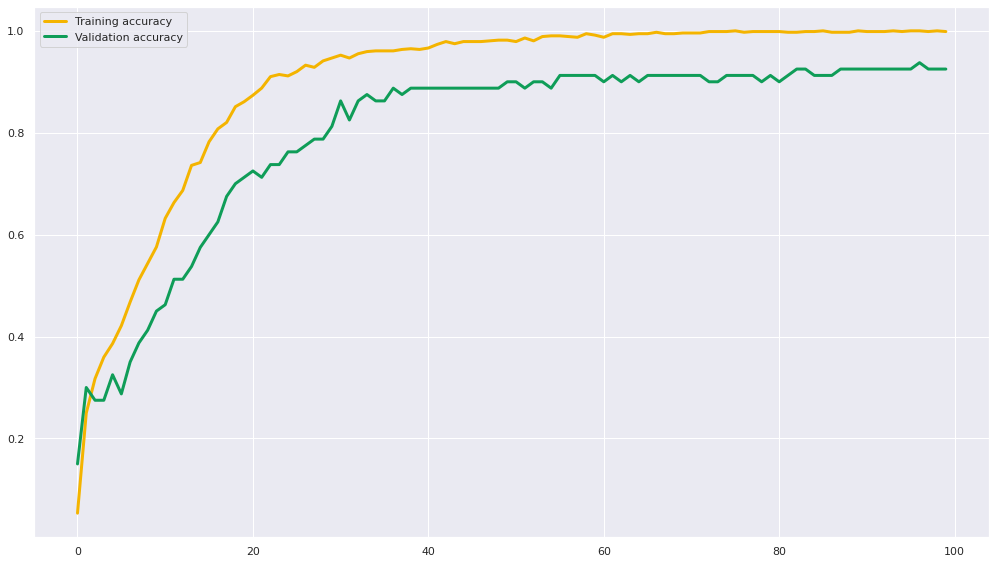

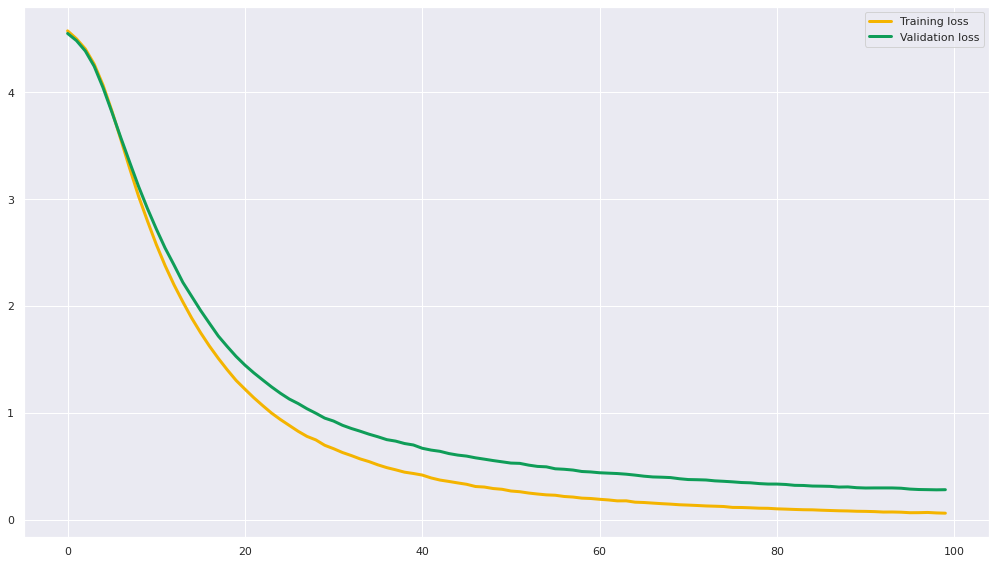

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 5ms/step - loss: 4.5779 - accuracy: 0.0351 - val_loss: 4.5550 - val_accuracy: 0.0625
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5113 - accuracy: 0.1770 - val_loss: 4.4999 - val_accuracy: 0.2250
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4295 - accuracy: 0.2570 - val_loss: 4.4221 - val_accuracy: 0.1875
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.3177 - accuracy: 0.2865 - val_loss: 4.3072 - val_accuracy: 0.1875
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1569 - accuracy: 0.3343 - val_loss: 4.1498 - val_accuracy: 0.2000
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9552 - accuracy: 0.3511 - val_loss: 3.9645 - val_accuracy: 0.2250
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.7290 

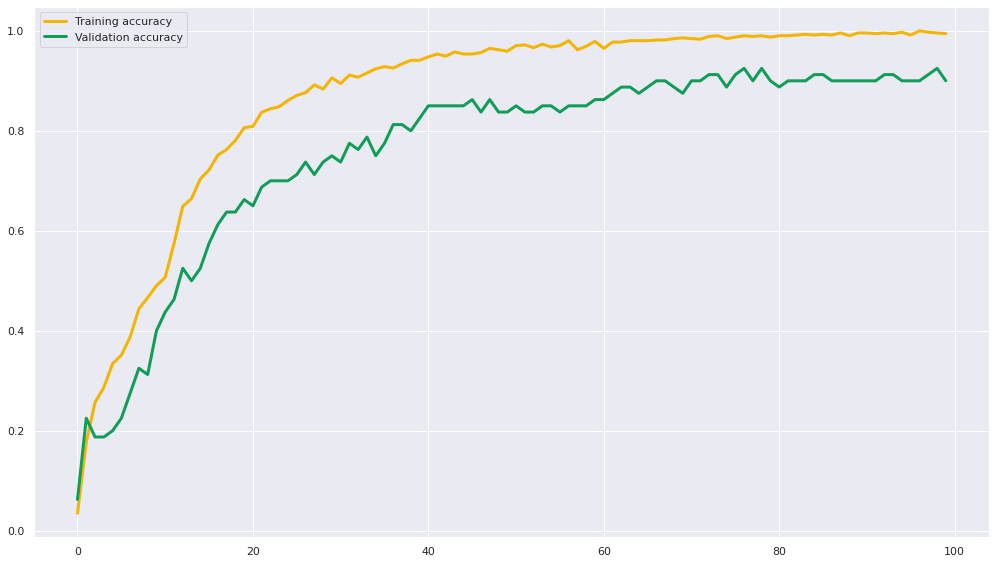

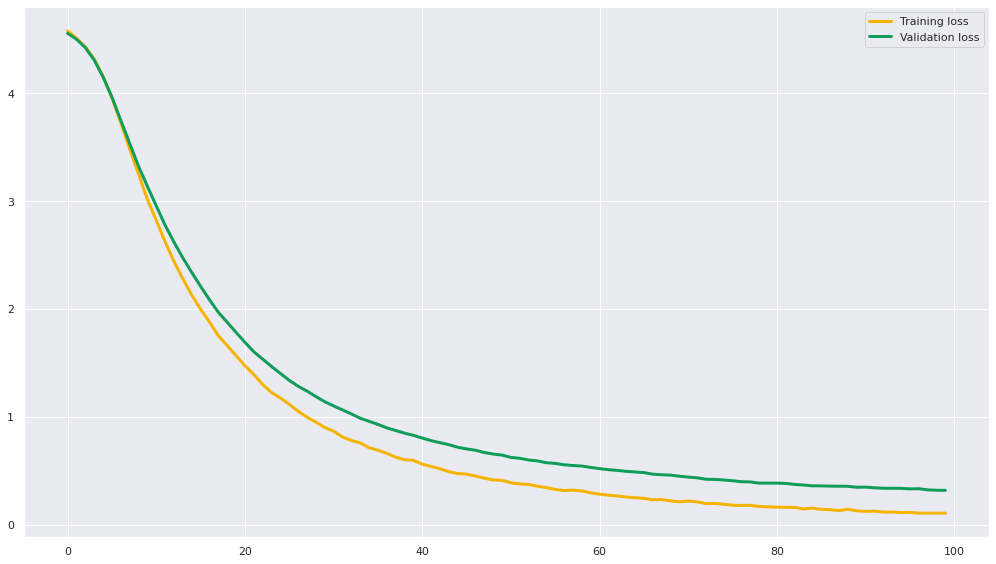

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5803 - accuracy: 0.0407 - val_loss: 4.5490 - val_accuracy: 0.1375
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5162 - accuracy: 0.1671 - val_loss: 4.4968 - val_accuracy: 0.1750
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4344 - accuracy: 0.3020 - val_loss: 4.4168 - val_accuracy: 0.2375
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3218 - accuracy: 0.3539 - val_loss: 4.3028 - val_accuracy: 0.2750
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1700 - accuracy: 0.3596 - val_loss: 4.1442 - val_accuracy: 0.3000
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9659 - accuracy: 0.4129 - val_loss: 3.9470 - val_accuracy: 0.3250
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.7332 

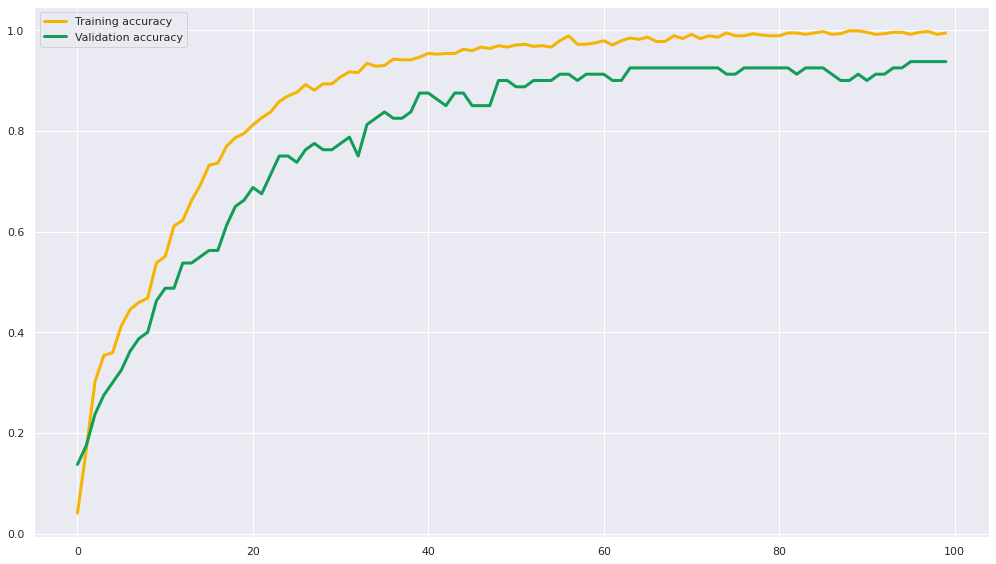

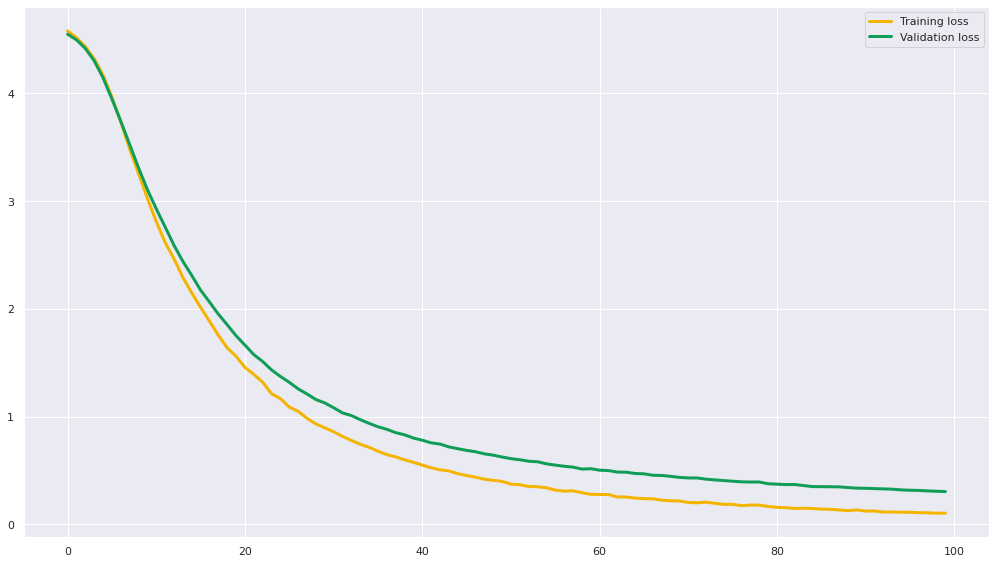

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5781 - accuracy: 0.0421 - val_loss: 4.5528 - val_accuracy: 0.1000
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5129 - accuracy: 0.1587 - val_loss: 4.4967 - val_accuracy: 0.2000
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4308 - accuracy: 0.2528 - val_loss: 4.4124 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3144 - accuracy: 0.3427 - val_loss: 4.2897 - val_accuracy: 0.3250
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1521 - accuracy: 0.3427 - val_loss: 4.1301 - val_accuracy: 0.2875
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9519 - accuracy: 0.3820 - val_loss: 3.9358 - val_accuracy: 0.3000
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 3.7327 

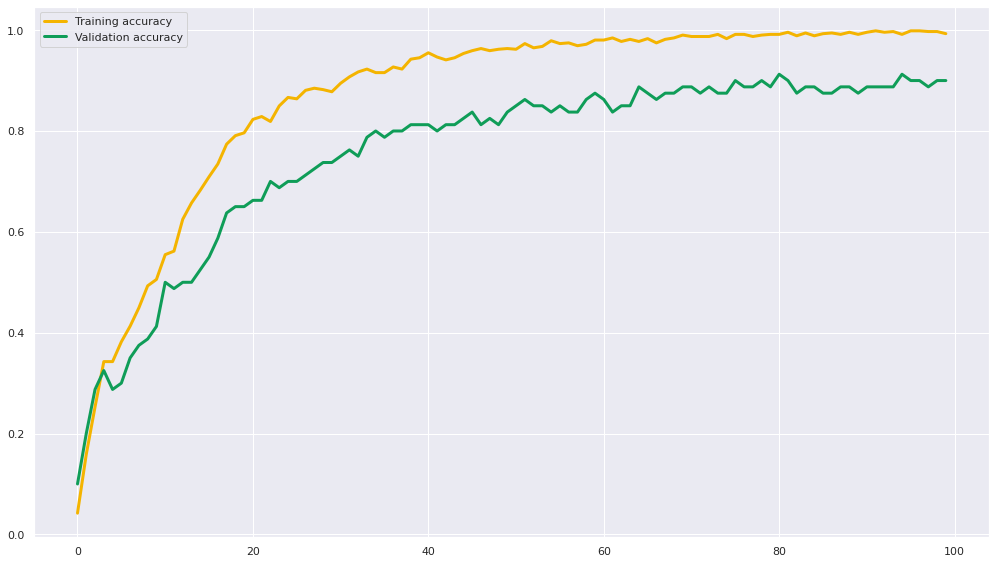

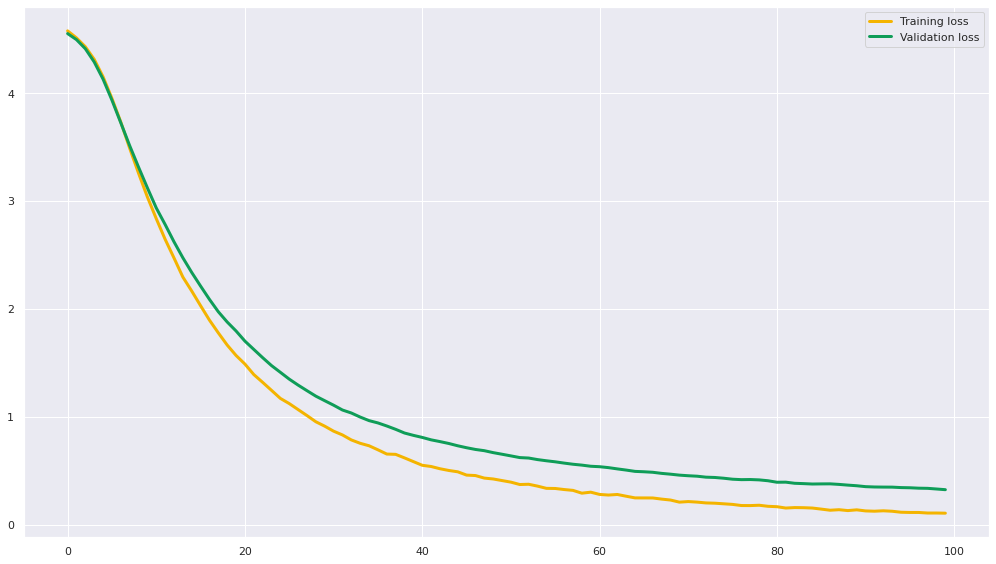

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5831 - accuracy: 0.0197 - val_loss: 4.5644 - val_accuracy: 0.1125
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5311 - accuracy: 0.0969 - val_loss: 4.5214 - val_accuracy: 0.1750
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4660 - accuracy: 0.2022 - val_loss: 4.4622 - val_accuracy: 0.1875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3853 - accuracy: 0.2500 - val_loss: 4.3821 - val_accuracy: 0.2250
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2661 - accuracy: 0.3006 - val_loss: 4.2710 - val_accuracy: 0.2375
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 4.1268 - accuracy: 0.3483 - val_loss: 4.1259 - val_accuracy: 0.2250
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 3.9532 

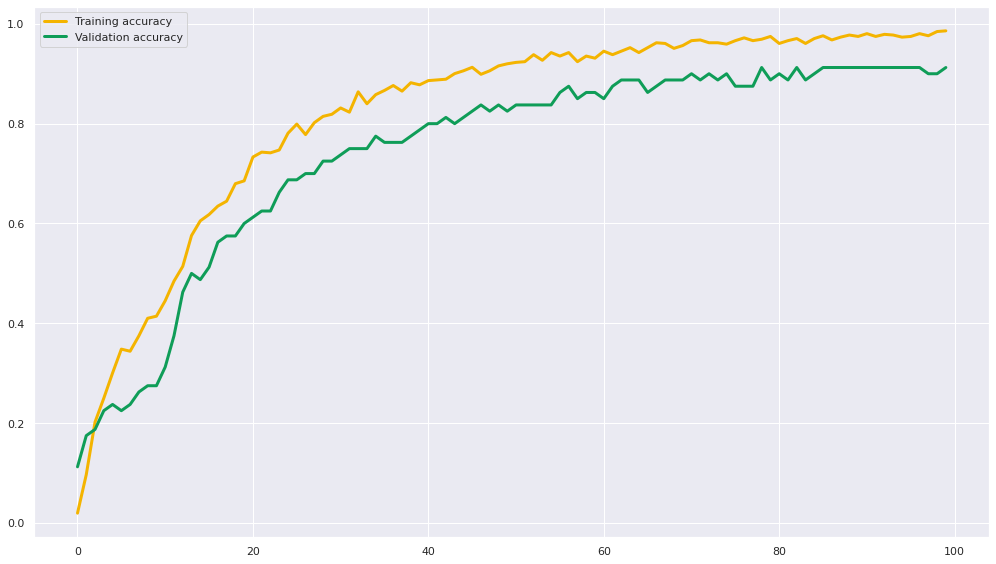

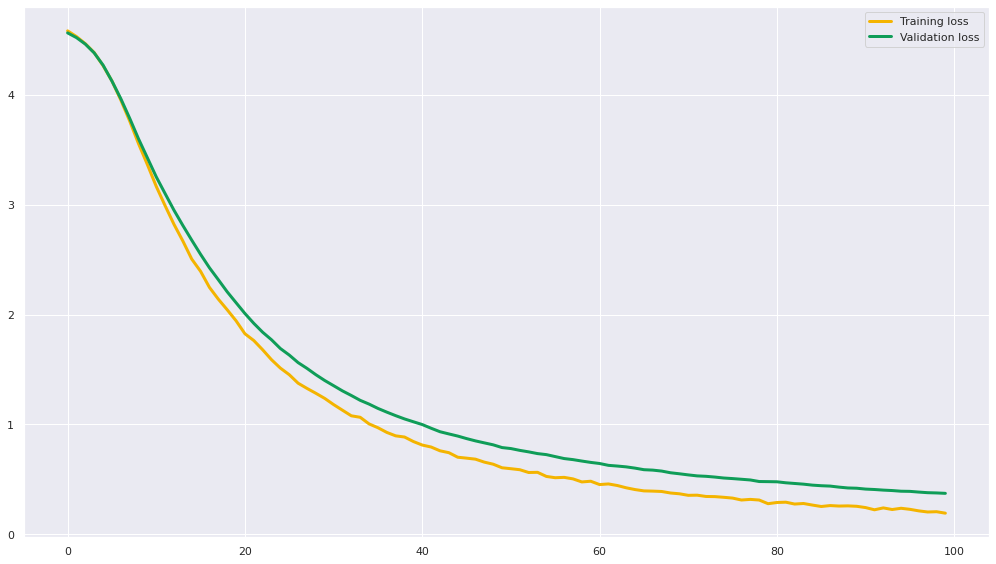

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 6ms/step - loss: 4.5826 - accuracy: 0.0295 - val_loss: 4.5642 - val_accuracy: 0.1125
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5298 - accuracy: 0.1222 - val_loss: 4.5214 - val_accuracy: 0.1625
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4714 - accuracy: 0.2051 - val_loss: 4.4628 - val_accuracy: 0.2000
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3913 - accuracy: 0.2430 - val_loss: 4.3824 - val_accuracy: 0.2125
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2871 - accuracy: 0.2753 - val_loss: 4.2716 - val_accuracy: 0.2875
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1419 - accuracy: 0.3301 - val_loss: 4.1265 - val_accuracy: 0.3250
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9704 

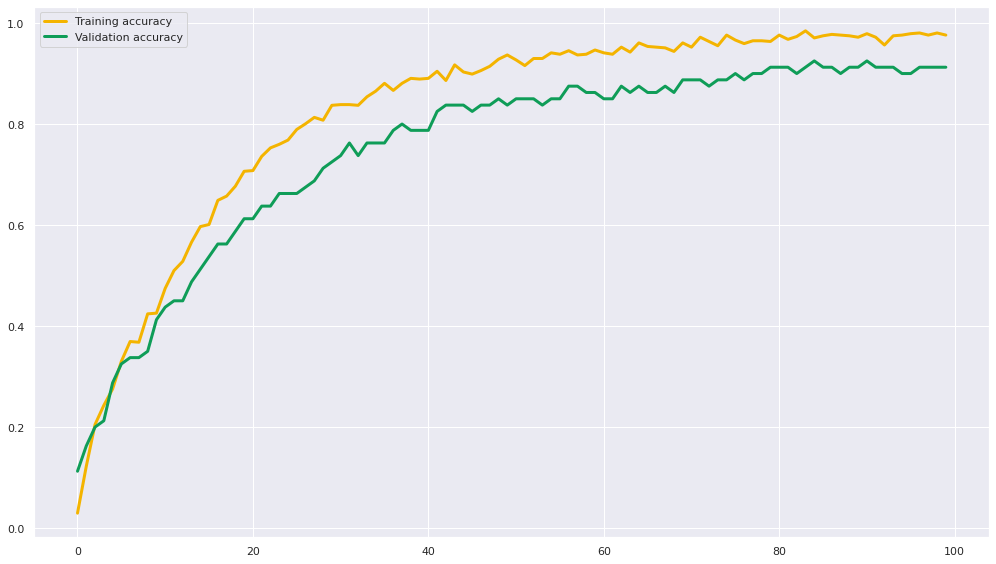

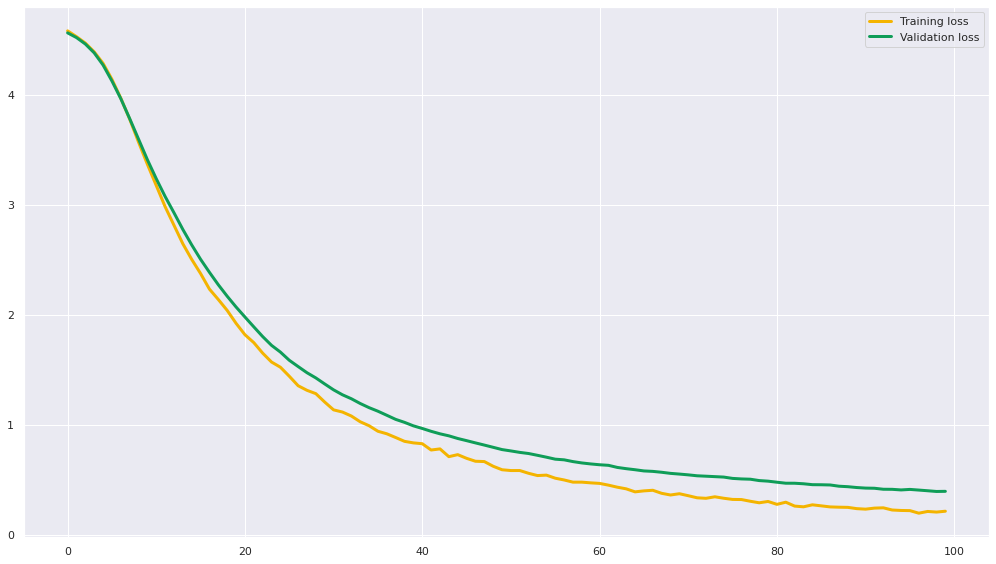

The batch_size is: 16, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5833 - accuracy: 0.0197 - val_loss: 4.5608 - val_accuracy: 0.0750
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.5309 - accuracy: 0.0927 - val_loss: 4.5184 - val_accuracy: 0.1250
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4708 - accuracy: 0.1784 - val_loss: 4.4593 - val_accuracy: 0.1750
Epoch 4/100
45/45 [==============================] - 0s 2ms/step - loss: 4.3885 - accuracy: 0.2402 - val_loss: 4.3773 - val_accuracy: 0.2125
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2748 - accuracy: 0.2697 - val_loss: 4.2608 - val_accuracy: 0.2375
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1340 - accuracy: 0.2851 - val_loss: 4.1185 - val_accuracy: 0.2750
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 3.9532 

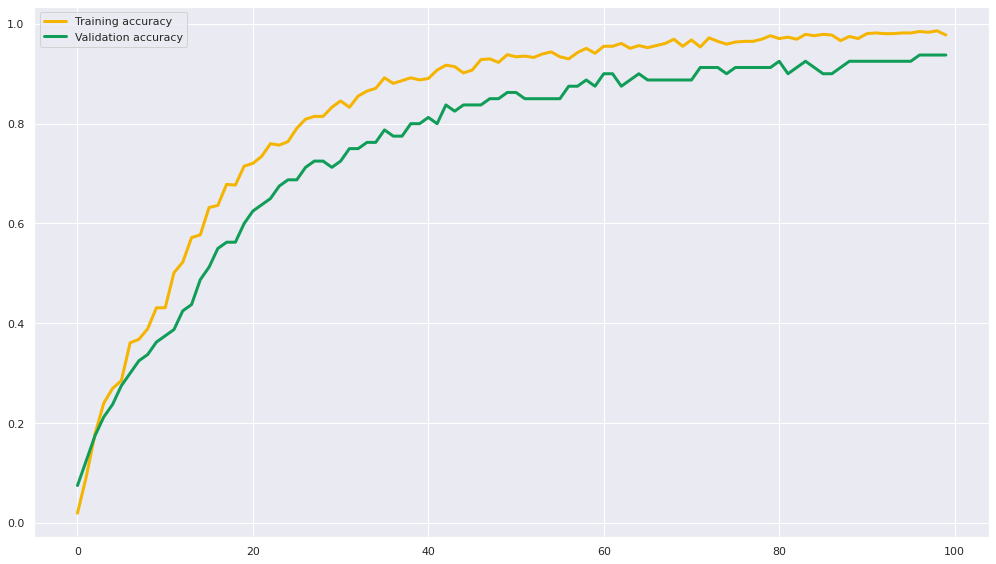

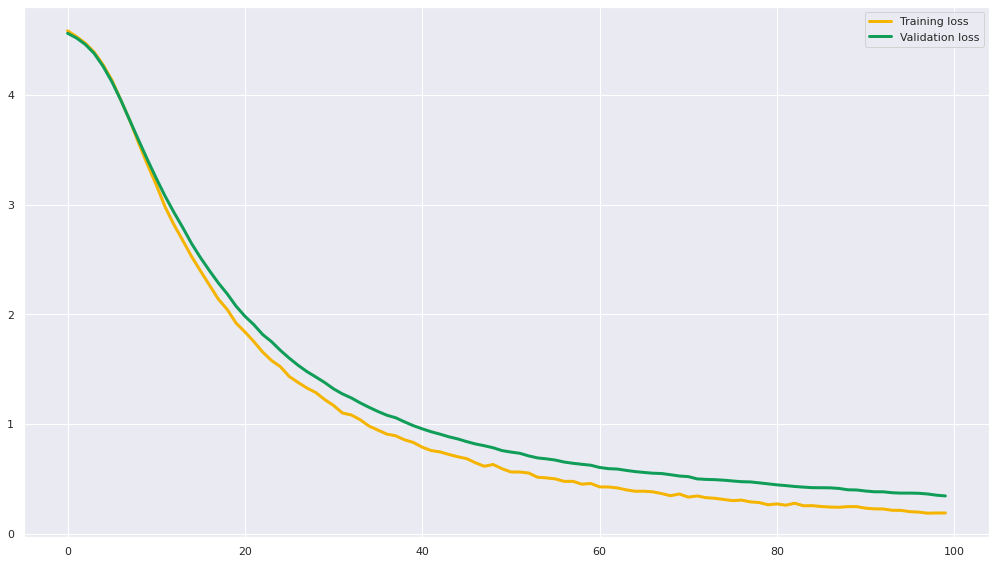

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5629 - accuracy: 0.0815 - val_loss: 4.5187 - val_accuracy: 0.1625
Epoch 2/100
45/45 [==============================] - 0s 4ms/step - loss: 4.4389 - accuracy: 0.2963 - val_loss: 4.3997 - val_accuracy: 0.2625
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.2593 - accuracy: 0.4073 - val_loss: 4.2104 - val_accuracy: 0.2750
Epoch 4/100
45/45 [==============================] - 0s 4ms/step - loss: 3.9894 - accuracy: 0.4143 - val_loss: 3.9251 - val_accuracy: 0.3625
Epoch 5/100
45/45 [==============================] - 0s 4ms/step - loss: 3.6428 - accuracy: 0.4565 - val_loss: 3.5960 - val_accuracy: 0.3625
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.2681 - accuracy: 0.5084 - val_loss: 3.2784 - val_accuracy: 0.3750
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 2.9032 

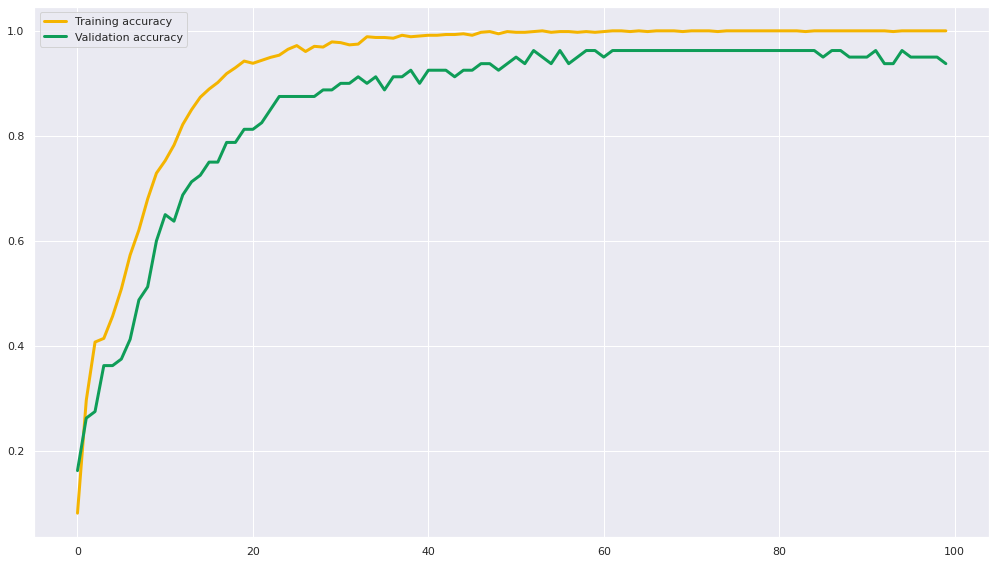

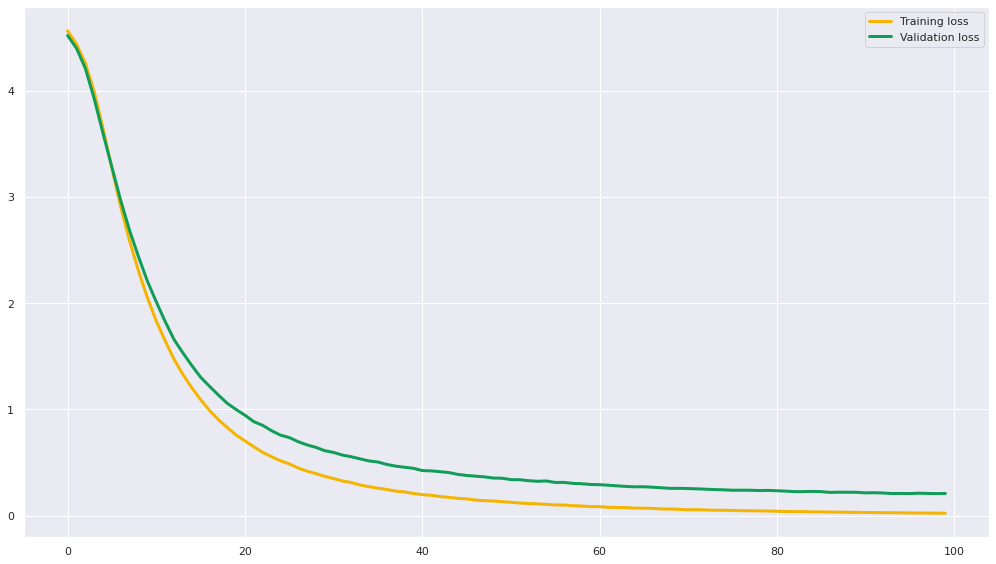

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5655 - accuracy: 0.0716 - val_loss: 4.5155 - val_accuracy: 0.2125
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4418 - accuracy: 0.2739 - val_loss: 4.3997 - val_accuracy: 0.2875
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2613 - accuracy: 0.4185 - val_loss: 4.2100 - val_accuracy: 0.3500
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9940 - accuracy: 0.4256 - val_loss: 3.9337 - val_accuracy: 0.3125
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 3.6480 - accuracy: 0.4424 - val_loss: 3.6116 - val_accuracy: 0.3500
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.2803 - accuracy: 0.5084 - val_loss: 3.2815 - val_accuracy: 0.3875
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 2.9279 

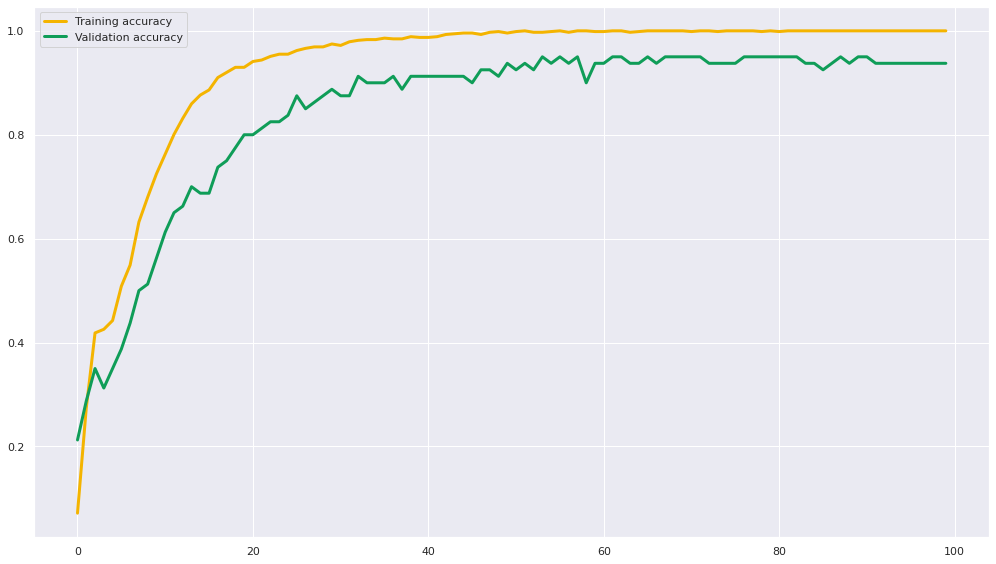

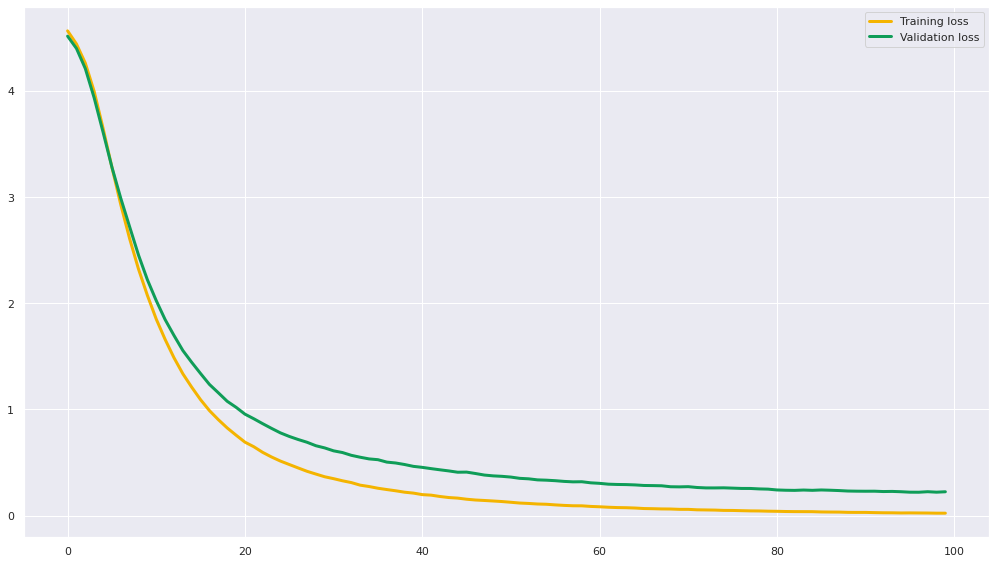

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 11ms/step - loss: 4.5643 - accuracy: 0.0899 - val_loss: 4.5193 - val_accuracy: 0.1750
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4407 - accuracy: 0.3160 - val_loss: 4.3998 - val_accuracy: 0.2375
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.2638 - accuracy: 0.3750 - val_loss: 4.2045 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9938 - accuracy: 0.4382 - val_loss: 3.9244 - val_accuracy: 0.3000
Epoch 5/100
45/45 [==============================] - 0s 5ms/step - loss: 3.6462 - accuracy: 0.4494 - val_loss: 3.5931 - val_accuracy: 0.3250
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 3.2732 - accuracy: 0.5126 - val_loss: 3.2595 - val_accuracy: 0.3875
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 2.9146

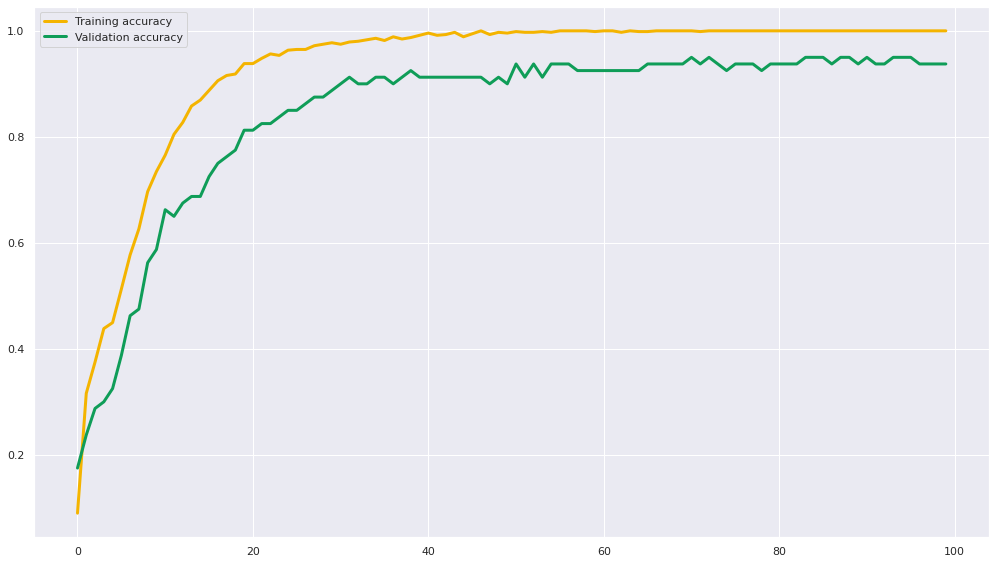

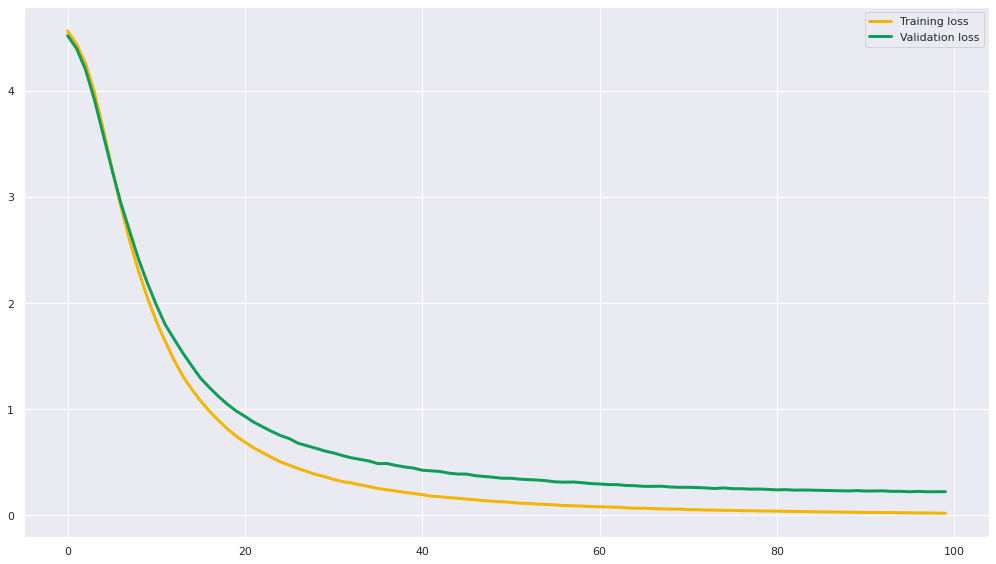

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5621 - accuracy: 0.0688 - val_loss: 4.5244 - val_accuracy: 0.2375
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4533 - accuracy: 0.3062 - val_loss: 4.4209 - val_accuracy: 0.2875
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.3023 - accuracy: 0.3848 - val_loss: 4.2683 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0859 - accuracy: 0.3497 - val_loss: 4.0328 - val_accuracy: 0.3125
Epoch 5/100
45/45 [==============================] - 0s 4ms/step - loss: 3.7955 - accuracy: 0.4228 - val_loss: 3.7443 - val_accuracy: 0.3500
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.4640 - accuracy: 0.4621 - val_loss: 3.4555 - val_accuracy: 0.3625
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 3.1331 

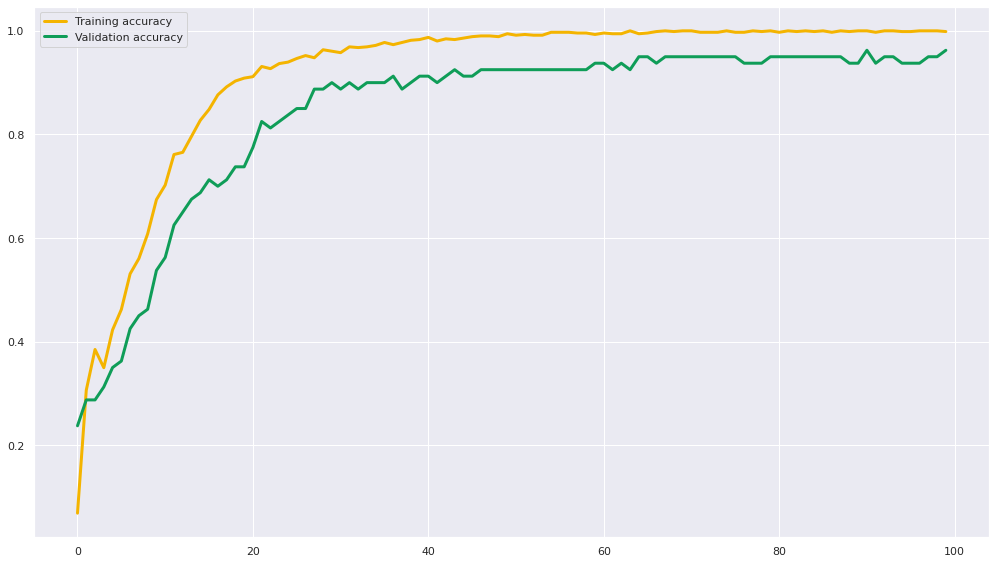

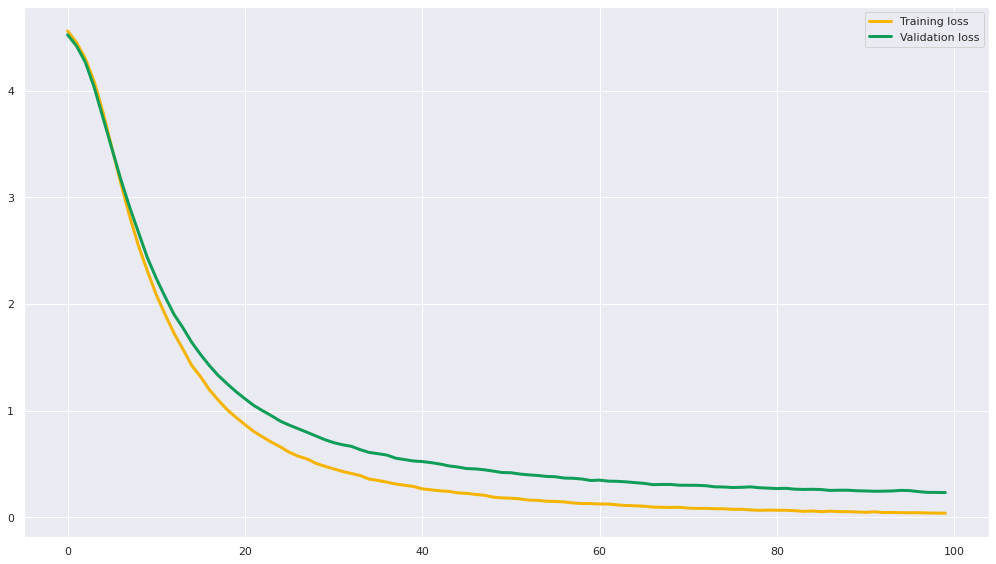

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 10ms/step - loss: 4.5694 - accuracy: 0.0618 - val_loss: 4.5177 - val_accuracy: 0.2000
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4624 - accuracy: 0.2472 - val_loss: 4.4230 - val_accuracy: 0.2500
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.3146 - accuracy: 0.3708 - val_loss: 4.2642 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0980 - accuracy: 0.4199 - val_loss: 4.0454 - val_accuracy: 0.3250
Epoch 5/100
45/45 [==============================] - 0s 4ms/step - loss: 3.8137 - accuracy: 0.4312 - val_loss: 3.7598 - val_accuracy: 0.3375
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 3.4804 - accuracy: 0.4705 - val_loss: 3.4583 - val_accuracy: 0.3875
Epoch 7/100
45/45 [==============================] - 0s 5ms/step - loss: 3.1538

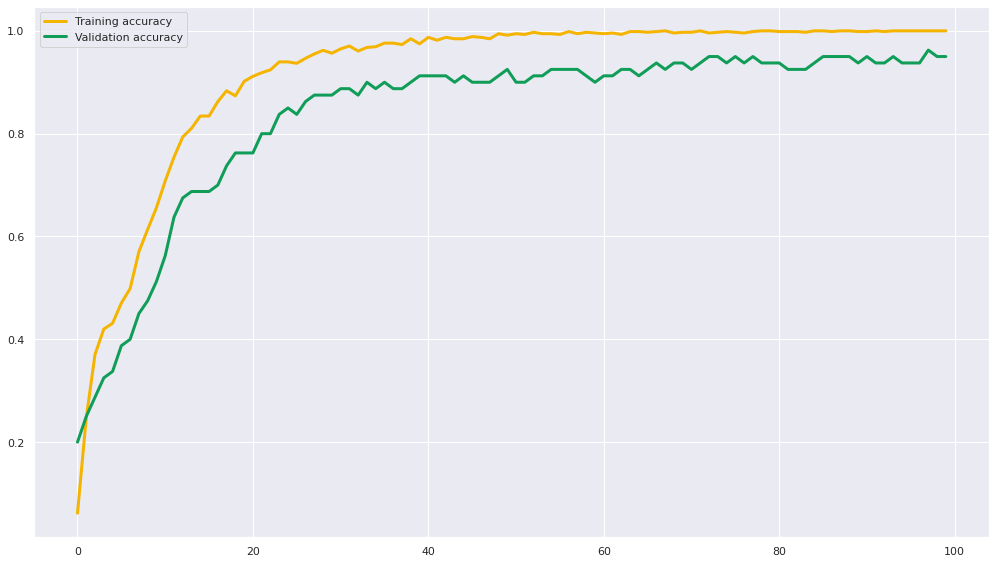

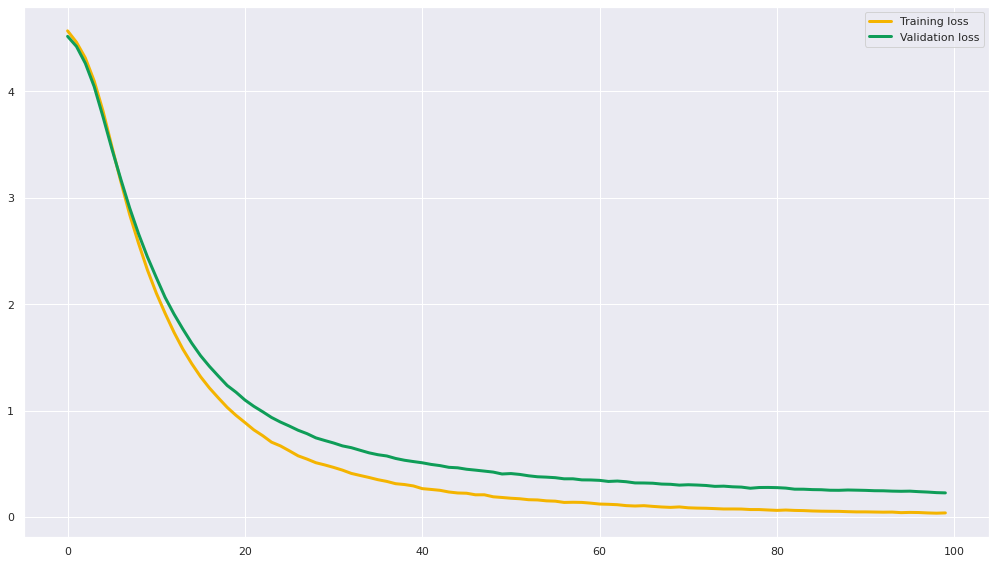

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5690 - accuracy: 0.0618 - val_loss: 4.5247 - val_accuracy: 0.1625
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4602 - accuracy: 0.2963 - val_loss: 4.4243 - val_accuracy: 0.3000
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3153 - accuracy: 0.3764 - val_loss: 4.2712 - val_accuracy: 0.2875
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.1029 - accuracy: 0.3933 - val_loss: 4.0441 - val_accuracy: 0.3375
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 3.8155 - accuracy: 0.4298 - val_loss: 3.7617 - val_accuracy: 0.3500
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.4862 - accuracy: 0.4663 - val_loss: 3.4561 - val_accuracy: 0.3875
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.1527 

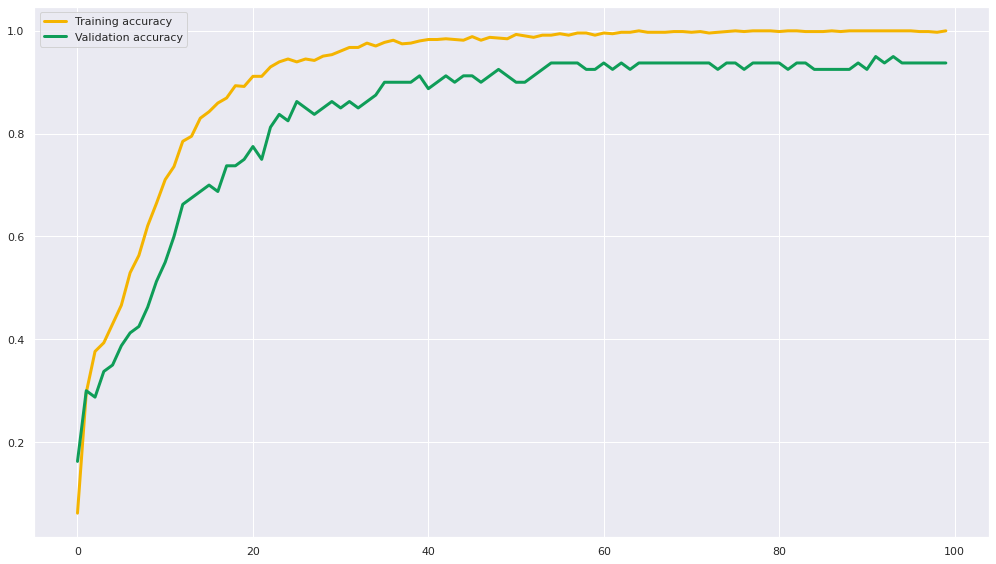

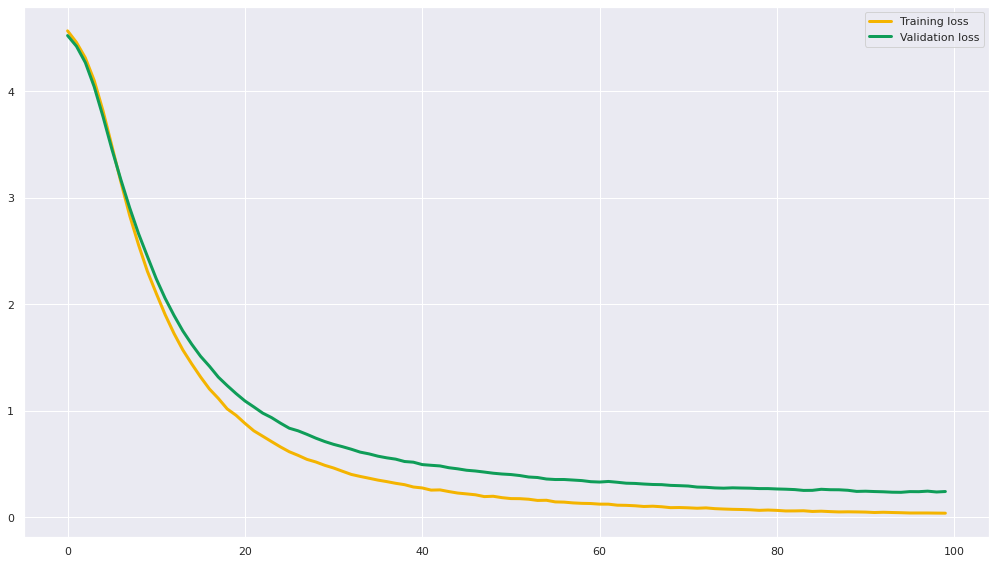

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 4.5768 - accuracy: 0.0351 - val_loss: 4.5415 - val_accuracy: 0.1125
Epoch 2/100
45/45 [==============================] - 0s 4ms/step - loss: 4.4861 - accuracy: 0.2107 - val_loss: 4.4614 - val_accuracy: 0.2375
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3719 - accuracy: 0.3483 - val_loss: 4.3470 - val_accuracy: 0.3500
Epoch 4/100
45/45 [==============================] - 0s 4ms/step - loss: 4.2136 - accuracy: 0.3722 - val_loss: 4.1841 - val_accuracy: 0.3500
Epoch 5/100
45/45 [==============================] - 0s 4ms/step - loss: 4.0010 - accuracy: 0.4073 - val_loss: 3.9723 - val_accuracy: 0.3500
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 3.7450 - accuracy: 0.4579 - val_loss: 3.7213 - val_accuracy: 0.4125
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 3.4629 

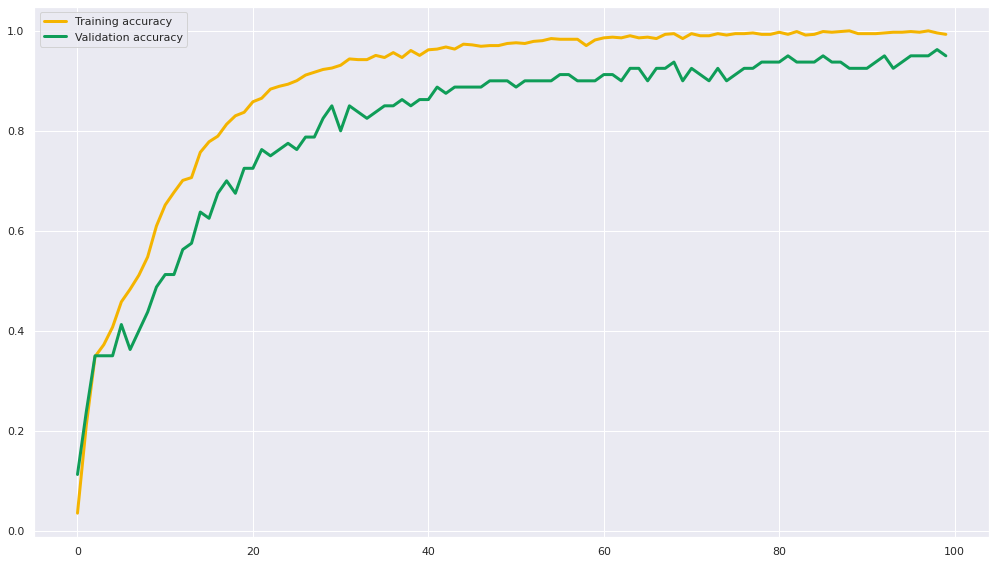

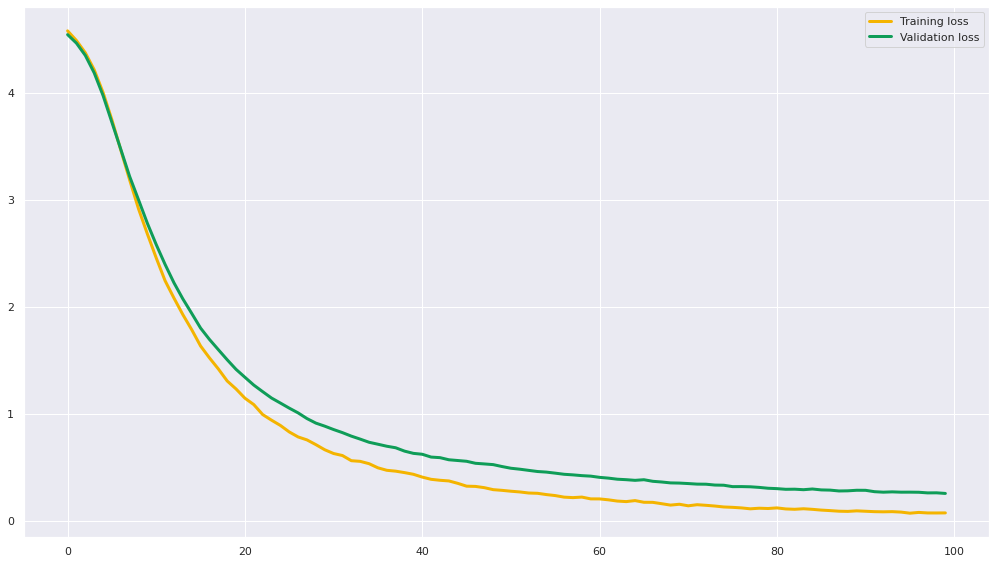

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 7ms/step - loss: 4.5801 - accuracy: 0.0323 - val_loss: 4.5402 - val_accuracy: 0.1000
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4906 - accuracy: 0.1404 - val_loss: 4.4636 - val_accuracy: 0.1500
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3742 - accuracy: 0.2851 - val_loss: 4.3563 - val_accuracy: 0.2625
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2243 - accuracy: 0.3188 - val_loss: 4.1949 - val_accuracy: 0.2875
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 4.0121 - accuracy: 0.3638 - val_loss: 3.9804 - val_accuracy: 0.3000
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.7545 - accuracy: 0.3961 - val_loss: 3.7349 - val_accuracy: 0.3750
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.4814 

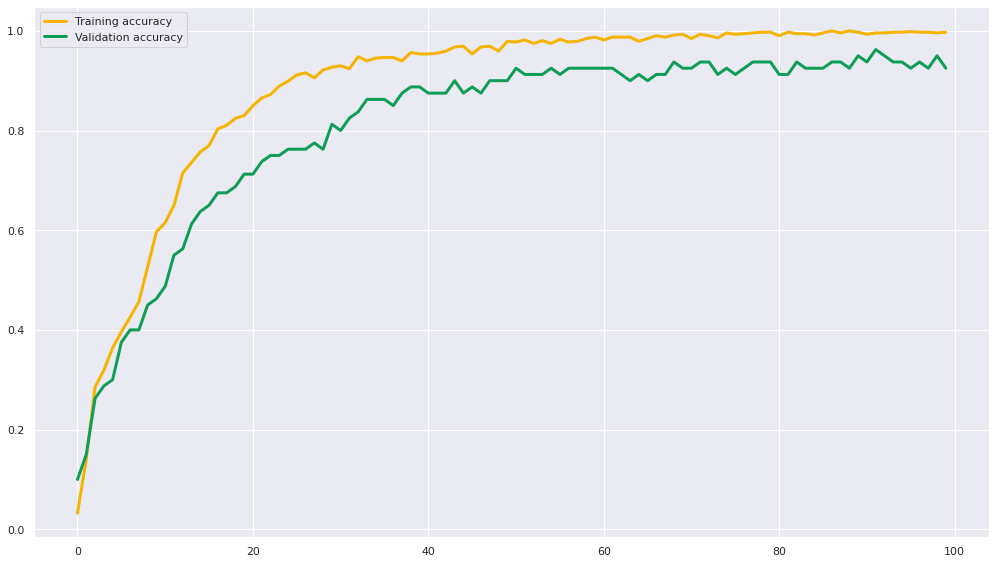

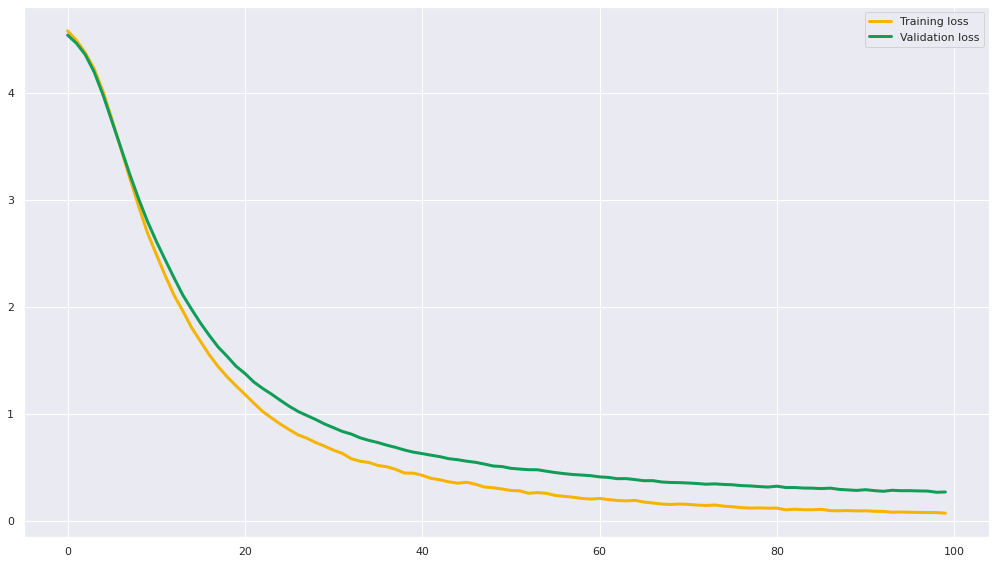

The batch_size is: 16, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 4.5741 - accuracy: 0.0281 - val_loss: 4.5445 - val_accuracy: 0.0750
Epoch 2/100
45/45 [==============================] - 0s 3ms/step - loss: 4.4898 - accuracy: 0.1784 - val_loss: 4.4685 - val_accuracy: 0.2000
Epoch 3/100
45/45 [==============================] - 0s 3ms/step - loss: 4.3731 - accuracy: 0.2697 - val_loss: 4.3531 - val_accuracy: 0.2625
Epoch 4/100
45/45 [==============================] - 0s 3ms/step - loss: 4.2163 - accuracy: 0.3315 - val_loss: 4.1880 - val_accuracy: 0.3250
Epoch 5/100
45/45 [==============================] - 0s 3ms/step - loss: 3.9998 - accuracy: 0.3638 - val_loss: 3.9741 - val_accuracy: 0.3625
Epoch 6/100
45/45 [==============================] - 0s 3ms/step - loss: 3.7513 - accuracy: 0.3890 - val_loss: 3.7319 - val_accuracy: 0.3500
Epoch 7/100
45/45 [==============================] - 0s 3ms/step - loss: 3.4613 

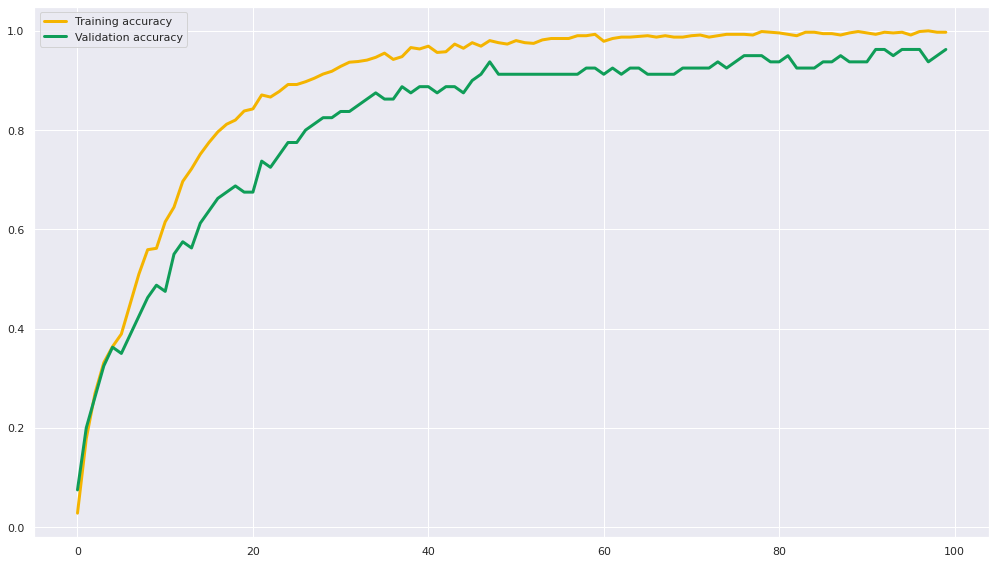

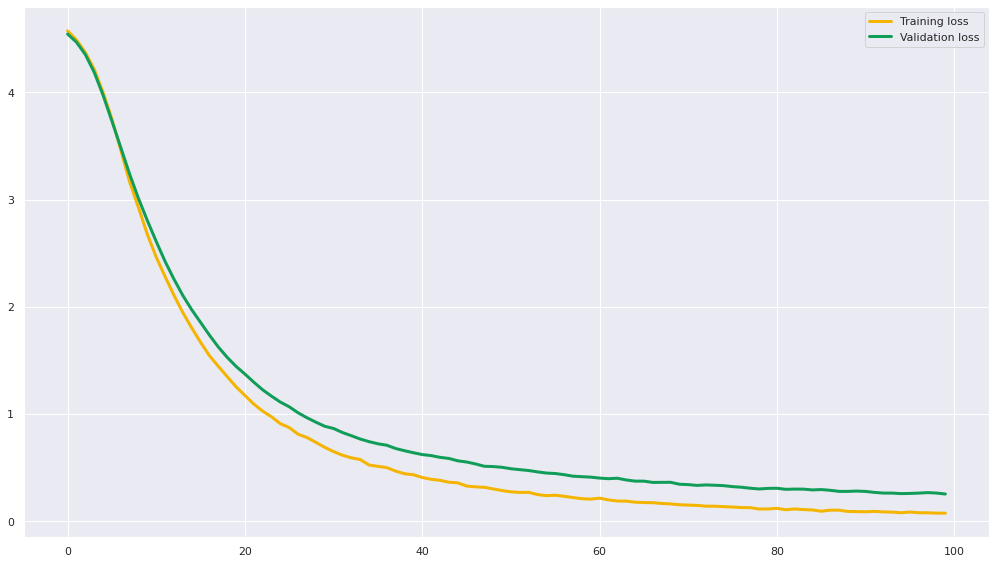

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5471 - accuracy: 0.0843 - val_loss: 4.4735 - val_accuracy: 0.2375
Epoch 2/100
45/45 [==============================] - 0s 5ms/step - loss: 4.3443 - accuracy: 0.4157 - val_loss: 4.2559 - val_accuracy: 0.3500
Epoch 3/100
45/45 [==============================] - 0s 5ms/step - loss: 4.0227 - accuracy: 0.4340 - val_loss: 3.8976 - val_accuracy: 0.3500
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.5475 - accuracy: 0.4916 - val_loss: 3.4306 - val_accuracy: 0.4000
Epoch 5/100
45/45 [==============================] - 0s 5ms/step - loss: 3.0334 - accuracy: 0.5604 - val_loss: 2.9845 - val_accuracy: 0.4125
Epoch 6/100
45/45 [==============================] - 0s 5ms/step - loss: 2.5752 - accuracy: 0.6194 - val_loss: 2.5990 - val_accuracy: 0.5250
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 2.1814 

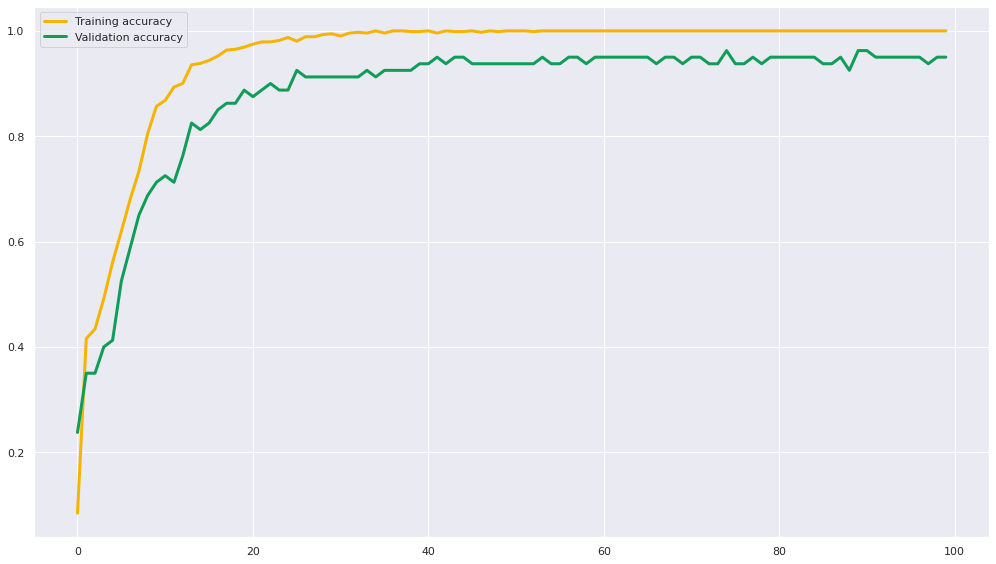

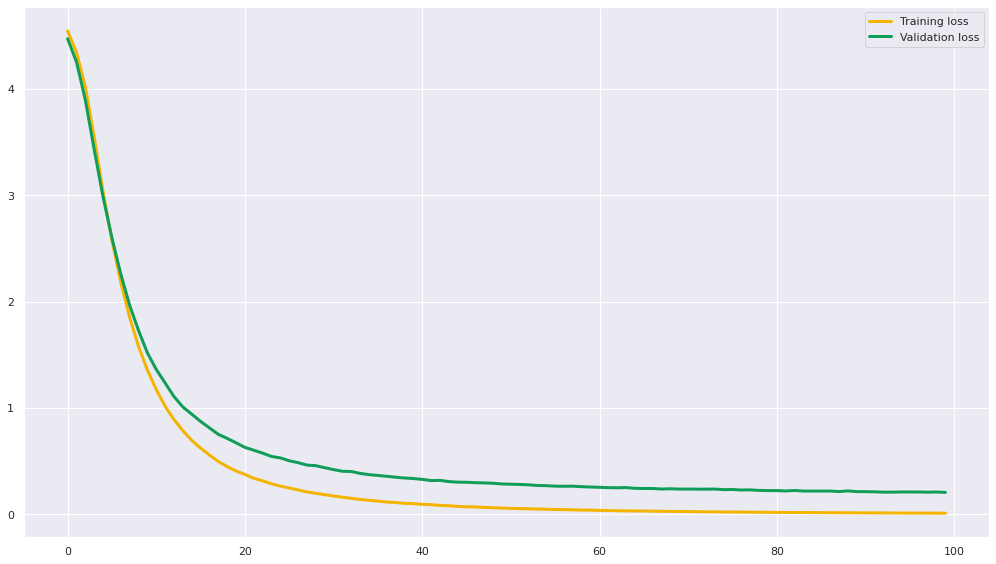

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 10ms/step - loss: 4.5485 - accuracy: 0.1138 - val_loss: 4.4745 - val_accuracy: 0.2500
Epoch 2/100
45/45 [==============================] - 0s 4ms/step - loss: 4.3484 - accuracy: 0.3764 - val_loss: 4.2624 - val_accuracy: 0.3250
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.0280 - accuracy: 0.4522 - val_loss: 3.9073 - val_accuracy: 0.3500
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.5598 - accuracy: 0.4831 - val_loss: 3.4467 - val_accuracy: 0.4125
Epoch 5/100
45/45 [==============================] - 0s 5ms/step - loss: 3.0465 - accuracy: 0.5772 - val_loss: 3.0014 - val_accuracy: 0.4375
Epoch 6/100
45/45 [==============================] - 0s 5ms/step - loss: 2.5816 - accuracy: 0.6236 - val_loss: 2.6035 - val_accuracy: 0.5000
Epoch 7/100
45/45 [==============================] - 0s 5ms/step - loss: 2.1921

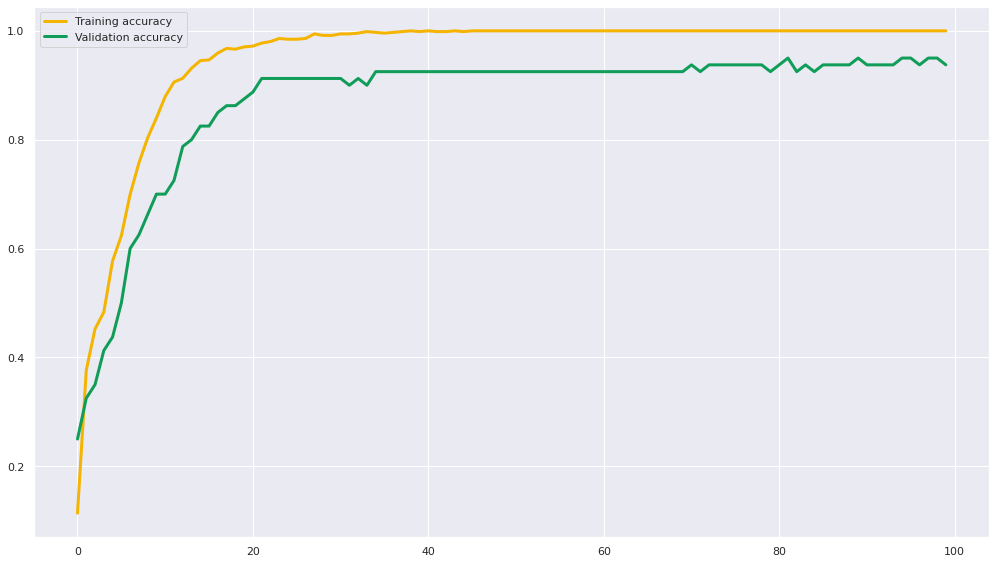

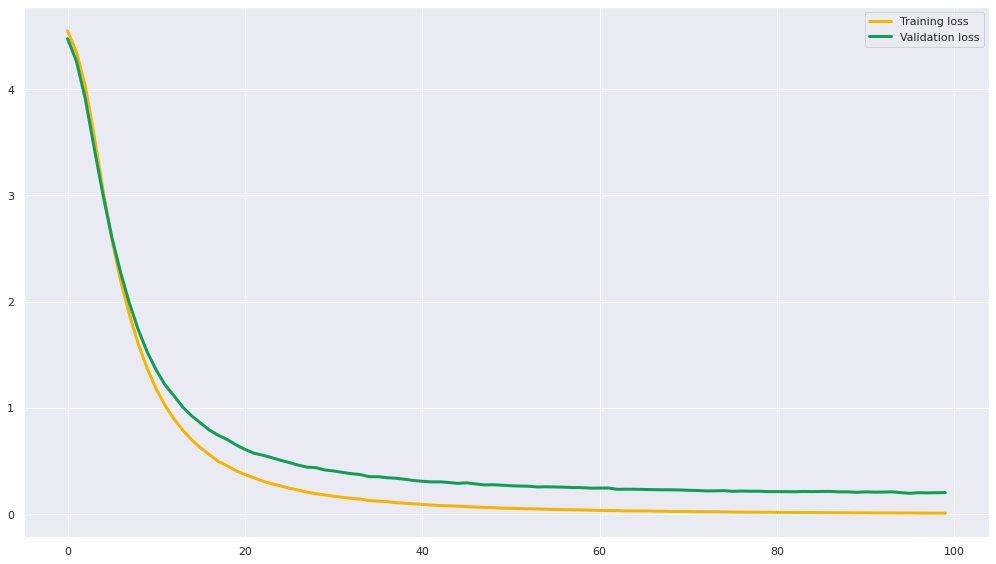

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
45/45 [==============================] - 1s 11ms/step - loss: 4.5434 - accuracy: 0.0758 - val_loss: 4.4633 - val_accuracy: 0.2250
Epoch 2/100
45/45 [==============================] - 0s 6ms/step - loss: 4.3337 - accuracy: 0.3511 - val_loss: 4.2356 - val_accuracy: 0.2750
Epoch 3/100
45/45 [==============================] - 0s 6ms/step - loss: 4.0059 - accuracy: 0.4157 - val_loss: 3.8639 - val_accuracy: 0.3375
Epoch 4/100
45/45 [==============================] - 0s 7ms/step - loss: 3.5304 - accuracy: 0.4761 - val_loss: 3.4082 - val_accuracy: 0.4000
Epoch 5/100
45/45 [==============================] - 0s 6ms/step - loss: 3.0203 - accuracy: 0.5632 - val_loss: 2.9773 - val_accuracy: 0.4500
Epoch 6/100
45/45 [==============================] - 0s 8ms/step - loss: 2.5719 - accuracy: 0.6334 - val_loss: 2.5933 - val_accuracy: 0.5125
Epoch 7/100
45/45 [==============================] - 0s 6ms/step - loss: 2.1890

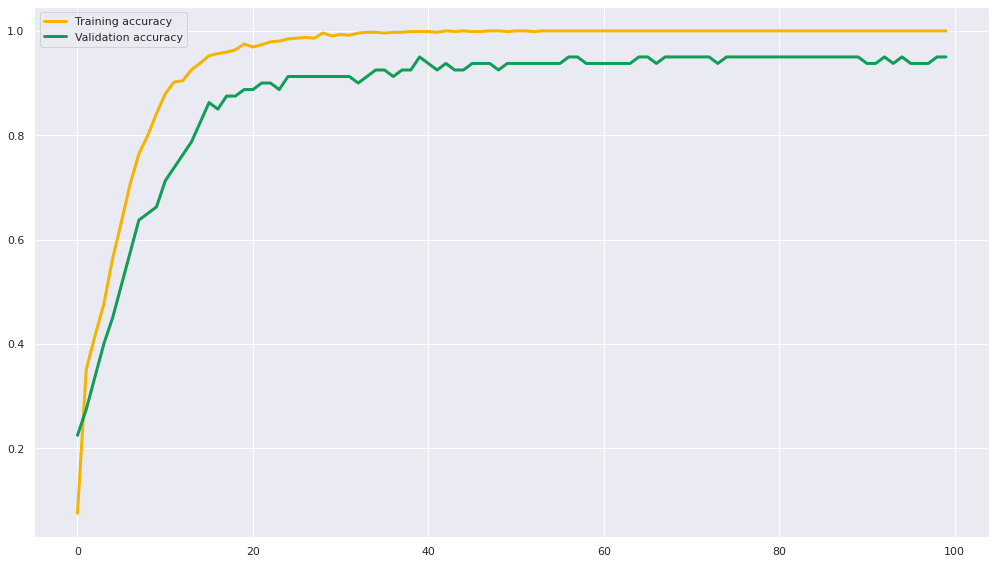

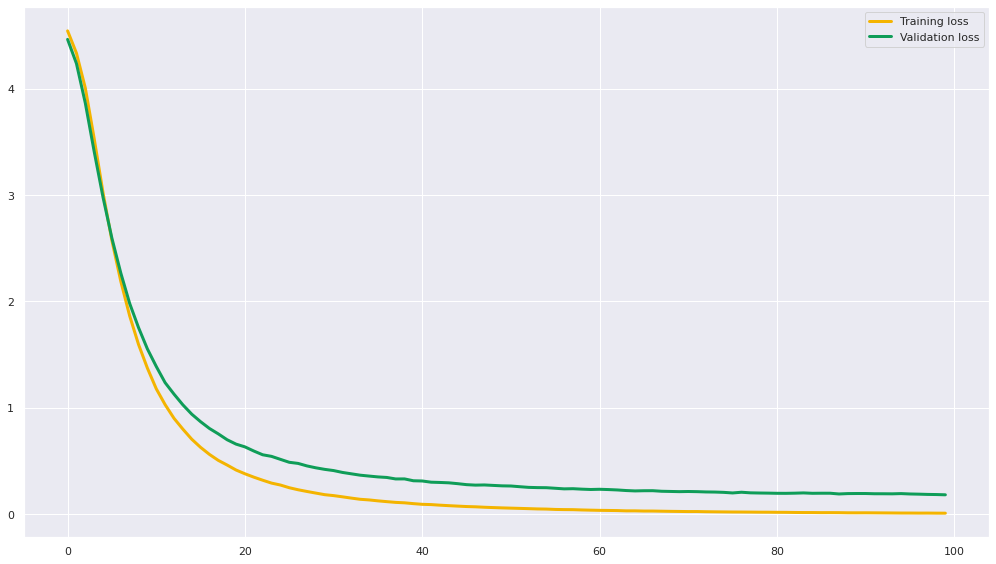

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 10ms/step - loss: 4.5518 - accuracy: 0.0801 - val_loss: 4.4831 - val_accuracy: 0.2750
Epoch 2/100
45/45 [==============================] - 0s 5ms/step - loss: 4.3766 - accuracy: 0.3427 - val_loss: 4.3026 - val_accuracy: 0.3250
Epoch 3/100
45/45 [==============================] - 0s 6ms/step - loss: 4.1029 - accuracy: 0.4242 - val_loss: 4.0084 - val_accuracy: 0.3500
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.7197 - accuracy: 0.4621 - val_loss: 3.6159 - val_accuracy: 0.3750
Epoch 5/100
45/45 [==============================] - 0s 5ms/step - loss: 3.2631 - accuracy: 0.5379 - val_loss: 3.2059 - val_accuracy: 0.4250
Epoch 6/100
45/45 [==============================] - 0s 5ms/step - loss: 2.8267 - accuracy: 0.5843 - val_loss: 2.8330 - val_accuracy: 0.4500
Epoch 7/100
45/45 [==============================] - 0s 6ms/step - loss: 2.4466

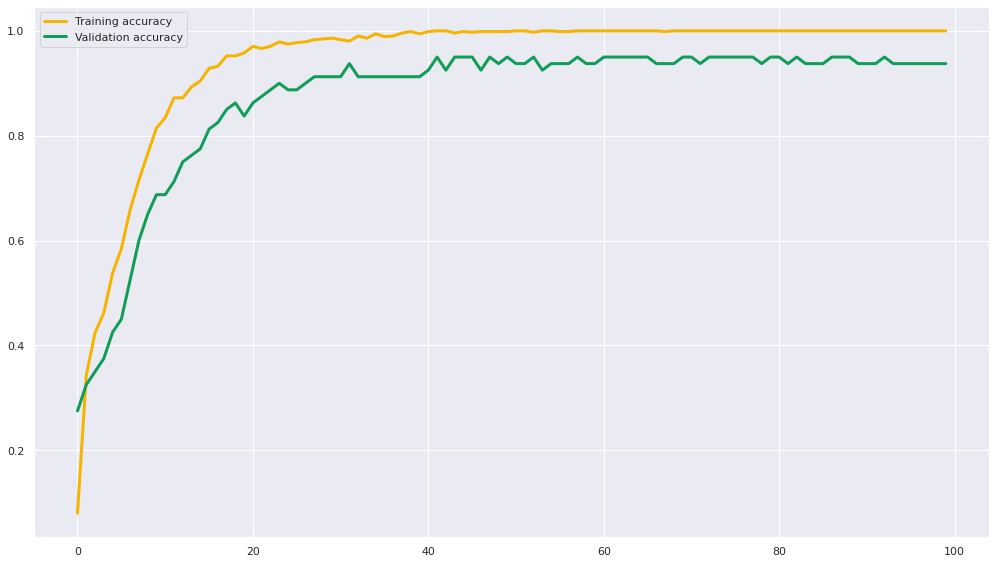

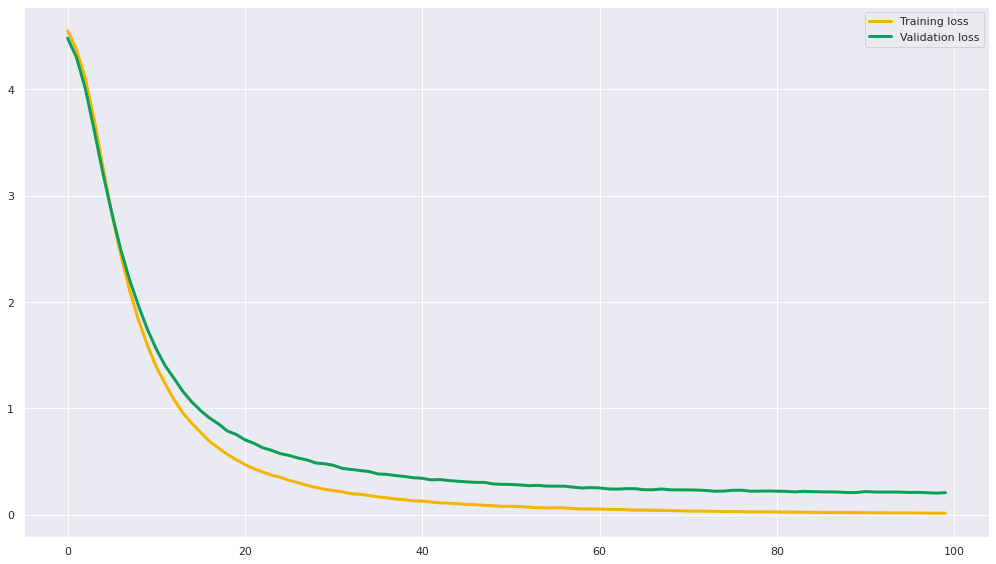

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5568 - accuracy: 0.0604 - val_loss: 4.4808 - val_accuracy: 0.2125
Epoch 2/100
45/45 [==============================] - 0s 5ms/step - loss: 4.3768 - accuracy: 0.3708 - val_loss: 4.2991 - val_accuracy: 0.3625
Epoch 3/100
45/45 [==============================] - 0s 6ms/step - loss: 4.1066 - accuracy: 0.4593 - val_loss: 3.9954 - val_accuracy: 0.4125
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.7178 - accuracy: 0.4874 - val_loss: 3.6025 - val_accuracy: 0.4125
Epoch 5/100
45/45 [==============================] - 0s 5ms/step - loss: 3.2597 - accuracy: 0.5267 - val_loss: 3.1985 - val_accuracy: 0.4375
Epoch 6/100
45/45 [==============================] - 0s 4ms/step - loss: 2.8190 - accuracy: 0.5913 - val_loss: 2.8131 - val_accuracy: 0.4875
Epoch 7/100
45/45 [==============================] - 0s 5ms/step - loss: 2.4347 

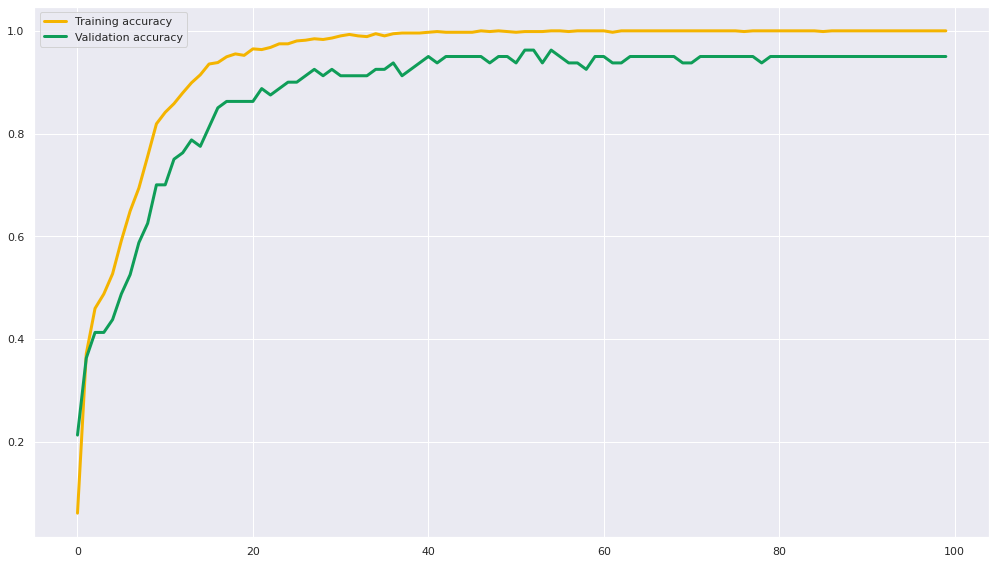

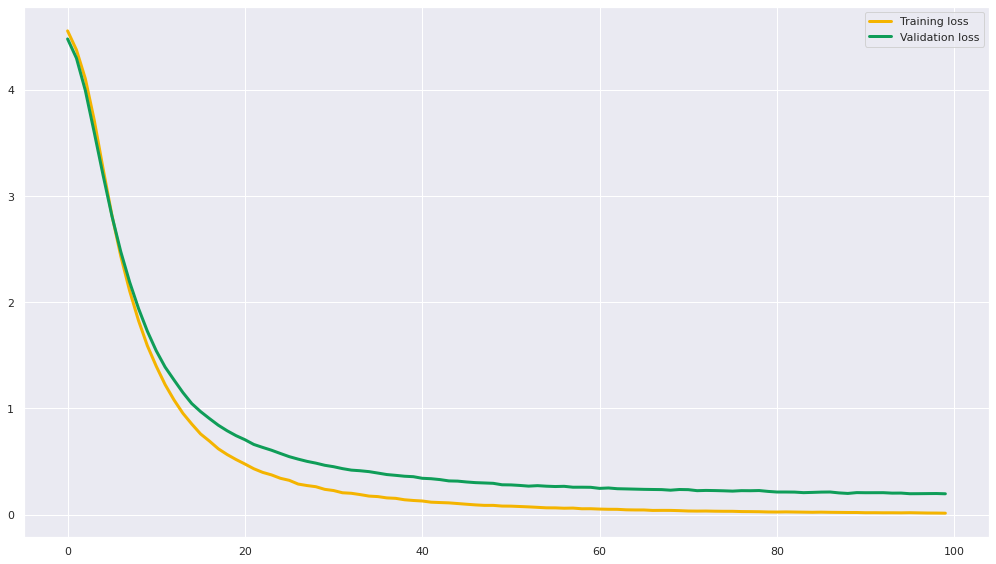

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
45/45 [==============================] - 1s 8ms/step - loss: 4.5518 - accuracy: 0.0983 - val_loss: 4.4845 - val_accuracy: 0.1750
Epoch 2/100
45/45 [==============================] - 0s 4ms/step - loss: 4.3772 - accuracy: 0.3624 - val_loss: 4.3065 - val_accuracy: 0.2625
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.1108 - accuracy: 0.4452 - val_loss: 4.0156 - val_accuracy: 0.3250
Epoch 4/100
45/45 [==============================] - 0s 6ms/step - loss: 3.7177 - accuracy: 0.4663 - val_loss: 3.6213 - val_accuracy: 0.3375
Epoch 5/100
45/45 [==============================] - 0s 6ms/step - loss: 3.2620 - accuracy: 0.5267 - val_loss: 3.2258 - val_accuracy: 0.4250
Epoch 6/100
45/45 [==============================] - 0s 5ms/step - loss: 2.8296 - accuracy: 0.6011 - val_loss: 2.8435 - val_accuracy: 0.4750
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 2.4497 

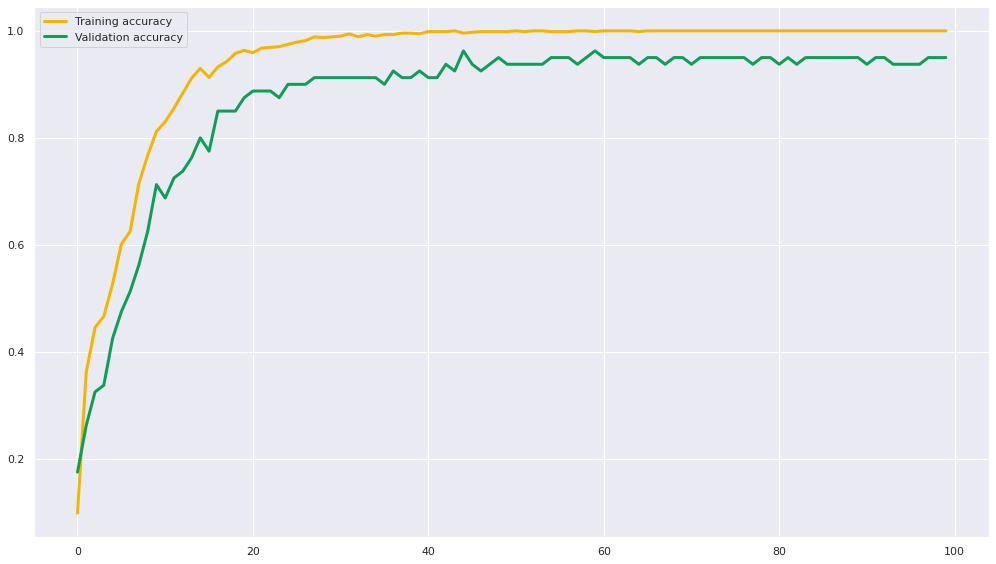

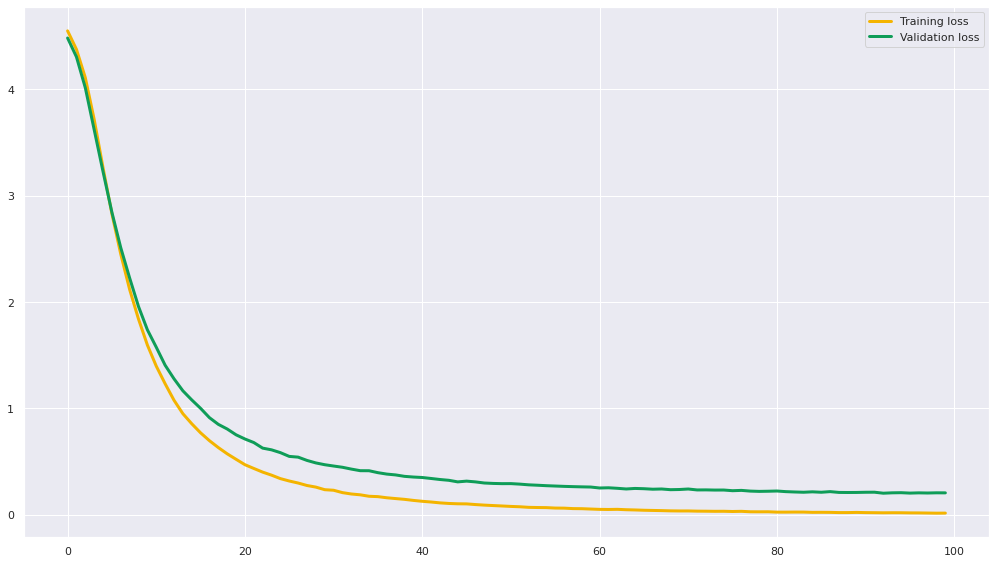

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5629 - accuracy: 0.0548 - val_loss: 4.5020 - val_accuracy: 0.1250
Epoch 2/100
45/45 [==============================] - 0s 5ms/step - loss: 4.4130 - accuracy: 0.2725 - val_loss: 4.3643 - val_accuracy: 0.3250
Epoch 3/100
45/45 [==============================] - 0s 5ms/step - loss: 4.2097 - accuracy: 0.3511 - val_loss: 4.1510 - val_accuracy: 0.2625
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.9168 - accuracy: 0.3834 - val_loss: 3.8447 - val_accuracy: 0.2875
Epoch 5/100
45/45 [==============================] - 0s 6ms/step - loss: 3.5482 - accuracy: 0.4565 - val_loss: 3.5009 - val_accuracy: 0.3500
Epoch 6/100
45/45 [==============================] - 0s 5ms/step - loss: 3.1621 - accuracy: 0.5281 - val_loss: 3.1510 - val_accuracy: 0.4125
Epoch 7/100
45/45 [==============================] - 0s 5ms/step - loss: 2.8013 

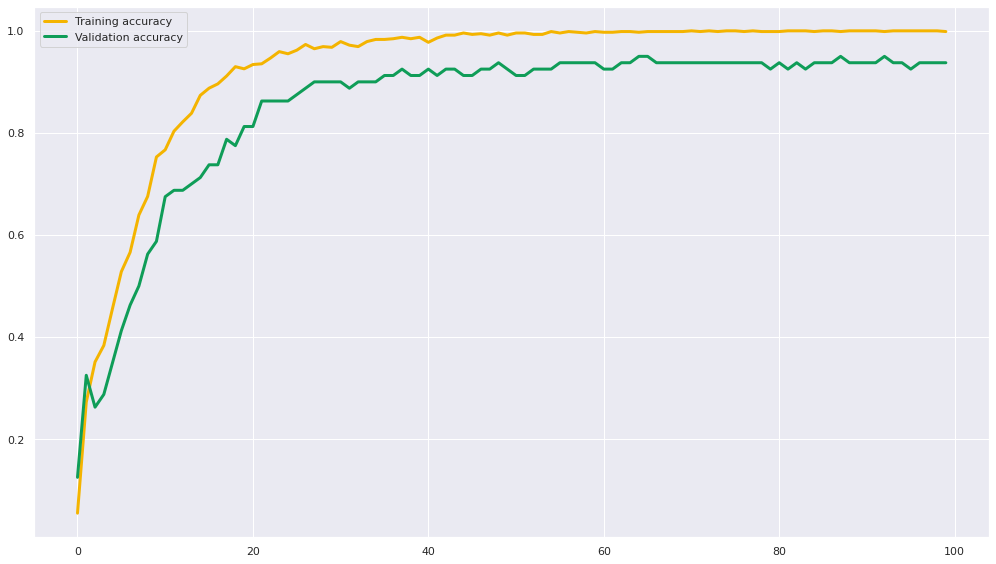

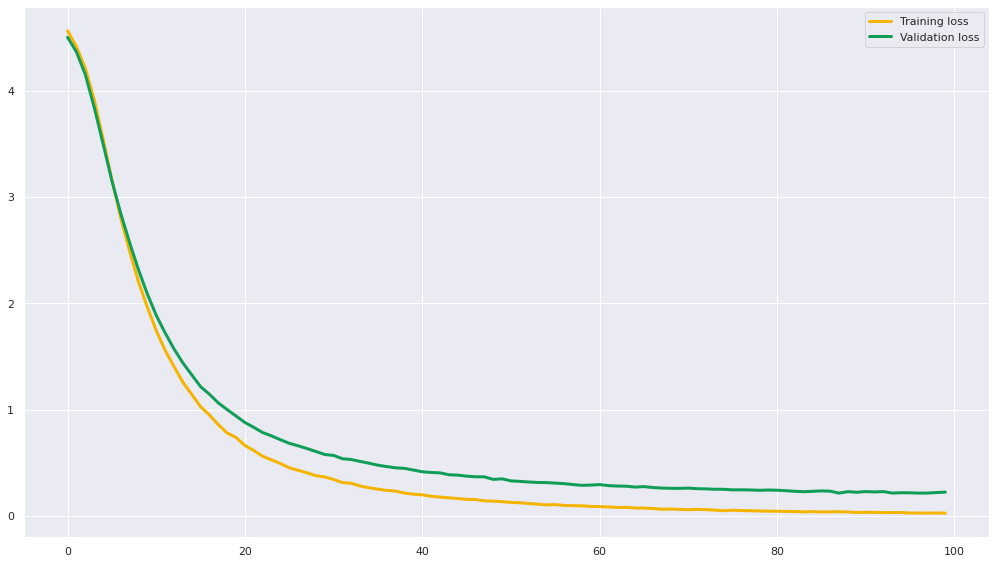

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5635 - accuracy: 0.0618 - val_loss: 4.5070 - val_accuracy: 0.2000
Epoch 2/100
45/45 [==============================] - 0s 5ms/step - loss: 4.4155 - accuracy: 0.2739 - val_loss: 4.3641 - val_accuracy: 0.3125
Epoch 3/100
45/45 [==============================] - 0s 5ms/step - loss: 4.2161 - accuracy: 0.3441 - val_loss: 4.1529 - val_accuracy: 0.3750
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.9252 - accuracy: 0.4382 - val_loss: 3.8494 - val_accuracy: 0.3625
Epoch 5/100
45/45 [==============================] - 0s 7ms/step - loss: 3.5530 - accuracy: 0.4649 - val_loss: 3.4978 - val_accuracy: 0.4000
Epoch 6/100
45/45 [==============================] - 0s 6ms/step - loss: 3.1624 - accuracy: 0.5197 - val_loss: 3.1501 - val_accuracy: 0.4125
Epoch 7/100
45/45 [==============================] - 0s 6ms/step - loss: 2.7992 

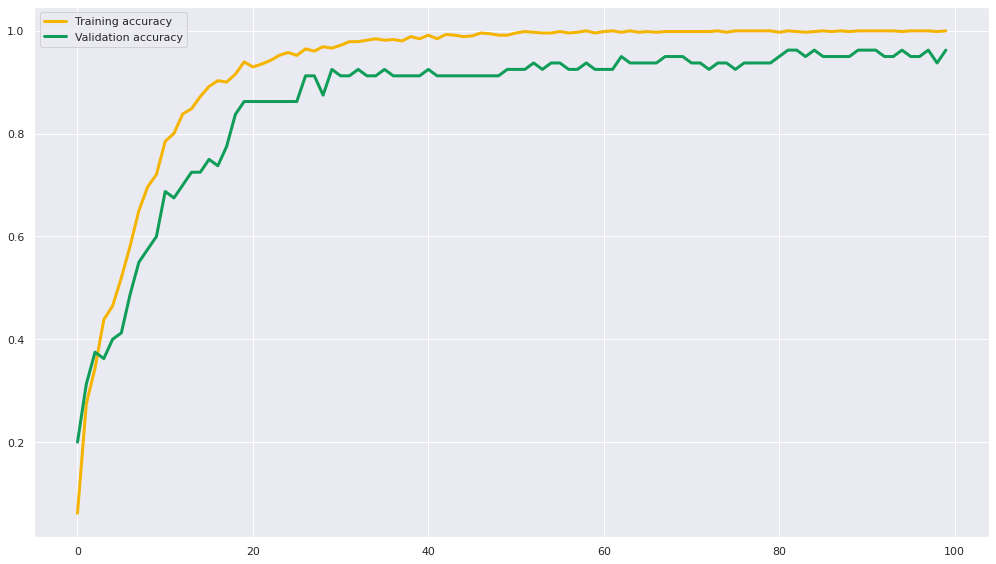

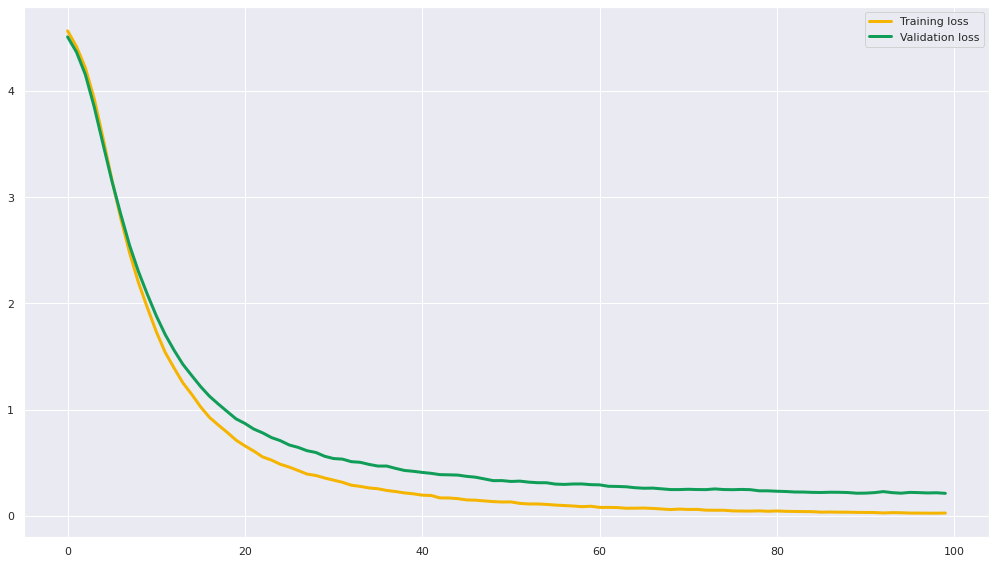

The batch_size is: 16, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
45/45 [==============================] - 1s 9ms/step - loss: 4.5638 - accuracy: 0.0435 - val_loss: 4.5099 - val_accuracy: 0.0750
Epoch 2/100
45/45 [==============================] - 0s 5ms/step - loss: 4.4168 - accuracy: 0.2683 - val_loss: 4.3749 - val_accuracy: 0.2375
Epoch 3/100
45/45 [==============================] - 0s 4ms/step - loss: 4.2184 - accuracy: 0.3427 - val_loss: 4.1620 - val_accuracy: 0.2250
Epoch 4/100
45/45 [==============================] - 0s 5ms/step - loss: 3.9253 - accuracy: 0.4298 - val_loss: 3.8630 - val_accuracy: 0.3125
Epoch 5/100
45/45 [==============================] - 0s 4ms/step - loss: 3.5627 - accuracy: 0.4396 - val_loss: 3.5205 - val_accuracy: 0.3625
Epoch 6/100
45/45 [==============================] - 0s 5ms/step - loss: 3.1723 - accuracy: 0.5070 - val_loss: 3.1796 - val_accuracy: 0.4000
Epoch 7/100
45/45 [==============================] - 0s 4ms/step - loss: 2.8220 

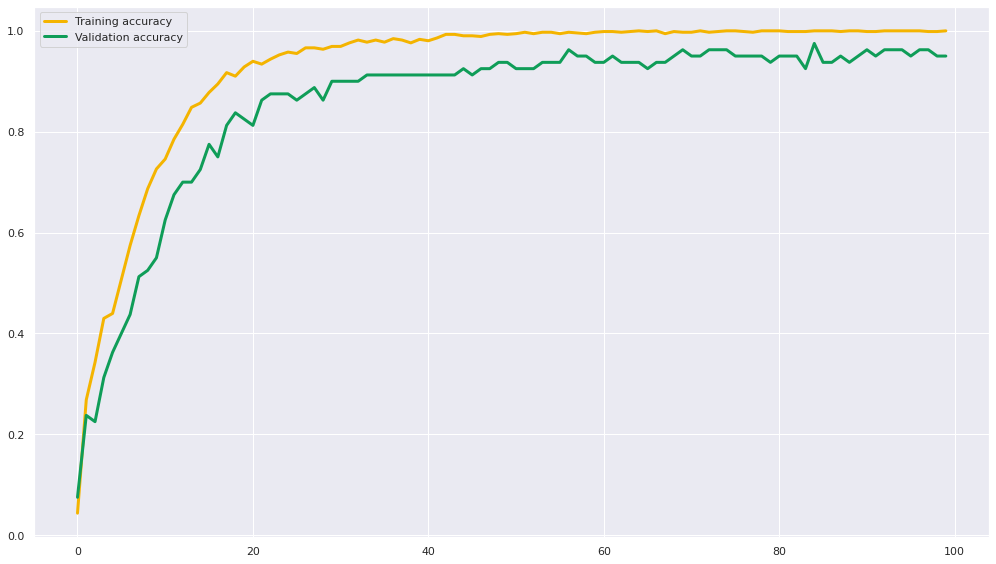

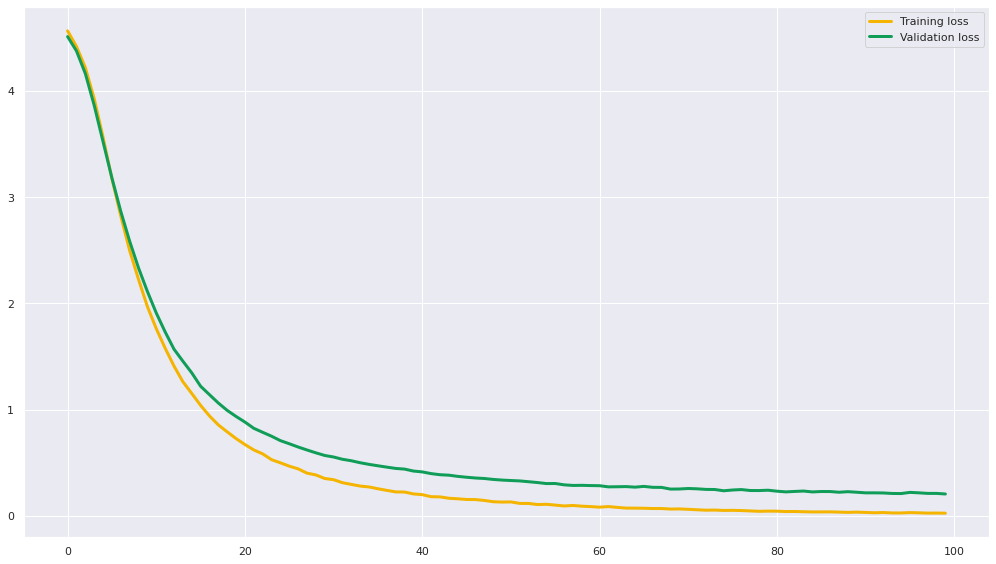

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 15ms/step - loss: 4.5918 - accuracy: 0.0126 - val_loss: 4.5855 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5767 - accuracy: 0.0407 - val_loss: 4.5746 - val_accuracy: 0.0375
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5619 - accuracy: 0.0815 - val_loss: 4.5613 - val_accuracy: 0.0625
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5428 - accuracy: 0.1433 - val_loss: 4.5464 - val_accuracy: 0.1125
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5202 - accuracy: 0.1812 - val_loss: 4.5260 - val_accuracy: 0.1625
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4934 - accuracy: 0.2191 - val_loss: 4.5005 - val_accuracy: 0.1750
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4574 

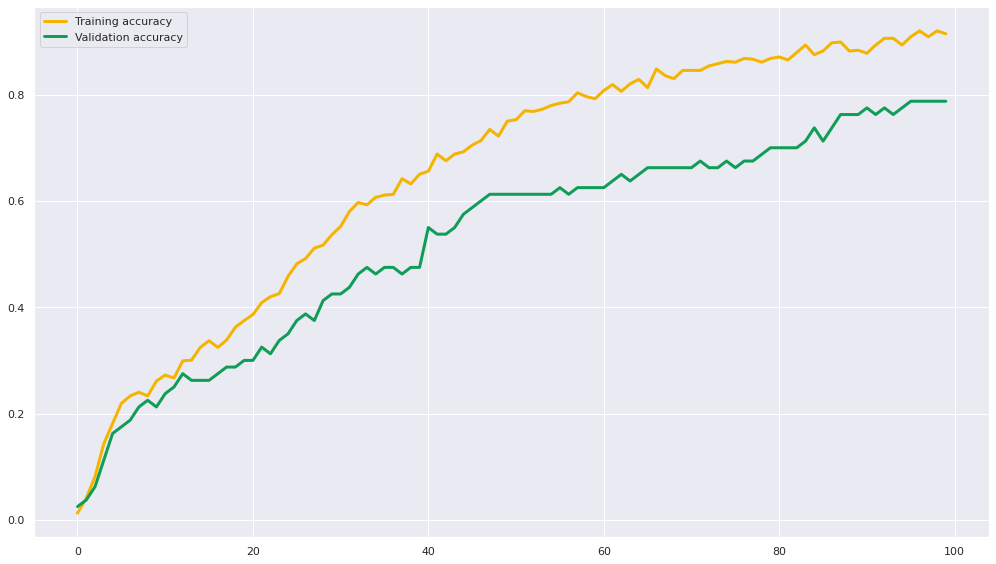

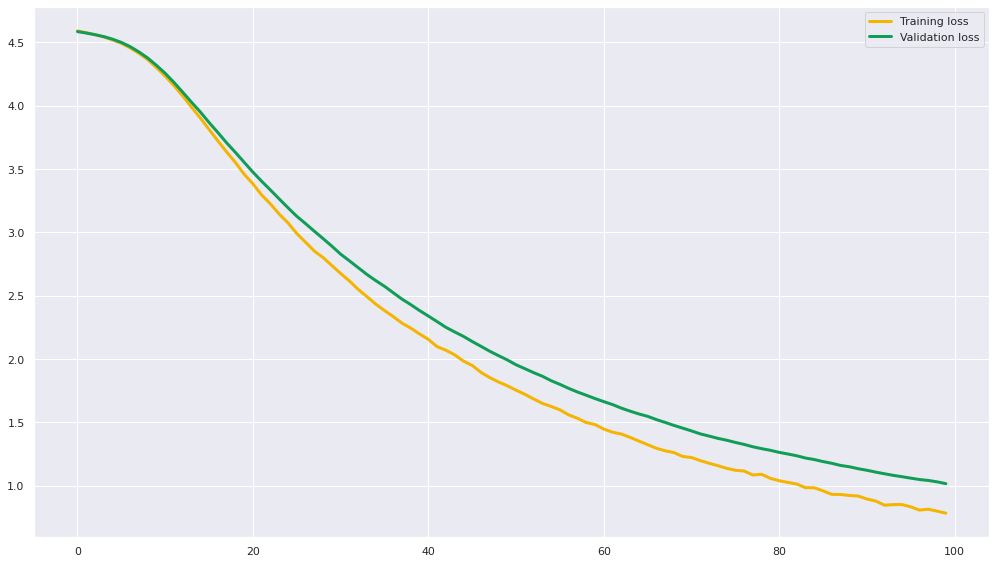

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 18ms/step - loss: 4.5906 - accuracy: 0.0126 - val_loss: 4.5848 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.5764 - accuracy: 0.0506 - val_loss: 4.5744 - val_accuracy: 0.0500
Epoch 3/100
23/23 [==============================] - 0s 8ms/step - loss: 4.5619 - accuracy: 0.0815 - val_loss: 4.5625 - val_accuracy: 0.0625
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5458 - accuracy: 0.0955 - val_loss: 4.5490 - val_accuracy: 0.1000
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5242 - accuracy: 0.1503 - val_loss: 4.5315 - val_accuracy: 0.0875
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4990 - accuracy: 0.1756 - val_loss: 4.5083 - val_accuracy: 0.1000
Epoch 7/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4669 

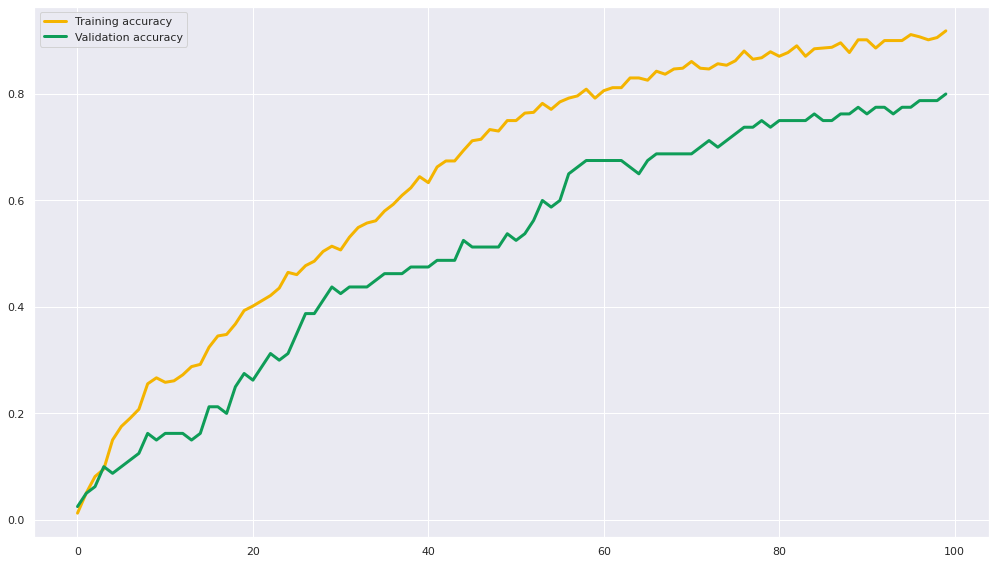

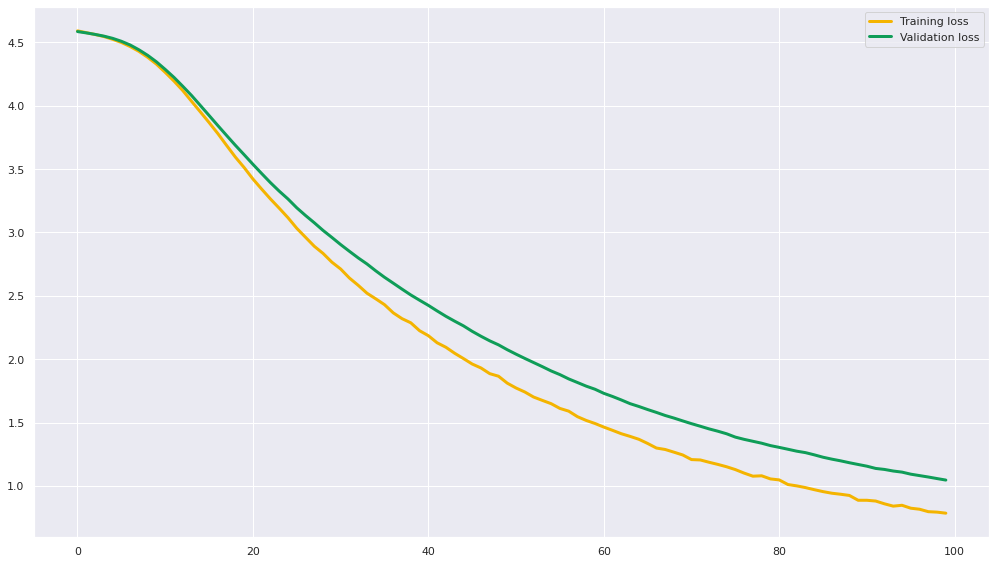

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 17ms/step - loss: 4.5935 - accuracy: 0.0112 - val_loss: 4.5836 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5775 - accuracy: 0.0534 - val_loss: 4.5722 - val_accuracy: 0.0750
Epoch 3/100
23/23 [==============================] - 0s 7ms/step - loss: 4.5620 - accuracy: 0.1110 - val_loss: 4.5602 - val_accuracy: 0.1375
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5448 - accuracy: 0.1559 - val_loss: 4.5444 - val_accuracy: 0.1750
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5226 - accuracy: 0.1938 - val_loss: 4.5242 - val_accuracy: 0.1875
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4955 - accuracy: 0.2149 - val_loss: 4.4989 - val_accuracy: 0.1625
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4620 

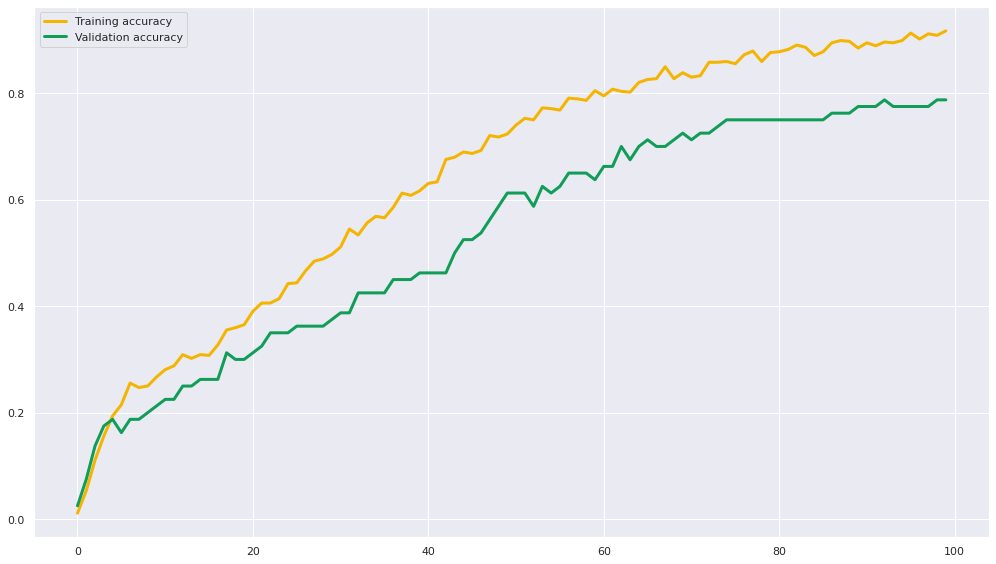

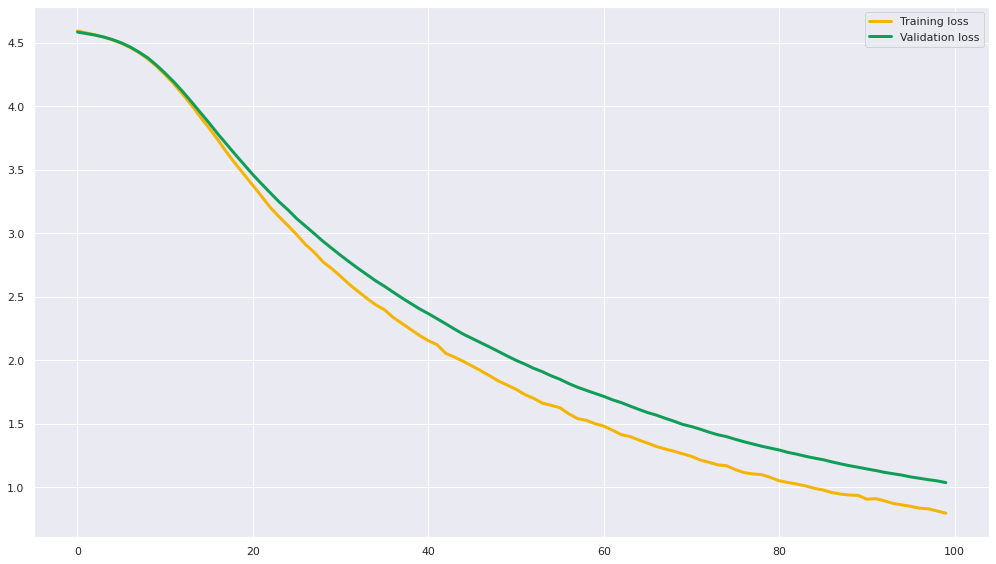

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5906 - accuracy: 0.0183 - val_loss: 4.5844 - val_accuracy: 0.0375
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5772 - accuracy: 0.0449 - val_loss: 4.5757 - val_accuracy: 0.0625
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5643 - accuracy: 0.0674 - val_loss: 4.5656 - val_accuracy: 0.0625
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5480 - accuracy: 0.0955 - val_loss: 4.5531 - val_accuracy: 0.0750
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5298 - accuracy: 0.1166 - val_loss: 4.5373 - val_accuracy: 0.0875
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5076 - accuracy: 0.1264 - val_loss: 4.5181 - val_accuracy: 0.0875
Epoch 7/100
23/23 [==============================] - 0s 3ms/step - loss: 4.4801 

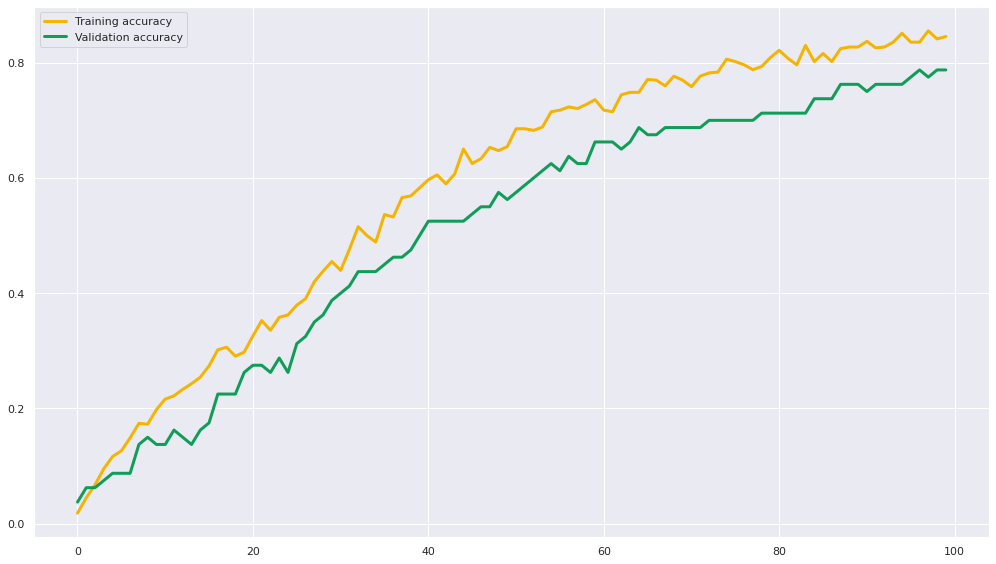

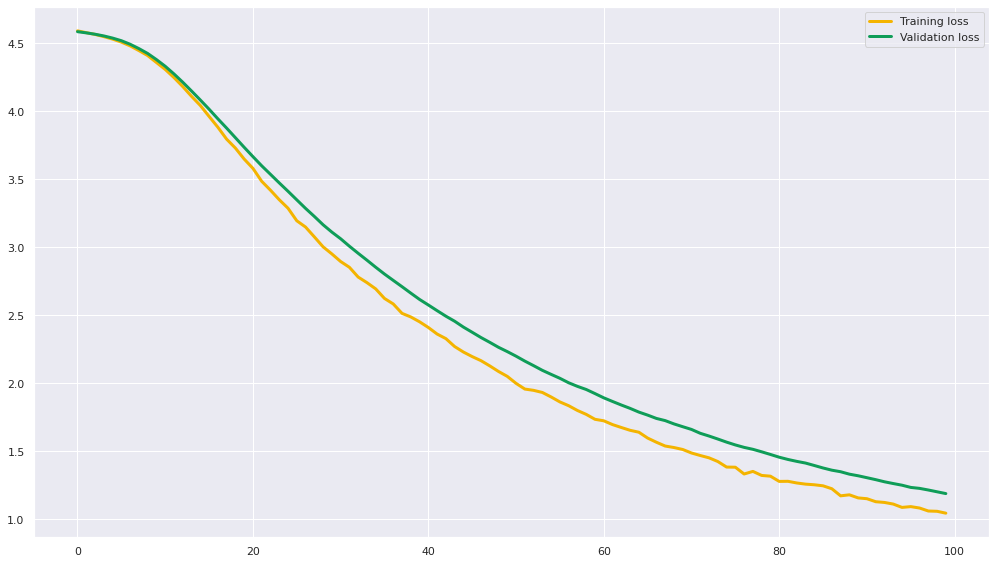

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5897 - accuracy: 0.0197 - val_loss: 4.5835 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5760 - accuracy: 0.0365 - val_loss: 4.5758 - val_accuracy: 0.0500
Epoch 3/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5621 - accuracy: 0.0758 - val_loss: 4.5641 - val_accuracy: 0.0750
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5461 - accuracy: 0.1096 - val_loss: 4.5505 - val_accuracy: 0.0875
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5261 - accuracy: 0.1447 - val_loss: 4.5339 - val_accuracy: 0.0750
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5024 - accuracy: 0.1601 - val_loss: 4.5127 - val_accuracy: 0.1125
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4734 

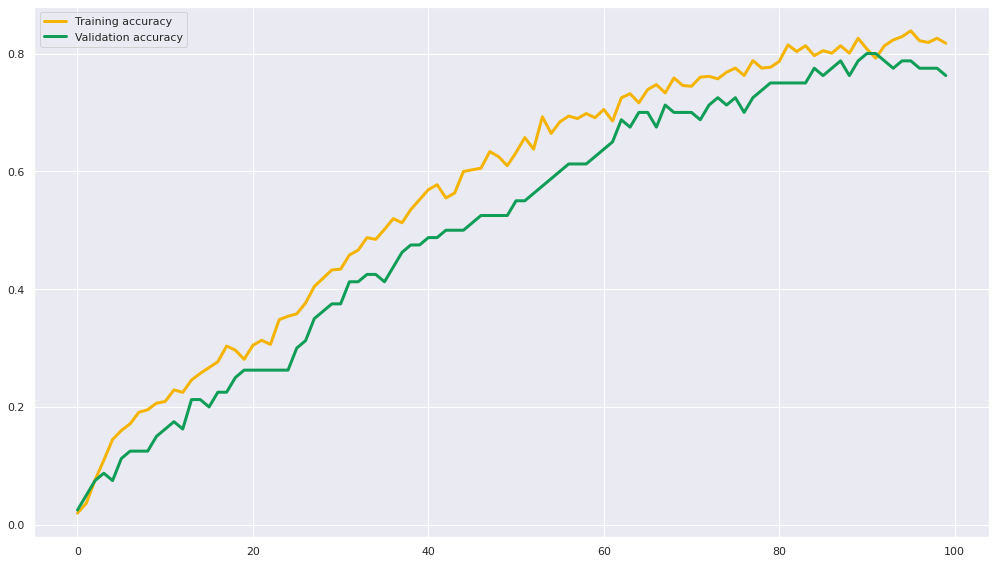

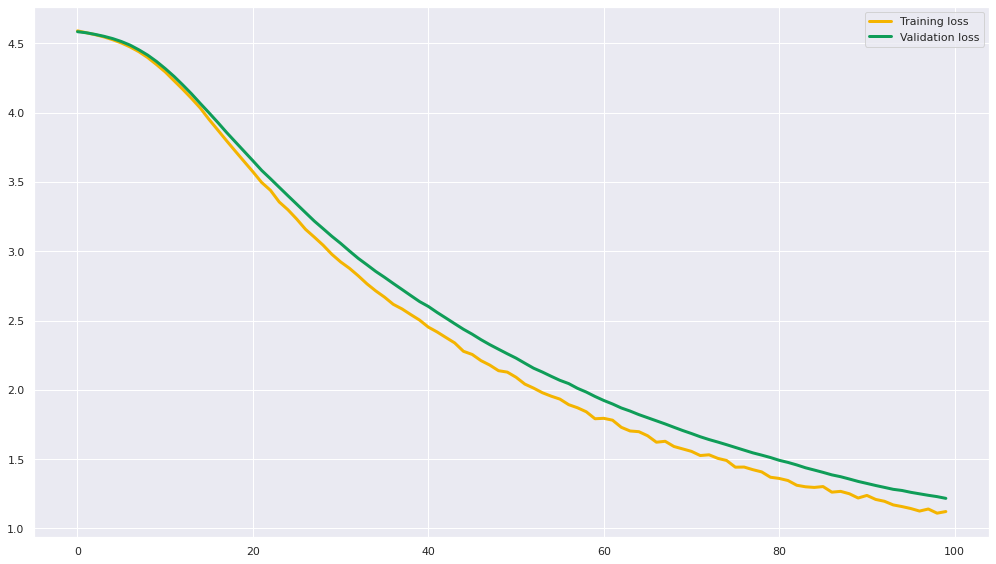

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5919 - accuracy: 0.0070 - val_loss: 4.5836 - val_accuracy: 0.0125
Epoch 2/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5758 - accuracy: 0.0407 - val_loss: 4.5729 - val_accuracy: 0.0500
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5640 - accuracy: 0.0674 - val_loss: 4.5610 - val_accuracy: 0.0625
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5471 - accuracy: 0.0843 - val_loss: 4.5456 - val_accuracy: 0.0875
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5275 - accuracy: 0.1166 - val_loss: 4.5285 - val_accuracy: 0.1125
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5040 - accuracy: 0.1419 - val_loss: 4.5064 - val_accuracy: 0.1000
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4744 

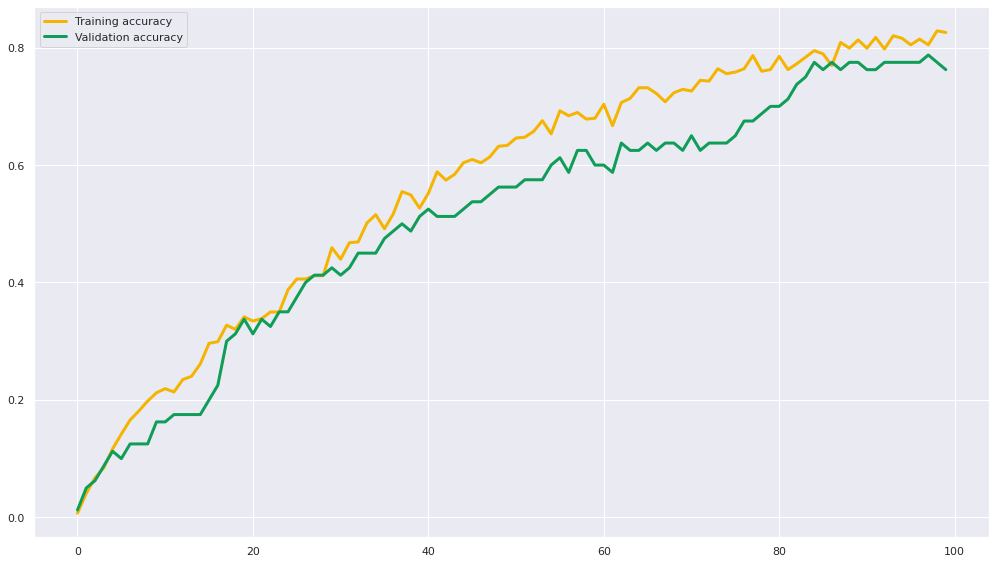

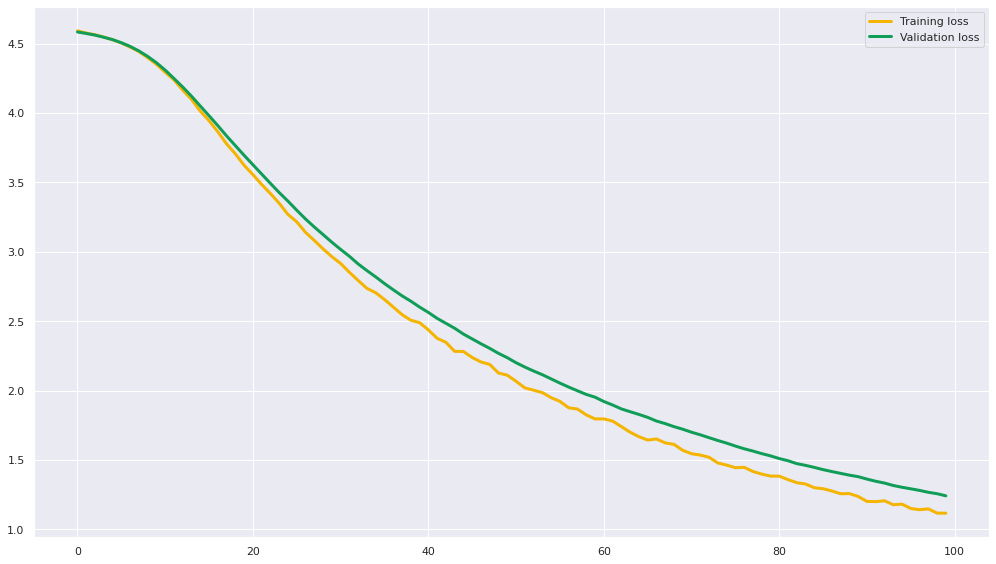

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 12ms/step - loss: 4.5955 - accuracy: 0.0098 - val_loss: 4.5890 - val_accuracy: 0.0000e+00
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5827 - accuracy: 0.0211 - val_loss: 4.5814 - val_accuracy: 0.0500
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5703 - accuracy: 0.0590 - val_loss: 4.5741 - val_accuracy: 0.0375
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5579 - accuracy: 0.0618 - val_loss: 4.5647 - val_accuracy: 0.0500
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5459 - accuracy: 0.0702 - val_loss: 4.5532 - val_accuracy: 0.0875
Epoch 6/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5281 - accuracy: 0.0941 - val_loss: 4.5386 - val_accuracy: 0.0875
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5

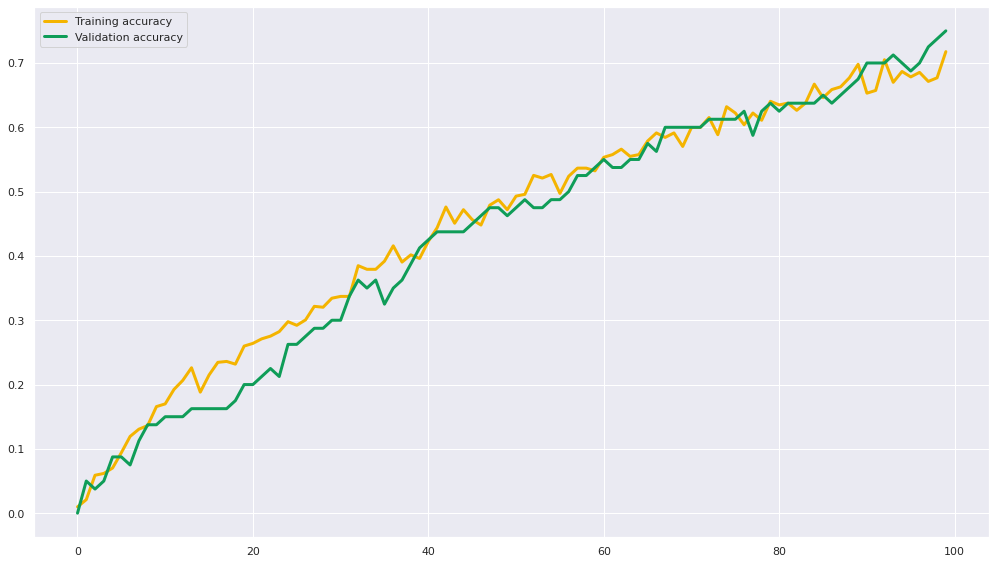

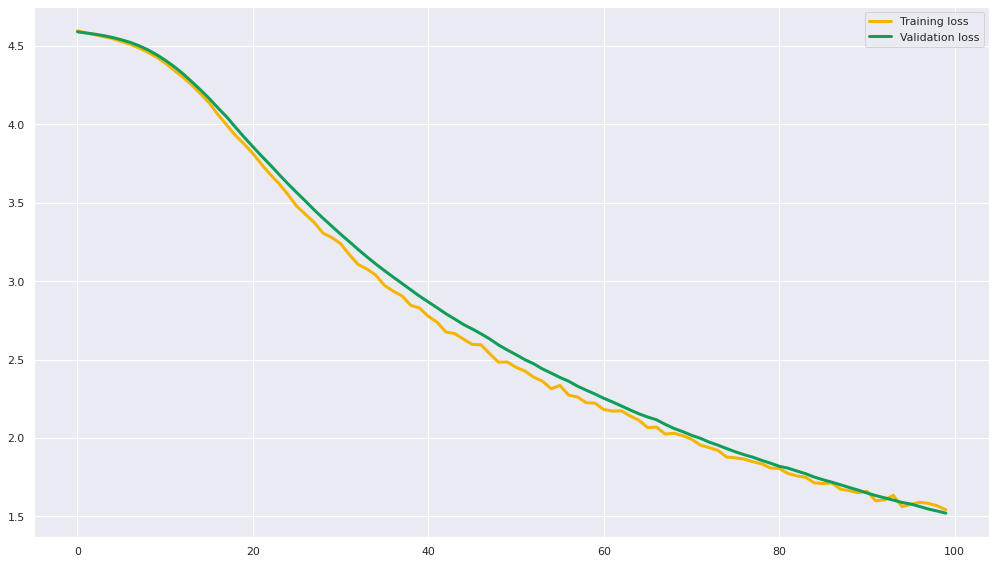

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5986 - accuracy: 0.0014 - val_loss: 4.5919 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5873 - accuracy: 0.0183 - val_loss: 4.5846 - val_accuracy: 0.0250
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5778 - accuracy: 0.0351 - val_loss: 4.5779 - val_accuracy: 0.0125
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5650 - accuracy: 0.0463 - val_loss: 4.5682 - val_accuracy: 0.0750
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5541 - accuracy: 0.0646 - val_loss: 4.5570 - val_accuracy: 0.0750
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5401 - accuracy: 0.0941 - val_loss: 4.5433 - val_accuracy: 0.1375
Epoch 7/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5211 

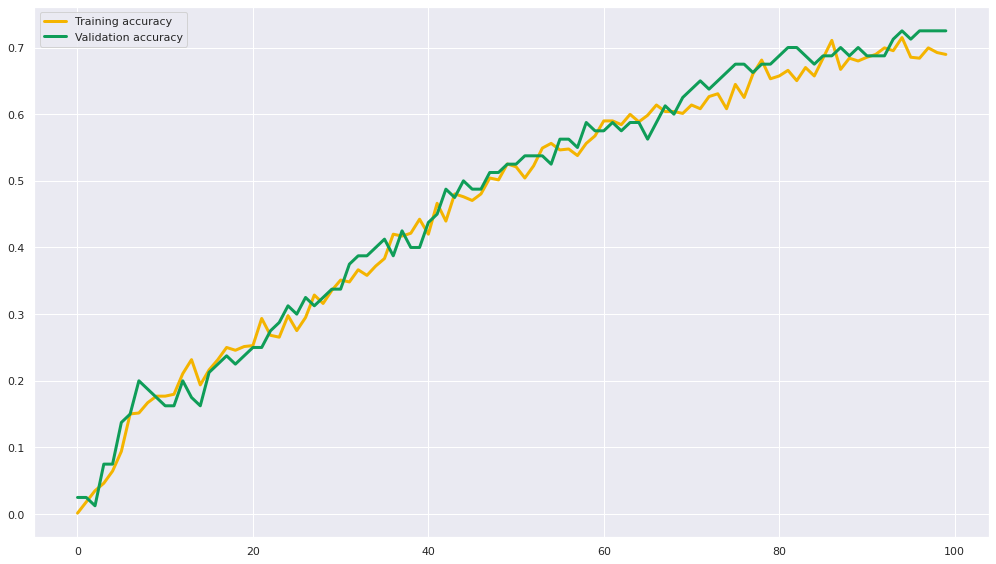

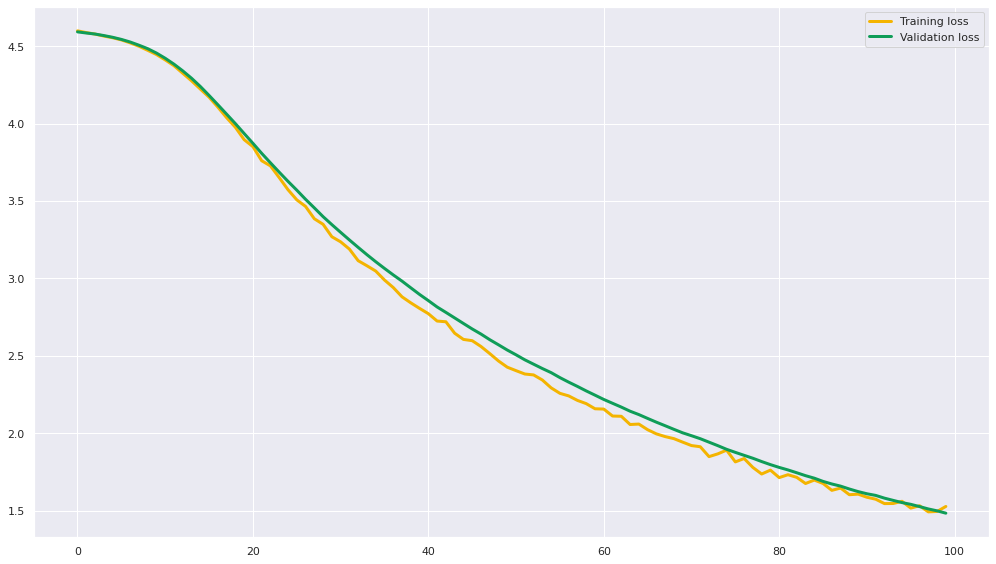

The batch_size is: 32, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5945 - accuracy: 0.0084 - val_loss: 4.5867 - val_accuracy: 0.0375
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5807 - accuracy: 0.0295 - val_loss: 4.5769 - val_accuracy: 0.0625
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5700 - accuracy: 0.0492 - val_loss: 4.5672 - val_accuracy: 0.0625
Epoch 4/100
23/23 [==============================] - 0s 7ms/step - loss: 4.5579 - accuracy: 0.0730 - val_loss: 4.5555 - val_accuracy: 0.1000
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5411 - accuracy: 0.0871 - val_loss: 4.5420 - val_accuracy: 0.0875
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5242 - accuracy: 0.0843 - val_loss: 4.5266 - val_accuracy: 0.1250
Epoch 7/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5008 

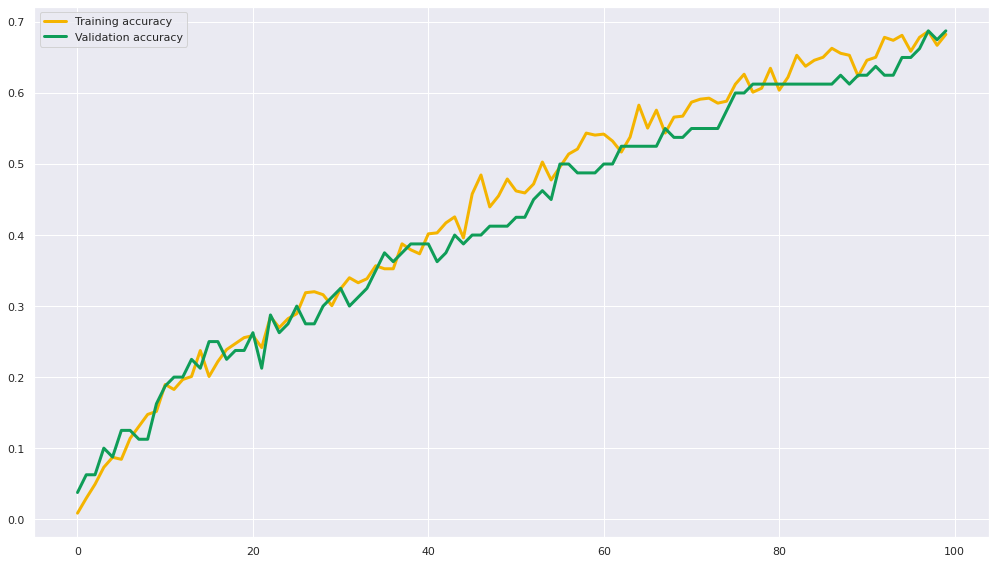

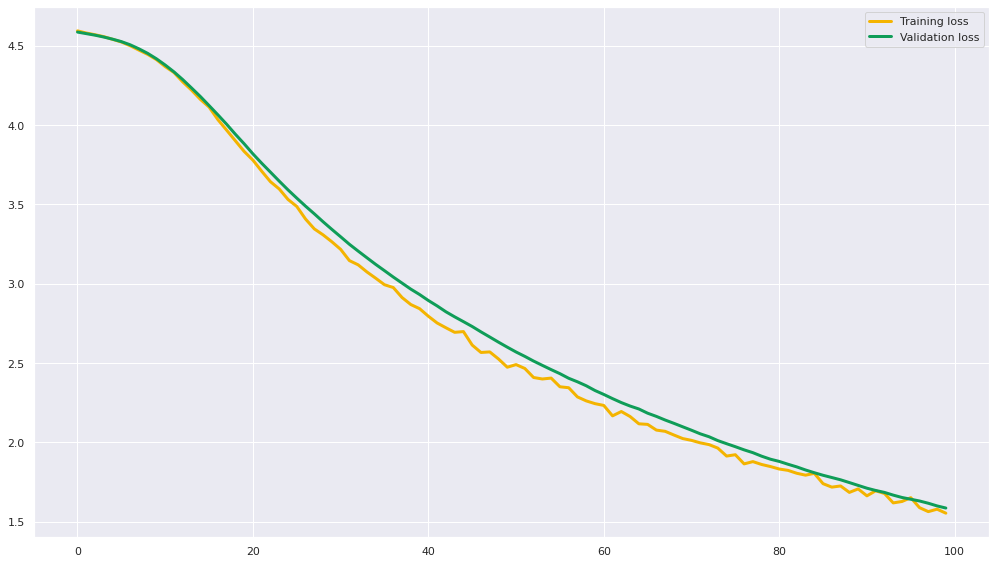

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 16ms/step - loss: 4.5893 - accuracy: 0.0253 - val_loss: 4.5771 - val_accuracy: 0.0375
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5631 - accuracy: 0.0857 - val_loss: 4.5575 - val_accuracy: 0.0750
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5349 - accuracy: 0.1671 - val_loss: 4.5333 - val_accuracy: 0.1250
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5019 - accuracy: 0.2008 - val_loss: 4.5037 - val_accuracy: 0.1750
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4595 - accuracy: 0.2626 - val_loss: 4.4642 - val_accuracy: 0.2250
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4058 - accuracy: 0.2992 - val_loss: 4.4145 - val_accuracy: 0.2125
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3399 

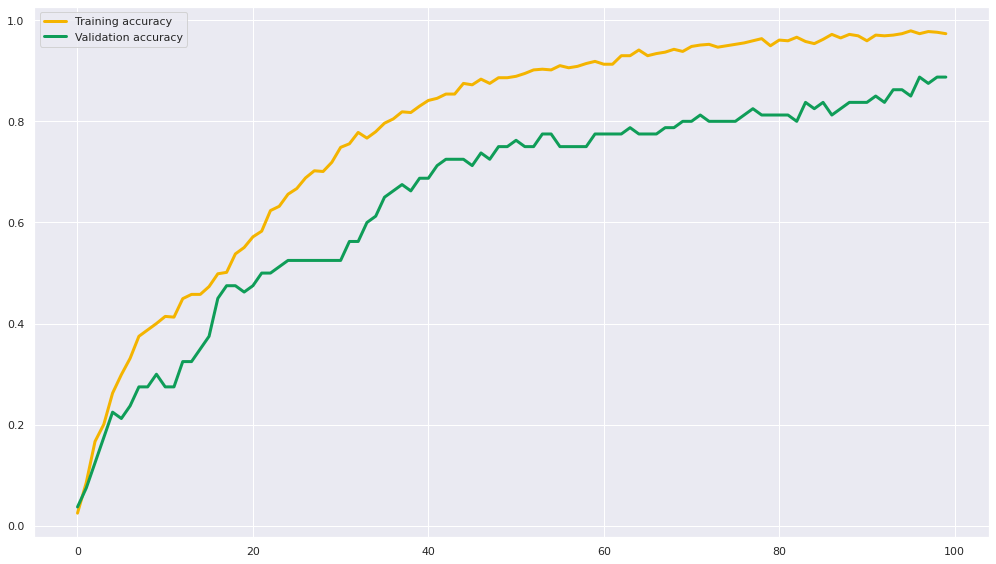

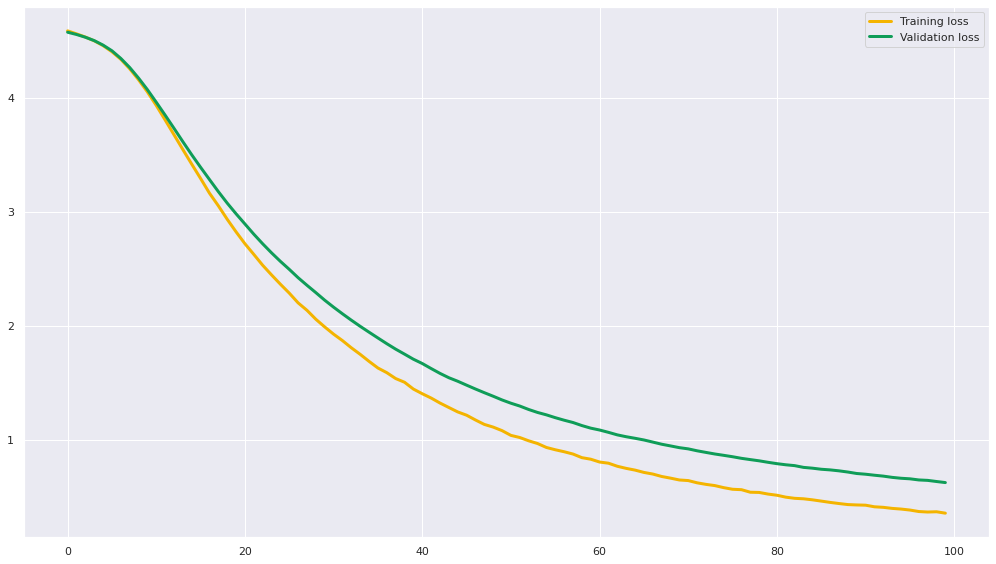

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 18ms/step - loss: 4.5888 - accuracy: 0.0154 - val_loss: 4.5833 - val_accuracy: 0.0625
Epoch 2/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5623 - accuracy: 0.0899 - val_loss: 4.5617 - val_accuracy: 0.1250
Epoch 3/100
23/23 [==============================] - 0s 7ms/step - loss: 4.5335 - accuracy: 0.1629 - val_loss: 4.5346 - val_accuracy: 0.1875
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4995 - accuracy: 0.2163 - val_loss: 4.5028 - val_accuracy: 0.2250
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4561 - accuracy: 0.2697 - val_loss: 4.4616 - val_accuracy: 0.2250
Epoch 6/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4019 - accuracy: 0.2697 - val_loss: 4.4066 - val_accuracy: 0.2125
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3306 

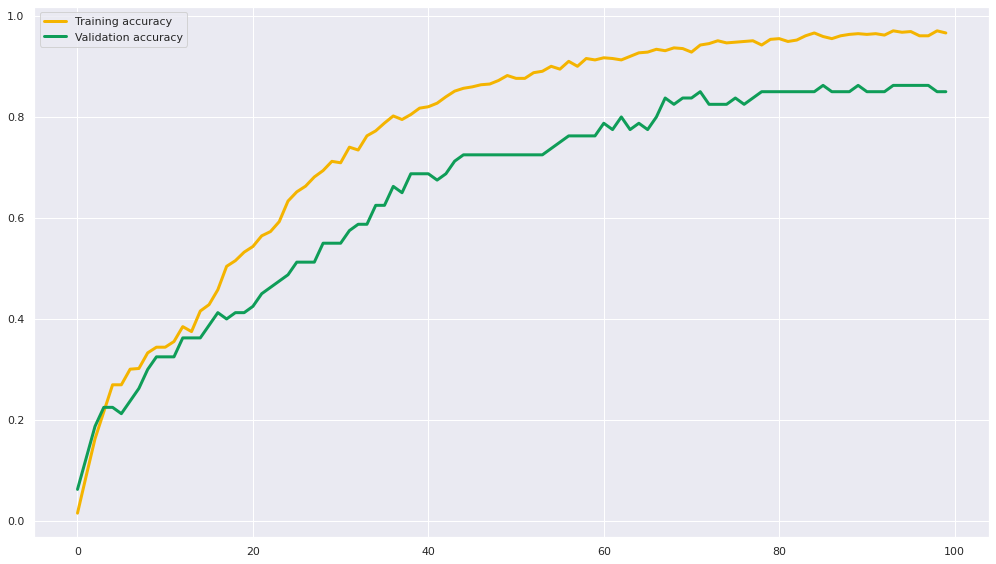

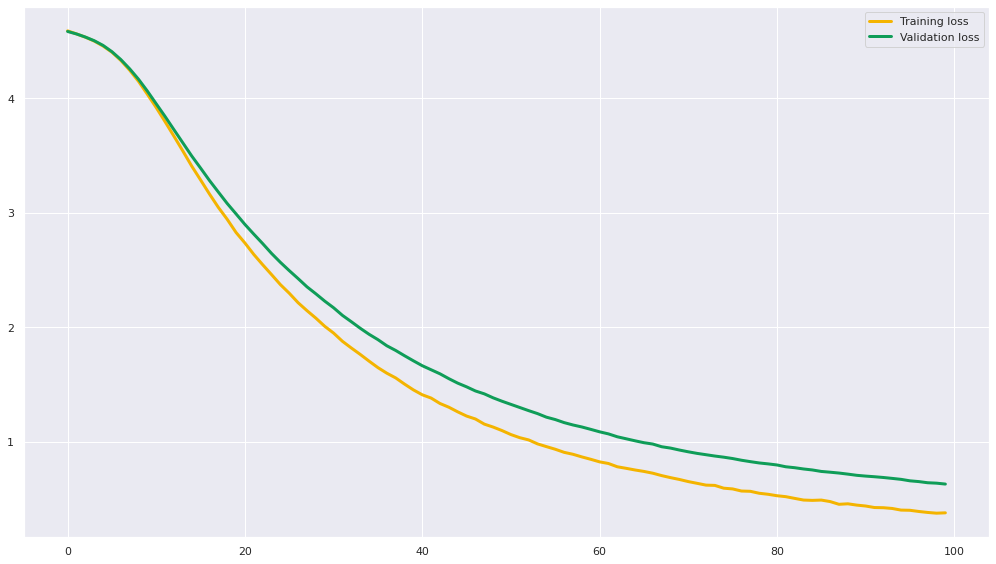

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5859 - accuracy: 0.0267 - val_loss: 4.5716 - val_accuracy: 0.0625
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5576 - accuracy: 0.1124 - val_loss: 4.5519 - val_accuracy: 0.1250
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5301 - accuracy: 0.1756 - val_loss: 4.5270 - val_accuracy: 0.1750
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4949 - accuracy: 0.2374 - val_loss: 4.4946 - val_accuracy: 0.1875
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4505 - accuracy: 0.2612 - val_loss: 4.4531 - val_accuracy: 0.2250
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3955 - accuracy: 0.2949 - val_loss: 4.4002 - val_accuracy: 0.2250
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3251 

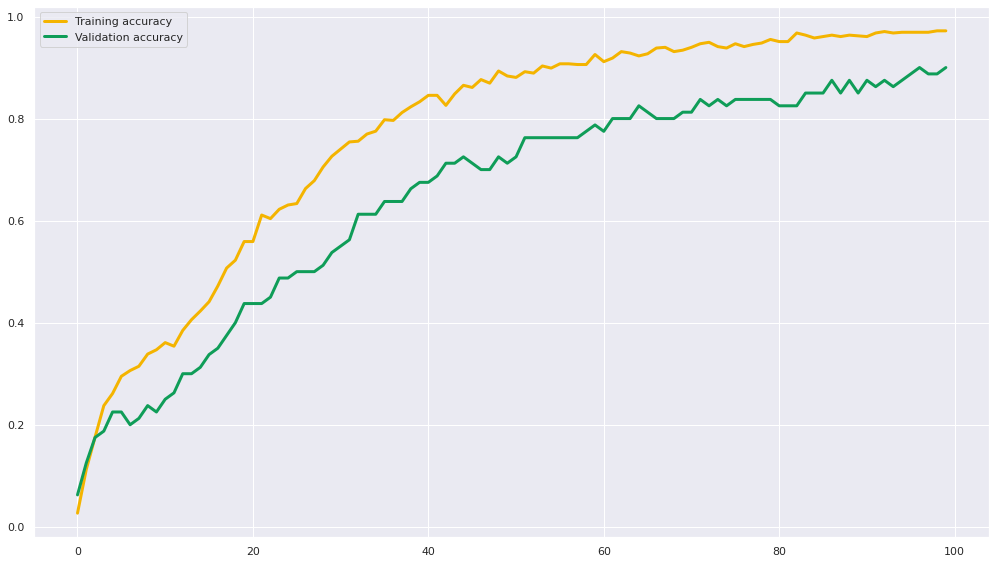

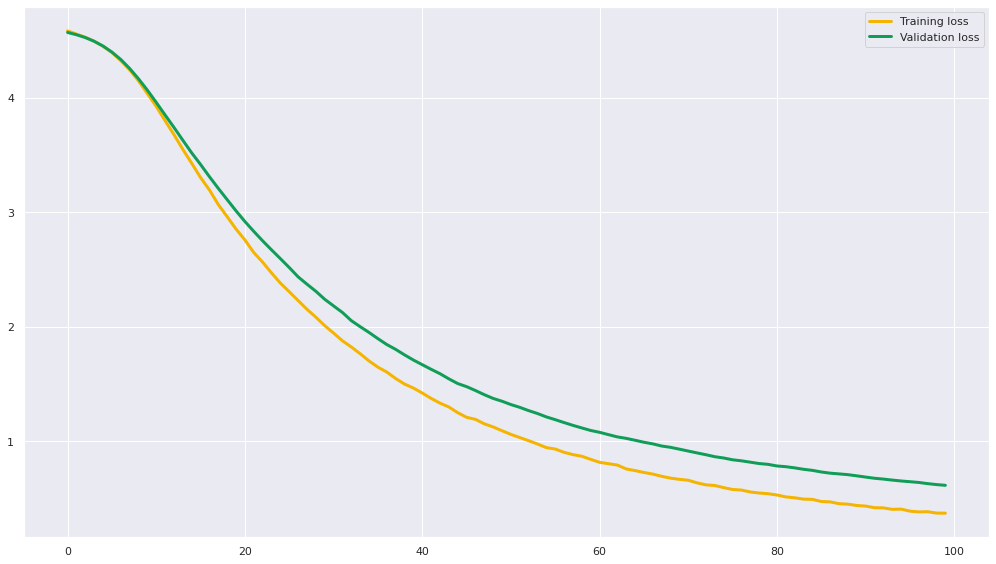

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5910 - accuracy: 0.0154 - val_loss: 4.5768 - val_accuracy: 0.0750
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5650 - accuracy: 0.0674 - val_loss: 4.5593 - val_accuracy: 0.1625
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5397 - accuracy: 0.1180 - val_loss: 4.5381 - val_accuracy: 0.2125
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5104 - accuracy: 0.2121 - val_loss: 4.5117 - val_accuracy: 0.2500
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.4759 - accuracy: 0.2219 - val_loss: 4.4814 - val_accuracy: 0.2250
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4325 - accuracy: 0.2444 - val_loss: 4.4419 - val_accuracy: 0.2125
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3797 

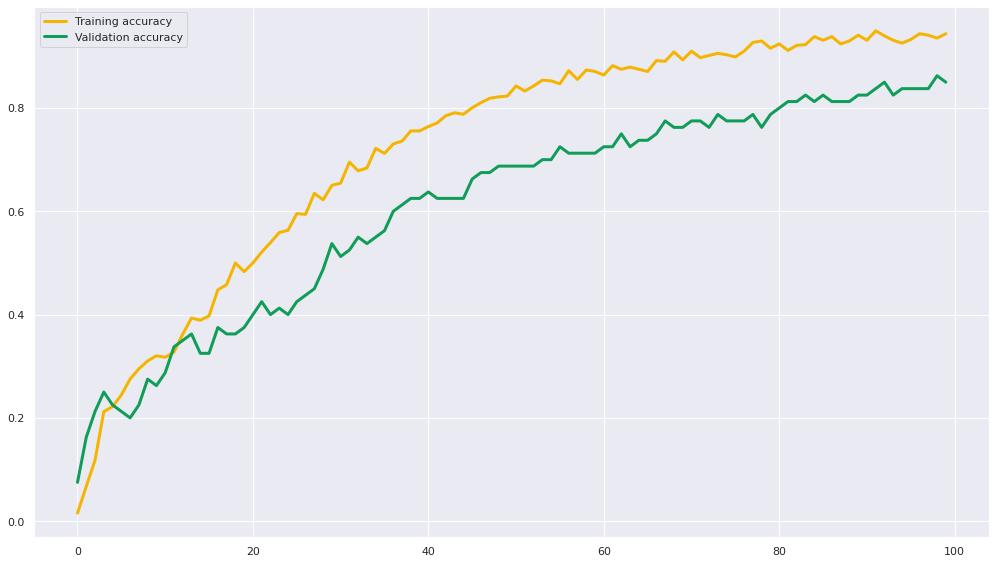

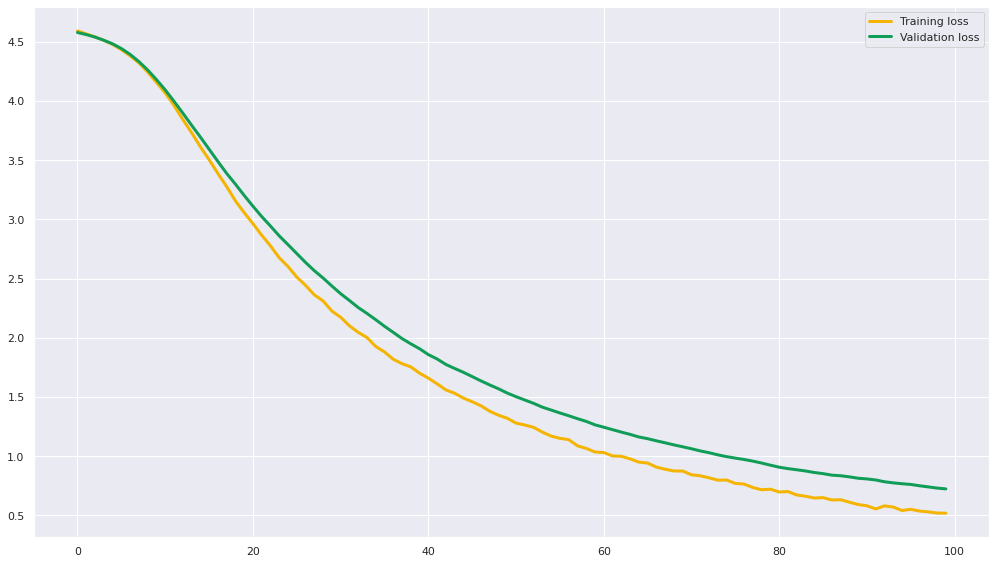

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5934 - accuracy: 0.0126 - val_loss: 4.5808 - val_accuracy: 0.0500
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5695 - accuracy: 0.0548 - val_loss: 4.5624 - val_accuracy: 0.0625
Epoch 3/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5446 - accuracy: 0.1096 - val_loss: 4.5434 - val_accuracy: 0.1000
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5152 - accuracy: 0.1854 - val_loss: 4.5191 - val_accuracy: 0.1625
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4801 - accuracy: 0.2233 - val_loss: 4.4874 - val_accuracy: 0.2000
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4368 - accuracy: 0.2542 - val_loss: 4.4459 - val_accuracy: 0.2625
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3820 

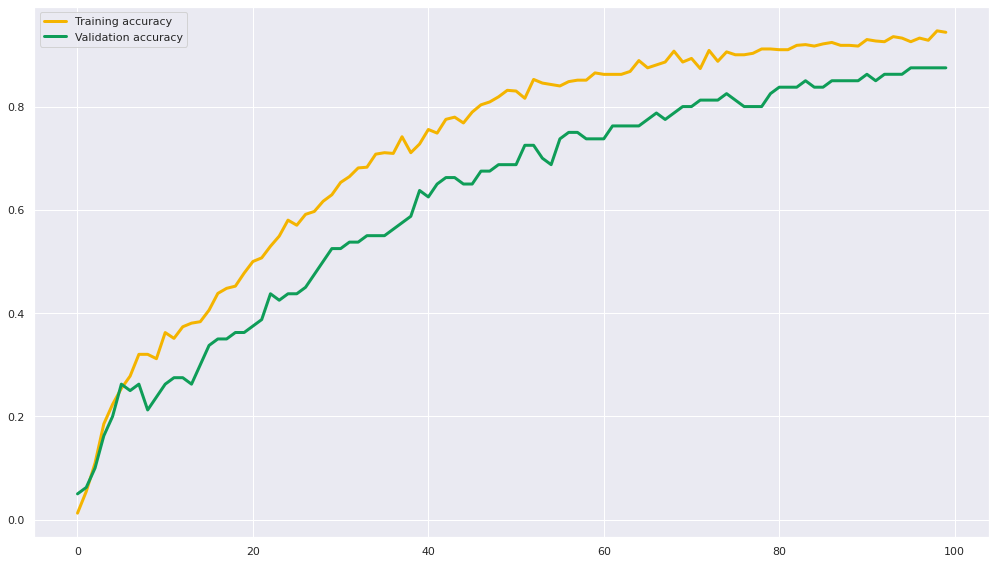

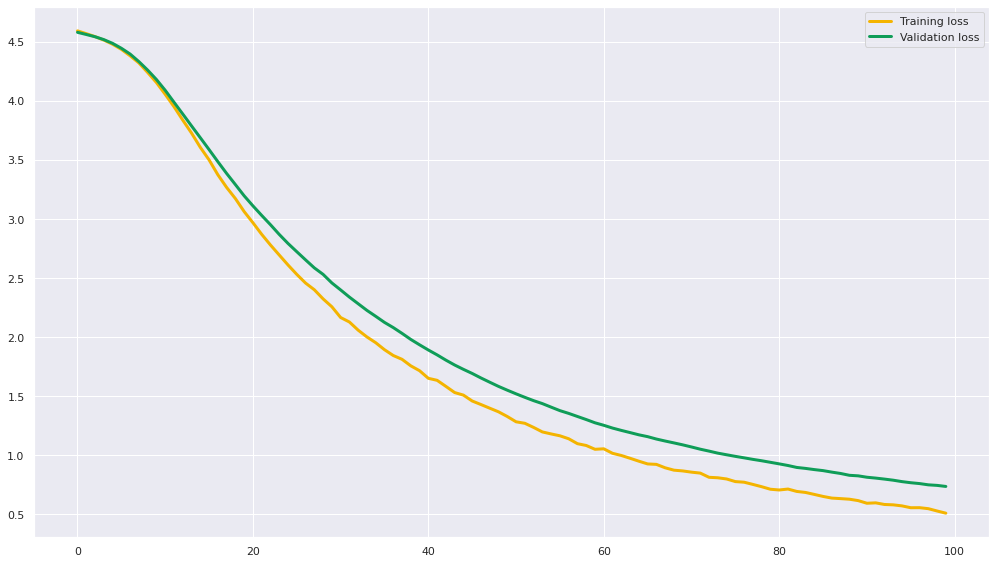

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 12ms/step - loss: 4.5900 - accuracy: 0.0112 - val_loss: 4.5821 - val_accuracy: 0.0125
Epoch 2/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5650 - accuracy: 0.0365 - val_loss: 4.5652 - val_accuracy: 0.0625
Epoch 3/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5406 - accuracy: 0.0913 - val_loss: 4.5455 - val_accuracy: 0.0875
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5131 - accuracy: 0.1334 - val_loss: 4.5202 - val_accuracy: 0.1125
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4756 - accuracy: 0.1475 - val_loss: 4.4882 - val_accuracy: 0.0875
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4332 - accuracy: 0.2177 - val_loss: 4.4457 - val_accuracy: 0.1375
Epoch 7/100
23/23 [==============================] - 0s 3ms/step - loss: 4.3806 

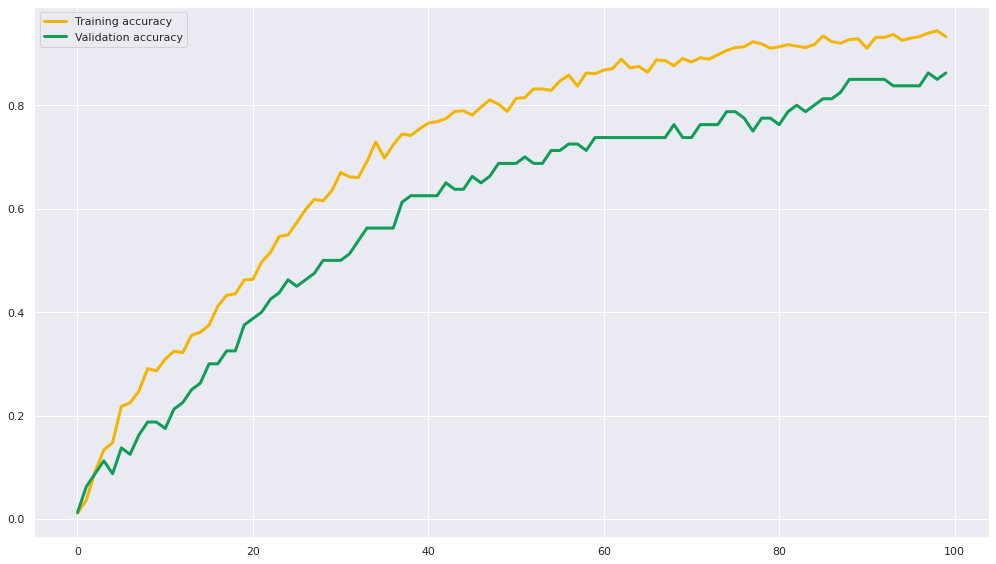

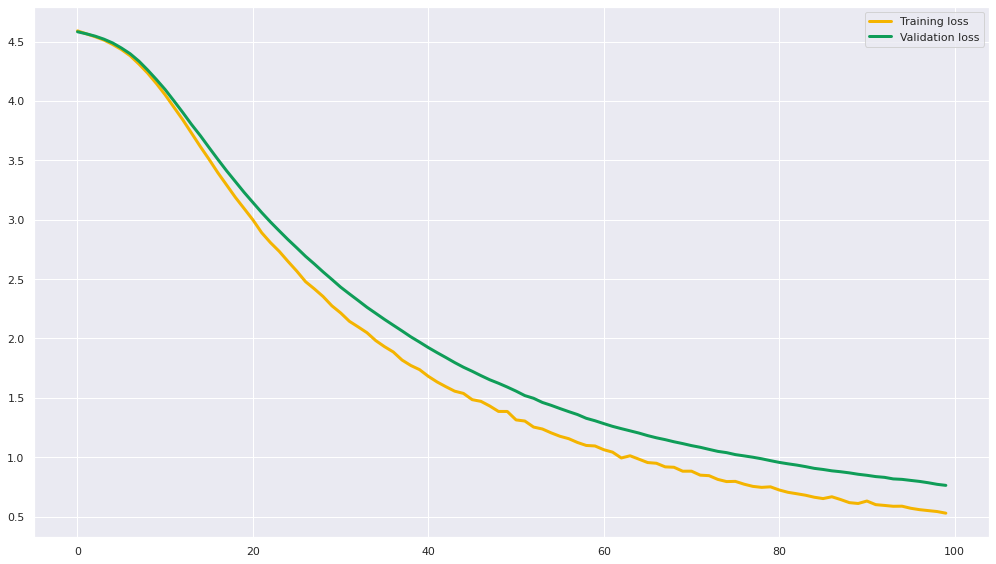

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 18ms/step - loss: 4.5890 - accuracy: 0.0112 - val_loss: 4.5772 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5634 - accuracy: 0.0548 - val_loss: 4.5613 - val_accuracy: 0.0750
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5433 - accuracy: 0.0857 - val_loss: 4.5422 - val_accuracy: 0.1000
Epoch 4/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5218 - accuracy: 0.1096 - val_loss: 4.5221 - val_accuracy: 0.1875
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4896 - accuracy: 0.1840 - val_loss: 4.4943 - val_accuracy: 0.2125
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4560 - accuracy: 0.1980 - val_loss: 4.4620 - val_accuracy: 0.2500
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4124 

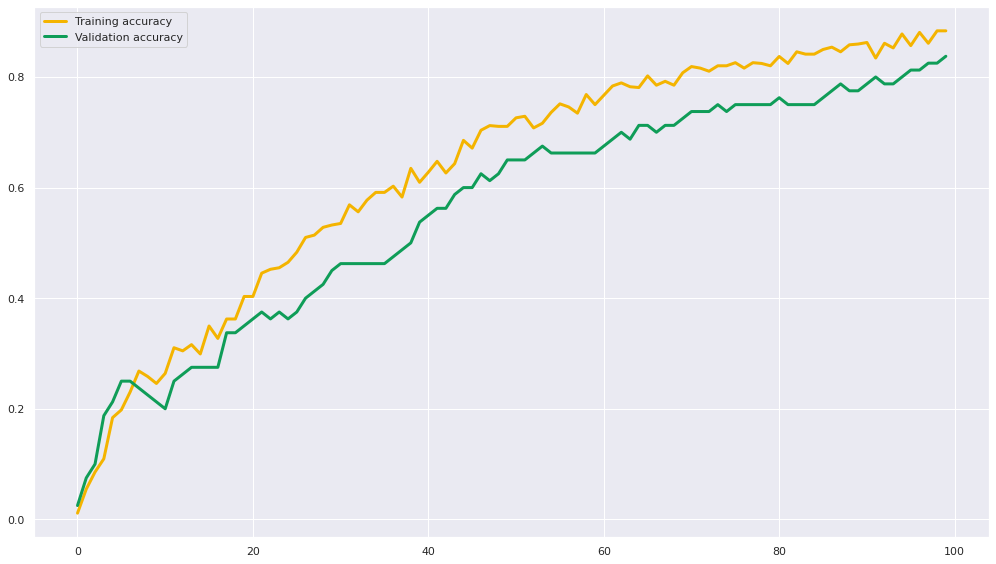

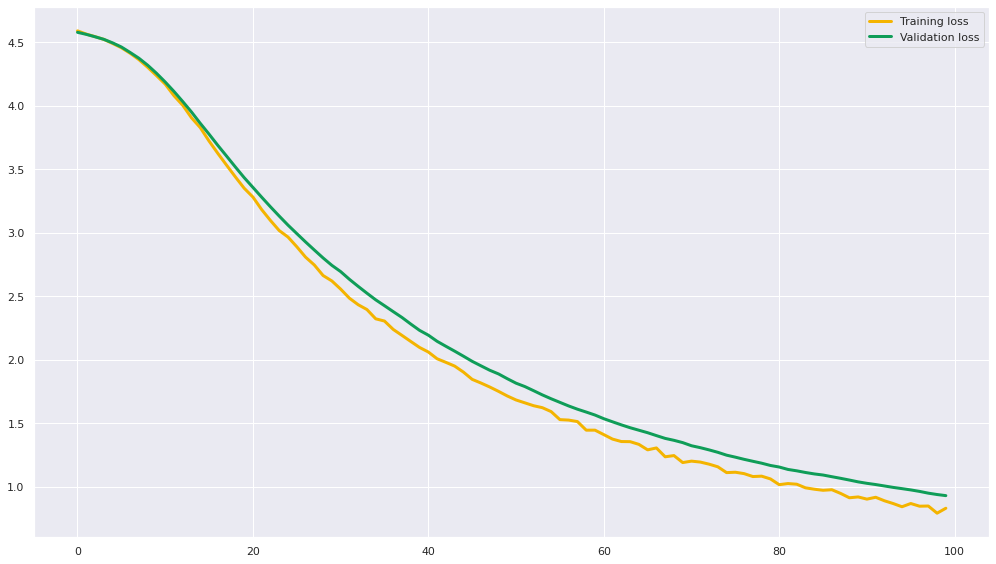

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5918 - accuracy: 0.0070 - val_loss: 4.5846 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5710 - accuracy: 0.0379 - val_loss: 4.5704 - val_accuracy: 0.0500
Epoch 3/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5510 - accuracy: 0.0885 - val_loss: 4.5532 - val_accuracy: 0.1000
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5296 - accuracy: 0.1264 - val_loss: 4.5339 - val_accuracy: 0.1125
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5006 - accuracy: 0.1545 - val_loss: 4.5107 - val_accuracy: 0.1625
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4705 - accuracy: 0.2008 - val_loss: 4.4821 - val_accuracy: 0.1875
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4311 

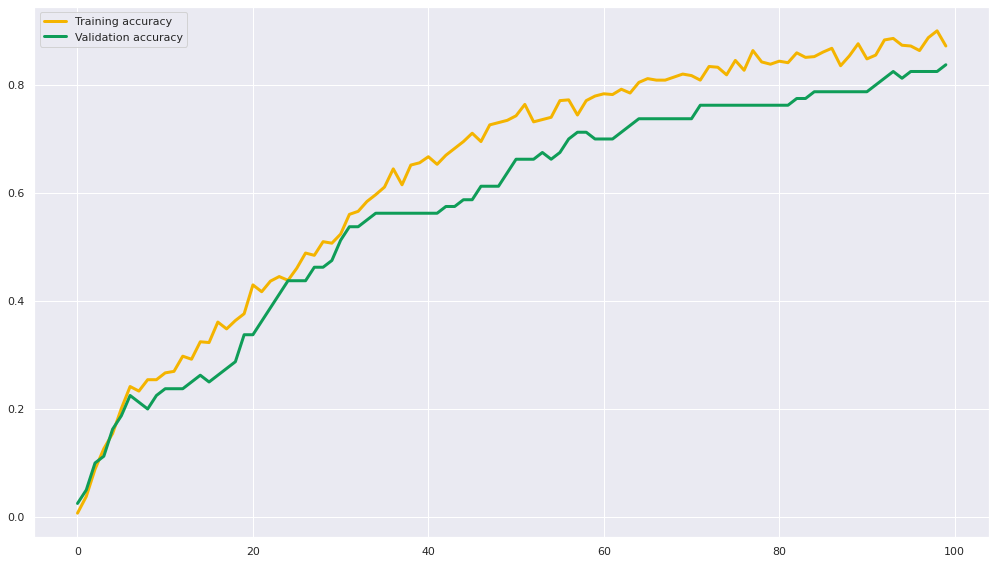

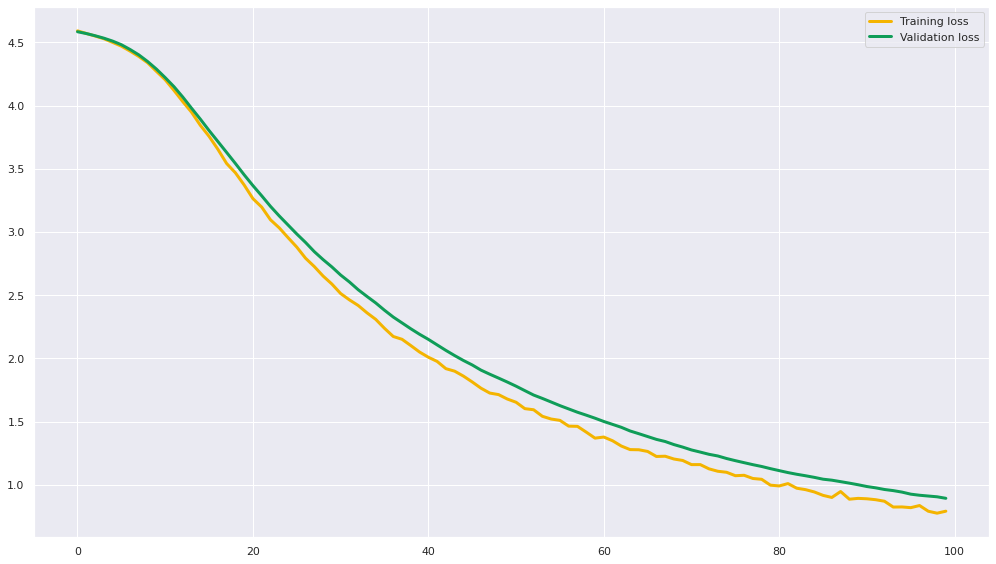

The batch_size is: 32, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 12ms/step - loss: 4.5913 - accuracy: 0.0098 - val_loss: 4.5866 - val_accuracy: 0.0250
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5693 - accuracy: 0.0534 - val_loss: 4.5729 - val_accuracy: 0.0625
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5494 - accuracy: 0.0787 - val_loss: 4.5573 - val_accuracy: 0.0750
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5261 - accuracy: 0.1166 - val_loss: 4.5381 - val_accuracy: 0.0750
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4948 - accuracy: 0.1699 - val_loss: 4.5154 - val_accuracy: 0.0875
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4630 - accuracy: 0.2037 - val_loss: 4.4840 - val_accuracy: 0.1125
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4202 

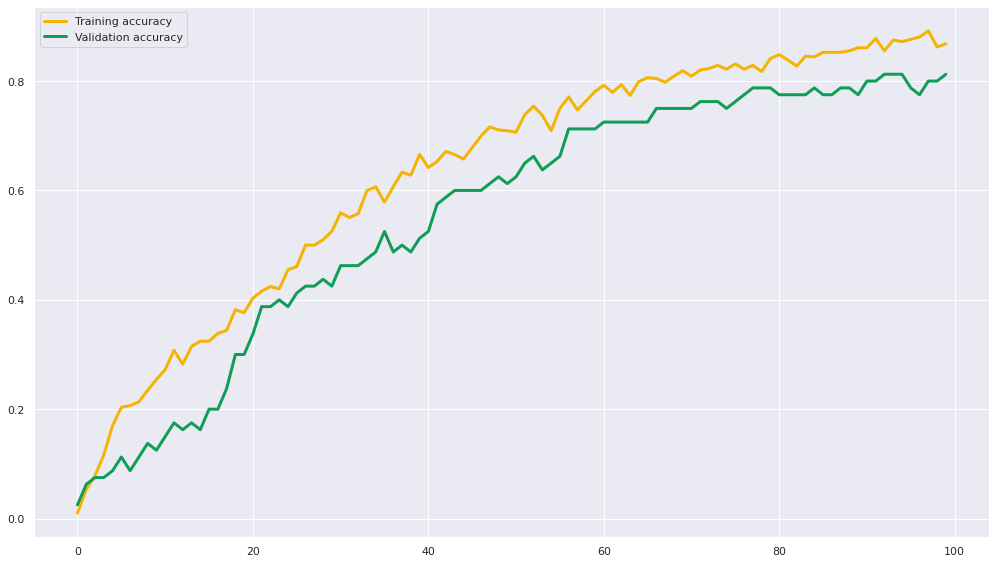

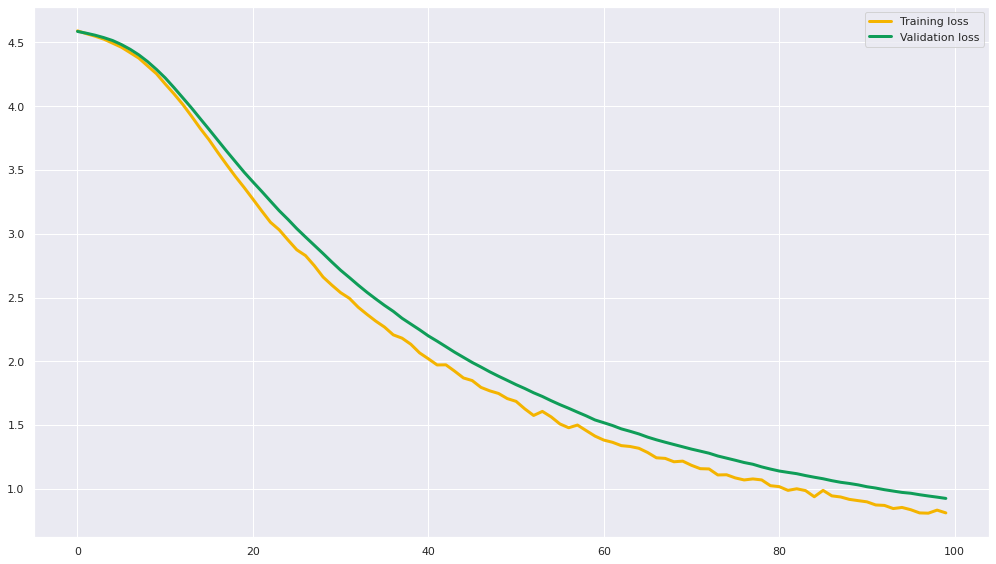

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 2s 17ms/step - loss: 4.5778 - accuracy: 0.0548 - val_loss: 4.5554 - val_accuracy: 0.1125
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5290 - accuracy: 0.1798 - val_loss: 4.5173 - val_accuracy: 0.1875
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4764 - accuracy: 0.2612 - val_loss: 4.4682 - val_accuracy: 0.2125
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4079 - accuracy: 0.3118 - val_loss: 4.4040 - val_accuracy: 0.2125
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.3229 - accuracy: 0.3539 - val_loss: 4.3181 - val_accuracy: 0.2625
Epoch 6/100
23/23 [==============================] - 0s 7ms/step - loss: 4.2118 - accuracy: 0.3876 - val_loss: 4.2060 - val_accuracy: 0.3125
Epoch 7/100
23/23 [==============================] - 0s 6ms/step - loss: 4.0798

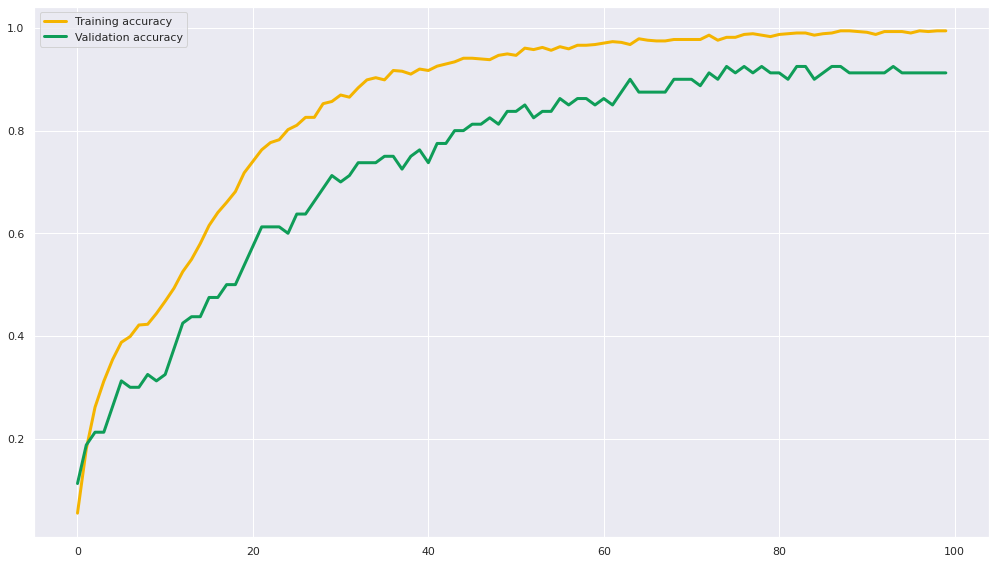

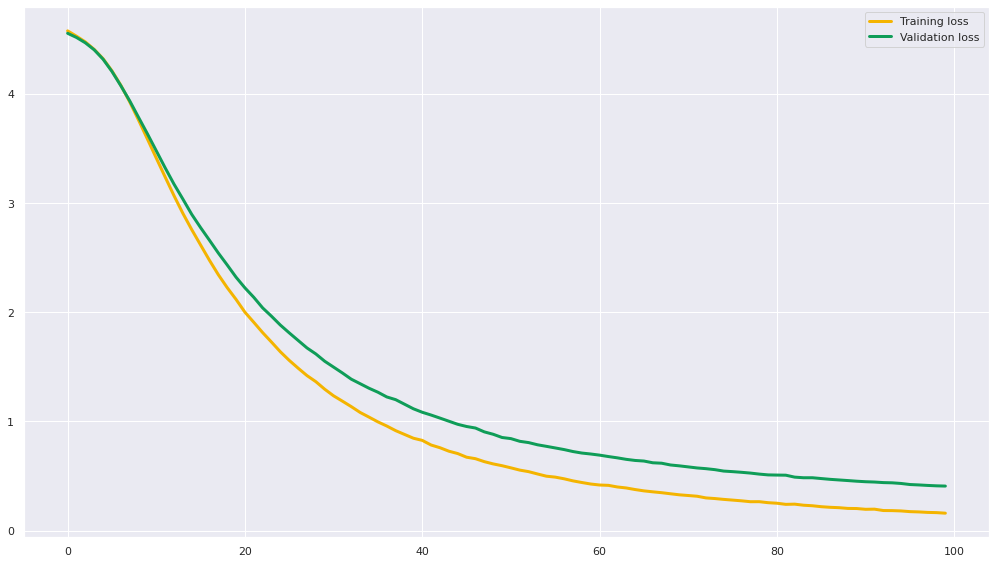

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5845 - accuracy: 0.0253 - val_loss: 4.5641 - val_accuracy: 0.0750
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5360 - accuracy: 0.1264 - val_loss: 4.5285 - val_accuracy: 0.1125
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4838 - accuracy: 0.2458 - val_loss: 4.4801 - val_accuracy: 0.1750
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4185 - accuracy: 0.3006 - val_loss: 4.4133 - val_accuracy: 0.2250
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3344 - accuracy: 0.3315 - val_loss: 4.3309 - val_accuracy: 0.2250
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2282 - accuracy: 0.3680 - val_loss: 4.2235 - val_accuracy: 0.2250
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.0961

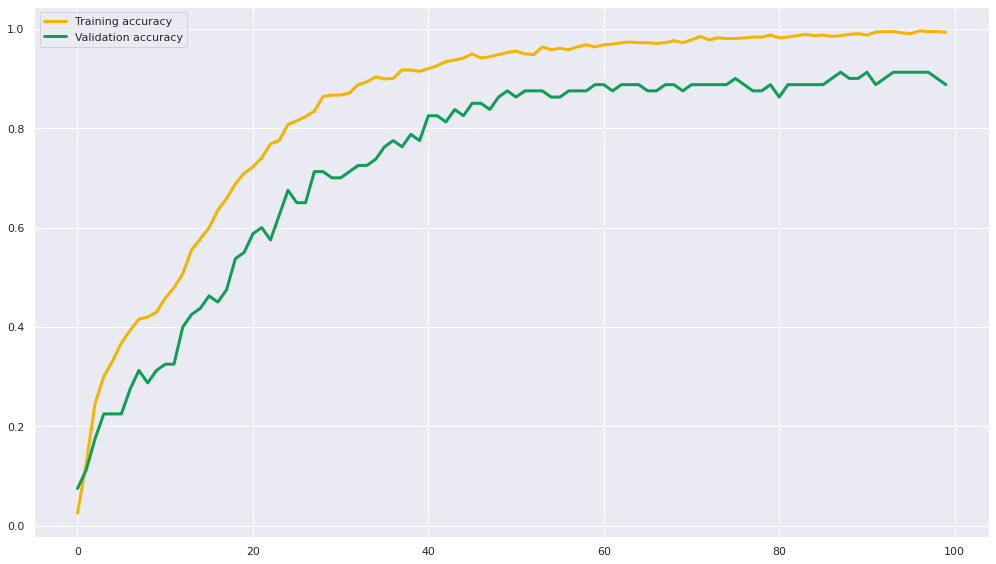

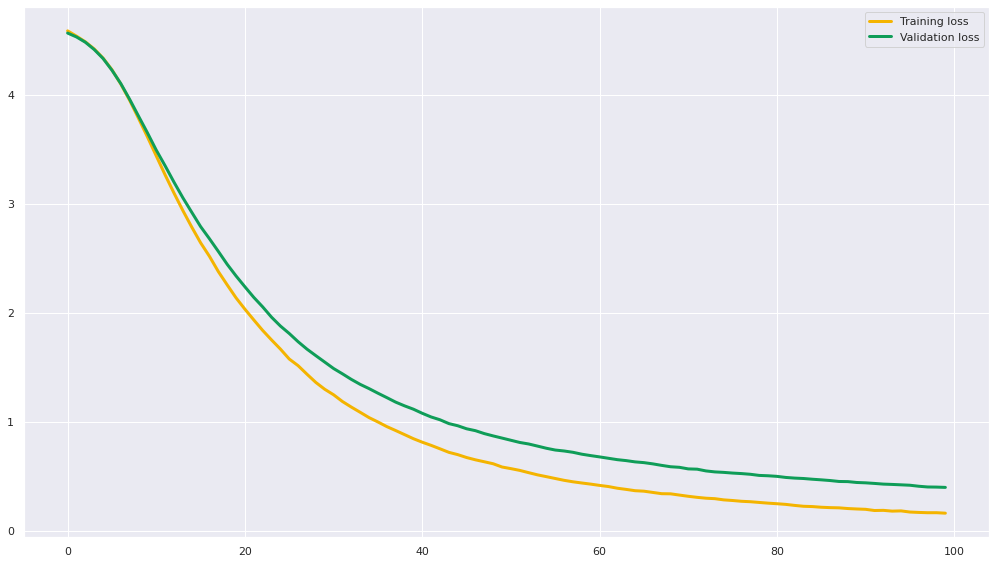

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5848 - accuracy: 0.0295 - val_loss: 4.5635 - val_accuracy: 0.0625
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5379 - accuracy: 0.1531 - val_loss: 4.5270 - val_accuracy: 0.2125
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4857 - accuracy: 0.2963 - val_loss: 4.4829 - val_accuracy: 0.2250
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.4215 - accuracy: 0.3539 - val_loss: 4.4202 - val_accuracy: 0.2875
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3388 - accuracy: 0.4171 - val_loss: 4.3408 - val_accuracy: 0.3000
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2342 - accuracy: 0.4424 - val_loss: 4.2370 - val_accuracy: 0.2875
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.1025

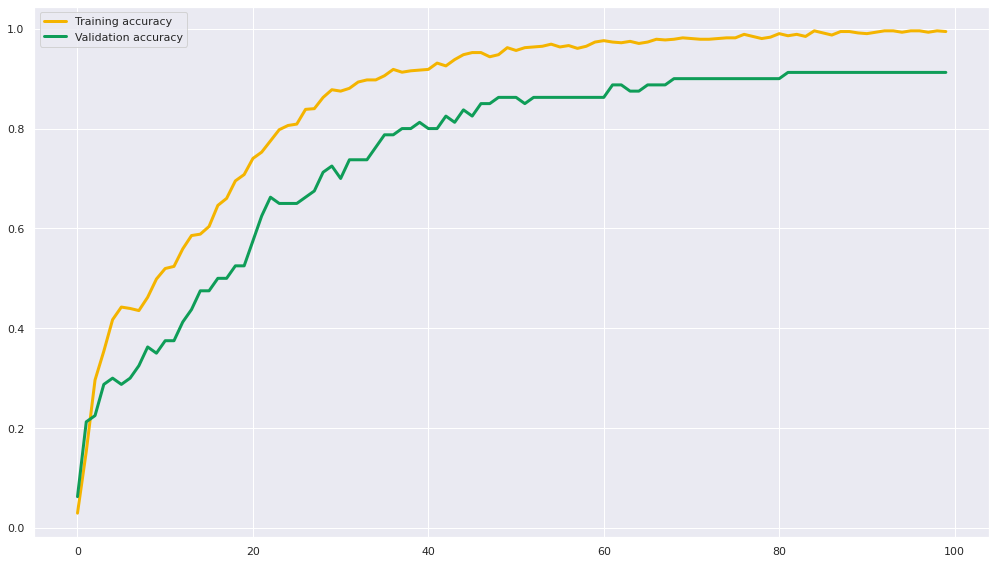

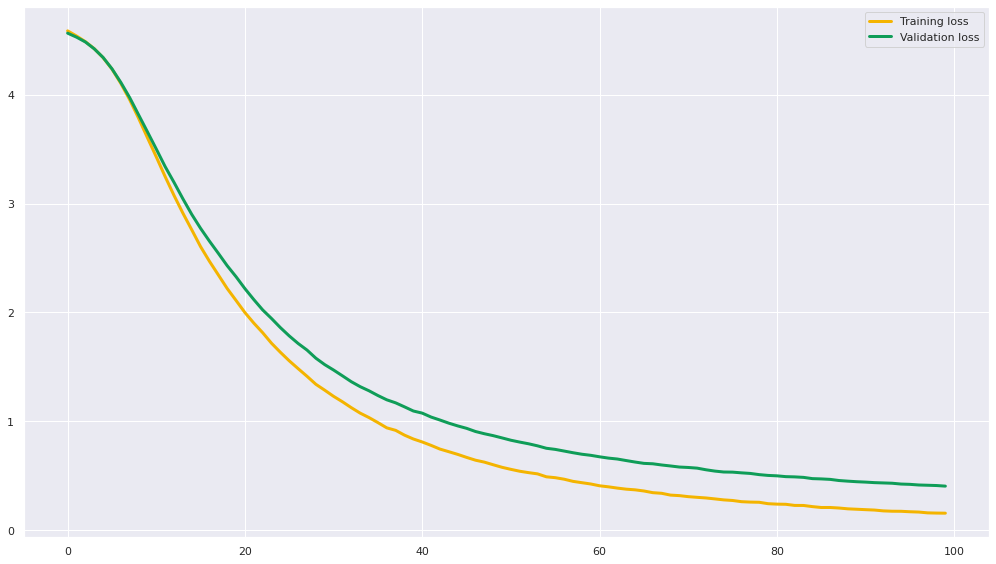

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5861 - accuracy: 0.0281 - val_loss: 4.5667 - val_accuracy: 0.0875
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5446 - accuracy: 0.1166 - val_loss: 4.5365 - val_accuracy: 0.1250
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5012 - accuracy: 0.1952 - val_loss: 4.4982 - val_accuracy: 0.1250
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4485 - accuracy: 0.2500 - val_loss: 4.4502 - val_accuracy: 0.1500
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3802 - accuracy: 0.2921 - val_loss: 4.3863 - val_accuracy: 0.2125
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2935 - accuracy: 0.3301 - val_loss: 4.3064 - val_accuracy: 0.2500
Epoch 7/100
23/23 [==============================] - 0s 6ms/step - loss: 4.1900

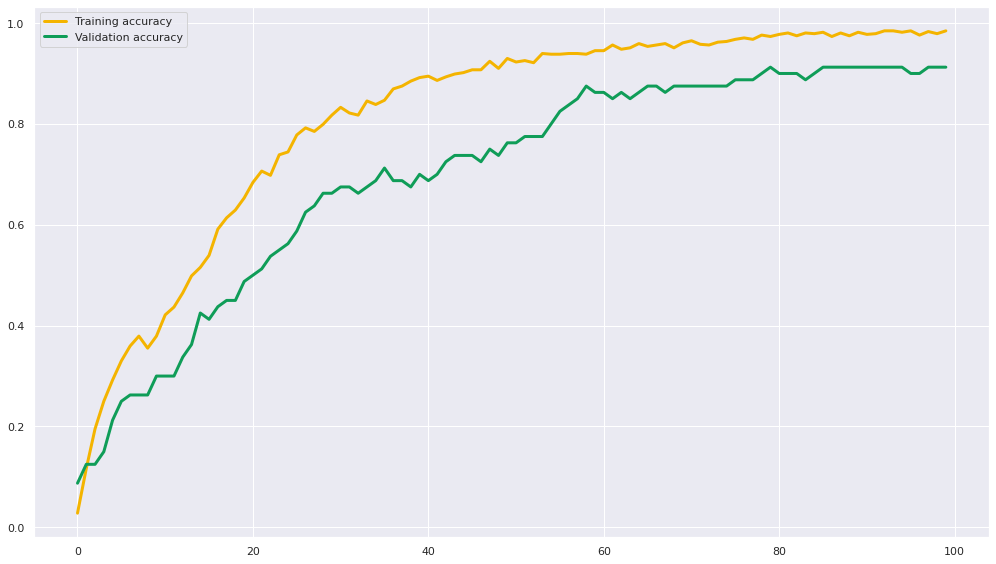

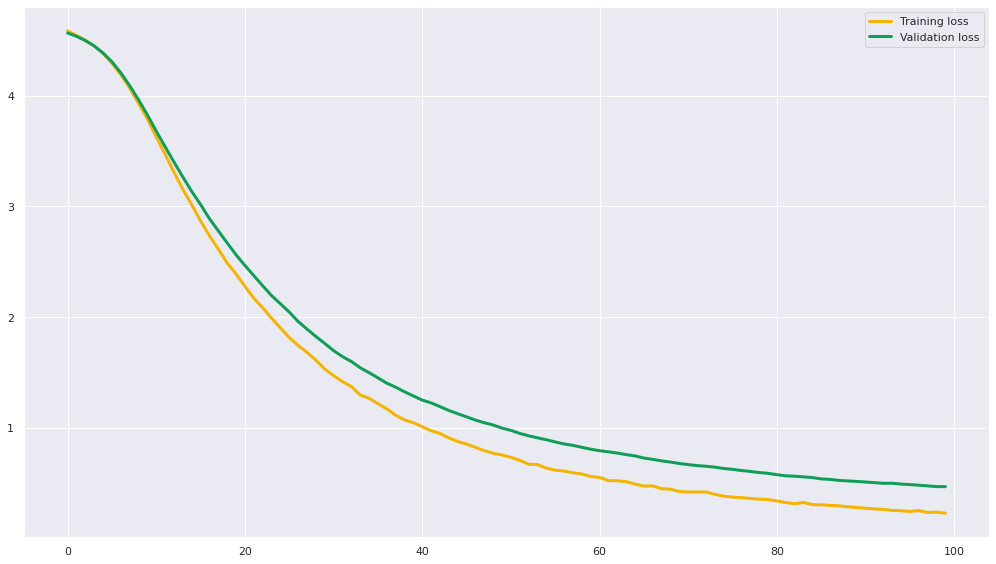

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 12ms/step - loss: 4.5820 - accuracy: 0.0337 - val_loss: 4.5620 - val_accuracy: 0.1500
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5396 - accuracy: 0.1390 - val_loss: 4.5283 - val_accuracy: 0.2250
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4939 - accuracy: 0.2247 - val_loss: 4.4895 - val_accuracy: 0.2000
Epoch 4/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4390 - accuracy: 0.2978 - val_loss: 4.4382 - val_accuracy: 0.2500
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.3711 - accuracy: 0.3469 - val_loss: 4.3700 - val_accuracy: 0.2750
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2849 - accuracy: 0.3539 - val_loss: 4.2846 - val_accuracy: 0.2875
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.1766

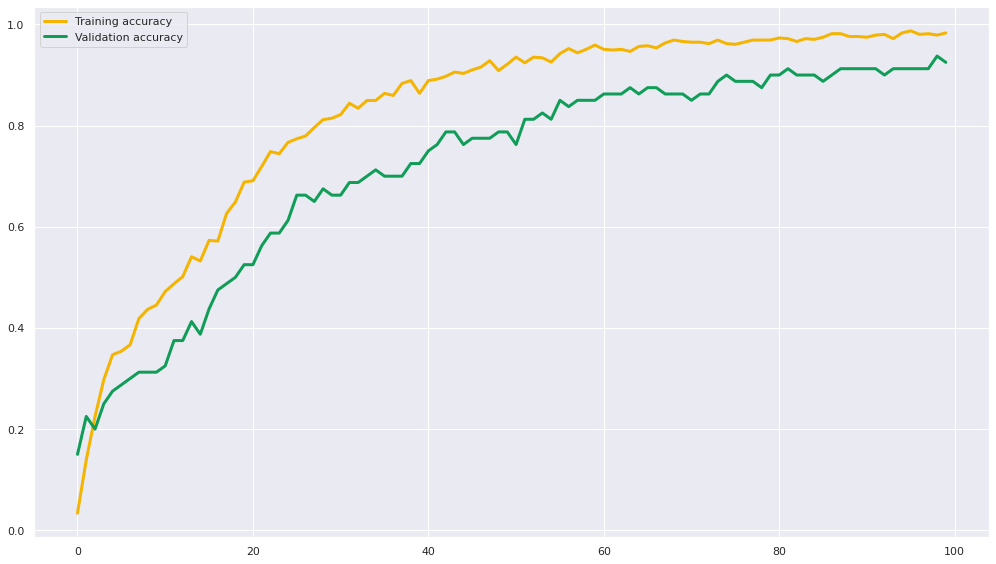

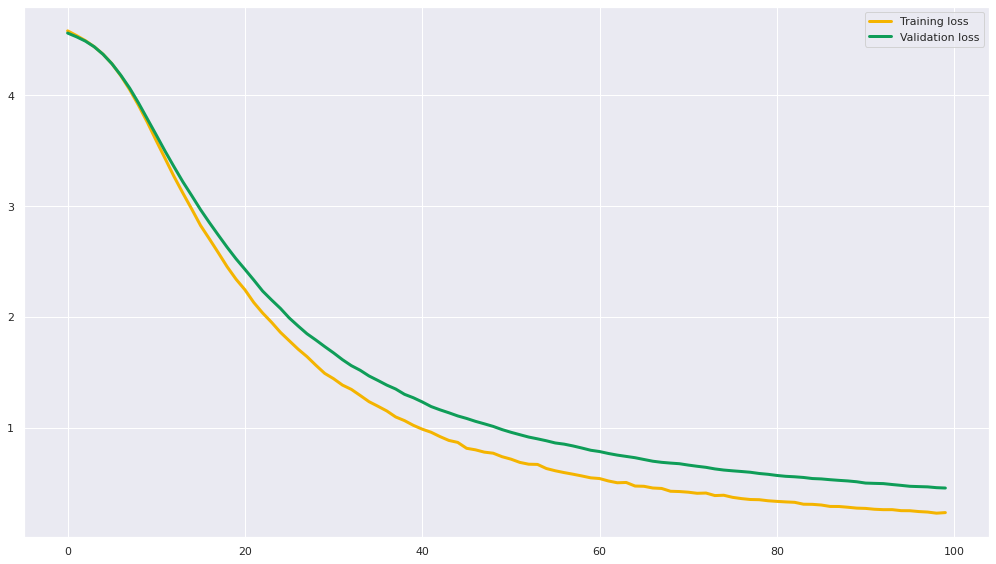

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5834 - accuracy: 0.0239 - val_loss: 4.5648 - val_accuracy: 0.0875
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5374 - accuracy: 0.1362 - val_loss: 4.5327 - val_accuracy: 0.1875
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4928 - accuracy: 0.2051 - val_loss: 4.4937 - val_accuracy: 0.2250
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.4392 - accuracy: 0.2753 - val_loss: 4.4449 - val_accuracy: 0.2500
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.3729 - accuracy: 0.3301 - val_loss: 4.3782 - val_accuracy: 0.3125
Epoch 6/100
23/23 [==============================] - 0s 3ms/step - loss: 4.2879 - accuracy: 0.3455 - val_loss: 4.2970 - val_accuracy: 0.3000
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.1778

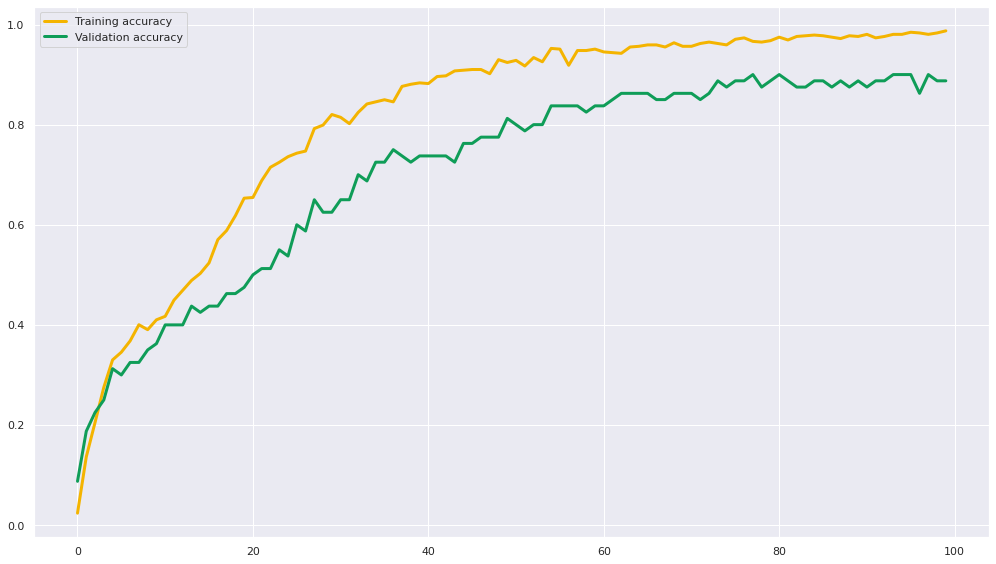

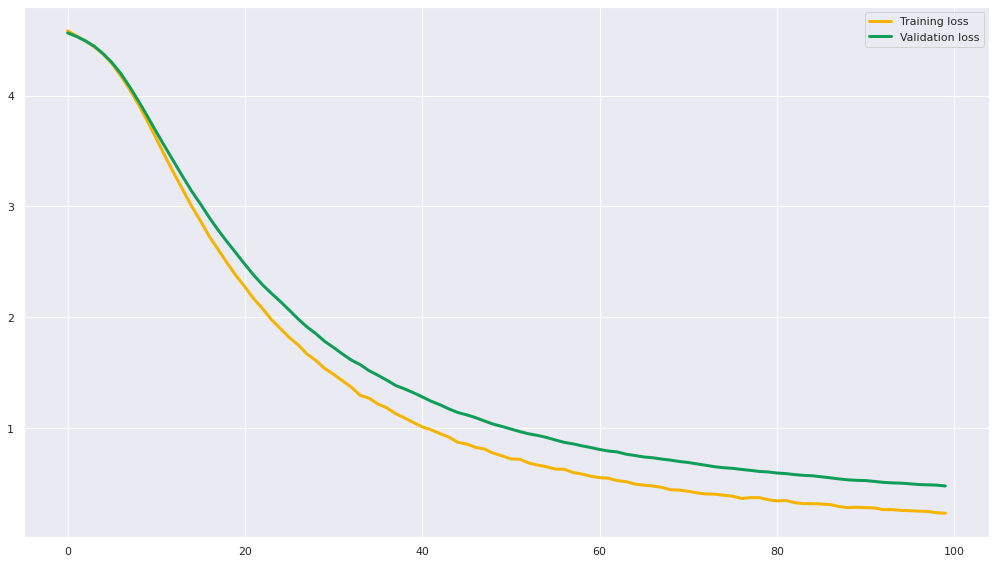

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 12ms/step - loss: 4.5865 - accuracy: 0.0211 - val_loss: 4.5704 - val_accuracy: 0.1375
Epoch 2/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5532 - accuracy: 0.0772 - val_loss: 4.5460 - val_accuracy: 0.1375
Epoch 3/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5159 - accuracy: 0.1615 - val_loss: 4.5162 - val_accuracy: 0.1875
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4746 - accuracy: 0.2177 - val_loss: 4.4798 - val_accuracy: 0.2000
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4244 - accuracy: 0.2416 - val_loss: 4.4333 - val_accuracy: 0.2125
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3648 - accuracy: 0.2753 - val_loss: 4.3760 - val_accuracy: 0.2125
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.2925

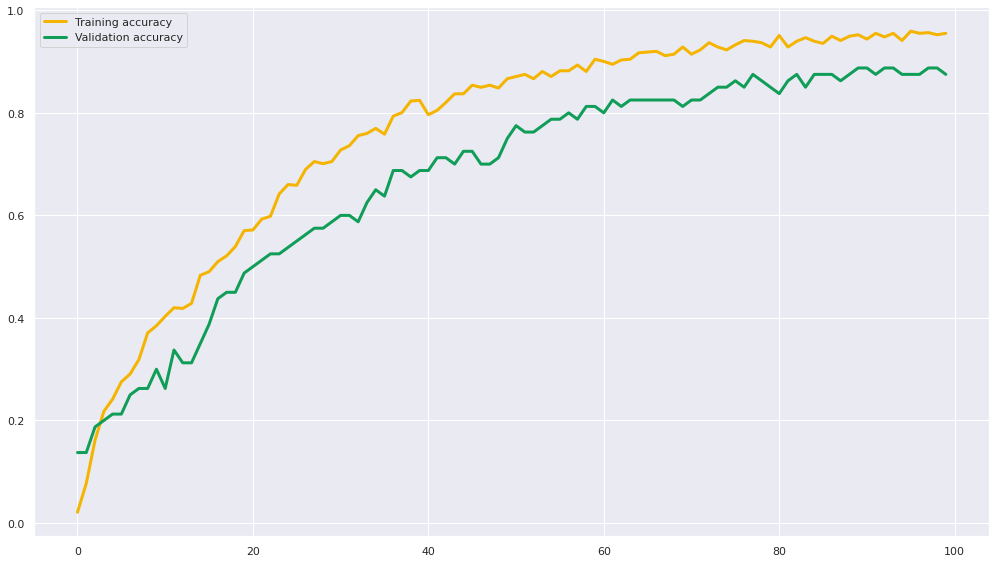

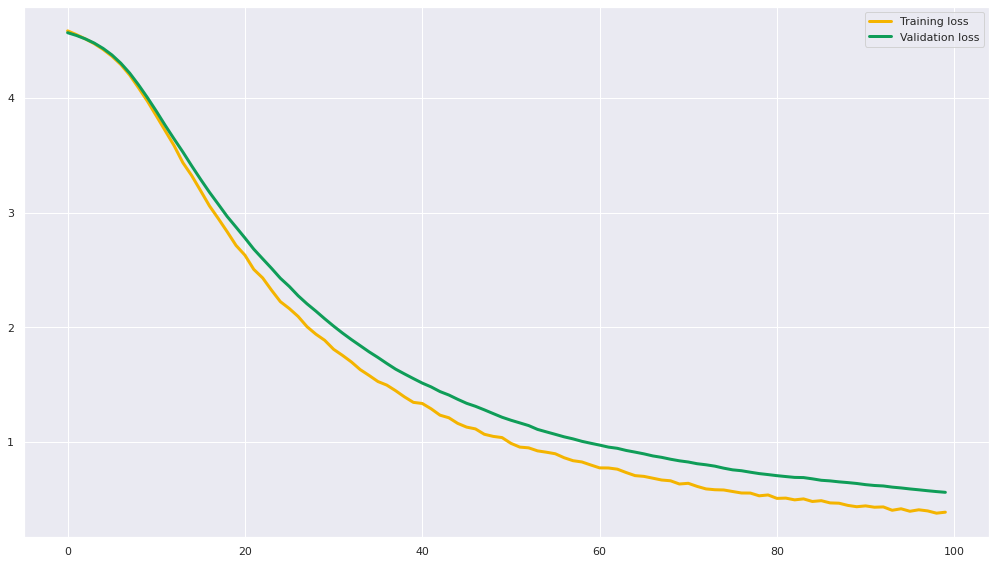

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5874 - accuracy: 0.0197 - val_loss: 4.5704 - val_accuracy: 0.0375
Epoch 2/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5532 - accuracy: 0.0604 - val_loss: 4.5429 - val_accuracy: 0.0875
Epoch 3/100
23/23 [==============================] - 0s 3ms/step - loss: 4.5137 - accuracy: 0.1461 - val_loss: 4.5115 - val_accuracy: 0.1500
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4753 - accuracy: 0.1826 - val_loss: 4.4705 - val_accuracy: 0.1625
Epoch 5/100
23/23 [==============================] - 0s 3ms/step - loss: 4.4202 - accuracy: 0.2346 - val_loss: 4.4206 - val_accuracy: 0.1750
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3540 - accuracy: 0.2683 - val_loss: 4.3592 - val_accuracy: 0.2500
Epoch 7/100
23/23 [==============================] - 0s 4ms/step - loss: 4.2768

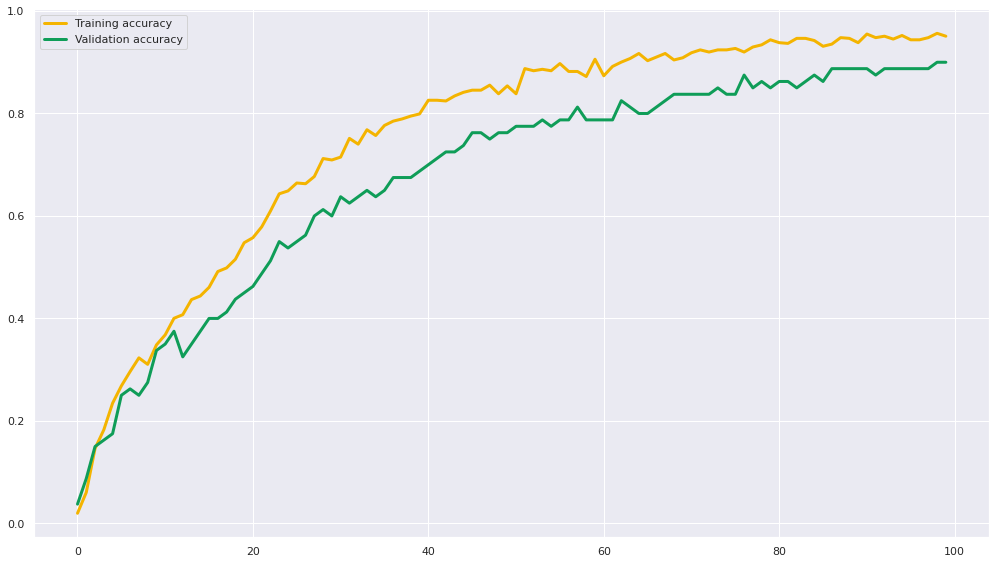

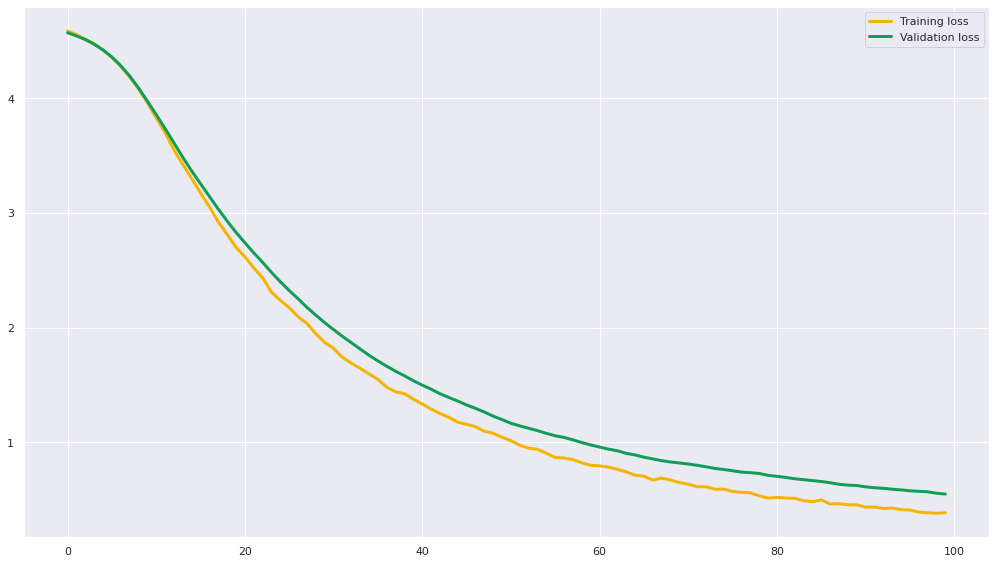

The batch_size is: 32, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 17ms/step - loss: 4.5852 - accuracy: 0.0197 - val_loss: 4.5761 - val_accuracy: 0.1125
Epoch 2/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5512 - accuracy: 0.0758 - val_loss: 4.5507 - val_accuracy: 0.1500
Epoch 3/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5119 - accuracy: 0.1601 - val_loss: 4.5204 - val_accuracy: 0.1500
Epoch 4/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4705 - accuracy: 0.2331 - val_loss: 4.4848 - val_accuracy: 0.1750
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4225 - accuracy: 0.2669 - val_loss: 4.4364 - val_accuracy: 0.1875
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3544 - accuracy: 0.3104 - val_loss: 4.3765 - val_accuracy: 0.2250
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2817

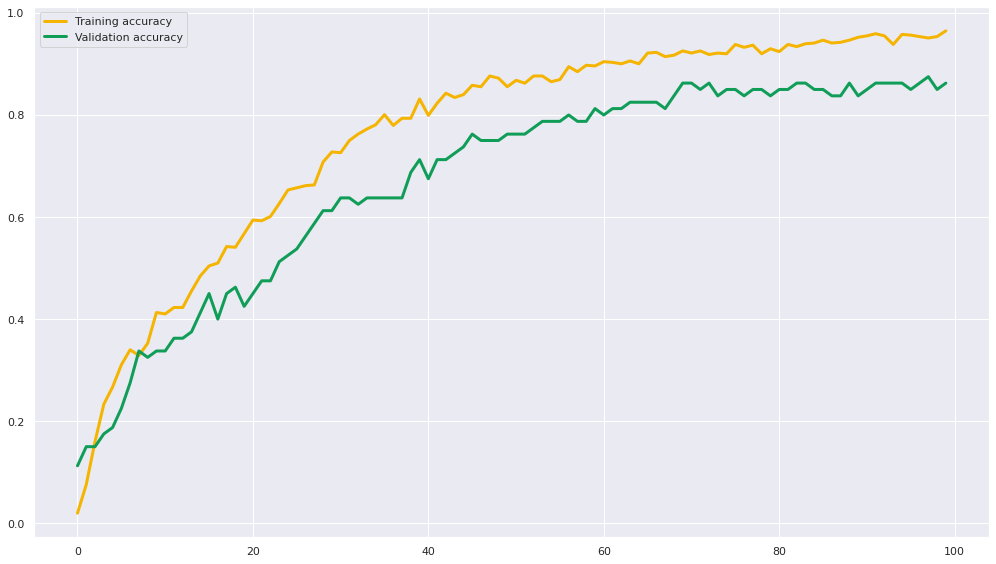

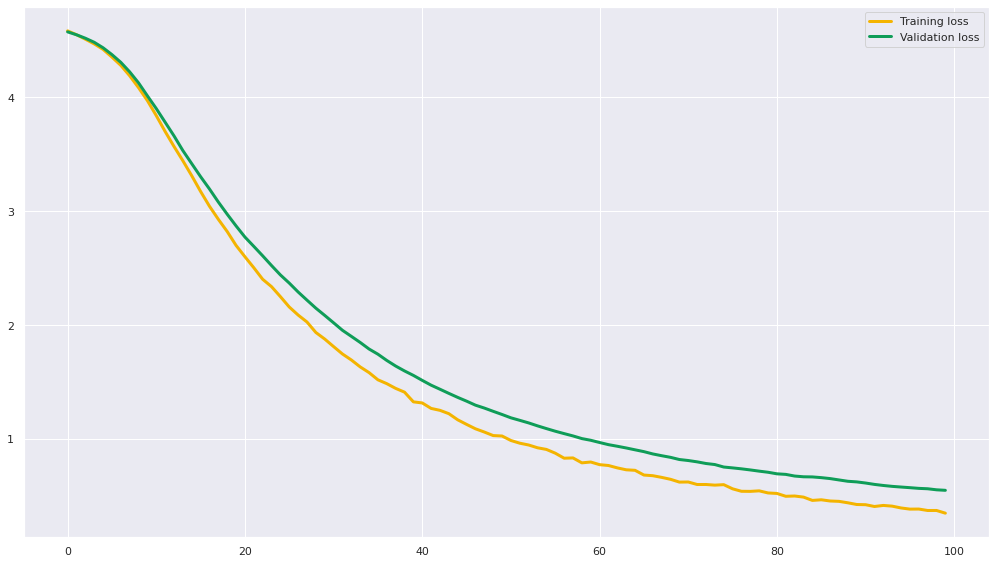

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 2s 16ms/step - loss: 4.5734 - accuracy: 0.0351 - val_loss: 4.5357 - val_accuracy: 0.1625
Epoch 2/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4942 - accuracy: 0.2795 - val_loss: 4.4735 - val_accuracy: 0.3000
Epoch 3/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4064 - accuracy: 0.3989 - val_loss: 4.3883 - val_accuracy: 0.2875
Epoch 4/100
23/23 [==============================] - 0s 7ms/step - loss: 4.2874 - accuracy: 0.4382 - val_loss: 4.2722 - val_accuracy: 0.3375
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.1319 - accuracy: 0.4242 - val_loss: 4.1135 - val_accuracy: 0.3250
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 3.9354 - accuracy: 0.4579 - val_loss: 3.9234 - val_accuracy: 0.3125
Epoch 7/100
23/23 [==============================] - 0s 7ms/step - loss: 3.7074

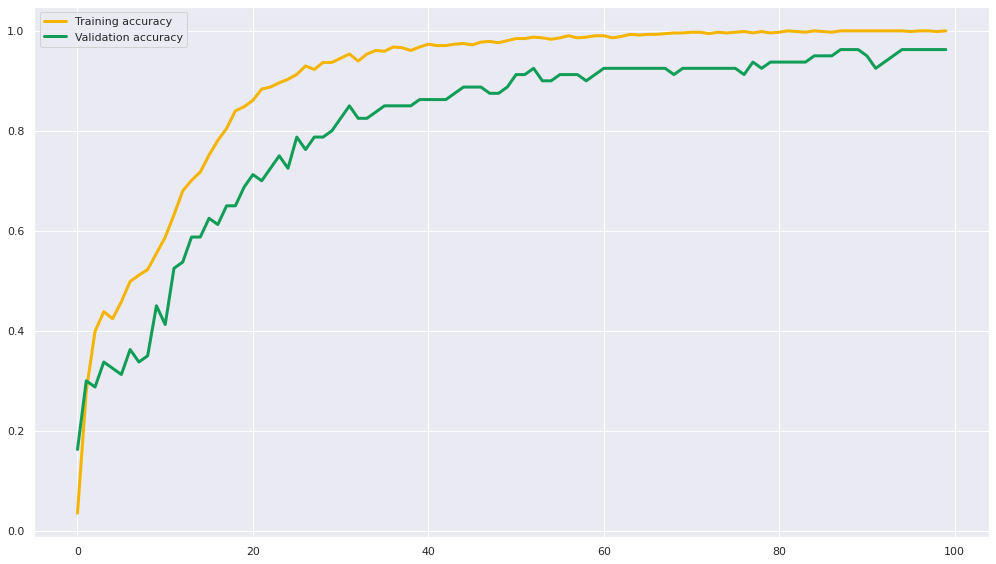

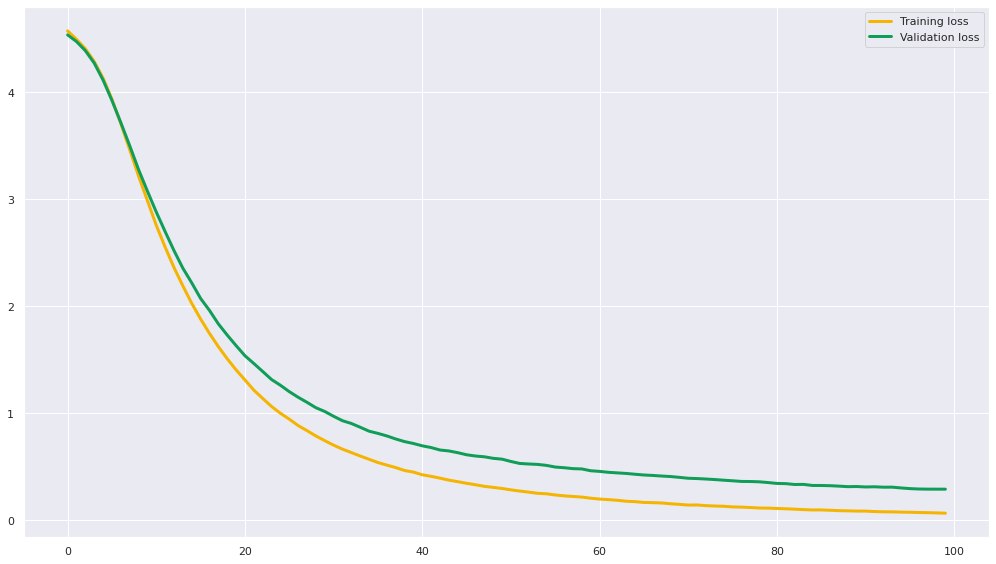

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 18ms/step - loss: 4.5726 - accuracy: 0.0604 - val_loss: 4.5336 - val_accuracy: 0.1750
Epoch 2/100
23/23 [==============================] - 0s 7ms/step - loss: 4.4964 - accuracy: 0.2374 - val_loss: 4.4754 - val_accuracy: 0.2375
Epoch 3/100
23/23 [==============================] - 0s 7ms/step - loss: 4.4081 - accuracy: 0.3132 - val_loss: 4.3866 - val_accuracy: 0.2500
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2900 - accuracy: 0.3820 - val_loss: 4.2680 - val_accuracy: 0.3125
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.1322 - accuracy: 0.4354 - val_loss: 4.1087 - val_accuracy: 0.3250
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 3.9335 - accuracy: 0.4733 - val_loss: 3.9184 - val_accuracy: 0.3375
Epoch 7/100
23/23 [==============================] - 0s 6ms/step - loss: 3.7024

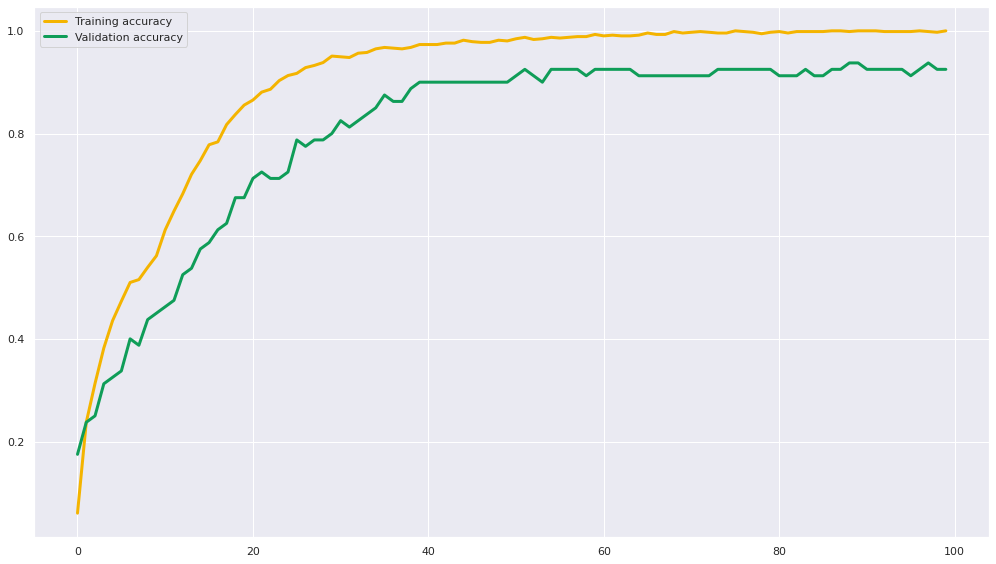

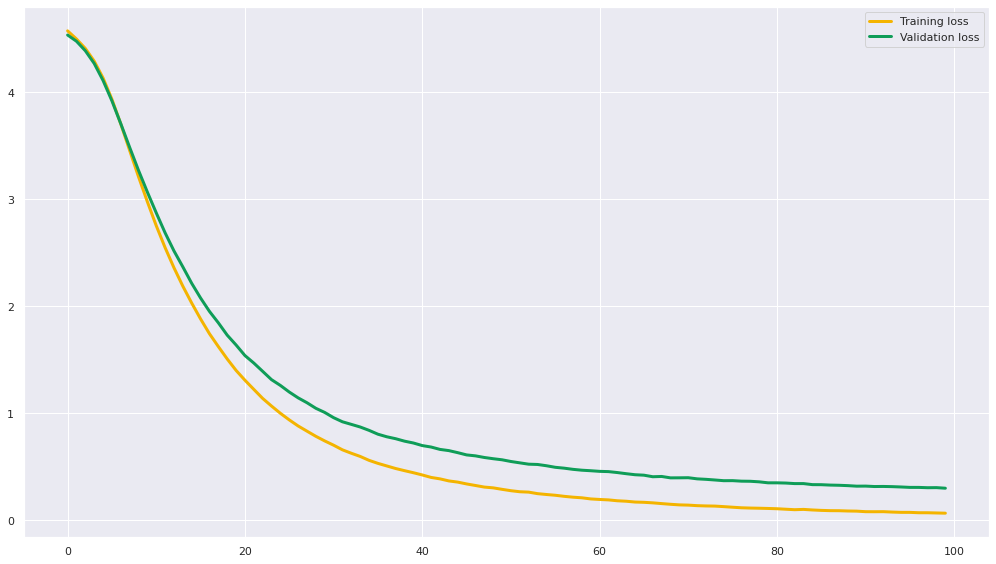

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5742 - accuracy: 0.0463 - val_loss: 4.5407 - val_accuracy: 0.1250
Epoch 2/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4934 - accuracy: 0.2528 - val_loss: 4.4750 - val_accuracy: 0.2375
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4049 - accuracy: 0.3539 - val_loss: 4.3879 - val_accuracy: 0.2875
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.2872 - accuracy: 0.4410 - val_loss: 4.2664 - val_accuracy: 0.3000
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.1296 - accuracy: 0.4607 - val_loss: 4.1111 - val_accuracy: 0.3375
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 3.9281 - accuracy: 0.4986 - val_loss: 3.9163 - val_accuracy: 0.3625
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 3.6974

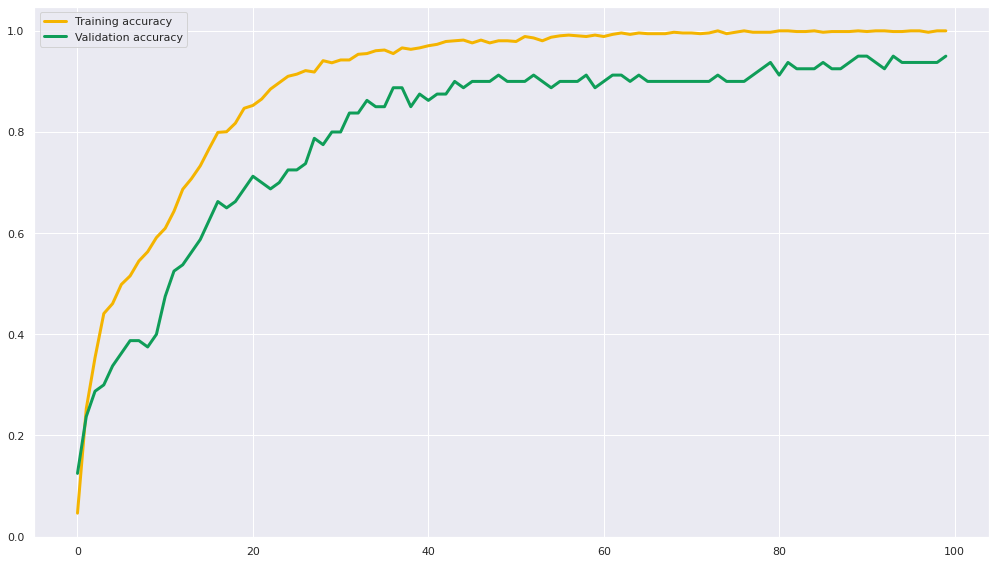

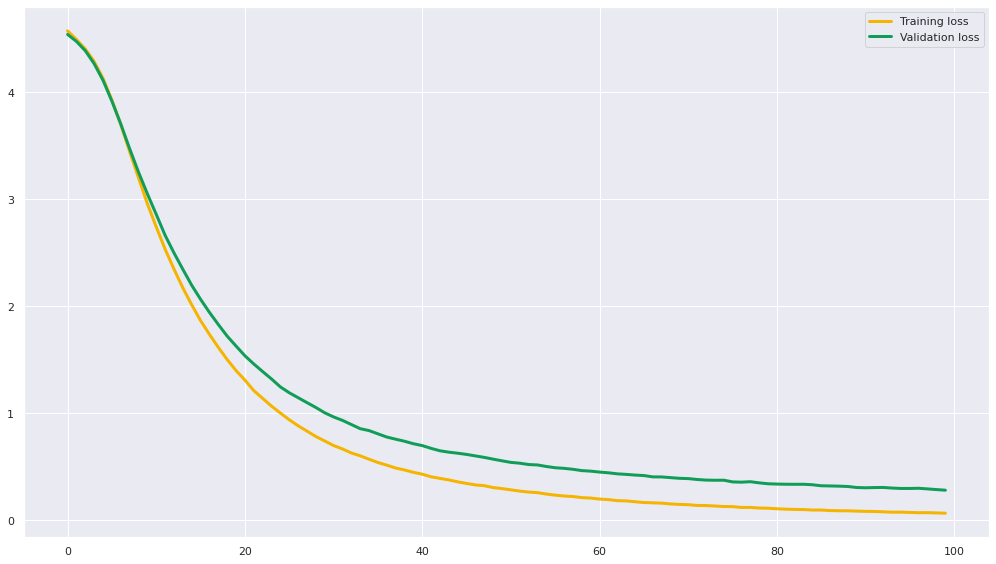

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 15ms/step - loss: 4.5755 - accuracy: 0.0393 - val_loss: 4.5466 - val_accuracy: 0.1500
Epoch 2/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5054 - accuracy: 0.2556 - val_loss: 4.4928 - val_accuracy: 0.3000
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4253 - accuracy: 0.3933 - val_loss: 4.4200 - val_accuracy: 0.3000
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3285 - accuracy: 0.4045 - val_loss: 4.3206 - val_accuracy: 0.3375
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.1970 - accuracy: 0.4494 - val_loss: 4.1905 - val_accuracy: 0.3375
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.0292 - accuracy: 0.4916 - val_loss: 4.0287 - val_accuracy: 0.3250
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 3.8336

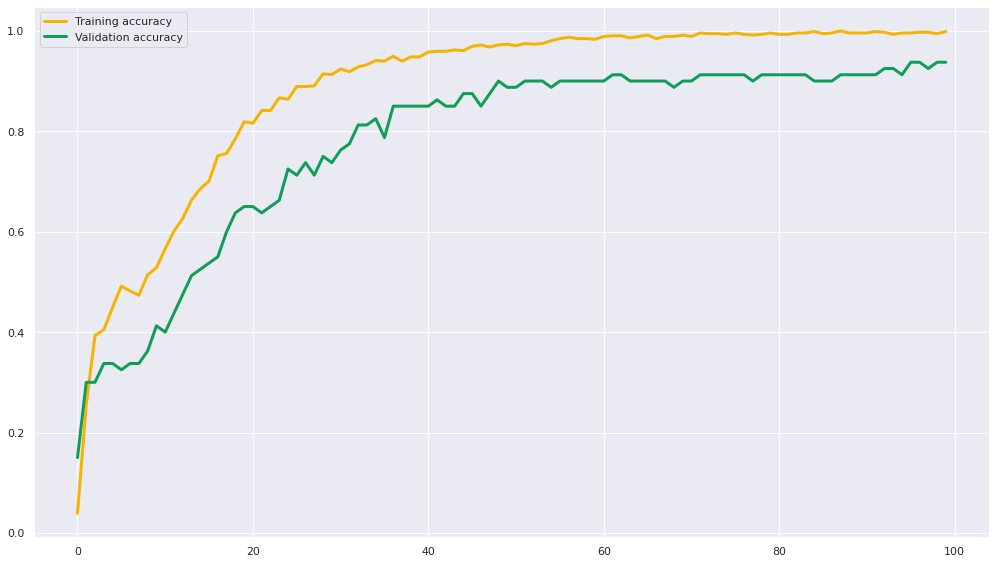

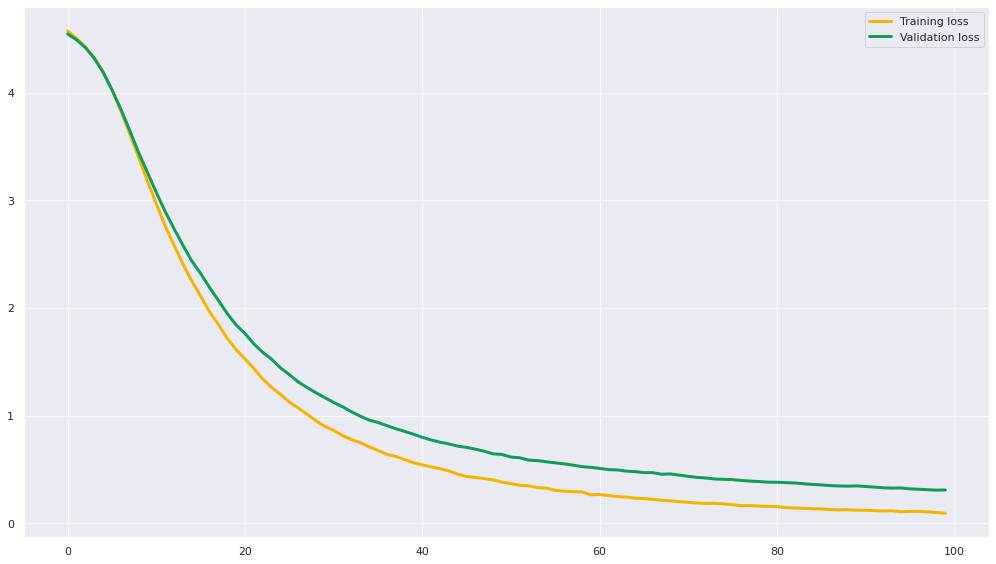

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5745 - accuracy: 0.0351 - val_loss: 4.5423 - val_accuracy: 0.1125
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5043 - accuracy: 0.1980 - val_loss: 4.4854 - val_accuracy: 0.2250
Epoch 3/100
23/23 [==============================] - 0s 4ms/step - loss: 4.4267 - accuracy: 0.3132 - val_loss: 4.4124 - val_accuracy: 0.2000
Epoch 4/100
23/23 [==============================] - 0s 4ms/step - loss: 4.3242 - accuracy: 0.3638 - val_loss: 4.3162 - val_accuracy: 0.2625
Epoch 5/100
23/23 [==============================] - 0s 5ms/step - loss: 4.1927 - accuracy: 0.4073 - val_loss: 4.1839 - val_accuracy: 0.2750
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.0247 - accuracy: 0.4368 - val_loss: 4.0263 - val_accuracy: 0.3250
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 3.8296

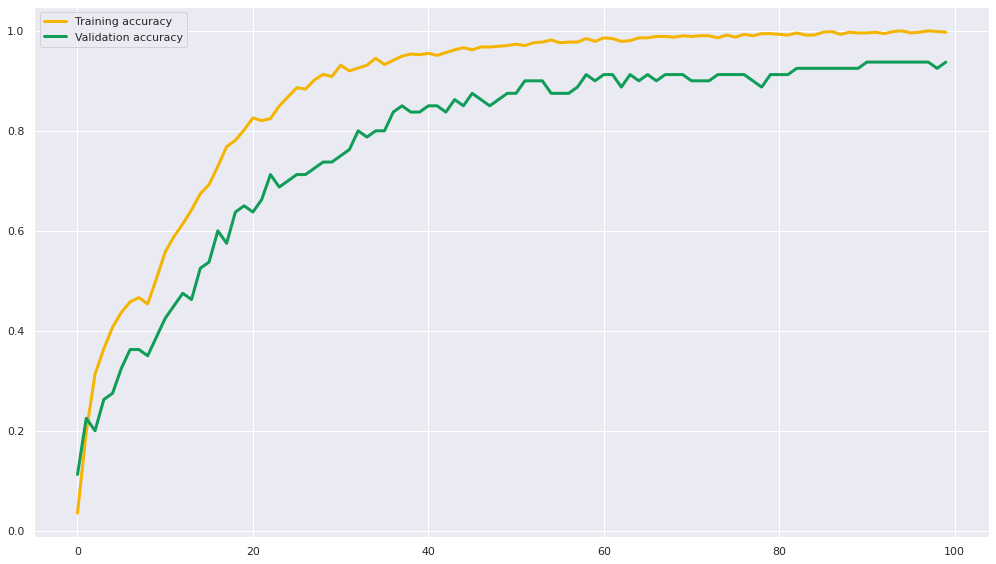

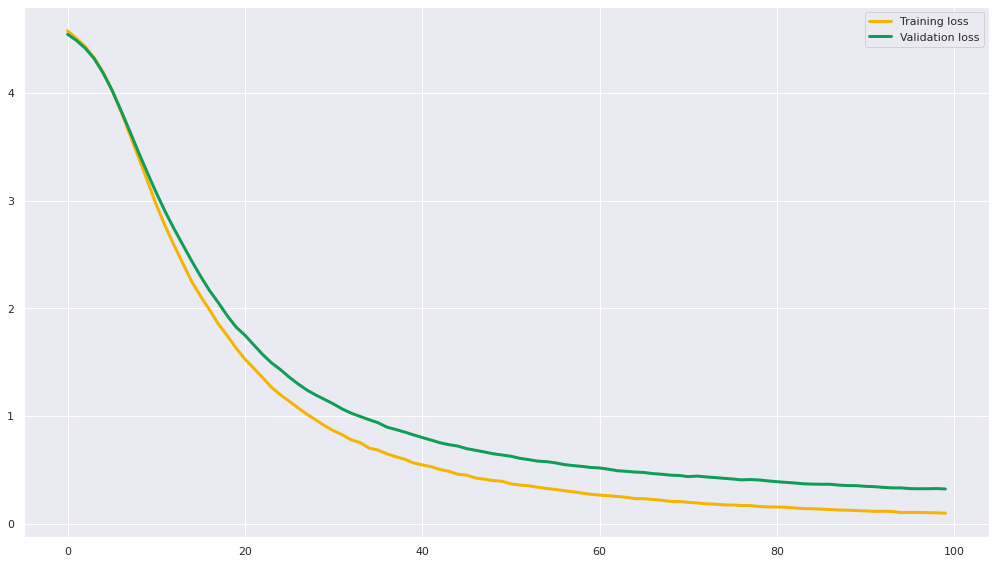

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 13ms/step - loss: 4.5799 - accuracy: 0.0323 - val_loss: 4.5429 - val_accuracy: 0.1750
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5101 - accuracy: 0.2177 - val_loss: 4.4881 - val_accuracy: 0.2500
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4353 - accuracy: 0.3385 - val_loss: 4.4193 - val_accuracy: 0.3125
Epoch 4/100
23/23 [==============================] - 0s 3ms/step - loss: 4.3377 - accuracy: 0.4101 - val_loss: 4.3216 - val_accuracy: 0.3375
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.2077 - accuracy: 0.4157 - val_loss: 4.1905 - val_accuracy: 0.3500
Epoch 6/100
23/23 [==============================] - 0s 5ms/step - loss: 4.0421 - accuracy: 0.4635 - val_loss: 4.0280 - val_accuracy: 0.4000
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 3.8496

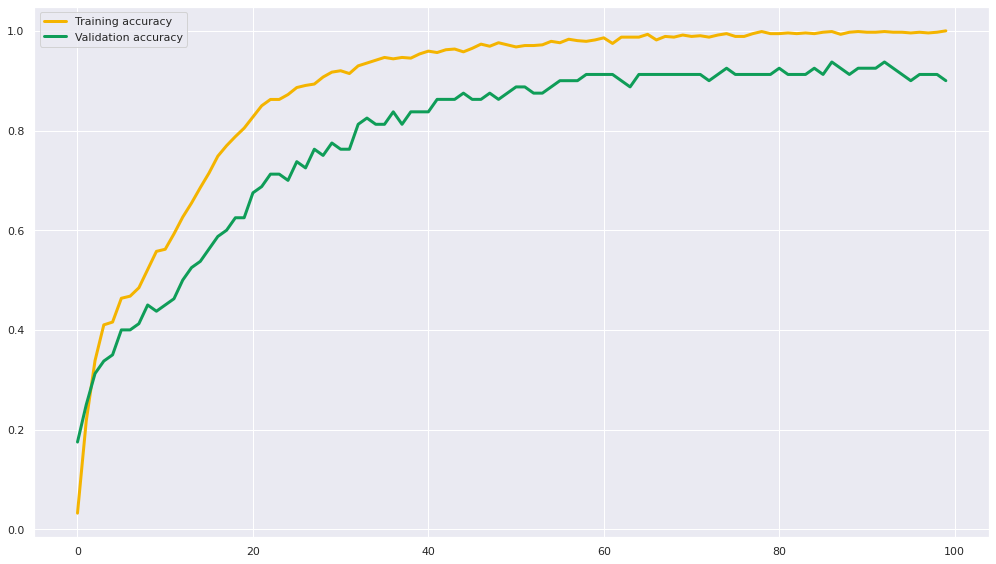

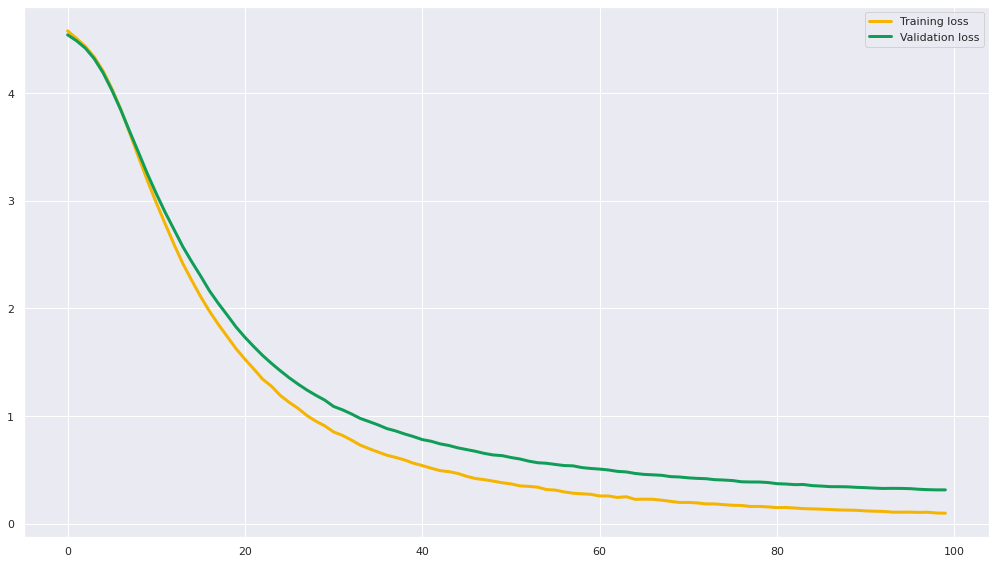

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5831 - accuracy: 0.0197 - val_loss: 4.5589 - val_accuracy: 0.1250
Epoch 2/100
23/23 [==============================] - 0s 4ms/step - loss: 4.5258 - accuracy: 0.1404 - val_loss: 4.5151 - val_accuracy: 0.1625
Epoch 3/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4604 - accuracy: 0.2725 - val_loss: 4.4572 - val_accuracy: 0.2375
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3914 - accuracy: 0.2949 - val_loss: 4.3874 - val_accuracy: 0.2250
Epoch 5/100
23/23 [==============================] - 0s 10ms/step - loss: 4.2936 - accuracy: 0.3680 - val_loss: 4.2959 - val_accuracy: 0.2500
Epoch 6/100
23/23 [==============================] - 0s 8ms/step - loss: 4.1721 - accuracy: 0.3919 - val_loss: 4.1796 - val_accuracy: 0.2500
Epoch 7/100
23/23 [==============================] - 0s 8ms/step - loss: 4.030

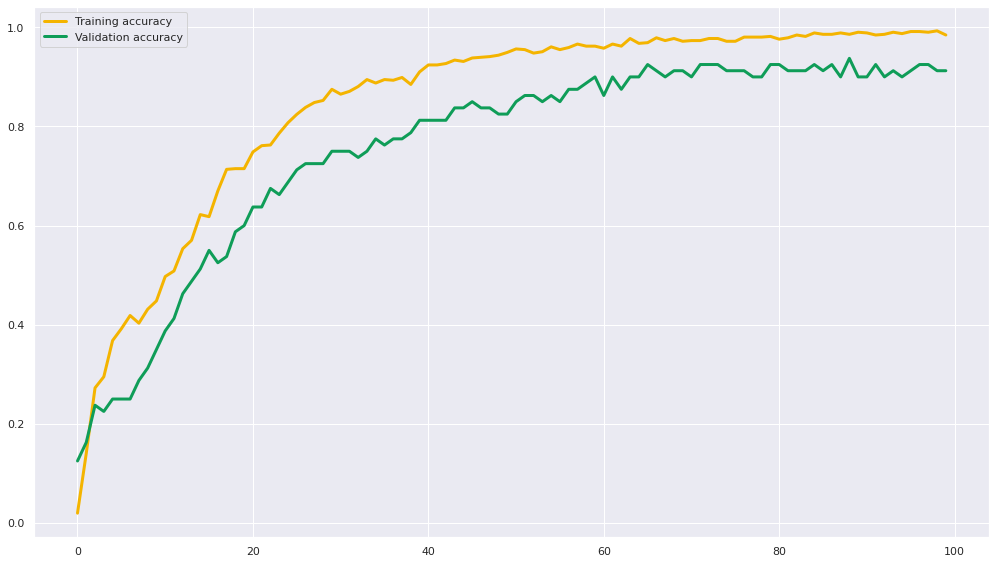

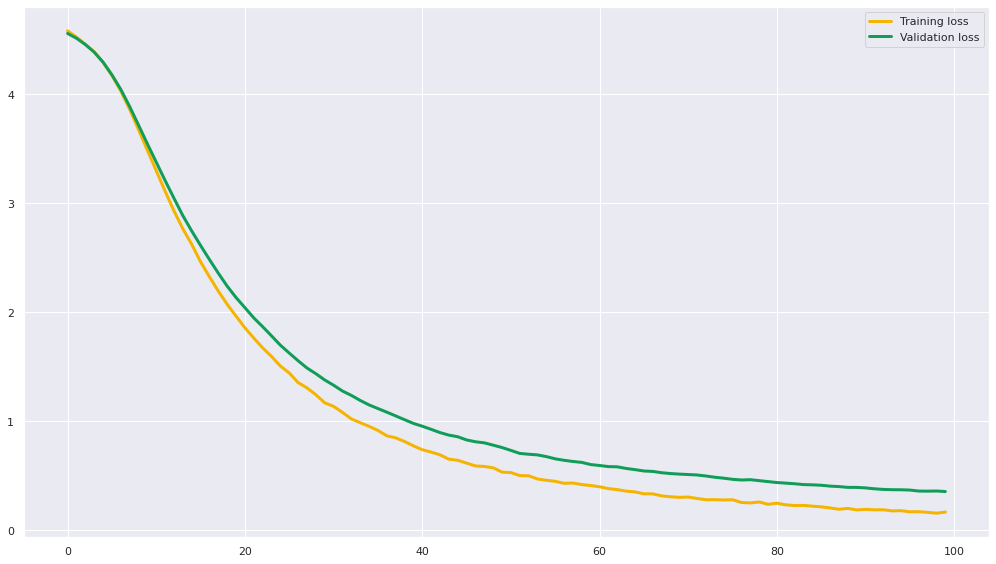

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 23ms/step - loss: 4.5750 - accuracy: 0.0534 - val_loss: 4.5555 - val_accuracy: 0.0875
Epoch 2/100
23/23 [==============================] - 0s 6ms/step - loss: 4.5168 - accuracy: 0.1573 - val_loss: 4.5083 - val_accuracy: 0.1750
Epoch 3/100
23/23 [==============================] - 0s 5ms/step - loss: 4.4557 - accuracy: 0.2612 - val_loss: 4.4544 - val_accuracy: 0.2000
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3731 - accuracy: 0.3146 - val_loss: 4.3822 - val_accuracy: 0.1750
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 4.2755 - accuracy: 0.3553 - val_loss: 4.2890 - val_accuracy: 0.2375
Epoch 6/100
23/23 [==============================] - 0s 8ms/step - loss: 4.1541 - accuracy: 0.3666 - val_loss: 4.1690 - val_accuracy: 0.3000
Epoch 7/100
23/23 [==============================] - 0s 7ms/step - loss: 4.0024

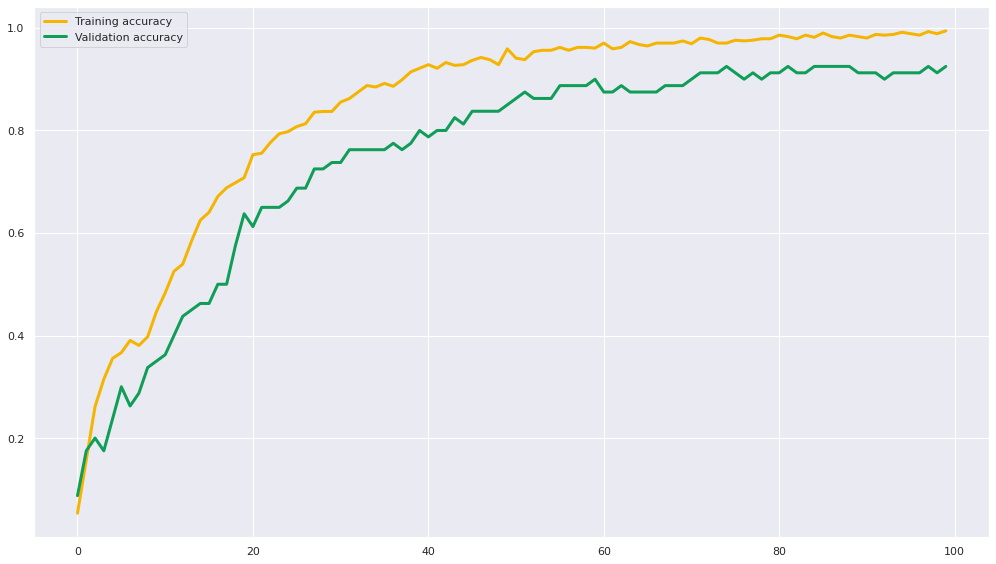

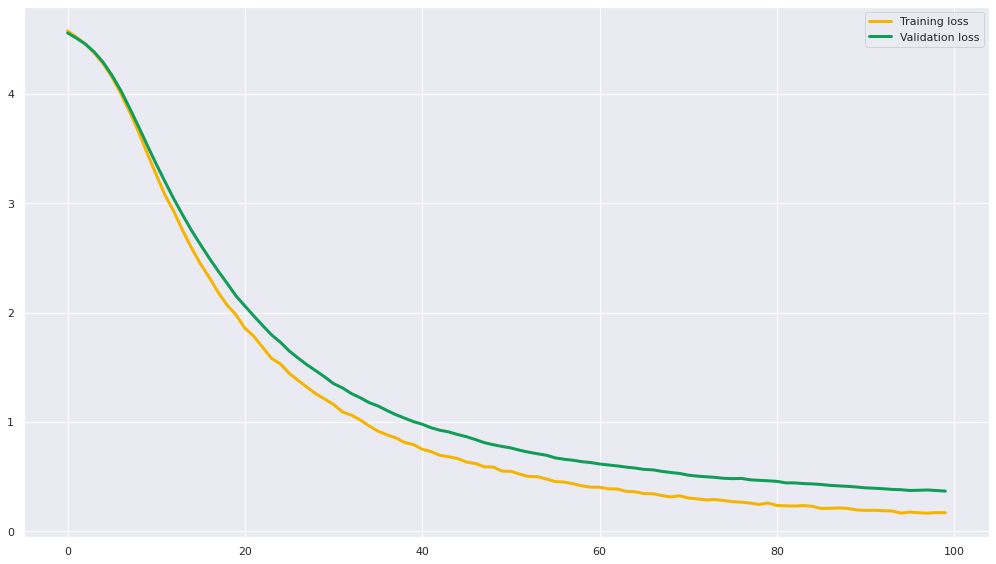

The batch_size is: 32, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 15ms/step - loss: 4.5791 - accuracy: 0.0281 - val_loss: 4.5593 - val_accuracy: 0.1125
Epoch 2/100
23/23 [==============================] - 0s 5ms/step - loss: 4.5200 - accuracy: 0.1713 - val_loss: 4.5103 - val_accuracy: 0.2375
Epoch 3/100
23/23 [==============================] - 0s 6ms/step - loss: 4.4598 - accuracy: 0.2430 - val_loss: 4.4578 - val_accuracy: 0.2625
Epoch 4/100
23/23 [==============================] - 0s 5ms/step - loss: 4.3795 - accuracy: 0.3216 - val_loss: 4.3840 - val_accuracy: 0.3000
Epoch 5/100
23/23 [==============================] - 0s 4ms/step - loss: 4.2783 - accuracy: 0.3567 - val_loss: 4.2935 - val_accuracy: 0.3125
Epoch 6/100
23/23 [==============================] - 0s 4ms/step - loss: 4.1554 - accuracy: 0.4031 - val_loss: 4.1718 - val_accuracy: 0.3250
Epoch 7/100
23/23 [==============================] - 0s 5ms/step - loss: 4.0144

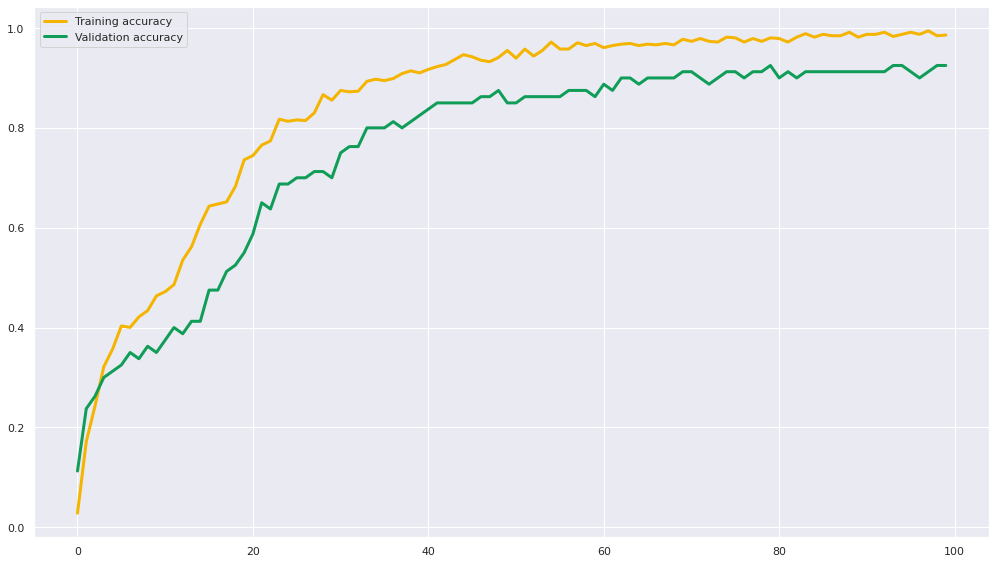

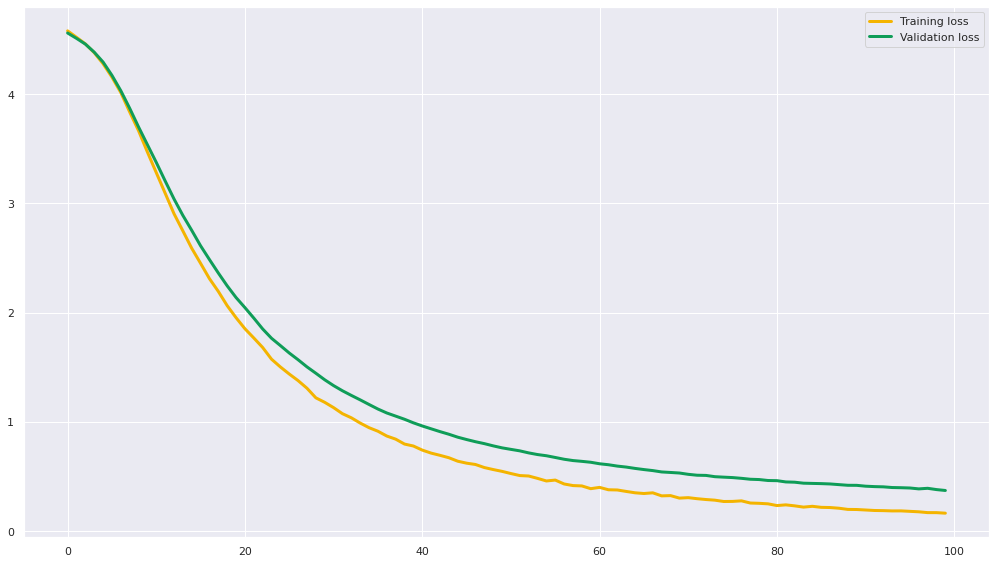

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 2s 20ms/step - loss: 4.5608 - accuracy: 0.0590 - val_loss: 4.5151 - val_accuracy: 0.2000
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4346 - accuracy: 0.3230 - val_loss: 4.4021 - val_accuracy: 0.2625
Epoch 3/100
23/23 [==============================] - 0s 9ms/step - loss: 4.2758 - accuracy: 0.3989 - val_loss: 4.2438 - val_accuracy: 0.3125
Epoch 4/100
23/23 [==============================] - 0s 9ms/step - loss: 4.0503 - accuracy: 0.4579 - val_loss: 4.0073 - val_accuracy: 0.3750
Epoch 5/100
23/23 [==============================] - 0s 8ms/step - loss: 3.7571 - accuracy: 0.4888 - val_loss: 3.7243 - val_accuracy: 0.3625
Epoch 6/100
23/23 [==============================] - 0s 9ms/step - loss: 3.4191 - accuracy: 0.4958 - val_loss: 3.4215 - val_accuracy: 0.3625
Epoch 7/100
23/23 [==============================] - 0s 7ms/step - loss: 3.0758

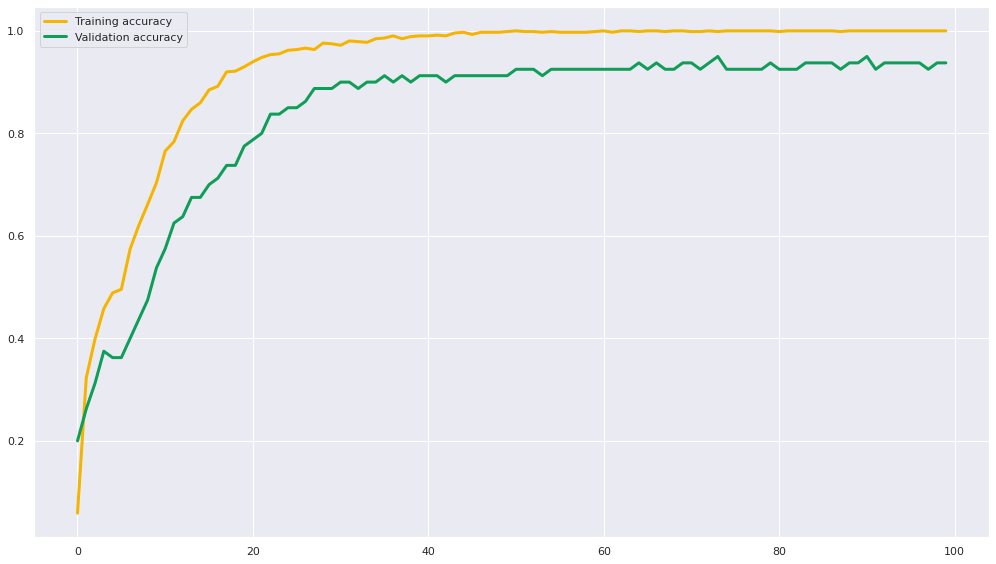

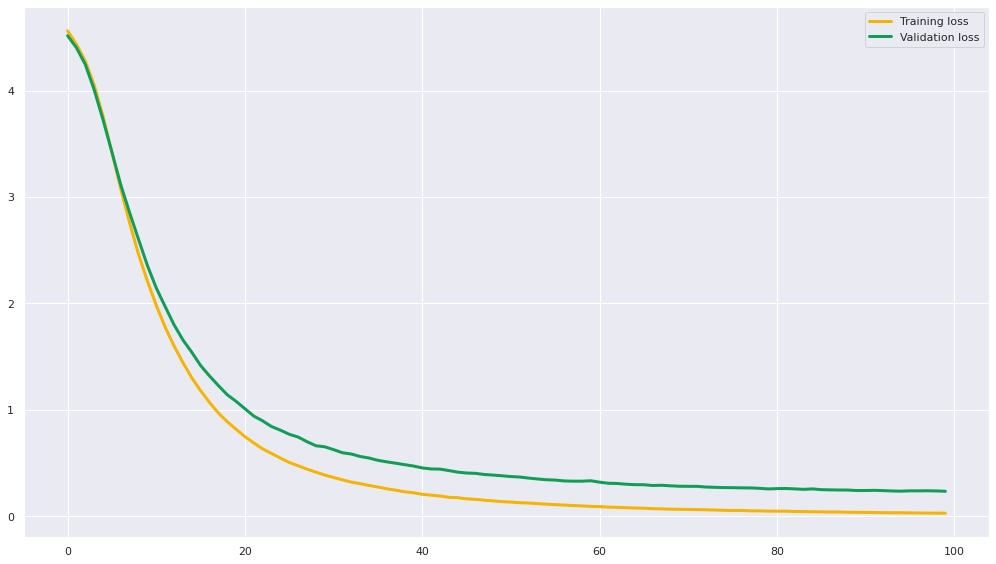

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 19ms/step - loss: 4.5672 - accuracy: 0.0618 - val_loss: 4.5115 - val_accuracy: 0.2000
Epoch 2/100
23/23 [==============================] - 0s 11ms/step - loss: 4.4397 - accuracy: 0.3441 - val_loss: 4.4029 - val_accuracy: 0.2500
Epoch 3/100
23/23 [==============================] - 0s 10ms/step - loss: 4.2849 - accuracy: 0.4059 - val_loss: 4.2430 - val_accuracy: 0.2500
Epoch 4/100
23/23 [==============================] - 0s 6ms/step - loss: 4.0619 - accuracy: 0.4396 - val_loss: 4.0184 - val_accuracy: 0.2875
Epoch 5/100
23/23 [==============================] - 0s 6ms/step - loss: 3.7745 - accuracy: 0.4874 - val_loss: 3.7415 - val_accuracy: 0.3875
Epoch 6/100
23/23 [==============================] - 0s 9ms/step - loss: 3.4442 - accuracy: 0.4958 - val_loss: 3.4425 - val_accuracy: 0.3750
Epoch 7/100
23/23 [==============================] - 0s 8ms/step - loss: 3.10

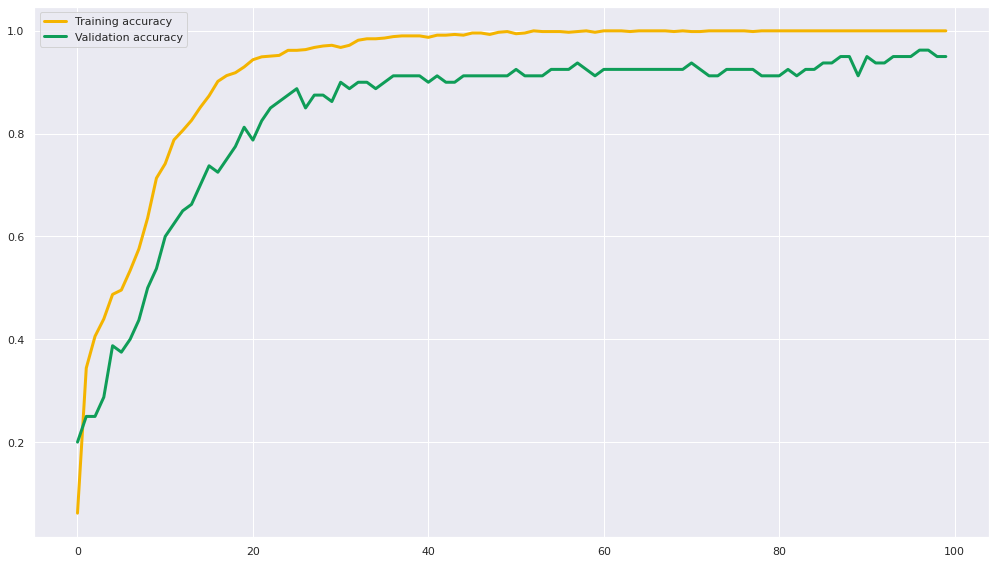

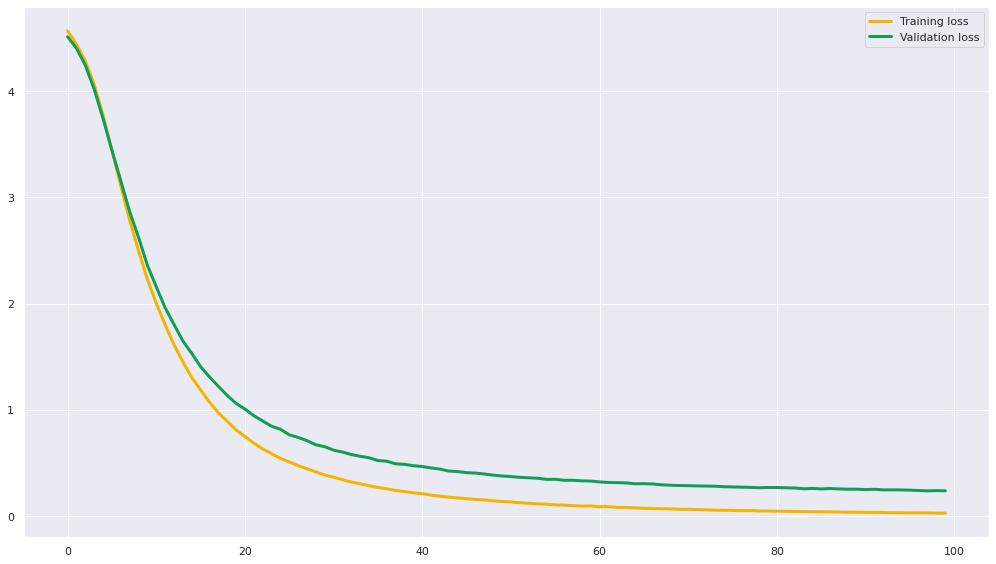

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
23/23 [==============================] - 1s 16ms/step - loss: 4.5618 - accuracy: 0.0927 - val_loss: 4.5128 - val_accuracy: 0.1625
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4375 - accuracy: 0.2921 - val_loss: 4.4067 - val_accuracy: 0.2500
Epoch 3/100
23/23 [==============================] - 0s 9ms/step - loss: 4.2825 - accuracy: 0.4354 - val_loss: 4.2483 - val_accuracy: 0.3125
Epoch 4/100
23/23 [==============================] - 0s 9ms/step - loss: 4.0618 - accuracy: 0.4410 - val_loss: 4.0266 - val_accuracy: 0.3250
Epoch 5/100
23/23 [==============================] - 0s 8ms/step - loss: 3.7716 - accuracy: 0.4817 - val_loss: 3.7329 - val_accuracy: 0.3875
Epoch 6/100
23/23 [==============================] - 0s 8ms/step - loss: 3.4422 - accuracy: 0.5154 - val_loss: 3.4248 - val_accuracy: 0.3750
Epoch 7/100
23/23 [==============================] - 0s 8ms/step - loss: 3.1016

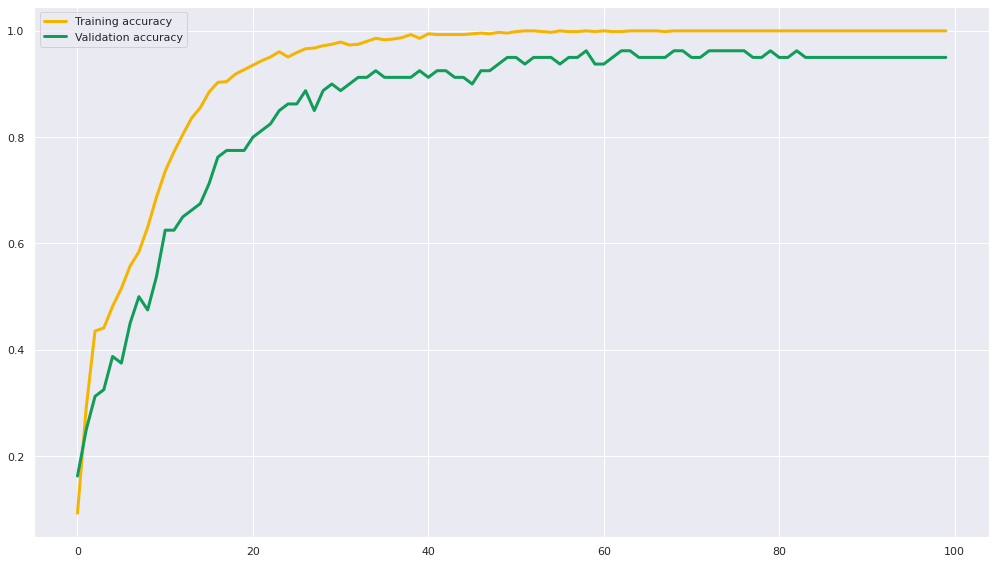

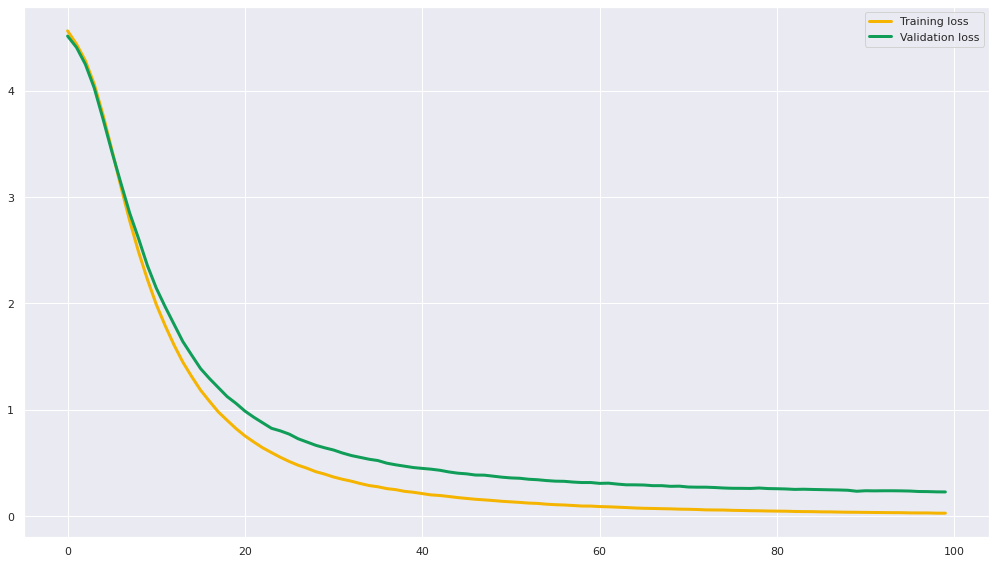

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 19ms/step - loss: 4.5670 - accuracy: 0.0787 - val_loss: 4.5271 - val_accuracy: 0.2000
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4592 - accuracy: 0.2781 - val_loss: 4.4352 - val_accuracy: 0.2000
Epoch 3/100
23/23 [==============================] - 0s 11ms/step - loss: 4.3271 - accuracy: 0.4087 - val_loss: 4.3065 - val_accuracy: 0.3000
Epoch 4/100
23/23 [==============================] - 0s 10ms/step - loss: 4.1494 - accuracy: 0.4396 - val_loss: 4.1292 - val_accuracy: 0.3250
Epoch 5/100
23/23 [==============================] - 0s 12ms/step - loss: 3.9033 - accuracy: 0.4508 - val_loss: 3.8927 - val_accuracy: 0.3625
Epoch 6/100
23/23 [==============================] - 0s 10ms/step - loss: 3.6224 - accuracy: 0.4761 - val_loss: 3.6270 - val_accuracy: 0.3625
Epoch 7/100
23/23 [==============================] - 0s 10ms/step - loss: 3

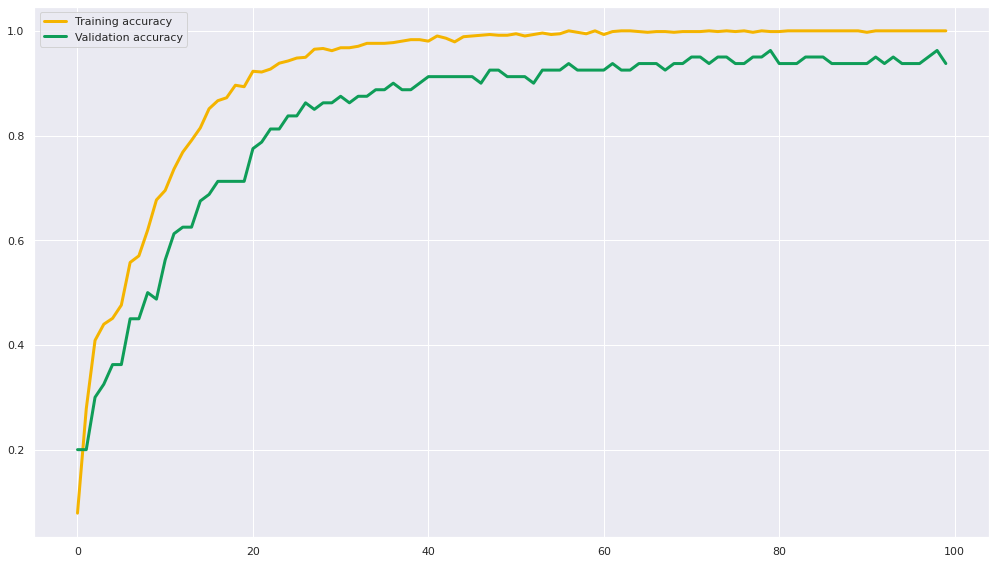

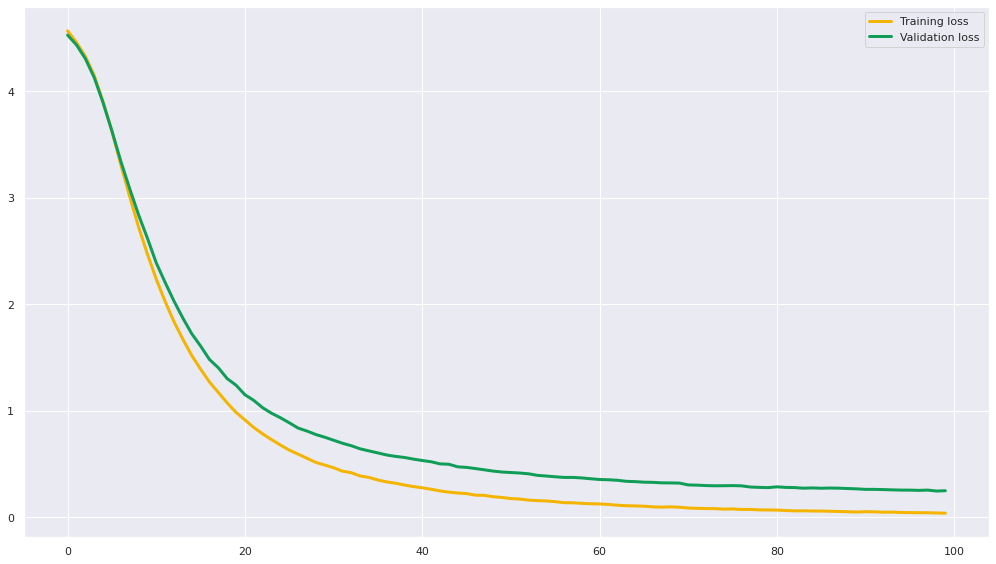

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 16ms/step - loss: 4.5664 - accuracy: 0.0716 - val_loss: 4.5183 - val_accuracy: 0.2750
Epoch 2/100
23/23 [==============================] - 0s 7ms/step - loss: 4.4537 - accuracy: 0.3301 - val_loss: 4.4280 - val_accuracy: 0.3125
Epoch 3/100
23/23 [==============================] - 0s 8ms/step - loss: 4.3211 - accuracy: 0.4101 - val_loss: 4.3016 - val_accuracy: 0.3375
Epoch 4/100
23/23 [==============================] - 0s 8ms/step - loss: 4.1386 - accuracy: 0.4522 - val_loss: 4.1121 - val_accuracy: 0.3625
Epoch 5/100
23/23 [==============================] - 0s 9ms/step - loss: 3.8980 - accuracy: 0.4635 - val_loss: 3.8788 - val_accuracy: 0.3125
Epoch 6/100
23/23 [==============================] - 0s 8ms/step - loss: 3.6158 - accuracy: 0.5000 - val_loss: 3.6167 - val_accuracy: 0.4000
Epoch 7/100
23/23 [==============================] - 0s 9ms/step - loss: 3.3049

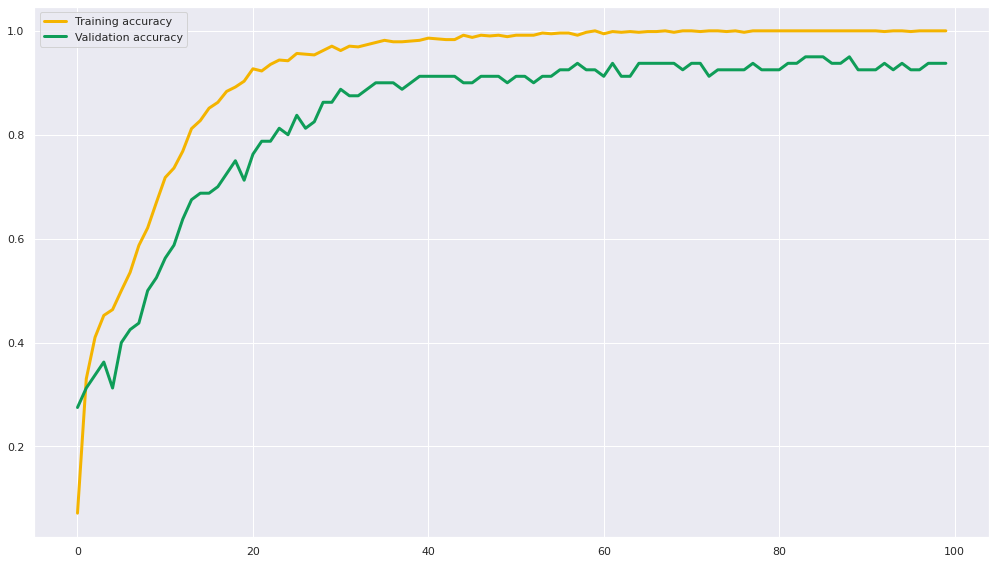

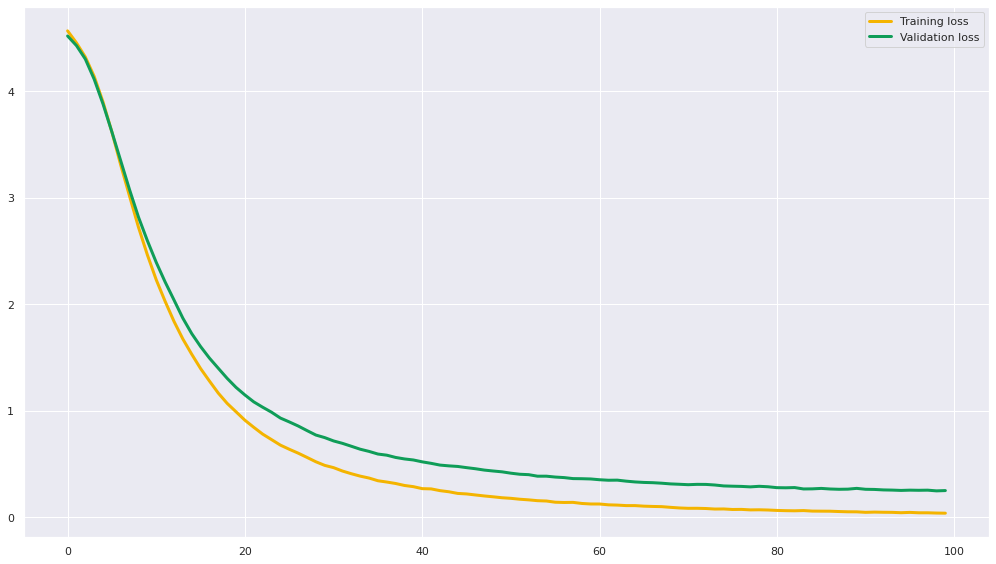

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
23/23 [==============================] - 1s 20ms/step - loss: 4.5675 - accuracy: 0.0590 - val_loss: 4.5227 - val_accuracy: 0.1750
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4596 - accuracy: 0.2992 - val_loss: 4.4311 - val_accuracy: 0.2875
Epoch 3/100
23/23 [==============================] - 0s 9ms/step - loss: 4.3251 - accuracy: 0.4143 - val_loss: 4.2976 - val_accuracy: 0.4125
Epoch 4/100
23/23 [==============================] - 0s 10ms/step - loss: 4.1456 - accuracy: 0.4860 - val_loss: 4.1193 - val_accuracy: 0.3500
Epoch 5/100
23/23 [==============================] - 0s 10ms/step - loss: 3.9079 - accuracy: 0.5056 - val_loss: 3.8821 - val_accuracy: 0.3375
Epoch 6/100
23/23 [==============================] - 0s 10ms/step - loss: 3.6266 - accuracy: 0.5225 - val_loss: 3.6115 - val_accuracy: 0.4000
Epoch 7/100
23/23 [==============================] - 0s 9ms/step - loss: 3.3

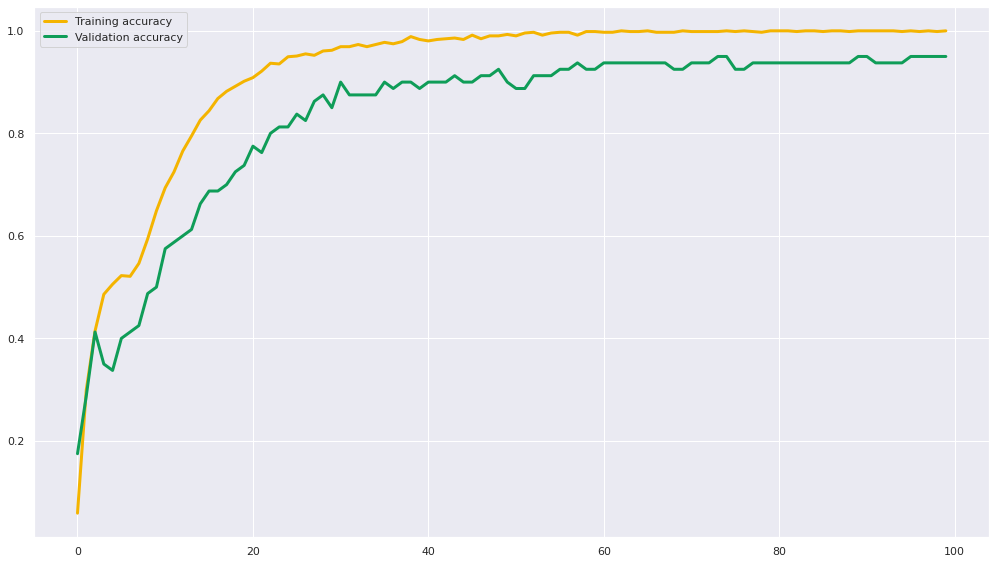

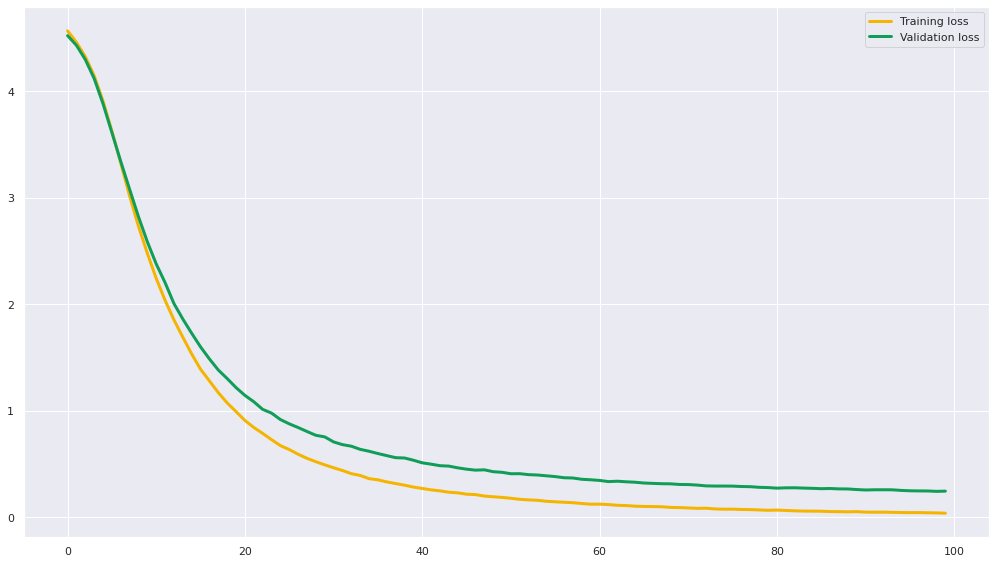

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 16ms/step - loss: 4.5739 - accuracy: 0.0576 - val_loss: 4.5374 - val_accuracy: 0.1875
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4802 - accuracy: 0.2556 - val_loss: 4.4615 - val_accuracy: 0.2500
Epoch 3/100
23/23 [==============================] - 0s 7ms/step - loss: 4.3791 - accuracy: 0.3722 - val_loss: 4.3690 - val_accuracy: 0.2750
Epoch 4/100
23/23 [==============================] - 0s 6ms/step - loss: 4.2500 - accuracy: 0.4354 - val_loss: 4.2419 - val_accuracy: 0.2875
Epoch 5/100
23/23 [==============================] - 0s 7ms/step - loss: 4.0740 - accuracy: 0.4705 - val_loss: 4.0688 - val_accuracy: 0.3375
Epoch 6/100
23/23 [==============================] - 0s 7ms/step - loss: 3.8570 - accuracy: 0.4803 - val_loss: 3.8581 - val_accuracy: 0.3750
Epoch 7/100
23/23 [==============================] - 0s 7ms/step - loss: 3.6062

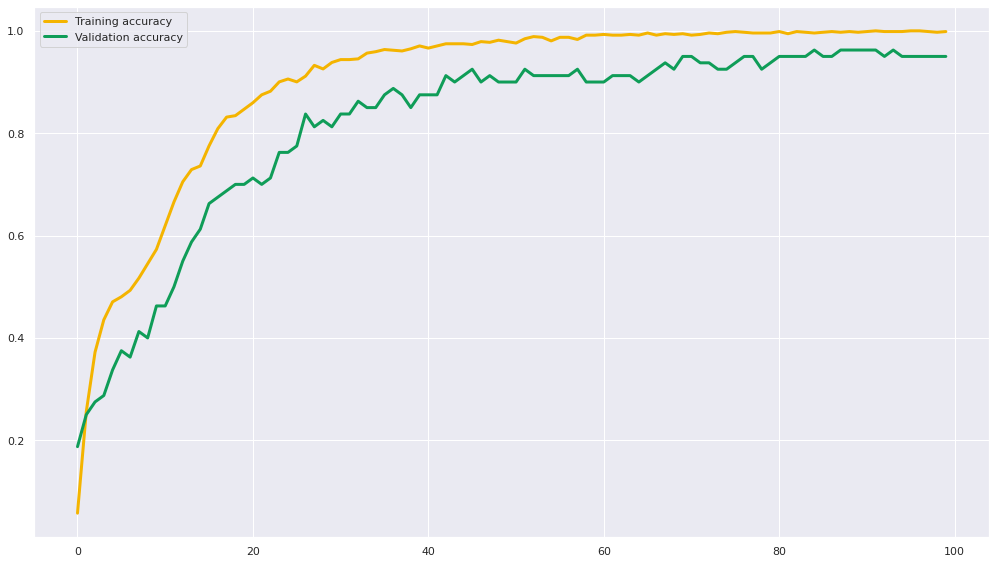

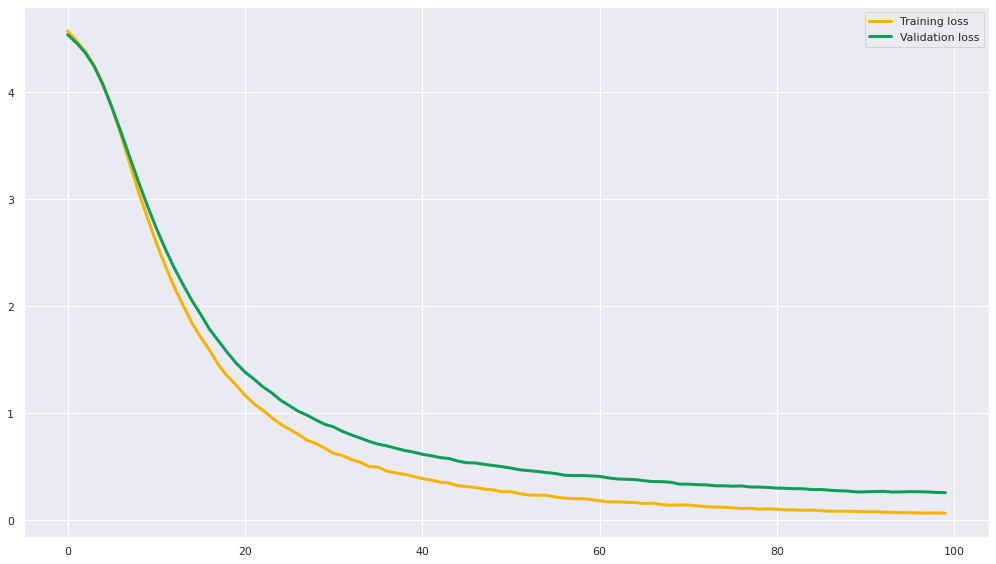

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 29ms/step - loss: 4.5741 - accuracy: 0.0421 - val_loss: 4.5360 - val_accuracy: 0.0875
Epoch 2/100
23/23 [==============================] - 0s 10ms/step - loss: 4.4845 - accuracy: 0.2008 - val_loss: 4.4623 - val_accuracy: 0.2125
Epoch 3/100
23/23 [==============================] - 0s 7ms/step - loss: 4.3790 - accuracy: 0.3385 - val_loss: 4.3605 - val_accuracy: 0.3250
Epoch 4/100
23/23 [==============================] - 0s 10ms/step - loss: 4.2437 - accuracy: 0.4298 - val_loss: 4.2246 - val_accuracy: 0.3625
Epoch 5/100
23/23 [==============================] - 0s 12ms/step - loss: 4.0656 - accuracy: 0.4593 - val_loss: 4.0370 - val_accuracy: 0.3500
Epoch 6/100
23/23 [==============================] - 0s 11ms/step - loss: 3.8457 - accuracy: 0.4733 - val_loss: 3.8260 - val_accuracy: 0.3875
Epoch 7/100
23/23 [==============================] - 0s 10ms/step - loss: 3

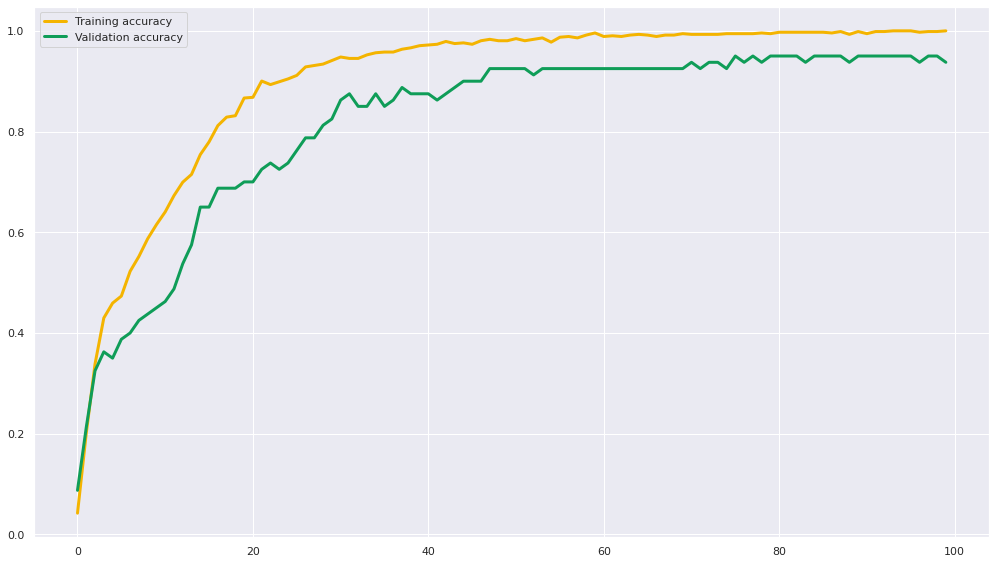

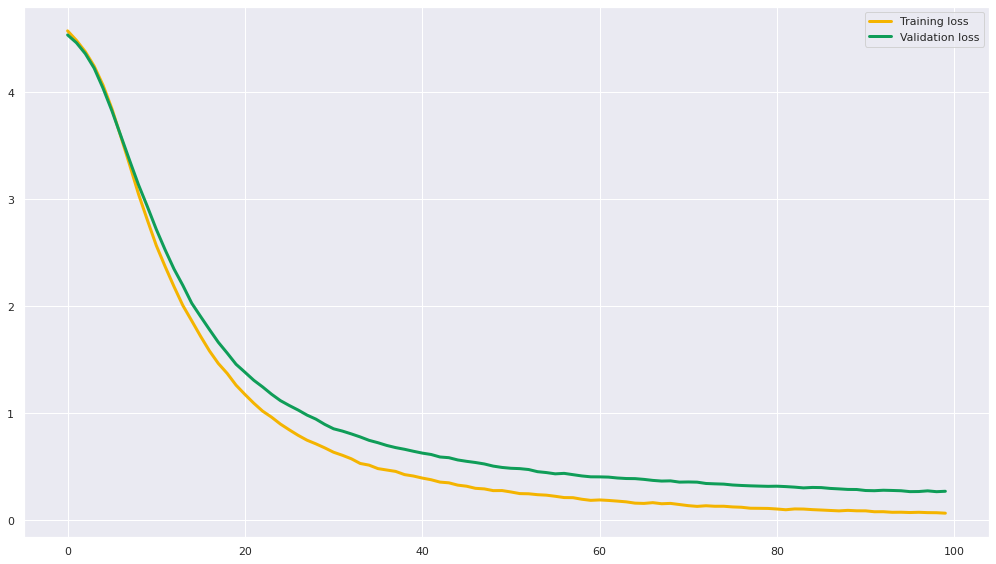

The batch_size is: 32, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
23/23 [==============================] - 1s 14ms/step - loss: 4.5743 - accuracy: 0.0463 - val_loss: 4.5310 - val_accuracy: 0.1500
Epoch 2/100
23/23 [==============================] - 0s 8ms/step - loss: 4.4824 - accuracy: 0.2205 - val_loss: 4.4582 - val_accuracy: 0.2500
Epoch 3/100
23/23 [==============================] - 0s 6ms/step - loss: 4.3754 - accuracy: 0.3778 - val_loss: 4.3545 - val_accuracy: 0.2750
Epoch 4/100
23/23 [==============================] - 0s 7ms/step - loss: 4.2325 - accuracy: 0.4480 - val_loss: 4.2173 - val_accuracy: 0.3625
Epoch 5/100
23/23 [==============================] - 0s 7ms/step - loss: 4.0561 - accuracy: 0.4522 - val_loss: 4.0360 - val_accuracy: 0.3750
Epoch 6/100
23/23 [==============================] - 0s 6ms/step - loss: 3.8362 - accuracy: 0.4761 - val_loss: 3.8263 - val_accuracy: 0.3500
Epoch 7/100
23/23 [==============================] - 0s 7ms/step - loss: 3.5835

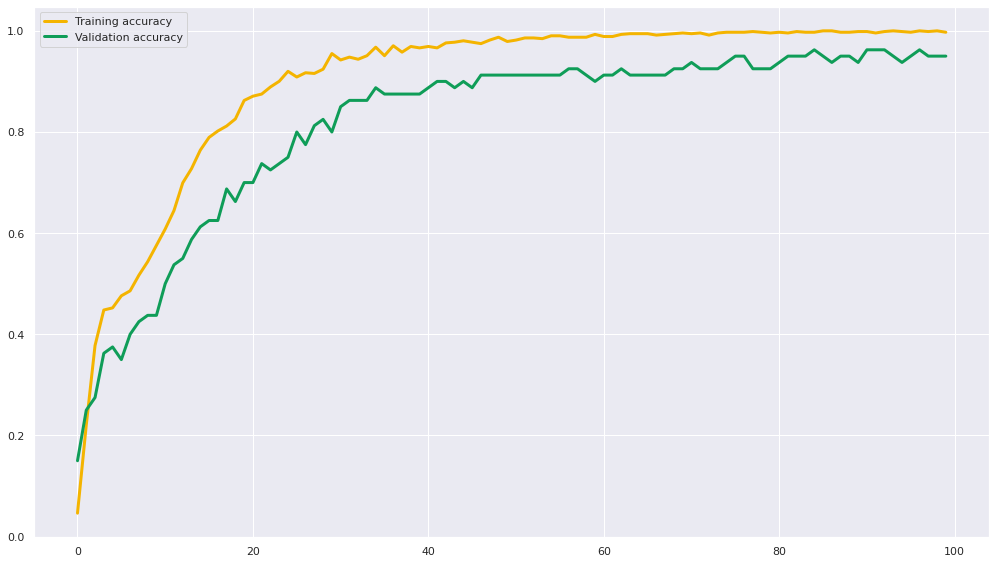

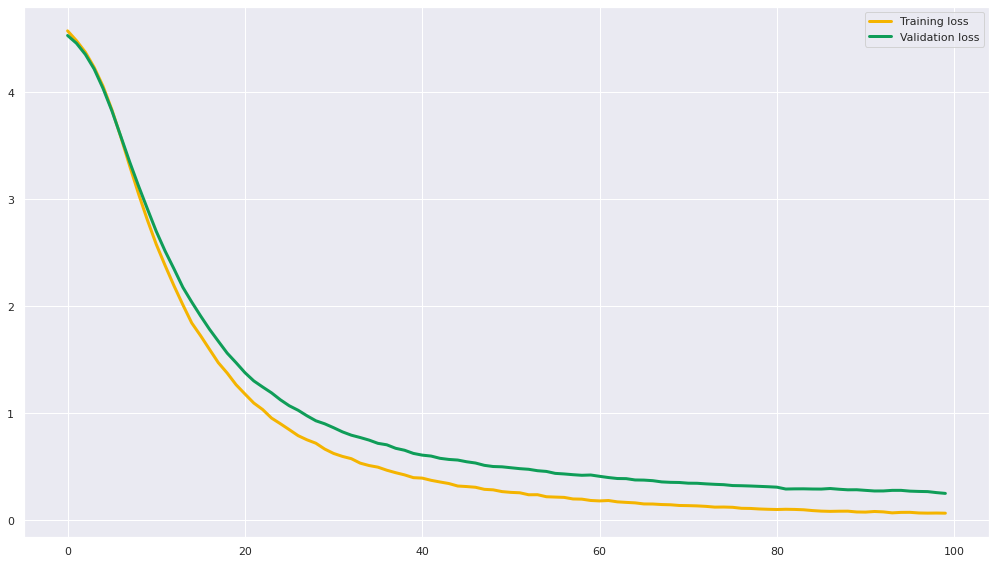

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 22ms/step - loss: 4.5921 - accuracy: 0.0225 - val_loss: 4.5869 - val_accuracy: 0.0625
Epoch 2/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5821 - accuracy: 0.0379 - val_loss: 4.5809 - val_accuracy: 0.0625
Epoch 3/100
12/12 [==============================] - 1s 72ms/step - loss: 4.5738 - accuracy: 0.0772 - val_loss: 4.5742 - val_accuracy: 0.0750
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5644 - accuracy: 0.0829 - val_loss: 4.5667 - val_accuracy: 0.0875
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5533 - accuracy: 0.1306 - val_loss: 4.5587 - val_accuracy: 0.1375
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5418 - accuracy: 0.1489 - val_loss: 4.5488 - val_accuracy: 0.1375
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5288

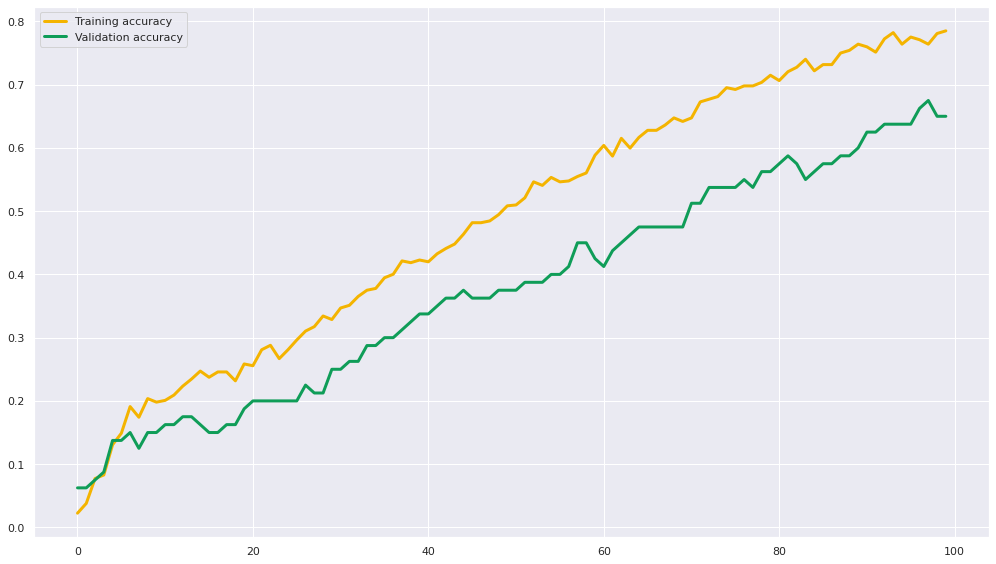

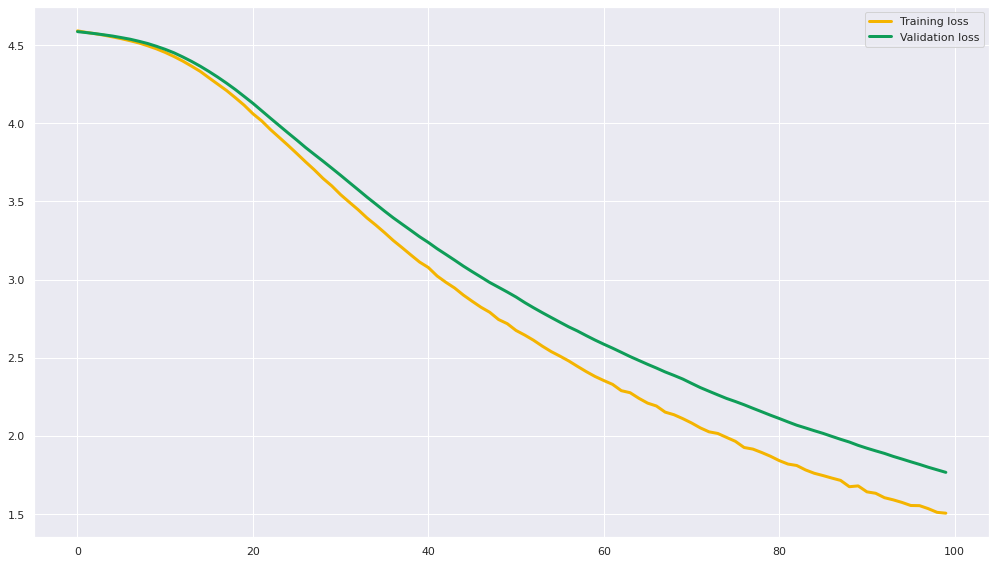

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 46ms/step - loss: 4.5941 - accuracy: 0.0056 - val_loss: 4.5896 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5839 - accuracy: 0.0295 - val_loss: 4.5837 - val_accuracy: 0.0125
Epoch 3/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5749 - accuracy: 0.0492 - val_loss: 4.5772 - val_accuracy: 0.0125
Epoch 4/100
12/12 [==============================] - 0s 11ms/step - loss: 4.5651 - accuracy: 0.0941 - val_loss: 4.5699 - val_accuracy: 0.0750
Epoch 5/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5544 - accuracy: 0.1264 - val_loss: 4.5612 - val_accuracy: 0.0625
Epoch 6/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5436 - accuracy: 0.1292 - val_loss: 4.5512 - val_accuracy: 0.0750
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.52

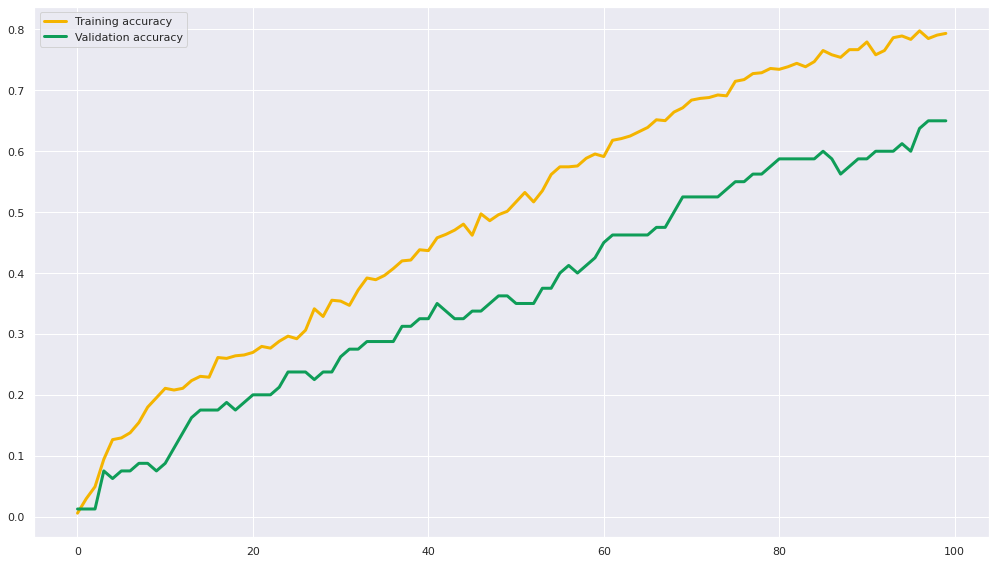

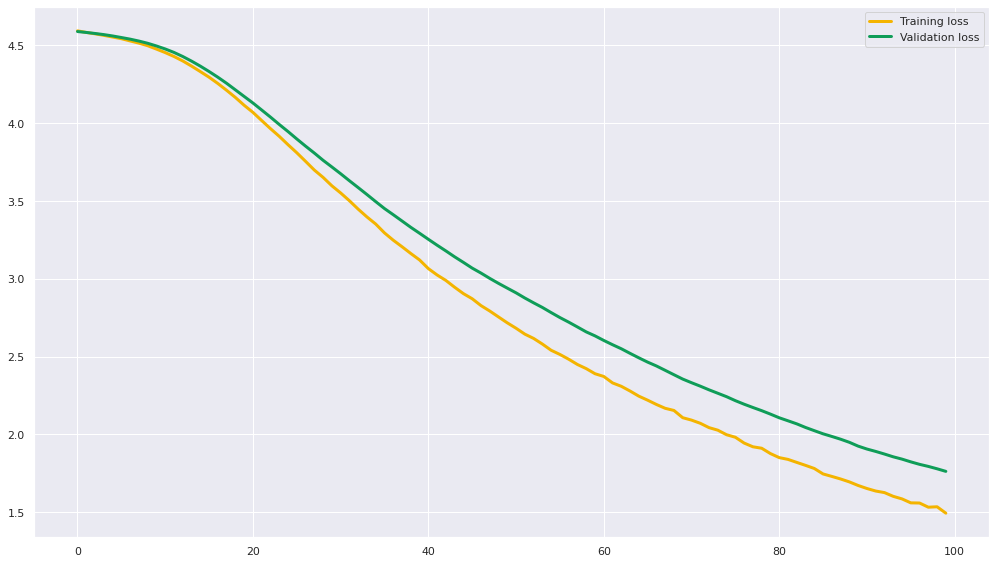

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 31ms/step - loss: 4.5934 - accuracy: 0.0169 - val_loss: 4.5869 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5821 - accuracy: 0.0281 - val_loss: 4.5793 - val_accuracy: 0.0625
Epoch 3/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5727 - accuracy: 0.0576 - val_loss: 4.5725 - val_accuracy: 0.0625
Epoch 4/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5628 - accuracy: 0.0899 - val_loss: 4.5649 - val_accuracy: 0.0875
Epoch 5/100
12/12 [==============================] - 0s 12ms/step - loss: 4.5524 - accuracy: 0.1180 - val_loss: 4.5556 - val_accuracy: 0.0875
Epoch 6/100
12/12 [==============================] - 0s 13ms/step - loss: 4.5393 - accuracy: 0.1657 - val_loss: 4.5442 - val_accuracy: 0.1000
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.524

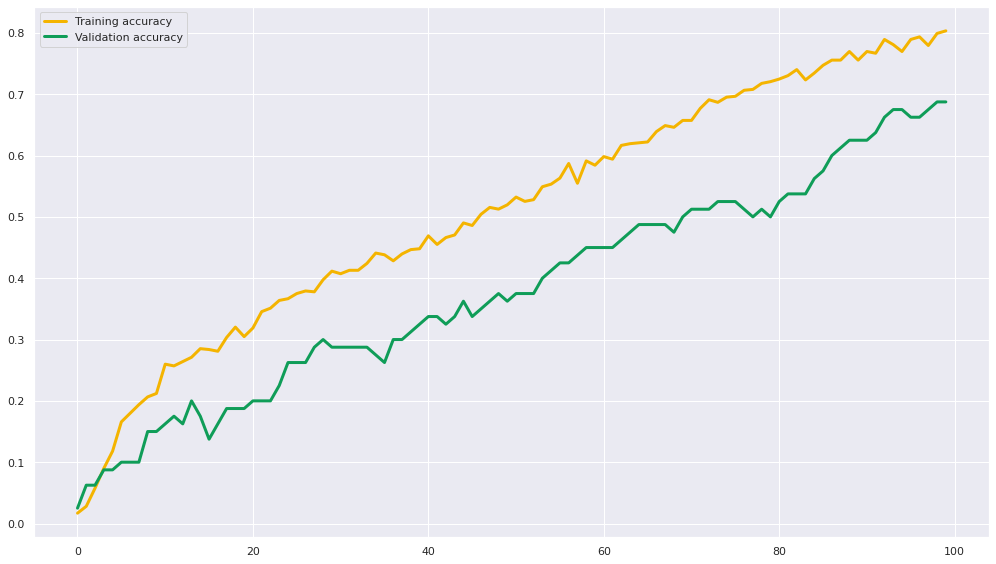

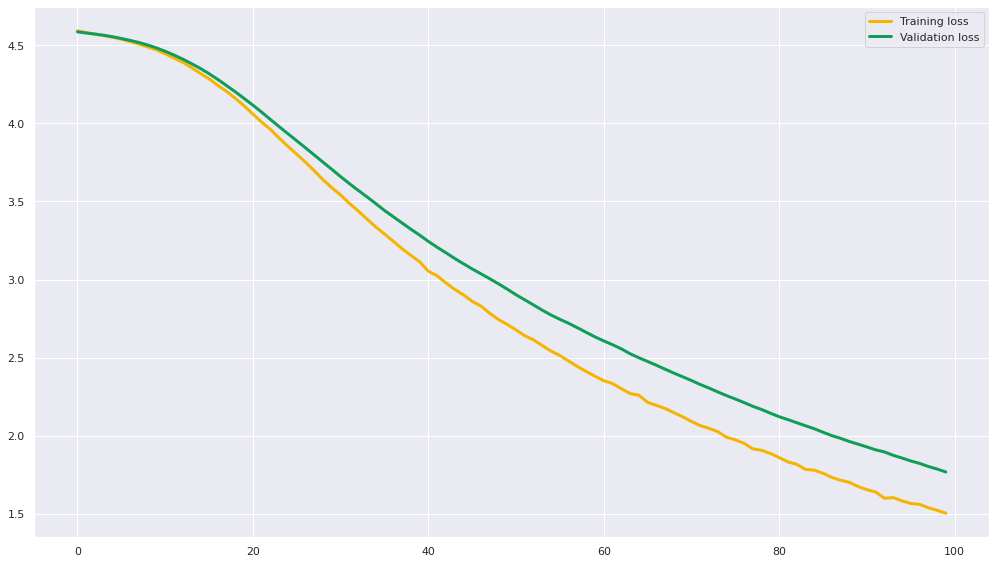

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5926 - accuracy: 0.0239 - val_loss: 4.5861 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5840 - accuracy: 0.0197 - val_loss: 4.5800 - val_accuracy: 0.0375
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5754 - accuracy: 0.0379 - val_loss: 4.5737 - val_accuracy: 0.0625
Epoch 4/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5679 - accuracy: 0.0660 - val_loss: 4.5673 - val_accuracy: 0.0750
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5575 - accuracy: 0.0716 - val_loss: 4.5590 - val_accuracy: 0.0750
Epoch 6/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5464 - accuracy: 0.0969 - val_loss: 4.5506 - val_accuracy: 0.0625
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5355 

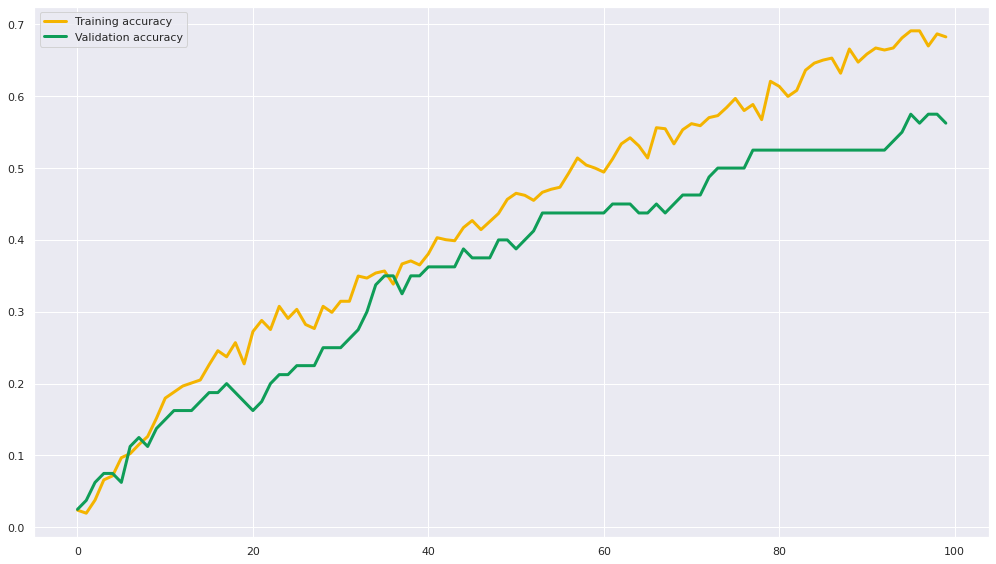

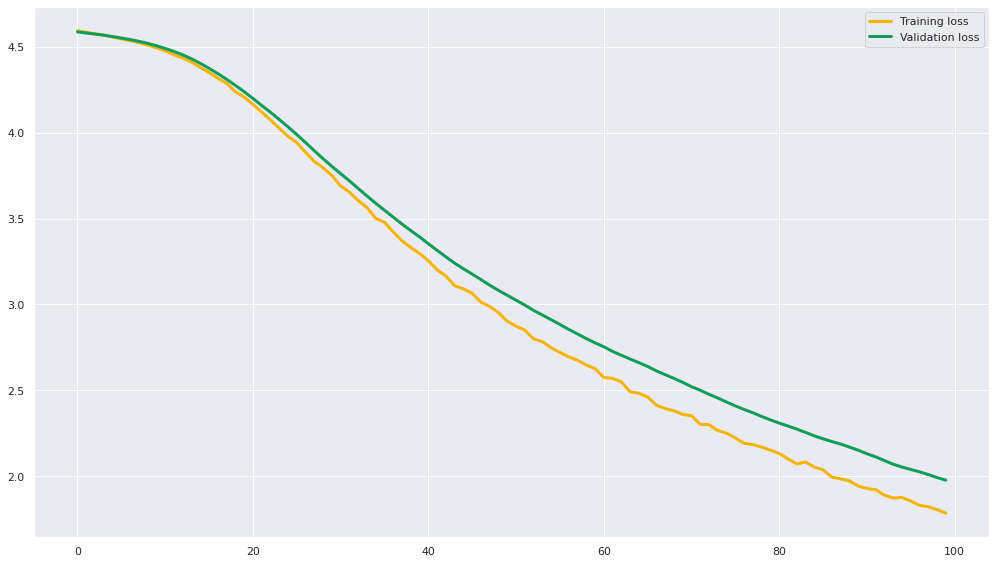

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 24ms/step - loss: 4.5924 - accuracy: 0.0028 - val_loss: 4.5898 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5825 - accuracy: 0.0253 - val_loss: 4.5838 - val_accuracy: 0.0250
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5745 - accuracy: 0.0435 - val_loss: 4.5782 - val_accuracy: 0.0375
Epoch 4/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5633 - accuracy: 0.0730 - val_loss: 4.5724 - val_accuracy: 0.0500
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5547 - accuracy: 0.0997 - val_loss: 4.5656 - val_accuracy: 0.0750
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5450 - accuracy: 0.1039 - val_loss: 4.5574 - val_accuracy: 0.0500
Epoch 7/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5318

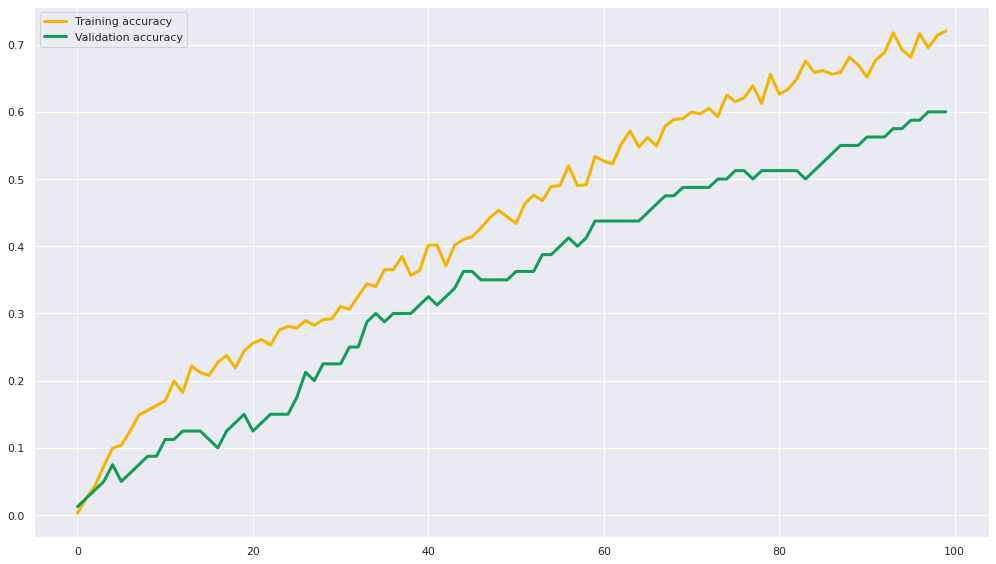

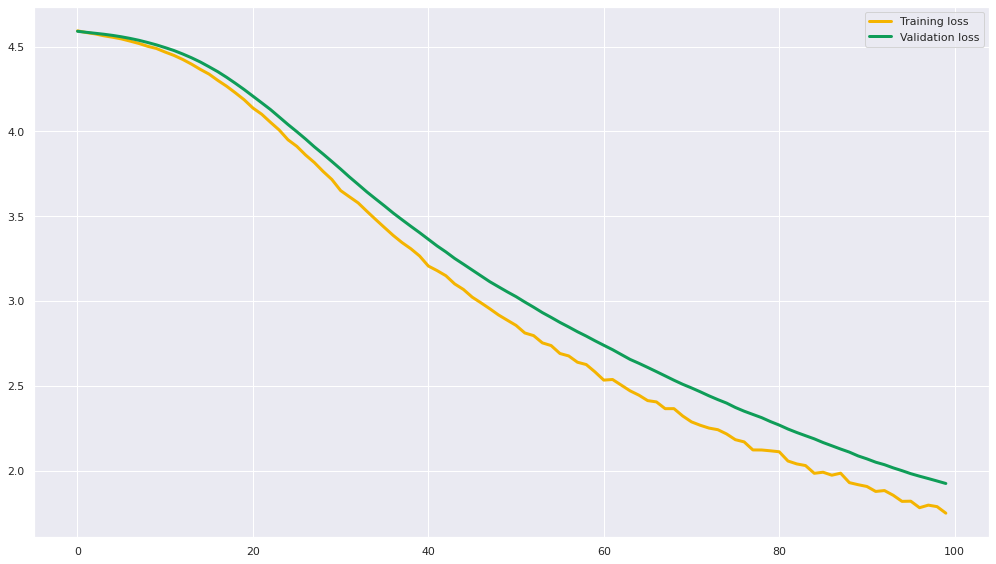

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 26ms/step - loss: 4.5930 - accuracy: 0.0154 - val_loss: 4.5928 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5858 - accuracy: 0.0337 - val_loss: 4.5880 - val_accuracy: 0.0250
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5765 - accuracy: 0.0379 - val_loss: 4.5825 - val_accuracy: 0.0375
Epoch 4/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5673 - accuracy: 0.0646 - val_loss: 4.5765 - val_accuracy: 0.0625
Epoch 5/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5587 - accuracy: 0.0857 - val_loss: 4.5687 - val_accuracy: 0.0625
Epoch 6/100
12/12 [==============================] - 0s 4ms/step - loss: 4.5475 - accuracy: 0.0801 - val_loss: 4.5602 - val_accuracy: 0.0750
Epoch 7/100
12/12 [==============================] - 0s 4ms/step - loss: 4.5357 

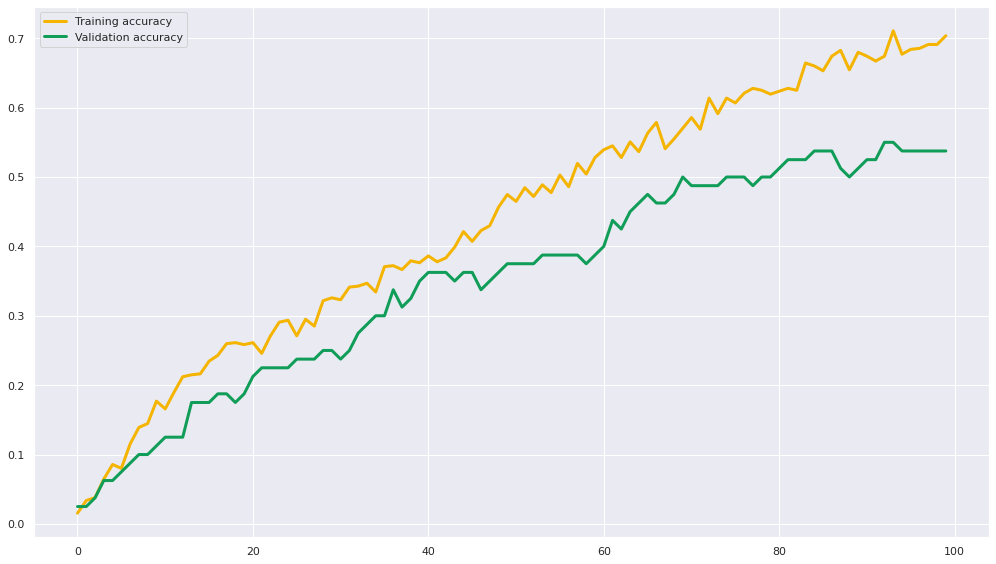

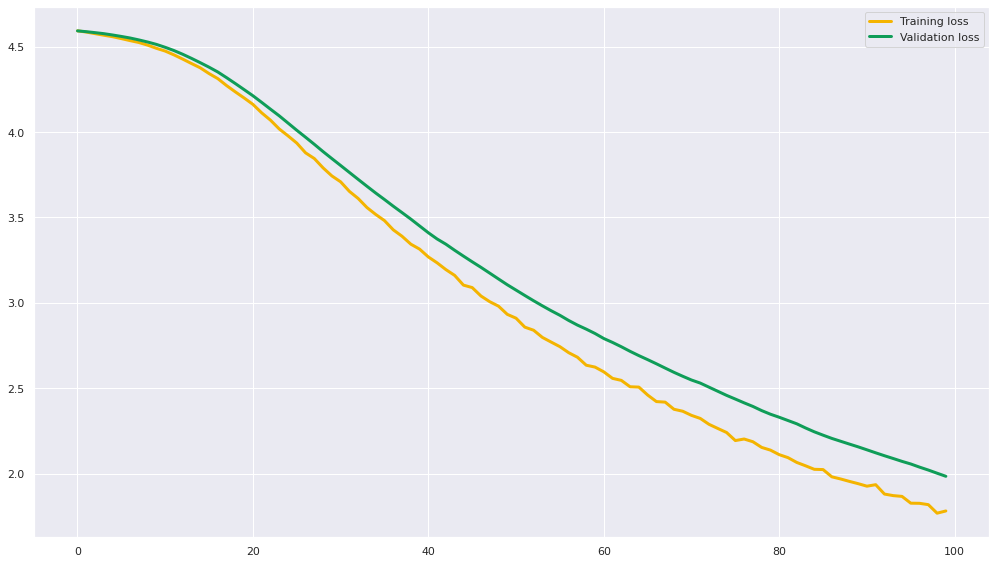

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 25ms/step - loss: 4.5913 - accuracy: 0.0126 - val_loss: 4.5934 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5832 - accuracy: 0.0309 - val_loss: 4.5896 - val_accuracy: 0.0125
Epoch 3/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5780 - accuracy: 0.0435 - val_loss: 4.5841 - val_accuracy: 0.0125
Epoch 4/100
12/12 [==============================] - 0s 4ms/step - loss: 4.5673 - accuracy: 0.0534 - val_loss: 4.5785 - val_accuracy: 0.0125
Epoch 5/100
12/12 [==============================] - 0s 4ms/step - loss: 4.5586 - accuracy: 0.0758 - val_loss: 4.5727 - val_accuracy: 0.0125
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5501 - accuracy: 0.0772 - val_loss: 4.5659 - val_accuracy: 0.0125
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5390 

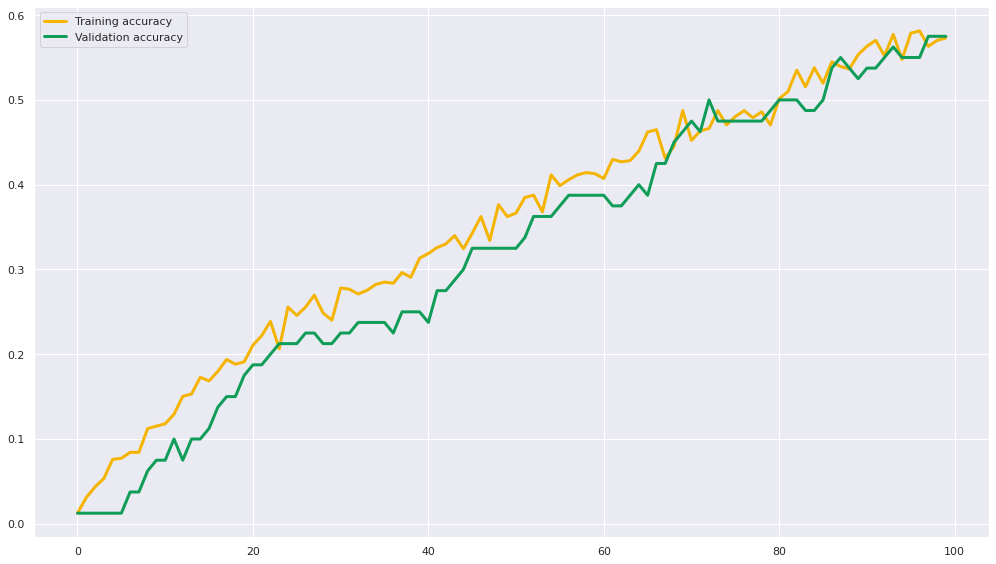

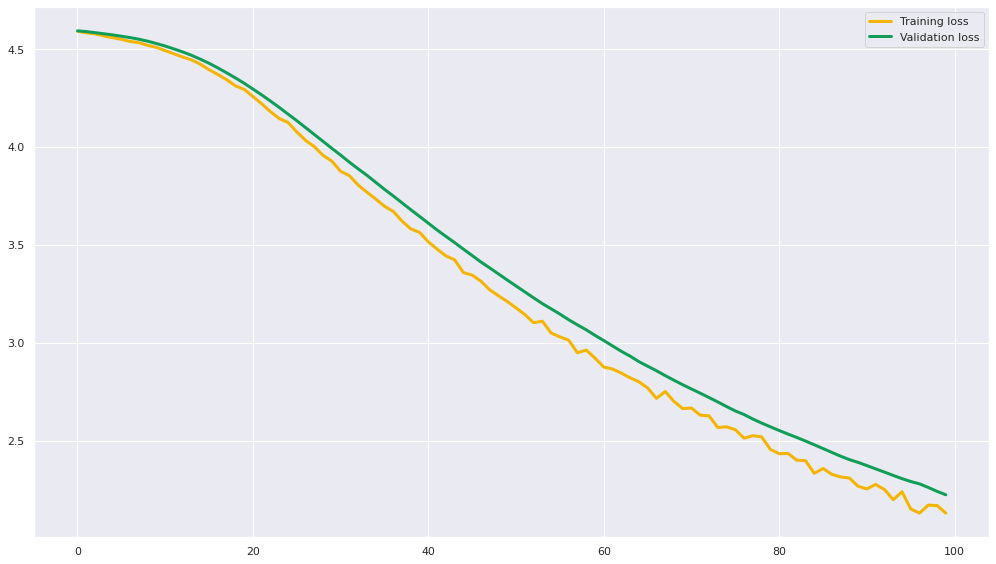

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 27ms/step - loss: 4.5933 - accuracy: 0.0169 - val_loss: 4.5871 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5863 - accuracy: 0.0183 - val_loss: 4.5819 - val_accuracy: 0.0125
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5786 - accuracy: 0.0323 - val_loss: 4.5777 - val_accuracy: 0.0375
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5704 - accuracy: 0.0449 - val_loss: 4.5727 - val_accuracy: 0.0500
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5631 - accuracy: 0.0548 - val_loss: 4.5669 - val_accuracy: 0.0625
Epoch 6/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5544 - accuracy: 0.0941 - val_loss: 4.5610 - val_accuracy: 0.0625
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5458

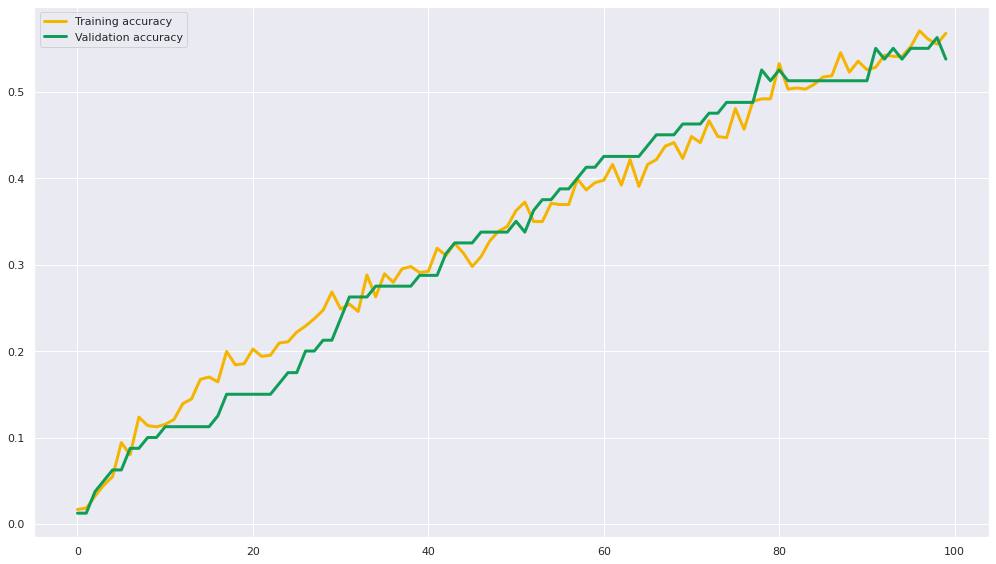

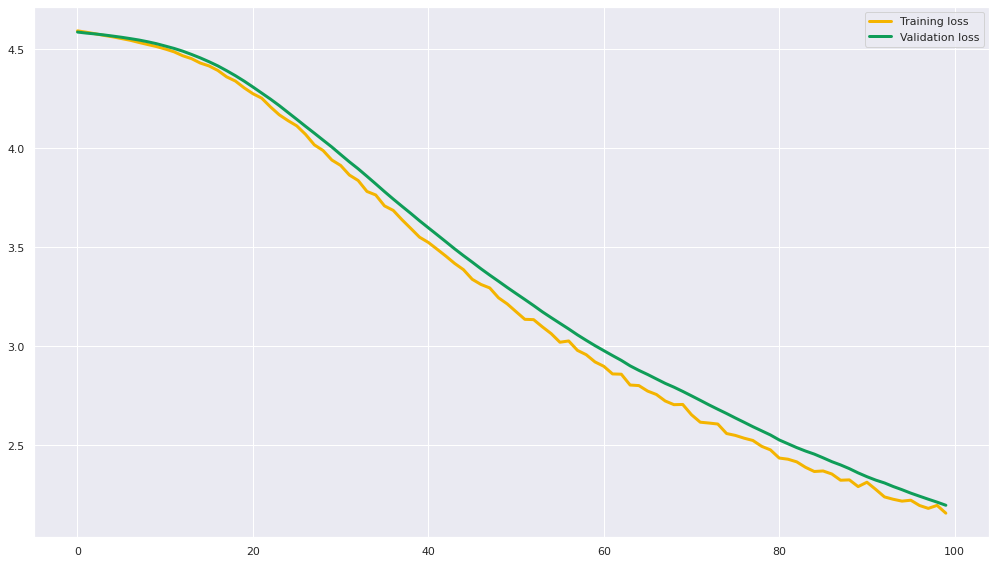

The batch_size is: 64, The hidden_size is: 32, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 24ms/step - loss: 4.5966 - accuracy: 0.0084 - val_loss: 4.5910 - val_accuracy: 0.0375
Epoch 2/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5893 - accuracy: 0.0154 - val_loss: 4.5858 - val_accuracy: 0.0125
Epoch 3/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5821 - accuracy: 0.0253 - val_loss: 4.5810 - val_accuracy: 0.0250
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5756 - accuracy: 0.0295 - val_loss: 4.5756 - val_accuracy: 0.0375
Epoch 5/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5676 - accuracy: 0.0407 - val_loss: 4.5694 - val_accuracy: 0.1000
Epoch 6/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5578 - accuracy: 0.0660 - val_loss: 4.5631 - val_accuracy: 0.1250
Epoch 7/100
12/12 [==============================] - 0s 10ms/step - loss: 4.548

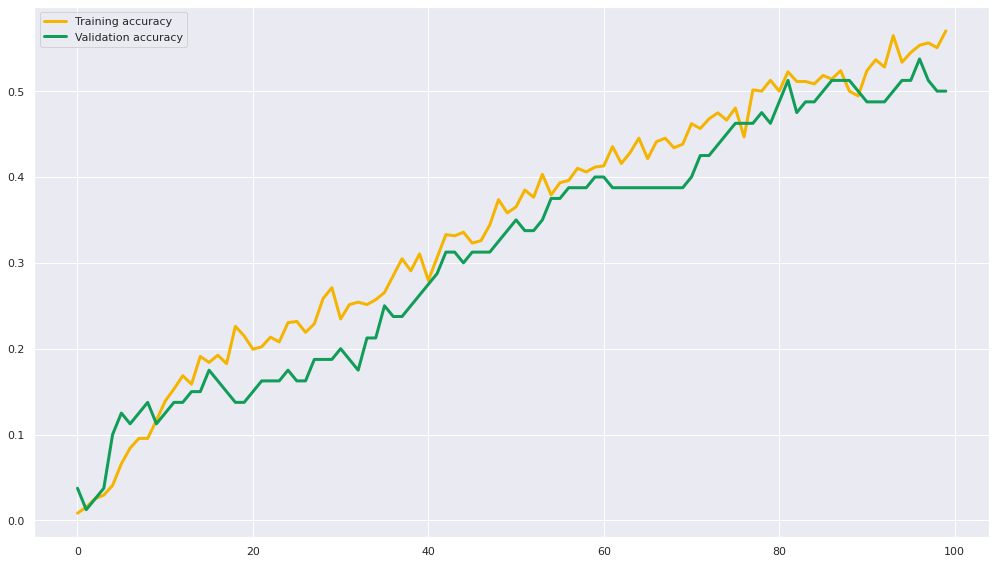

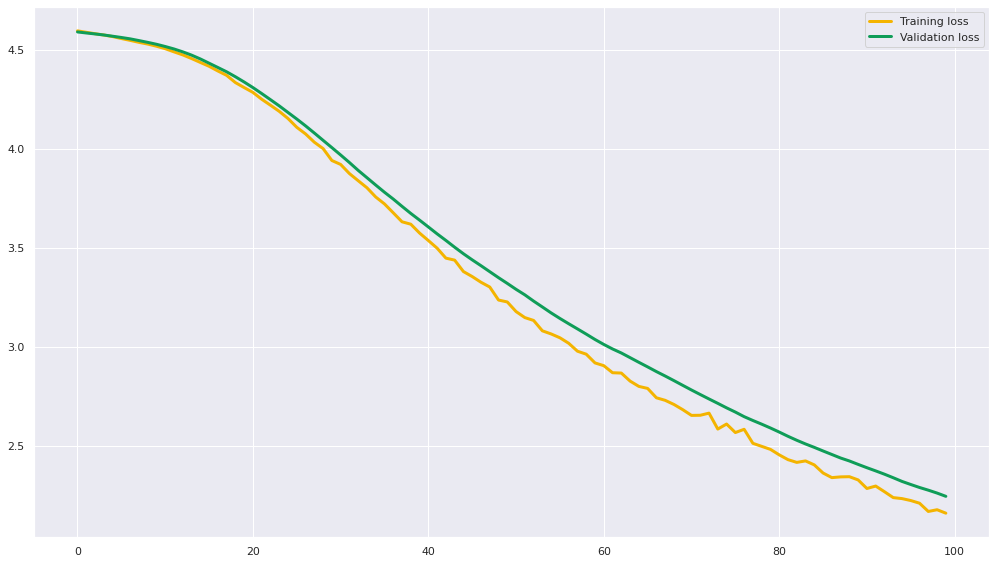

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 24ms/step - loss: 4.5904 - accuracy: 0.0169 - val_loss: 4.5860 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5729 - accuracy: 0.0548 - val_loss: 4.5736 - val_accuracy: 0.0500
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5570 - accuracy: 0.1264 - val_loss: 4.5600 - val_accuracy: 0.1500
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5389 - accuracy: 0.1798 - val_loss: 4.5462 - val_accuracy: 0.1500
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5213 - accuracy: 0.2121 - val_loss: 4.5313 - val_accuracy: 0.1625
Epoch 6/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5003 - accuracy: 0.2275 - val_loss: 4.5131 - val_accuracy: 0.1625
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4763 

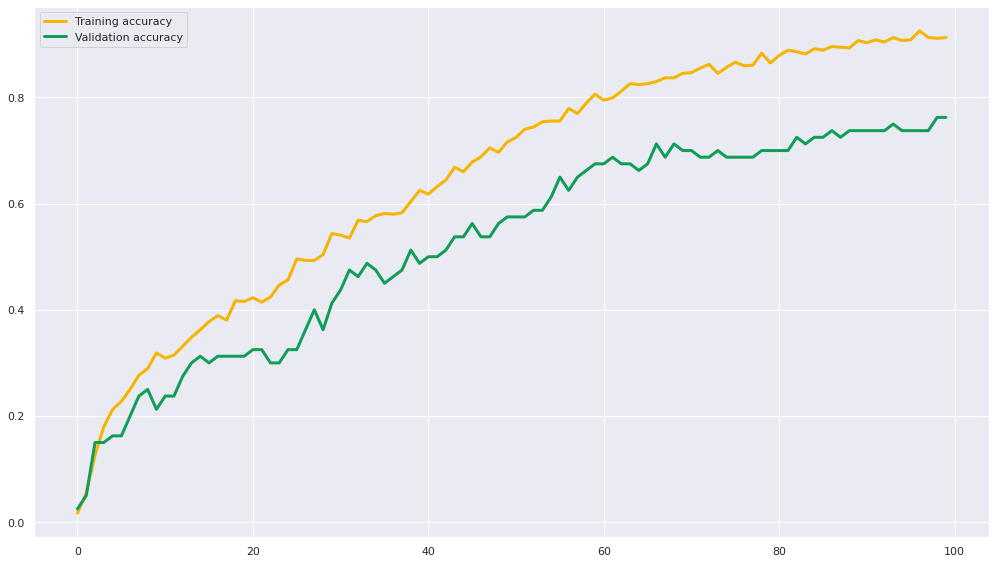

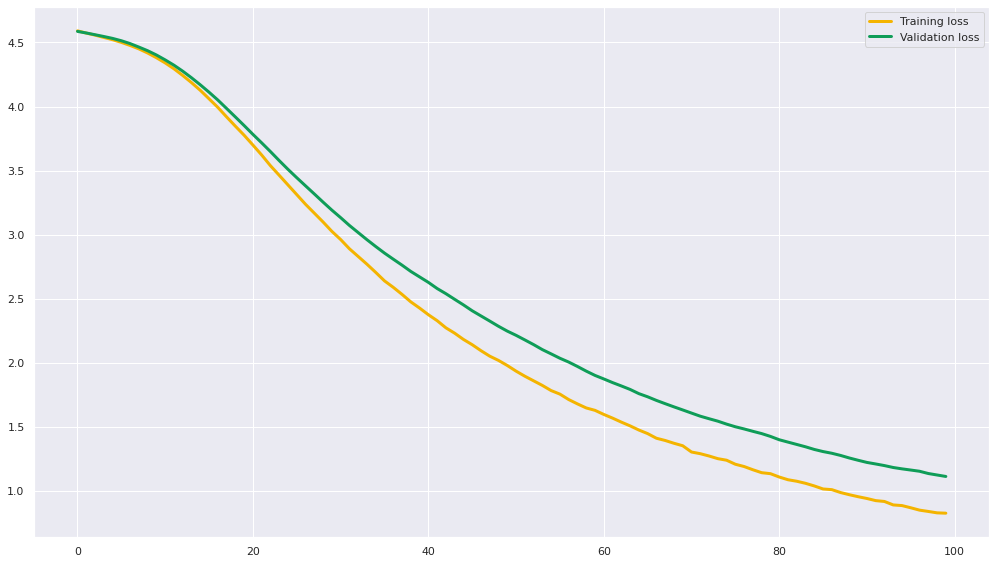

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 28ms/step - loss: 4.5936 - accuracy: 0.0098 - val_loss: 4.5822 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5757 - accuracy: 0.0435 - val_loss: 4.5722 - val_accuracy: 0.0500
Epoch 3/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5603 - accuracy: 0.0829 - val_loss: 4.5607 - val_accuracy: 0.0625
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5442 - accuracy: 0.1390 - val_loss: 4.5482 - val_accuracy: 0.0750
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5255 - accuracy: 0.1910 - val_loss: 4.5330 - val_accuracy: 0.0875
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5049 - accuracy: 0.2430 - val_loss: 4.5145 - val_accuracy: 0.1125
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4807 

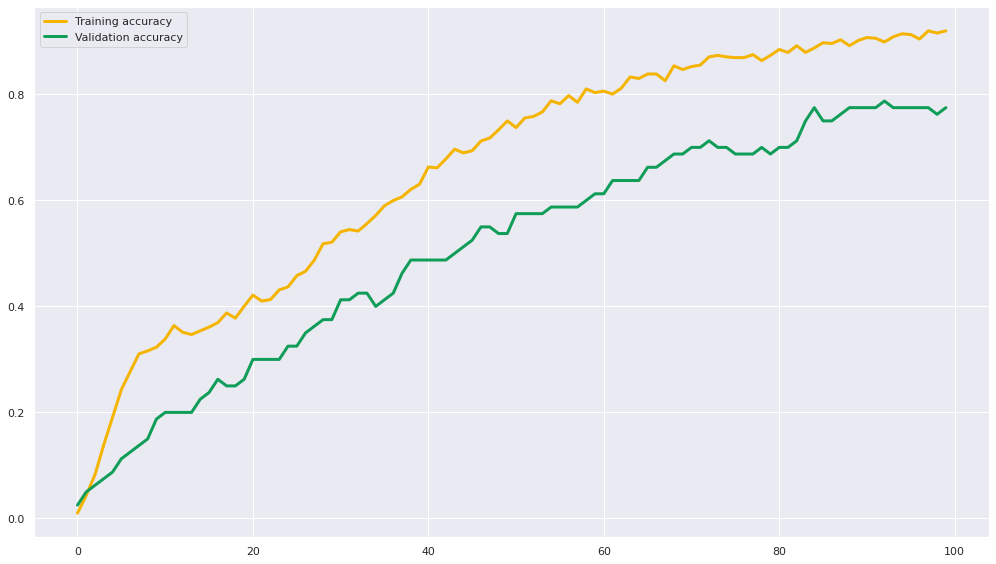

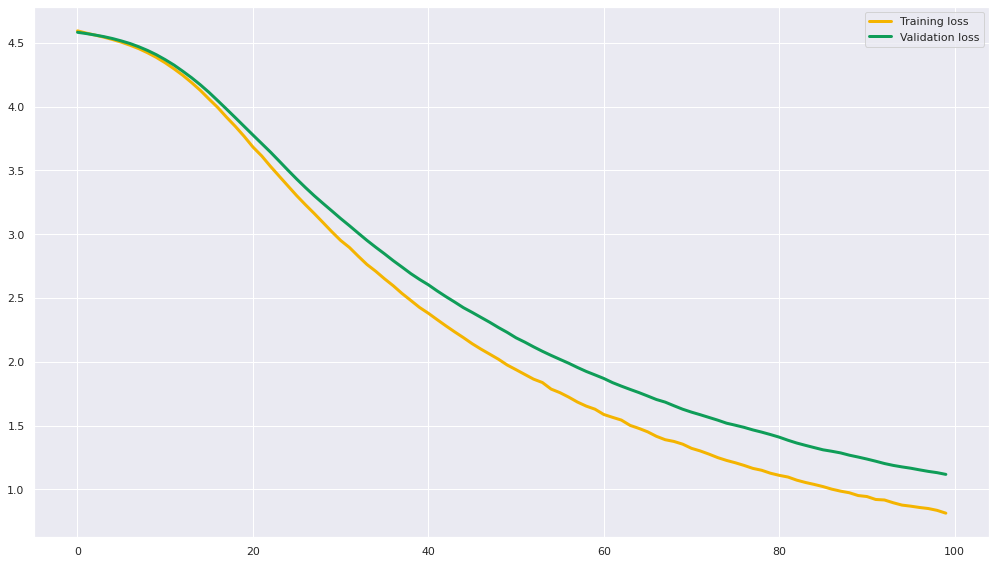

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 25ms/step - loss: 4.5891 - accuracy: 0.0154 - val_loss: 4.5807 - val_accuracy: 0.0625
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5700 - accuracy: 0.0590 - val_loss: 4.5685 - val_accuracy: 0.1000
Epoch 3/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5542 - accuracy: 0.1124 - val_loss: 4.5544 - val_accuracy: 0.1250
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5352 - accuracy: 0.1924 - val_loss: 4.5383 - val_accuracy: 0.1625
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5163 - accuracy: 0.2486 - val_loss: 4.5207 - val_accuracy: 0.1875
Epoch 6/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4929 - accuracy: 0.2893 - val_loss: 4.5006 - val_accuracy: 0.2000
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4669 

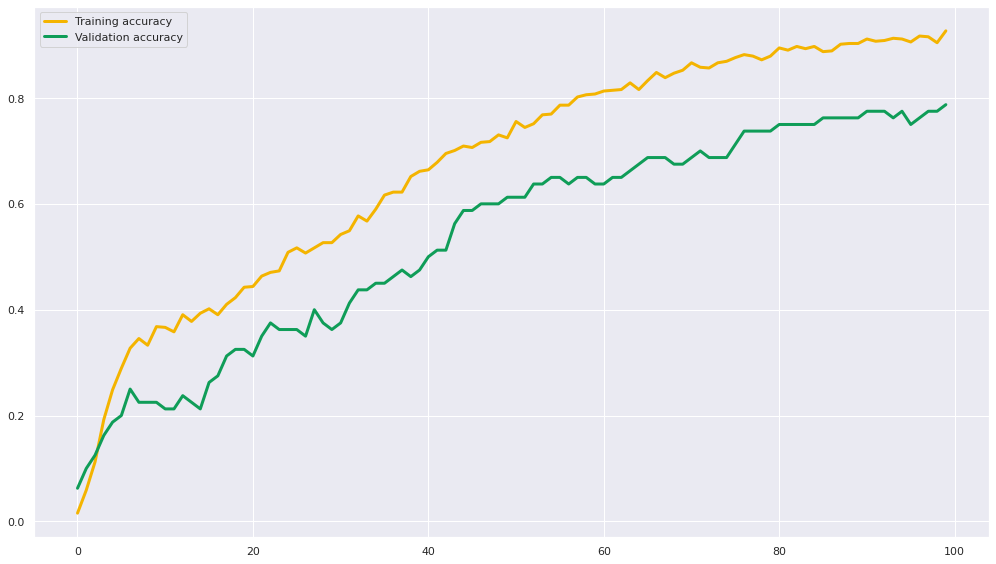

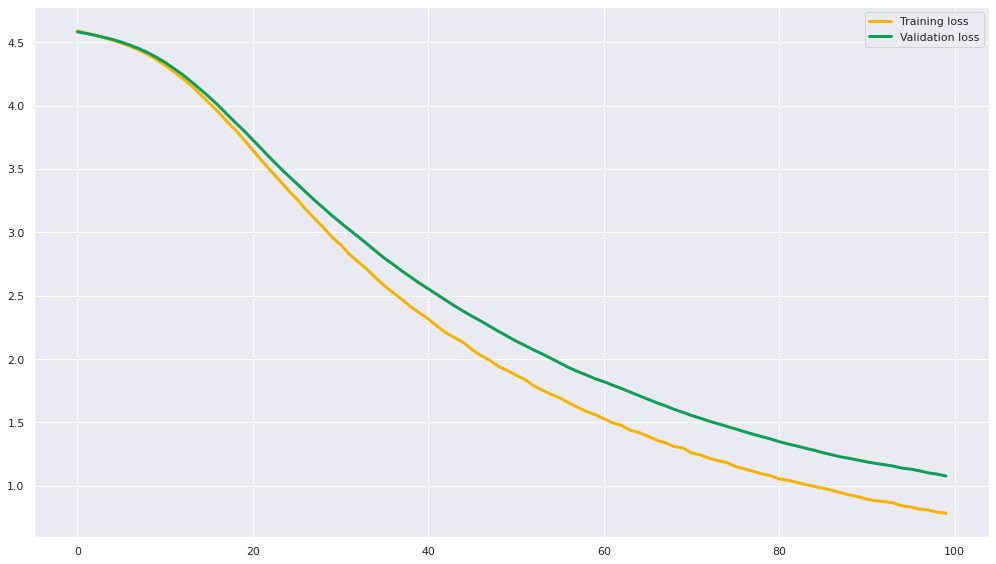

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5930 - accuracy: 0.0056 - val_loss: 4.5836 - val_accuracy: 0.0000e+00
Epoch 2/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5767 - accuracy: 0.0379 - val_loss: 4.5733 - val_accuracy: 0.0625
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5635 - accuracy: 0.0885 - val_loss: 4.5621 - val_accuracy: 0.0875
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5479 - accuracy: 0.1081 - val_loss: 4.5497 - val_accuracy: 0.0875
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5310 - accuracy: 0.1433 - val_loss: 4.5356 - val_accuracy: 0.1000
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5116 - accuracy: 0.1756 - val_loss: 4.5206 - val_accuracy: 0.1500
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4

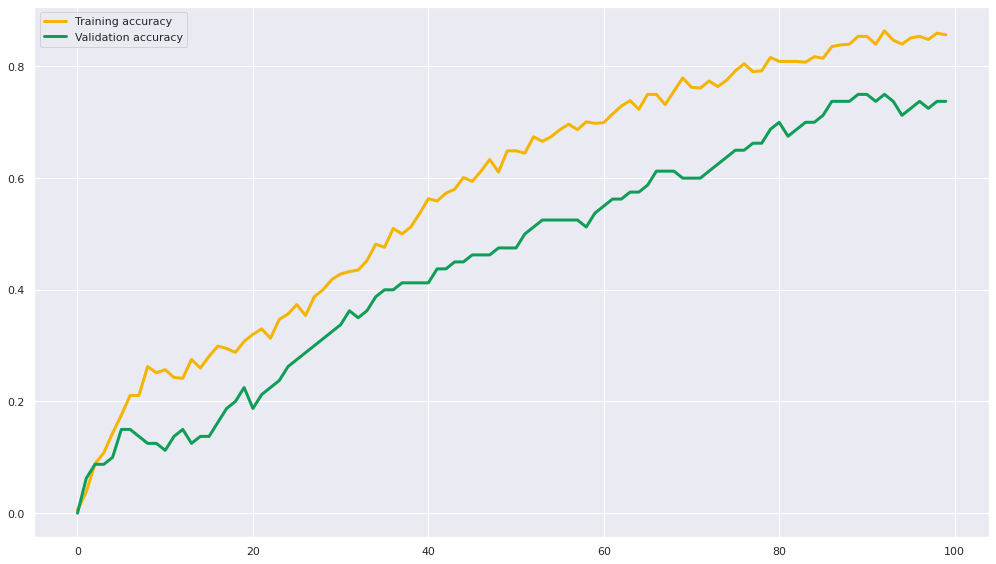

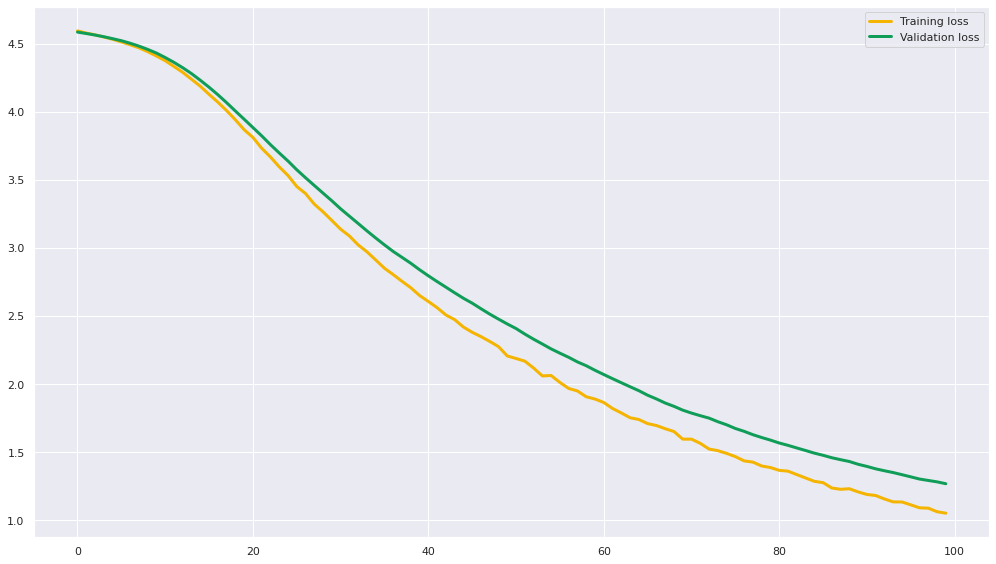

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5936 - accuracy: 0.0154 - val_loss: 4.5888 - val_accuracy: 0.0000e+00
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5772 - accuracy: 0.0421 - val_loss: 4.5774 - val_accuracy: 0.0125
Epoch 3/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5617 - accuracy: 0.0702 - val_loss: 4.5662 - val_accuracy: 0.0500
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5477 - accuracy: 0.0730 - val_loss: 4.5552 - val_accuracy: 0.0625
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5304 - accuracy: 0.1067 - val_loss: 4.5420 - val_accuracy: 0.0625
Epoch 6/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5117 - accuracy: 0.1180 - val_loss: 4.5272 - val_accuracy: 0.0625
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4

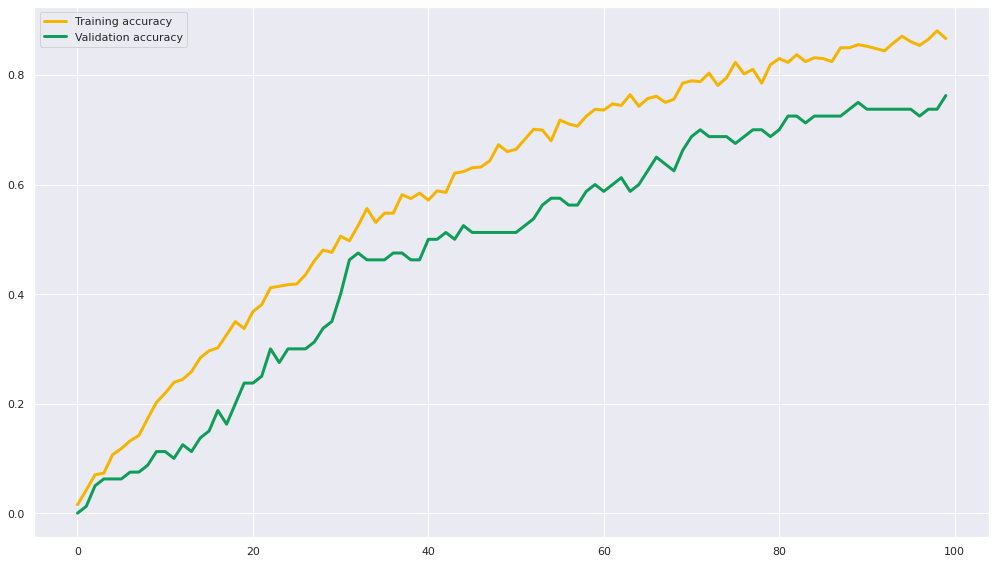

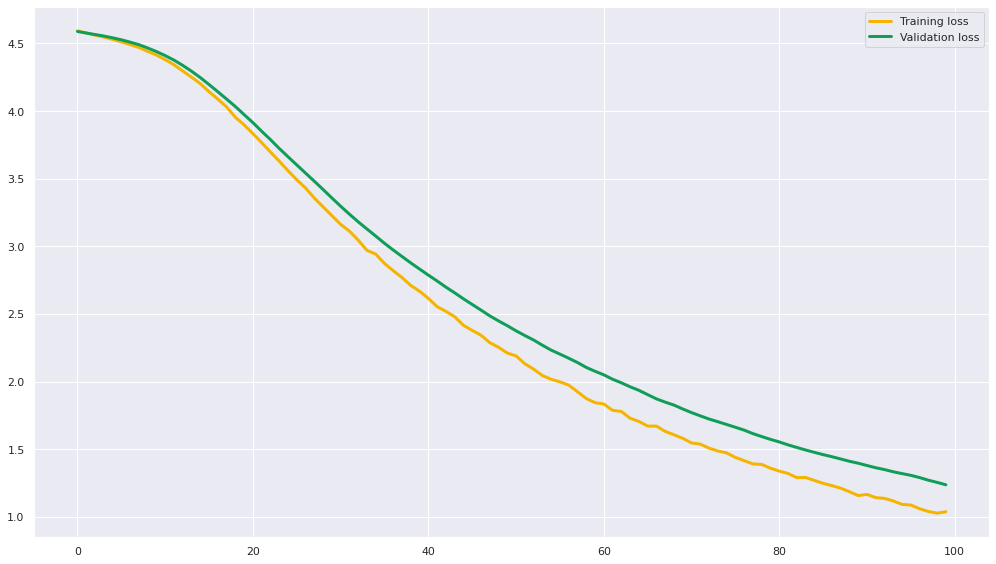

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 26ms/step - loss: 4.5902 - accuracy: 0.0183 - val_loss: 4.5832 - val_accuracy: 0.0625
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5729 - accuracy: 0.0702 - val_loss: 4.5723 - val_accuracy: 0.0875
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5581 - accuracy: 0.0955 - val_loss: 4.5621 - val_accuracy: 0.1000
Epoch 4/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5424 - accuracy: 0.1236 - val_loss: 4.5494 - val_accuracy: 0.1125
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5247 - accuracy: 0.1784 - val_loss: 4.5344 - val_accuracy: 0.1625
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5042 - accuracy: 0.1882 - val_loss: 4.5185 - val_accuracy: 0.1500
Epoch 7/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4809 

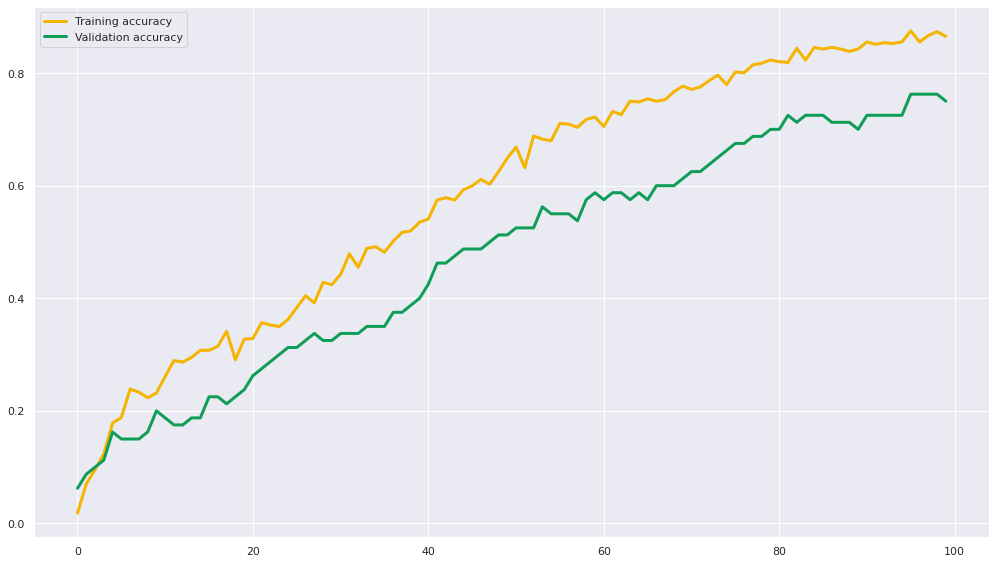

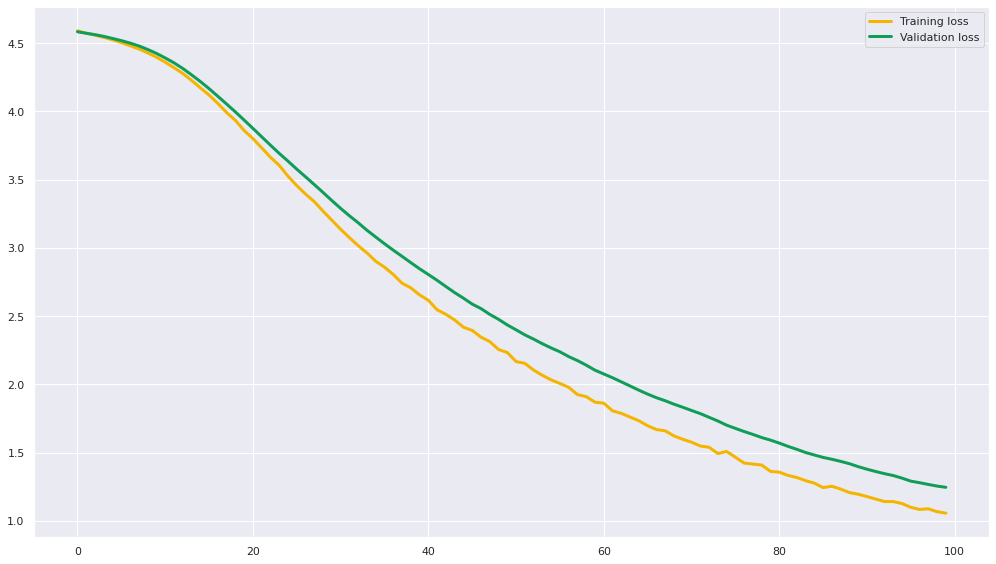

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5906 - accuracy: 0.0154 - val_loss: 4.5888 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5754 - accuracy: 0.0463 - val_loss: 4.5802 - val_accuracy: 0.0375
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5637 - accuracy: 0.0632 - val_loss: 4.5711 - val_accuracy: 0.0250
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5527 - accuracy: 0.0716 - val_loss: 4.5614 - val_accuracy: 0.0625
Epoch 5/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5371 - accuracy: 0.0941 - val_loss: 4.5507 - val_accuracy: 0.1000
Epoch 6/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5201 - accuracy: 0.1250 - val_loss: 4.5376 - val_accuracy: 0.1125
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5012 

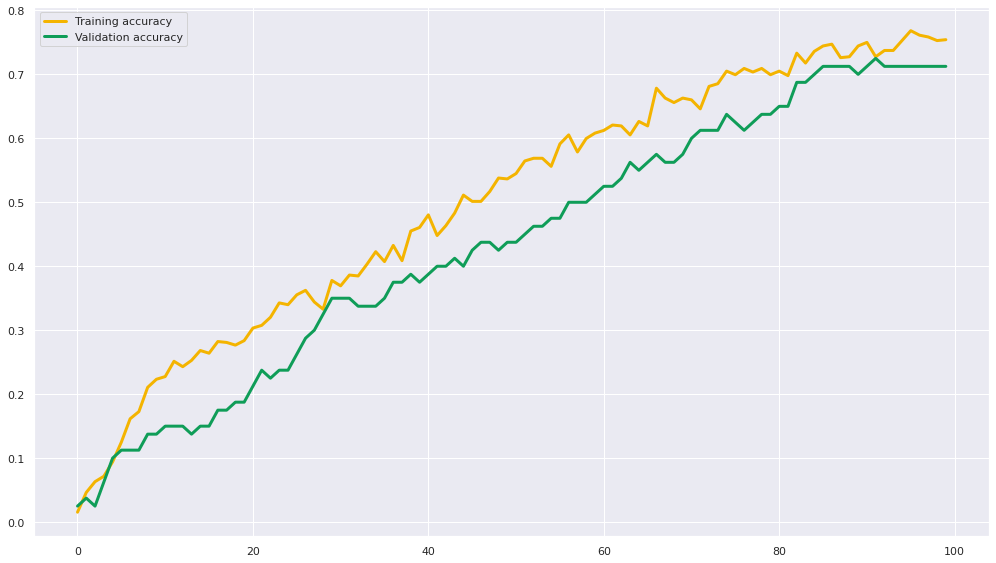

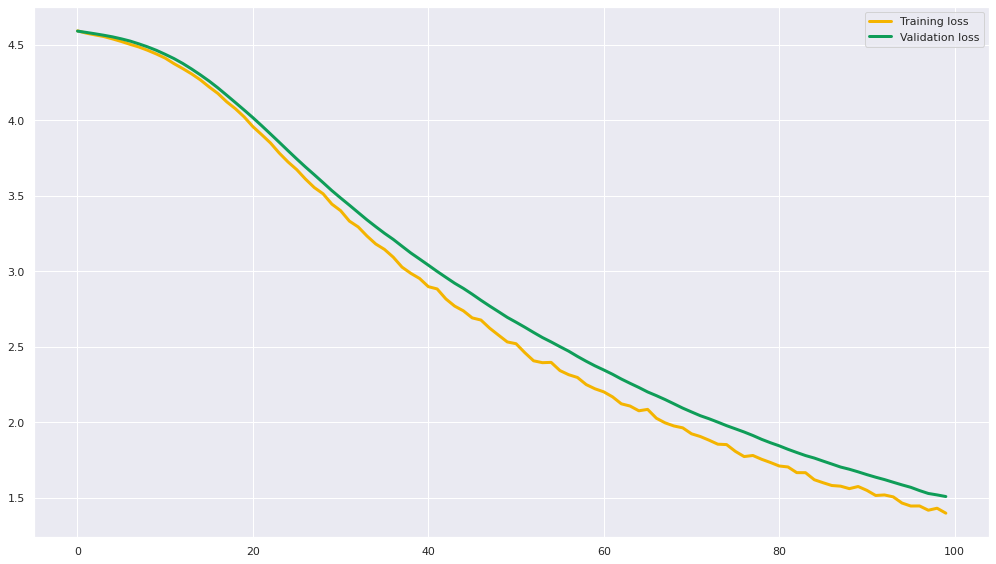

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 35ms/step - loss: 4.5919 - accuracy: 0.0169 - val_loss: 4.5824 - val_accuracy: 0.0000e+00
Epoch 2/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5777 - accuracy: 0.0154 - val_loss: 4.5719 - val_accuracy: 0.0625
Epoch 3/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5635 - accuracy: 0.0492 - val_loss: 4.5608 - val_accuracy: 0.1000
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5507 - accuracy: 0.0660 - val_loss: 4.5499 - val_accuracy: 0.1500
Epoch 5/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5340 - accuracy: 0.1067 - val_loss: 4.5391 - val_accuracy: 0.1875
Epoch 6/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5189 - accuracy: 0.1419 - val_loss: 4.5253 - val_accuracy: 0.2250
Epoch 7/100
12/12 [==============================] - 0s 5ms/step - loss: 4.4

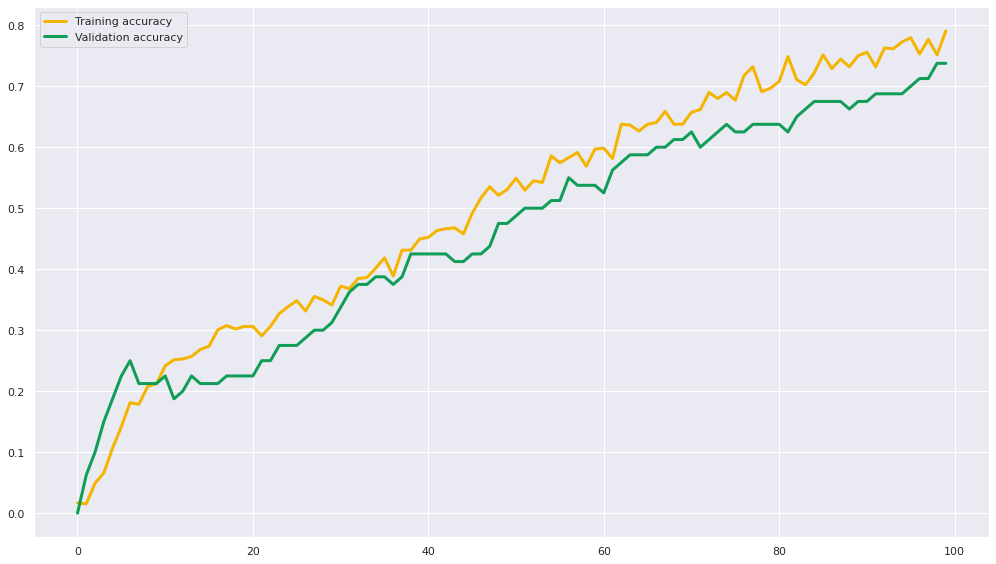

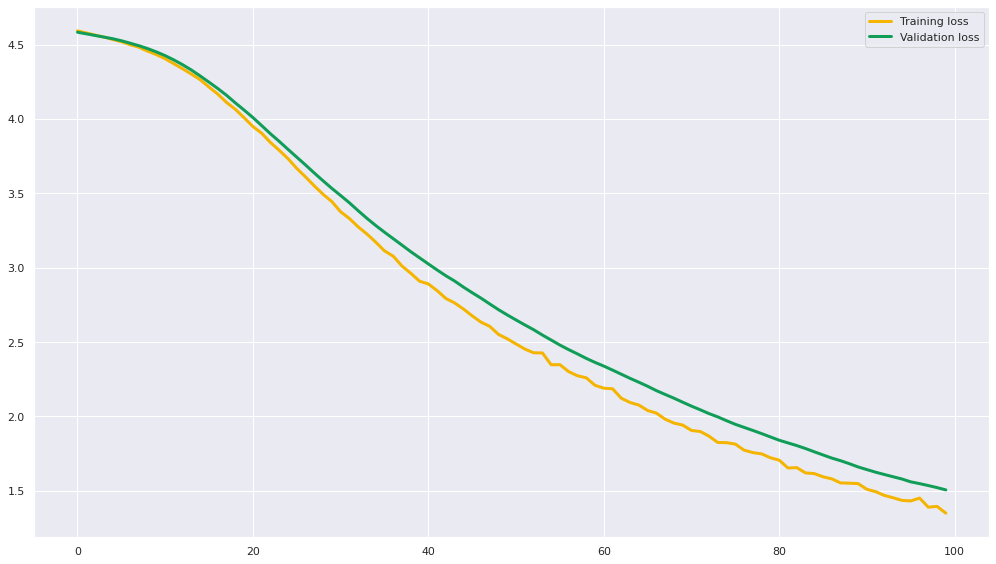

The batch_size is: 64, The hidden_size is: 64, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 22ms/step - loss: 4.5934 - accuracy: 0.0169 - val_loss: 4.5893 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5798 - accuracy: 0.0197 - val_loss: 4.5806 - val_accuracy: 0.0375
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5678 - accuracy: 0.0534 - val_loss: 4.5711 - val_accuracy: 0.0625
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5528 - accuracy: 0.0815 - val_loss: 4.5608 - val_accuracy: 0.1000
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5398 - accuracy: 0.0969 - val_loss: 4.5501 - val_accuracy: 0.1125
Epoch 6/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5246 - accuracy: 0.1124 - val_loss: 4.5391 - val_accuracy: 0.1250
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5070 

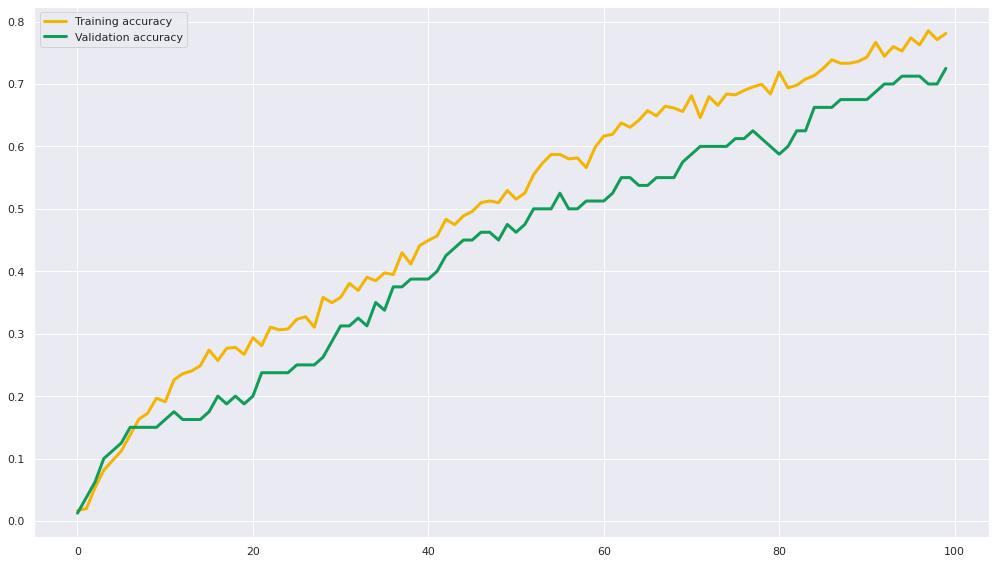

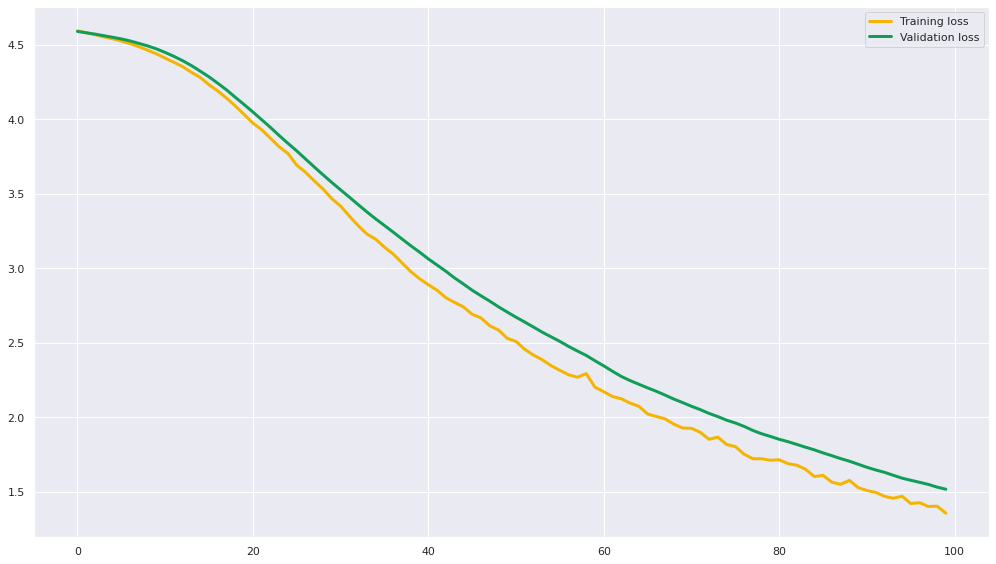

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 24ms/step - loss: 4.5860 - accuracy: 0.0225 - val_loss: 4.5686 - val_accuracy: 0.0750
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5552 - accuracy: 0.1152 - val_loss: 4.5472 - val_accuracy: 0.1000
Epoch 3/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5270 - accuracy: 0.2121 - val_loss: 4.5244 - val_accuracy: 0.1375
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4947 - accuracy: 0.2612 - val_loss: 4.4993 - val_accuracy: 0.1875
Epoch 5/100
12/12 [==============================] - 1s 119ms/step - loss: 4.4595 - accuracy: 0.3202 - val_loss: 4.4668 - val_accuracy: 0.2125
Epoch 6/100
12/12 [==============================] - 0s 11ms/step - loss: 4.4175 - accuracy: 0.3385 - val_loss: 4.4303 - val_accuracy: 0.2000
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3

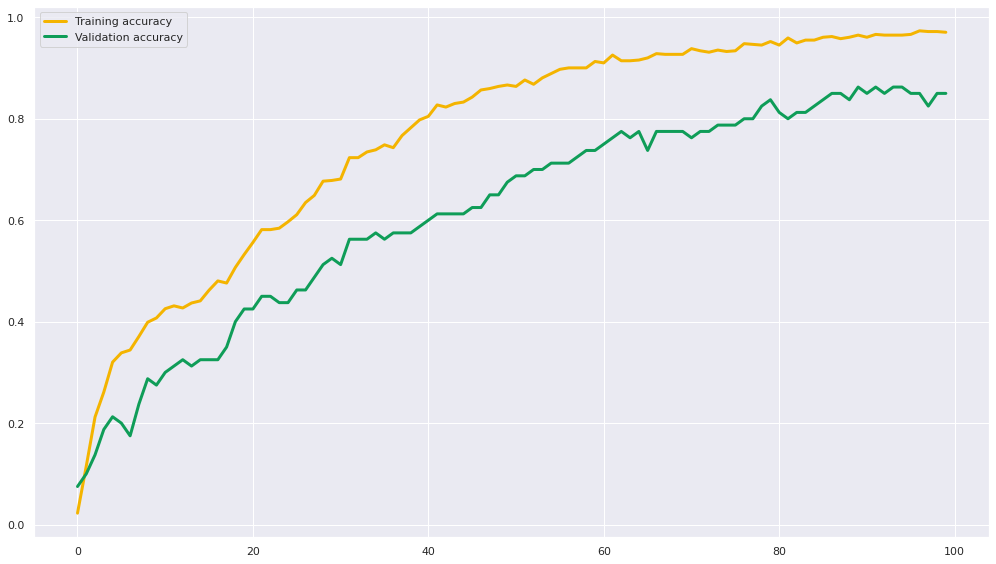

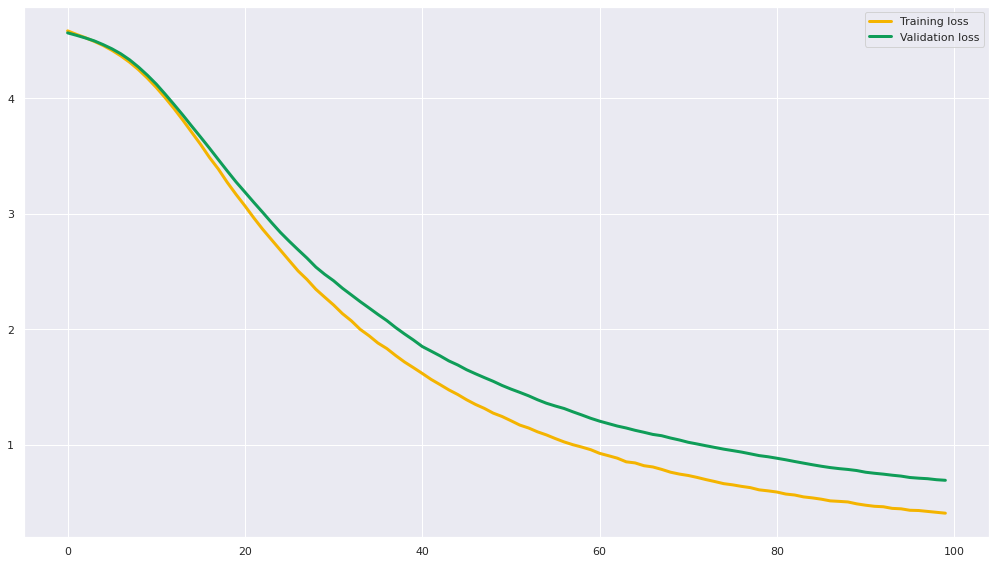

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 26ms/step - loss: 4.5903 - accuracy: 0.0098 - val_loss: 4.5753 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5603 - accuracy: 0.0730 - val_loss: 4.5546 - val_accuracy: 0.0875
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5324 - accuracy: 0.1320 - val_loss: 4.5337 - val_accuracy: 0.1500
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5030 - accuracy: 0.2191 - val_loss: 4.5090 - val_accuracy: 0.2375
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4698 - accuracy: 0.2879 - val_loss: 4.4794 - val_accuracy: 0.2875
Epoch 6/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4305 - accuracy: 0.3652 - val_loss: 4.4419 - val_accuracy: 0.3500
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.3846

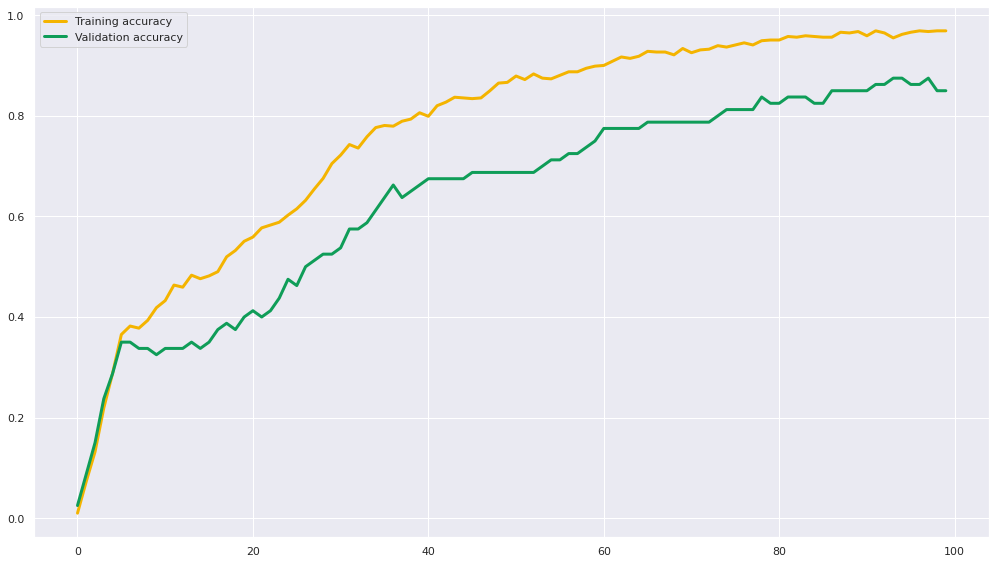

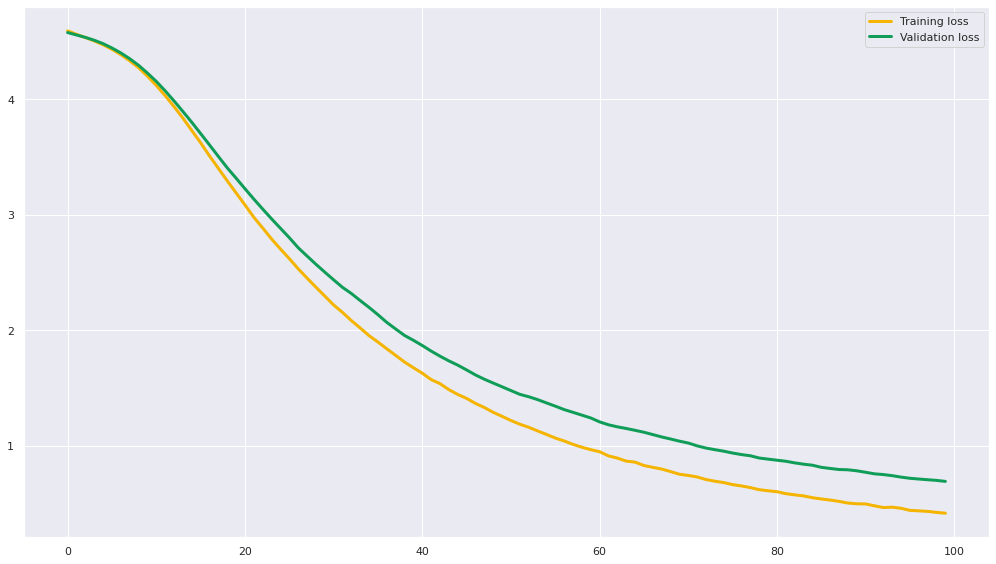

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 30ms/step - loss: 4.5836 - accuracy: 0.0337 - val_loss: 4.5736 - val_accuracy: 0.0500
Epoch 2/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5525 - accuracy: 0.0955 - val_loss: 4.5498 - val_accuracy: 0.0875
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5238 - accuracy: 0.1910 - val_loss: 4.5257 - val_accuracy: 0.1250
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4913 - accuracy: 0.2584 - val_loss: 4.4981 - val_accuracy: 0.1625
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4535 - accuracy: 0.3230 - val_loss: 4.4643 - val_accuracy: 0.2125
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4108 - accuracy: 0.3399 - val_loss: 4.4254 - val_accuracy: 0.1875
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.3611

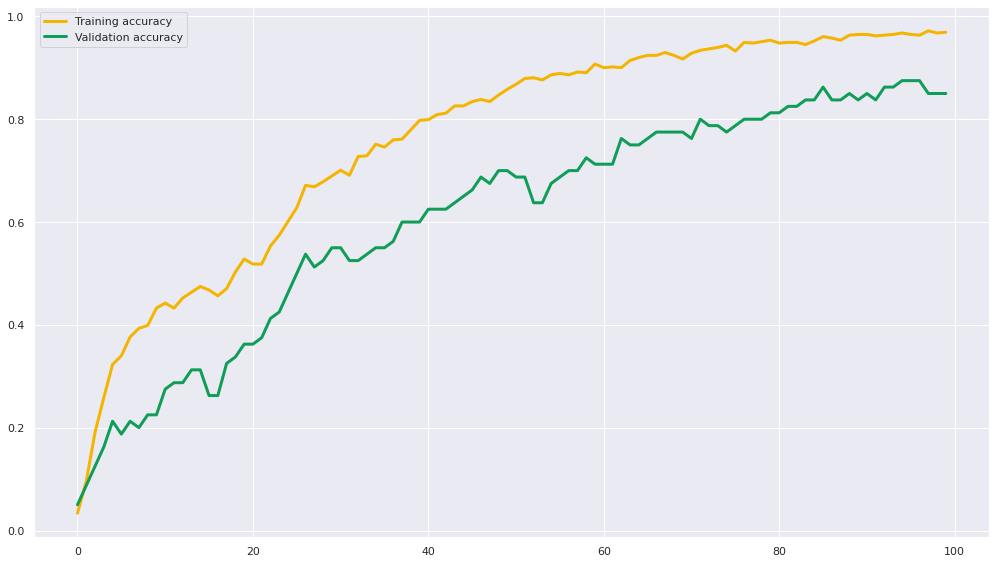

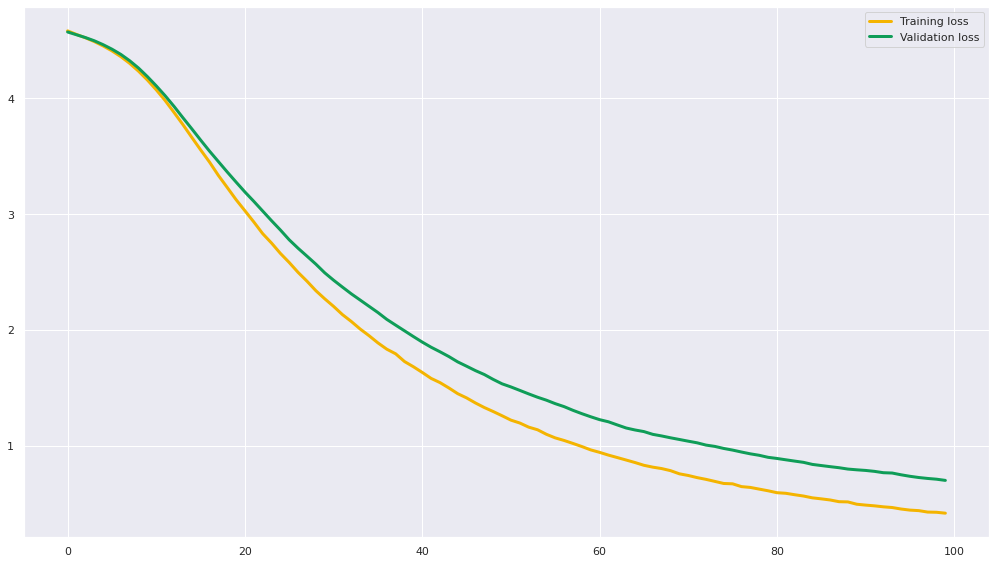

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5901 - accuracy: 0.0169 - val_loss: 4.5793 - val_accuracy: 0.0250
Epoch 2/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5608 - accuracy: 0.0646 - val_loss: 4.5605 - val_accuracy: 0.1125
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5351 - accuracy: 0.1503 - val_loss: 4.5404 - val_accuracy: 0.1750
Epoch 4/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5074 - accuracy: 0.2570 - val_loss: 4.5189 - val_accuracy: 0.2250
Epoch 5/100
12/12 [==============================] - 0s 10ms/step - loss: 4.4770 - accuracy: 0.2963 - val_loss: 4.4935 - val_accuracy: 0.1750
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4429 - accuracy: 0.3287 - val_loss: 4.4635 - val_accuracy: 0.1625
Epoch 7/100
12/12 [==============================] - 0s 9ms/step - loss: 4.40

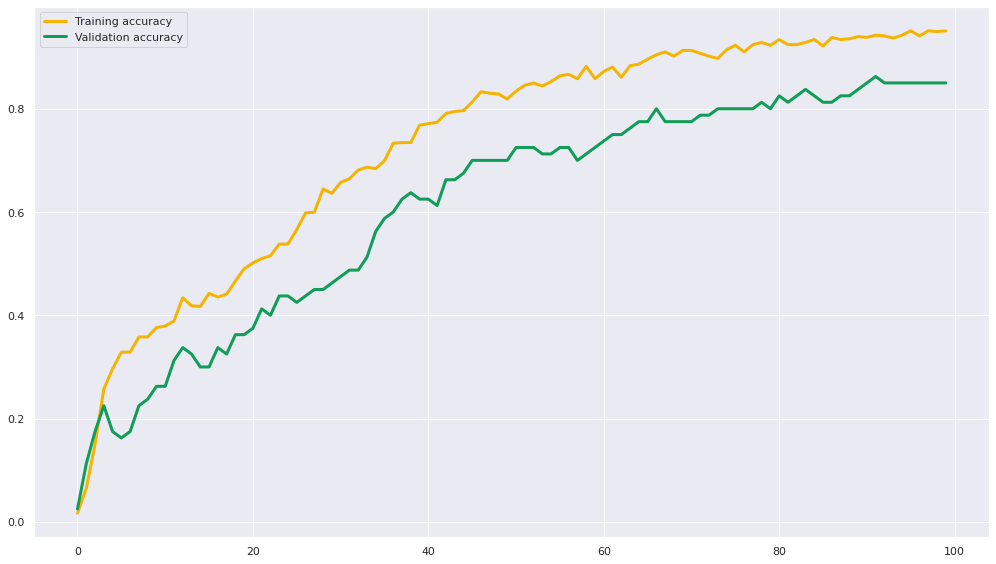

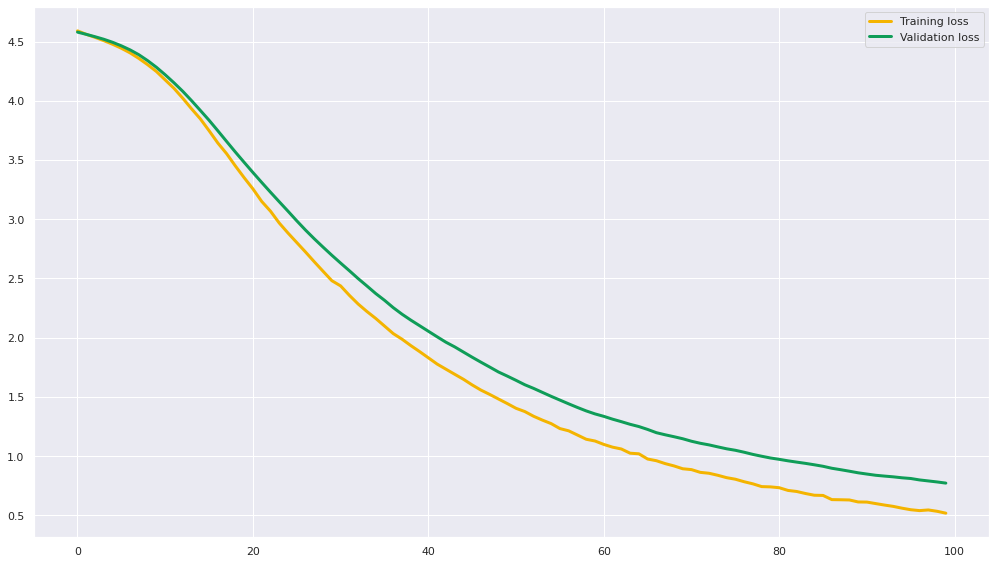

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 29ms/step - loss: 4.5919 - accuracy: 0.0197 - val_loss: 4.5787 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5624 - accuracy: 0.0744 - val_loss: 4.5596 - val_accuracy: 0.0875
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5374 - accuracy: 0.1166 - val_loss: 4.5407 - val_accuracy: 0.1125
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5114 - accuracy: 0.1868 - val_loss: 4.5183 - val_accuracy: 0.1250
Epoch 5/100
12/12 [==============================] - 0s 10ms/step - loss: 4.4835 - accuracy: 0.2079 - val_loss: 4.4920 - val_accuracy: 0.1375
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4514 - accuracy: 0.2598 - val_loss: 4.4624 - val_accuracy: 0.1875
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.409

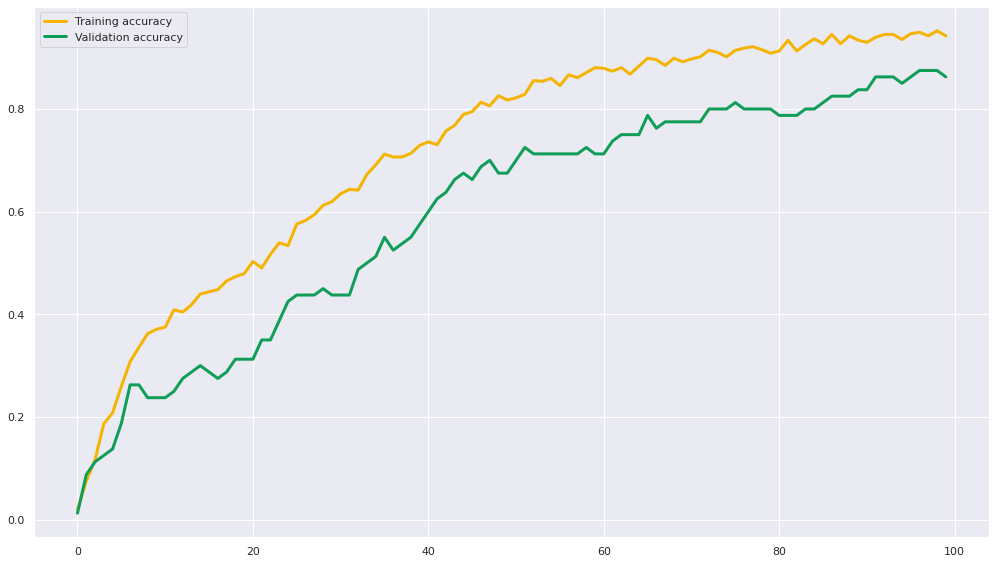

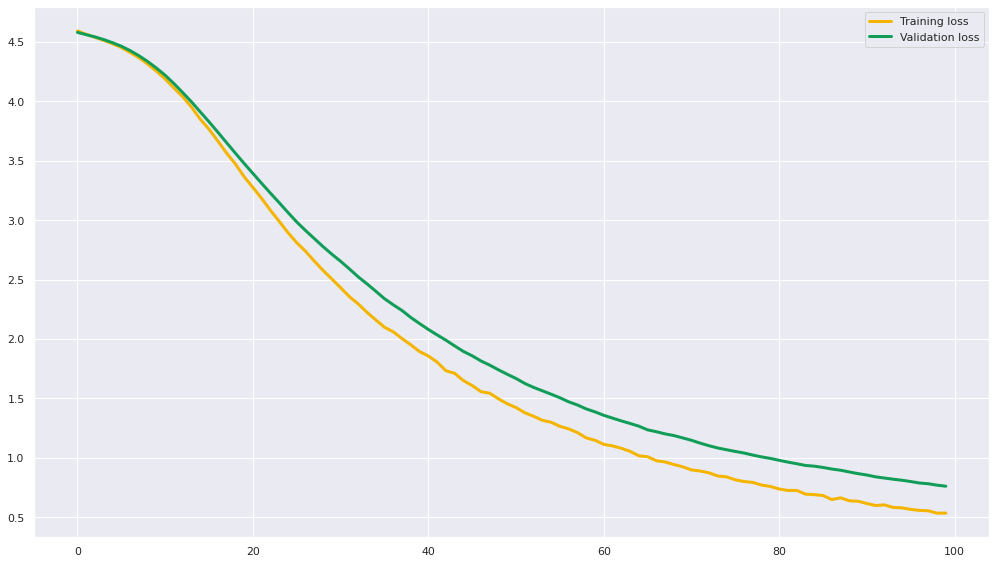

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5887 - accuracy: 0.0140 - val_loss: 4.5787 - val_accuracy: 0.0375
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5601 - accuracy: 0.0632 - val_loss: 4.5594 - val_accuracy: 0.0875
Epoch 3/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5350 - accuracy: 0.1376 - val_loss: 4.5386 - val_accuracy: 0.1375
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.5078 - accuracy: 0.1952 - val_loss: 4.5169 - val_accuracy: 0.1625
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4767 - accuracy: 0.2430 - val_loss: 4.4913 - val_accuracy: 0.1500
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4425 - accuracy: 0.2879 - val_loss: 4.4606 - val_accuracy: 0.2000
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4034

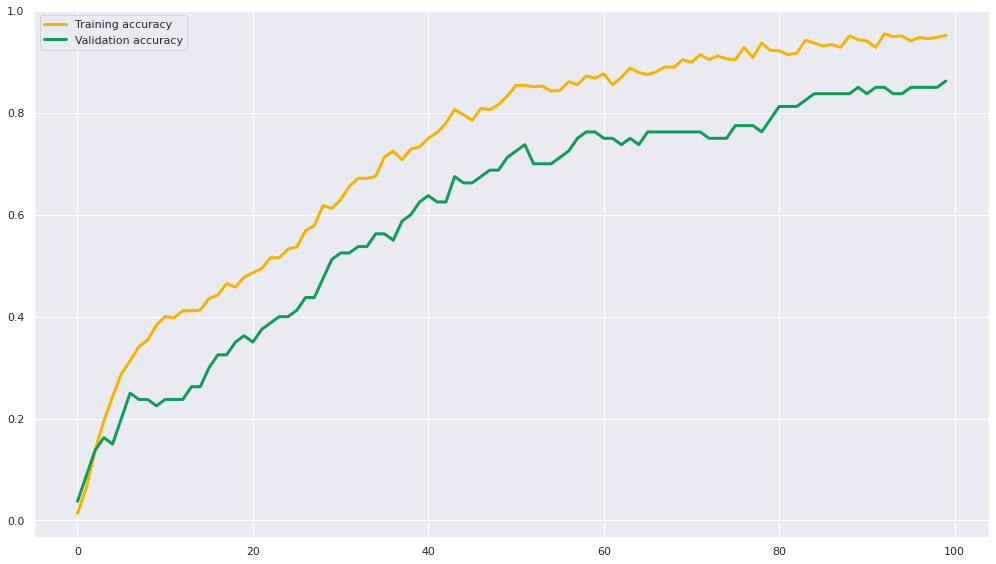

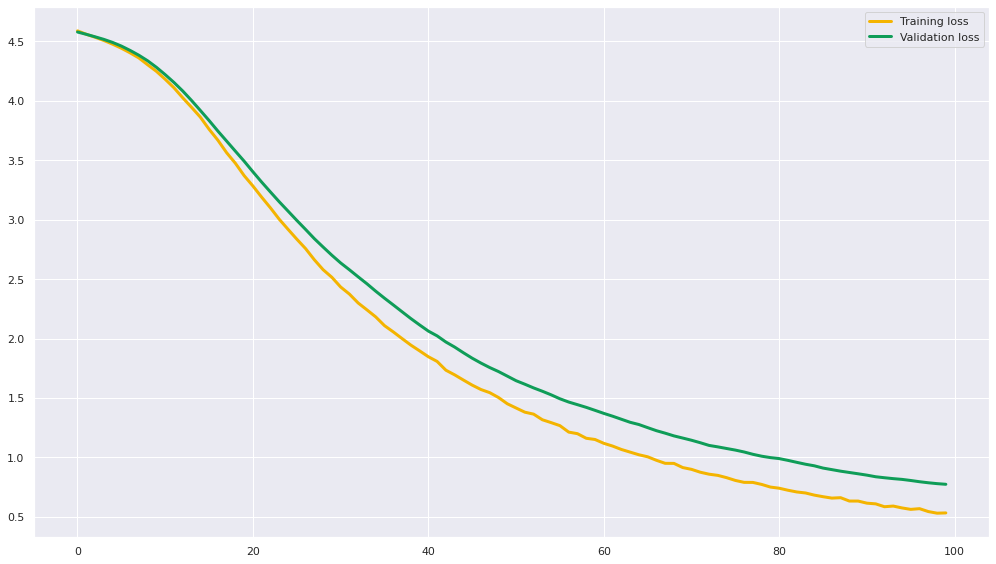

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5882 - accuracy: 0.0183 - val_loss: 4.5832 - val_accuracy: 0.0375
Epoch 2/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5646 - accuracy: 0.0492 - val_loss: 4.5665 - val_accuracy: 0.0750
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5397 - accuracy: 0.1222 - val_loss: 4.5495 - val_accuracy: 0.1125
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5170 - accuracy: 0.1489 - val_loss: 4.5289 - val_accuracy: 0.1375
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4894 - accuracy: 0.2065 - val_loss: 4.5064 - val_accuracy: 0.1750
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4627 - accuracy: 0.2360 - val_loss: 4.4806 - val_accuracy: 0.2375
Epoch 7/100
12/12 [==============================] - 0s 5ms/step - loss: 4.4294

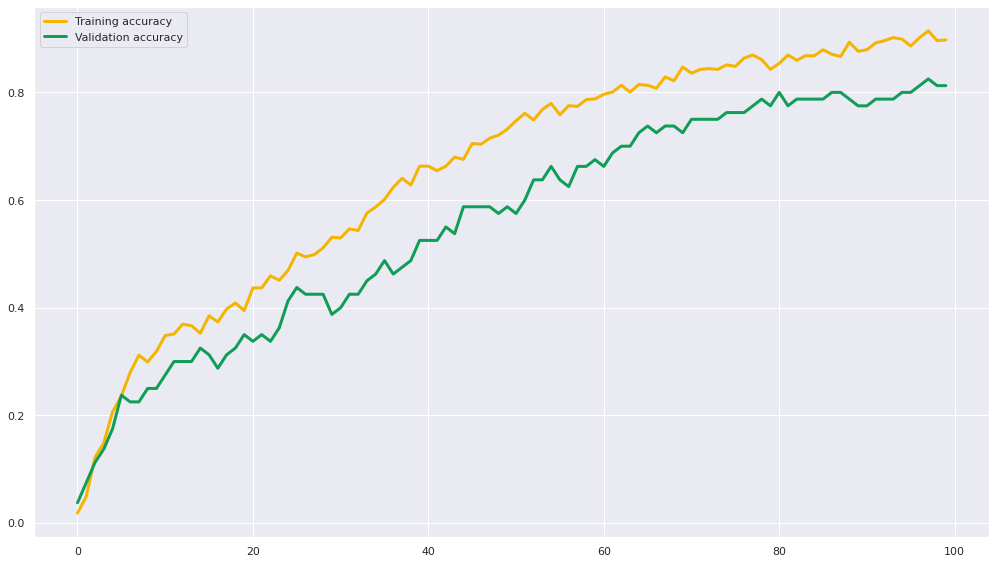

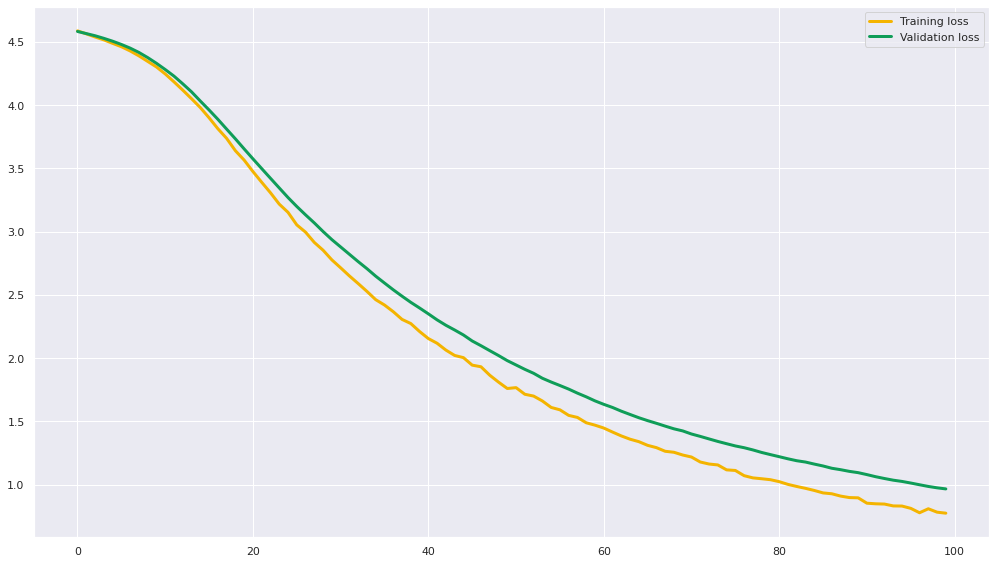

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5907 - accuracy: 0.0098 - val_loss: 4.5812 - val_accuracy: 0.0125
Epoch 2/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5653 - accuracy: 0.0421 - val_loss: 4.5647 - val_accuracy: 0.0625
Epoch 3/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5459 - accuracy: 0.0885 - val_loss: 4.5469 - val_accuracy: 0.1000
Epoch 4/100
12/12 [==============================] - 0s 5ms/step - loss: 4.5195 - accuracy: 0.1320 - val_loss: 4.5274 - val_accuracy: 0.1250
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4949 - accuracy: 0.1756 - val_loss: 4.5062 - val_accuracy: 0.1625
Epoch 6/100
12/12 [==============================] - 0s 5ms/step - loss: 4.4679 - accuracy: 0.2121 - val_loss: 4.4830 - val_accuracy: 0.1625
Epoch 7/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4347

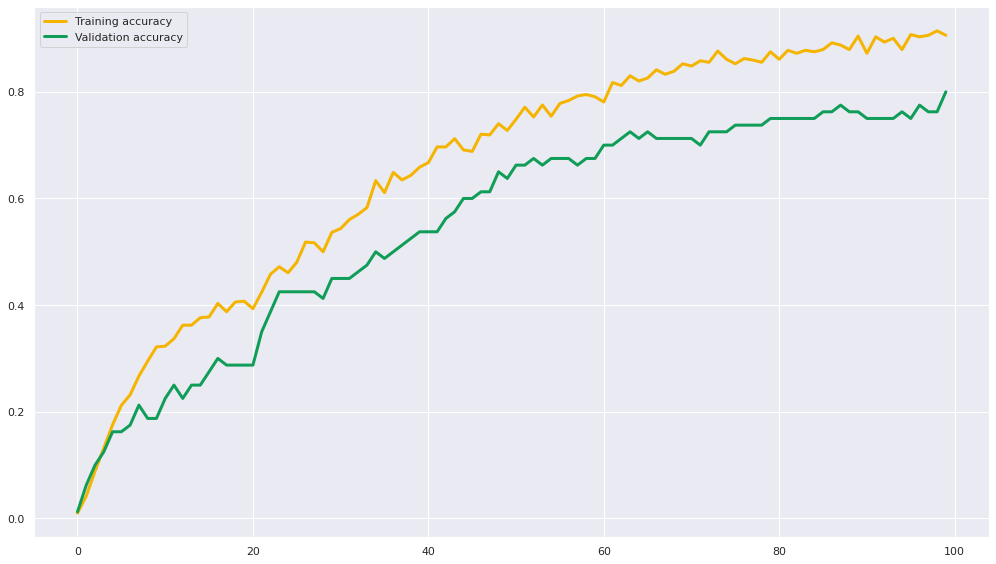

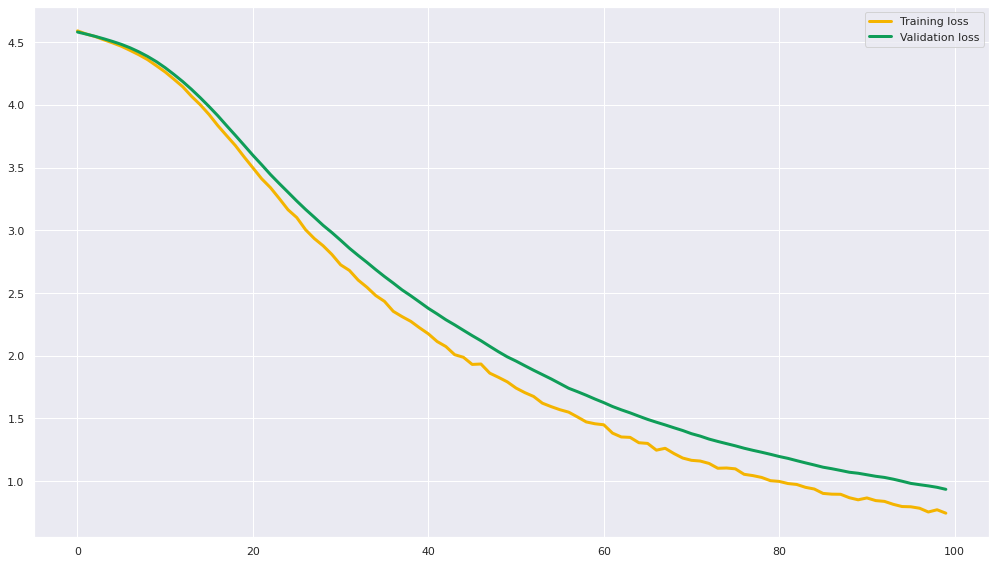

The batch_size is: 64, The hidden_size is: 128, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 26ms/step - loss: 4.5908 - accuracy: 0.0253 - val_loss: 4.5764 - val_accuracy: 0.0500
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5627 - accuracy: 0.0660 - val_loss: 4.5603 - val_accuracy: 0.1250
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5439 - accuracy: 0.0941 - val_loss: 4.5441 - val_accuracy: 0.1250
Epoch 4/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5216 - accuracy: 0.1559 - val_loss: 4.5246 - val_accuracy: 0.1625
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4973 - accuracy: 0.1868 - val_loss: 4.5023 - val_accuracy: 0.2125
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4653 - accuracy: 0.2191 - val_loss: 4.4779 - val_accuracy: 0.2000
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4333

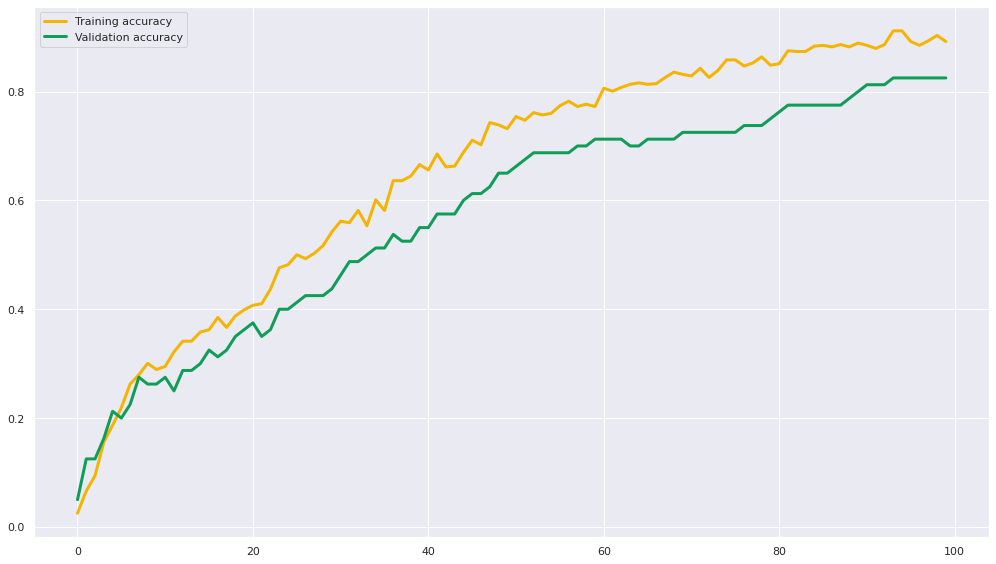

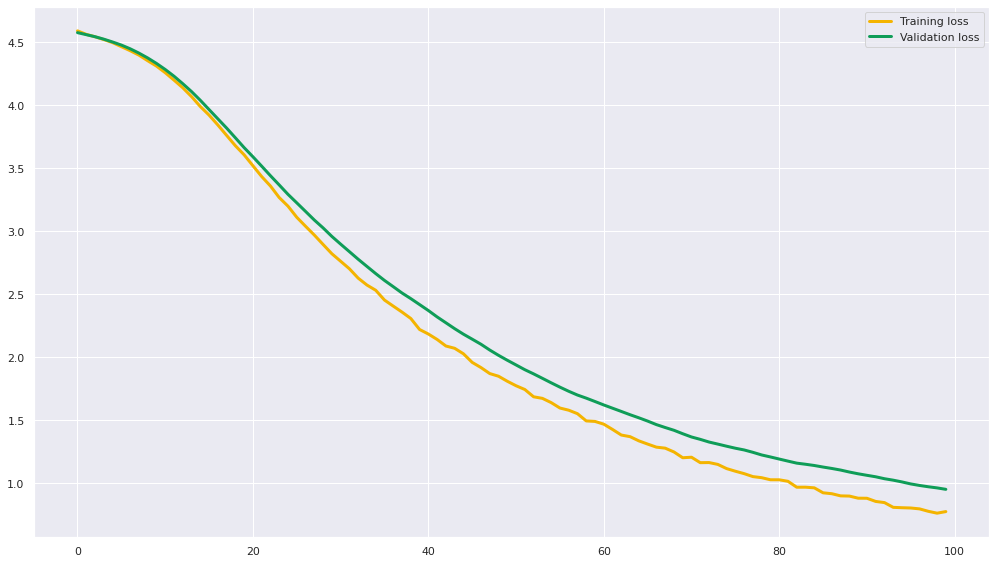

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5808 - accuracy: 0.0365 - val_loss: 4.5589 - val_accuracy: 0.1375
Epoch 2/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5302 - accuracy: 0.1728 - val_loss: 4.5184 - val_accuracy: 0.1875
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4811 - accuracy: 0.3483 - val_loss: 4.4783 - val_accuracy: 0.3000
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4260 - accuracy: 0.4115 - val_loss: 4.4289 - val_accuracy: 0.2875
Epoch 5/100
12/12 [==============================] - 0s 6ms/step - loss: 4.3619 - accuracy: 0.4452 - val_loss: 4.3711 - val_accuracy: 0.3250
Epoch 6/100
12/12 [==============================] - 0s 9ms/step - loss: 4.2849 - accuracy: 0.4424 - val_loss: 4.3011 - val_accuracy: 0.3250
Epoch 7/100
12/12 [==============================] - 0s 10ms/step - loss: 4.194

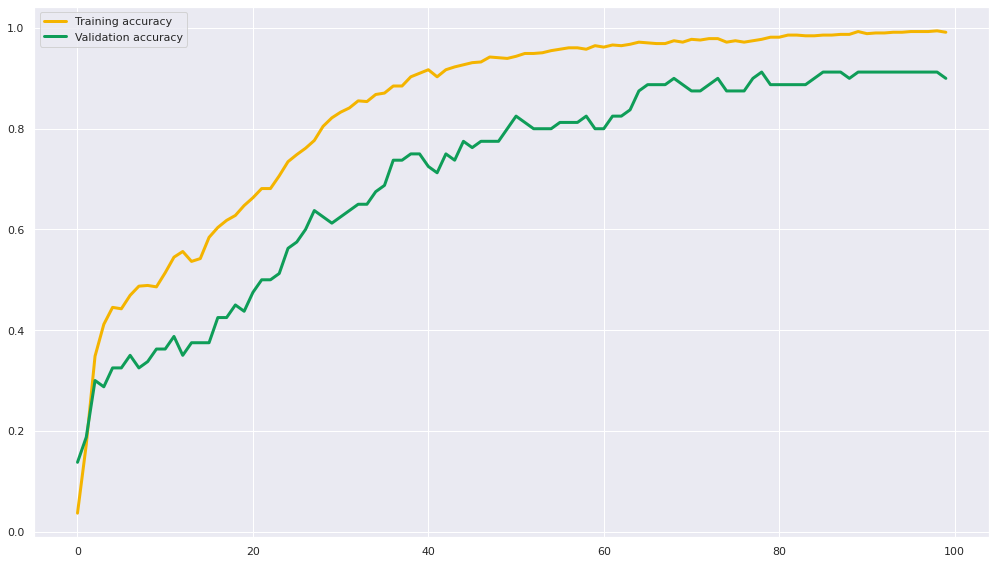

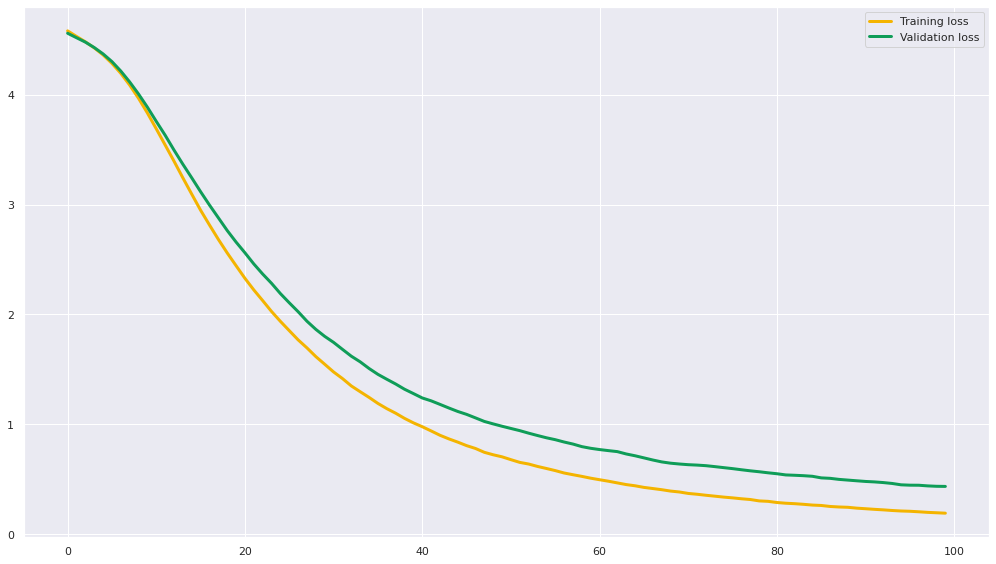

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 31ms/step - loss: 4.5815 - accuracy: 0.0421 - val_loss: 4.5592 - val_accuracy: 0.1500
Epoch 2/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5321 - accuracy: 0.2374 - val_loss: 4.5244 - val_accuracy: 0.2500
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4840 - accuracy: 0.3343 - val_loss: 4.4833 - val_accuracy: 0.2750
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4300 - accuracy: 0.3947 - val_loss: 4.4355 - val_accuracy: 0.2750
Epoch 5/100
12/12 [==============================] - 0s 9ms/step - loss: 4.3678 - accuracy: 0.4508 - val_loss: 4.3786 - val_accuracy: 0.2875
Epoch 6/100
12/12 [==============================] - 0s 10ms/step - loss: 4.2906 - accuracy: 0.4705 - val_loss: 4.3079 - val_accuracy: 0.3375
Epoch 7/100
12/12 [==============================] - 0s 13ms/step - loss: 4.2

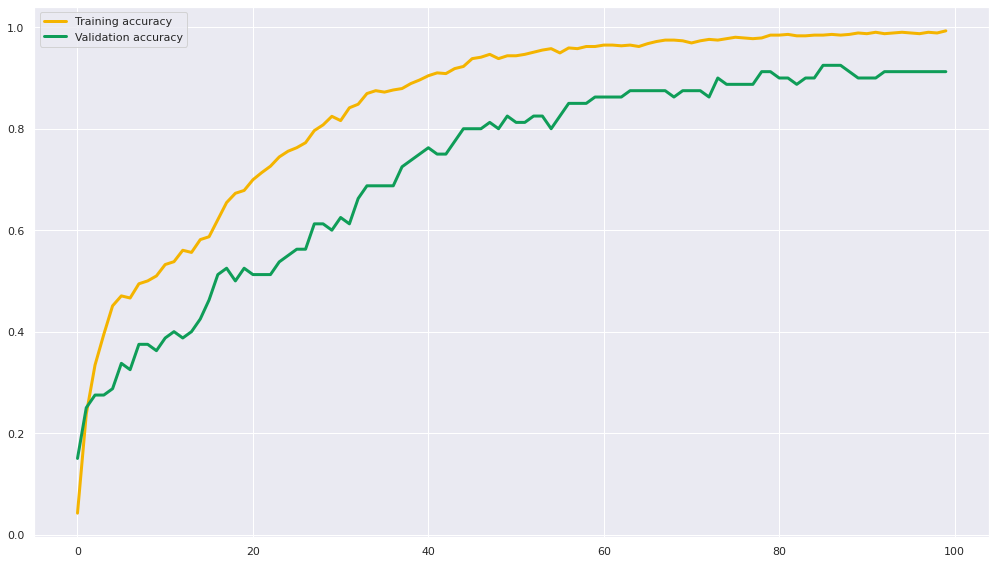

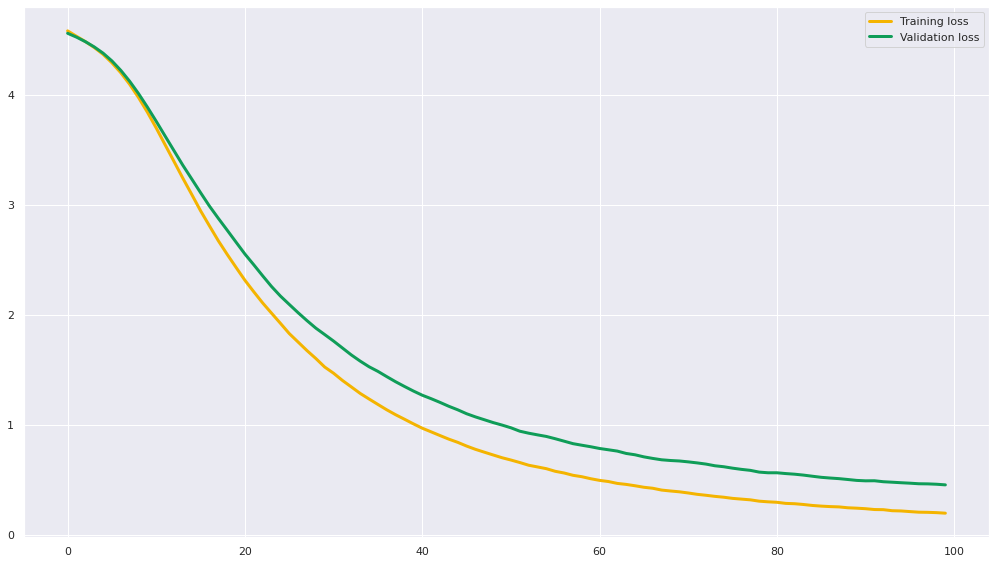

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 26ms/step - loss: 4.5846 - accuracy: 0.0295 - val_loss: 4.5642 - val_accuracy: 0.0500
Epoch 2/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5342 - accuracy: 0.1545 - val_loss: 4.5268 - val_accuracy: 0.1250
Epoch 3/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4866 - accuracy: 0.2921 - val_loss: 4.4896 - val_accuracy: 0.2000
Epoch 4/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4344 - accuracy: 0.3216 - val_loss: 4.4422 - val_accuracy: 0.2000
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3711 - accuracy: 0.3553 - val_loss: 4.3874 - val_accuracy: 0.2375
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.2973 - accuracy: 0.3834 - val_loss: 4.3183 - val_accuracy: 0.2625
Epoch 7/100
12/12 [==============================] - 0s 9ms/step - loss: 4.2090

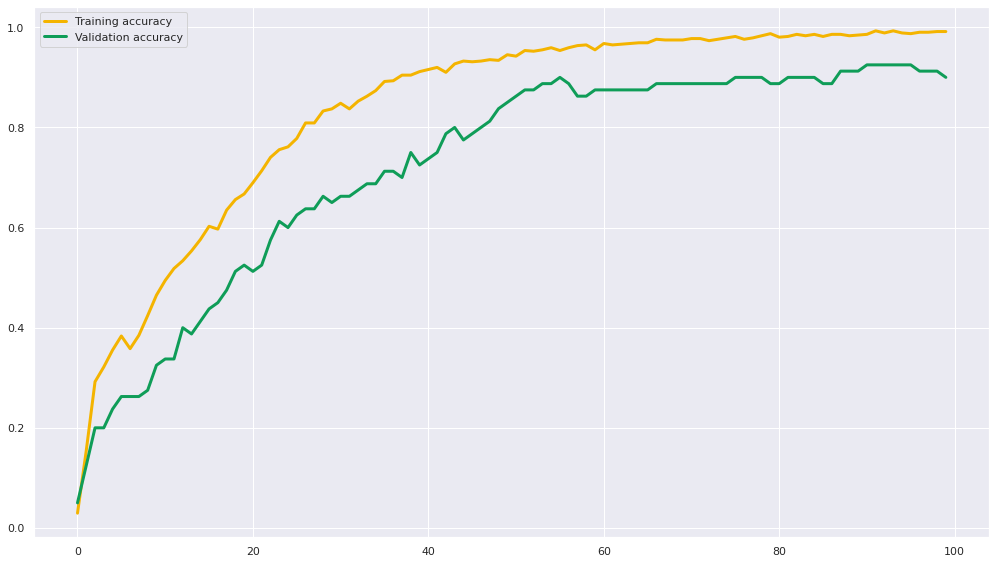

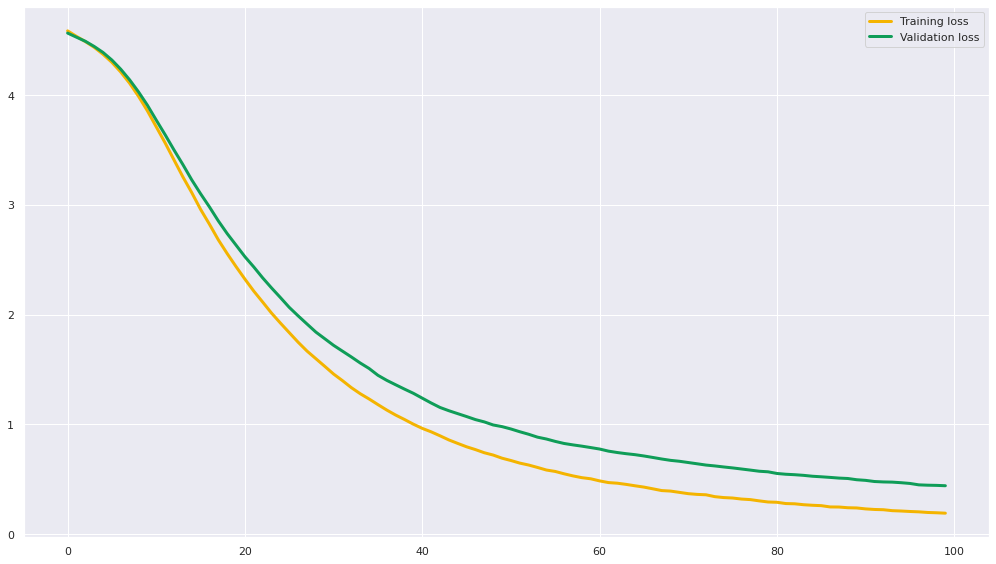

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 27ms/step - loss: 4.5810 - accuracy: 0.0463 - val_loss: 4.5705 - val_accuracy: 0.0750
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5363 - accuracy: 0.1868 - val_loss: 4.5382 - val_accuracy: 0.0875
Epoch 3/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4947 - accuracy: 0.2654 - val_loss: 4.5046 - val_accuracy: 0.1625
Epoch 4/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4482 - accuracy: 0.3539 - val_loss: 4.4644 - val_accuracy: 0.1875
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3946 - accuracy: 0.4228 - val_loss: 4.4182 - val_accuracy: 0.2625
Epoch 6/100
12/12 [==============================] - 0s 6ms/step - loss: 4.3319 - accuracy: 0.4284 - val_loss: 4.3629 - val_accuracy: 0.2500
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.2589

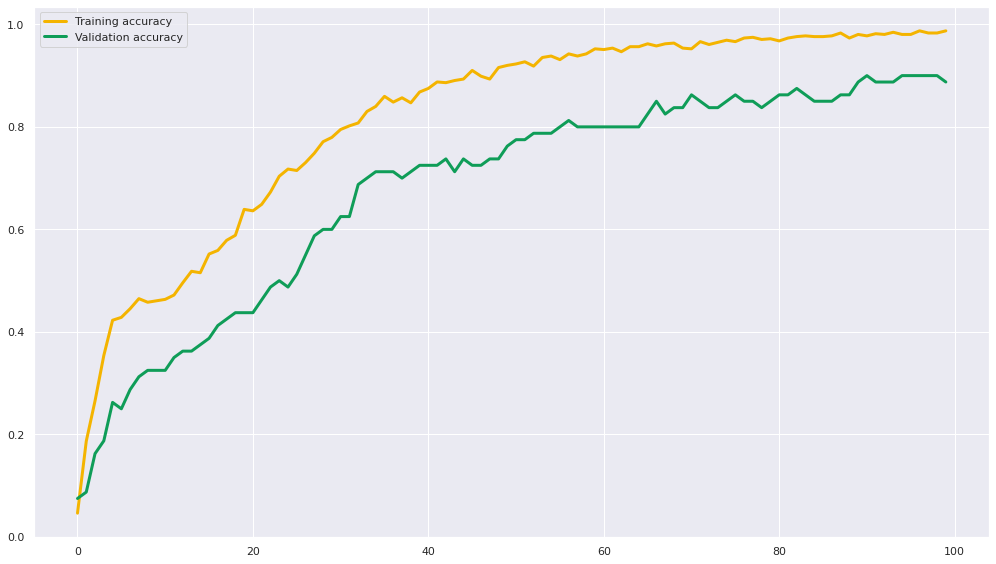

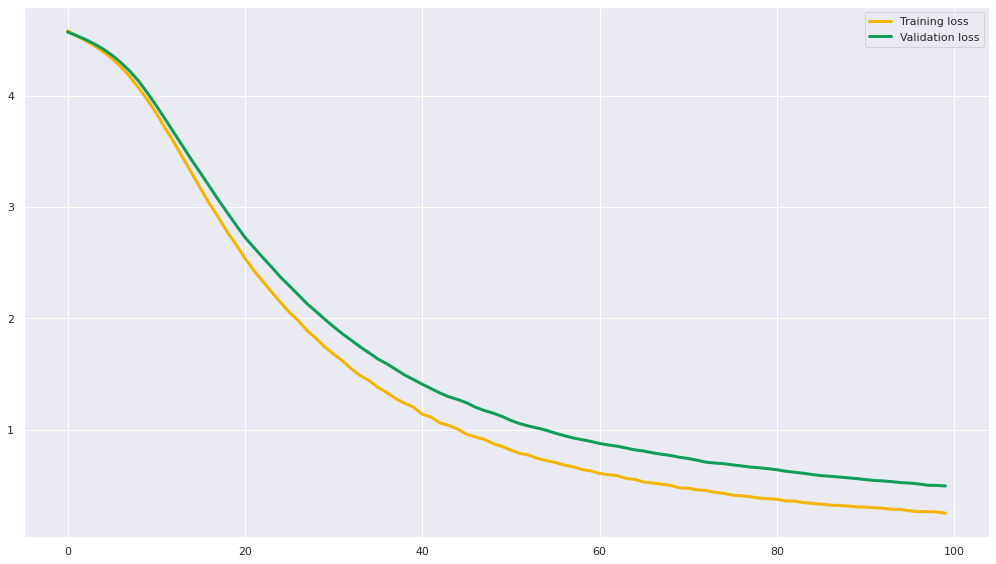

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 27ms/step - loss: 4.5844 - accuracy: 0.0183 - val_loss: 4.5623 - val_accuracy: 0.1000
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5397 - accuracy: 0.1124 - val_loss: 4.5278 - val_accuracy: 0.1750
Epoch 3/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4961 - accuracy: 0.2402 - val_loss: 4.4903 - val_accuracy: 0.2500
Epoch 4/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4493 - accuracy: 0.3301 - val_loss: 4.4495 - val_accuracy: 0.2875
Epoch 5/100
12/12 [==============================] - 0s 9ms/step - loss: 4.3957 - accuracy: 0.3848 - val_loss: 4.3989 - val_accuracy: 0.3250
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3289 - accuracy: 0.4101 - val_loss: 4.3382 - val_accuracy: 0.2750
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.2515

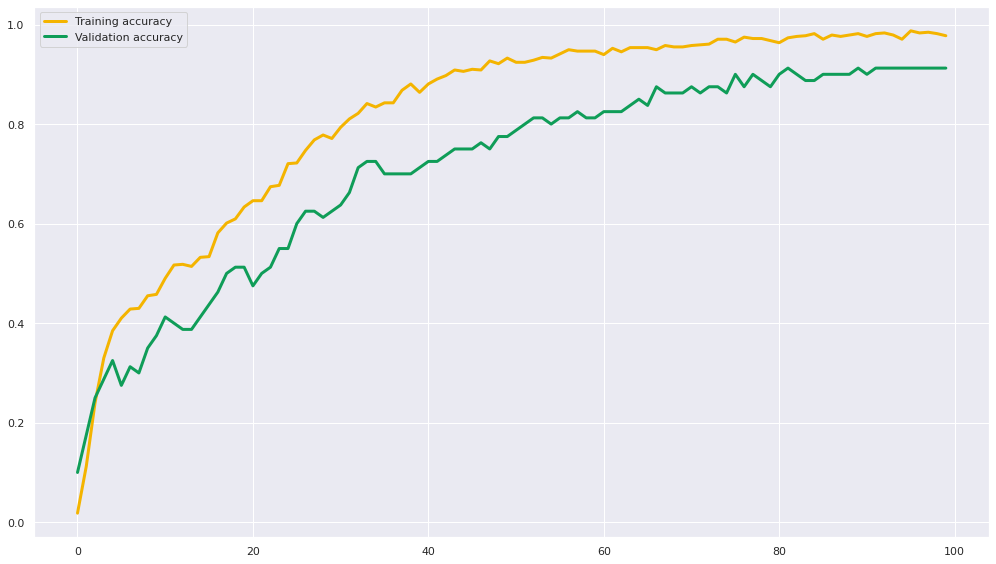

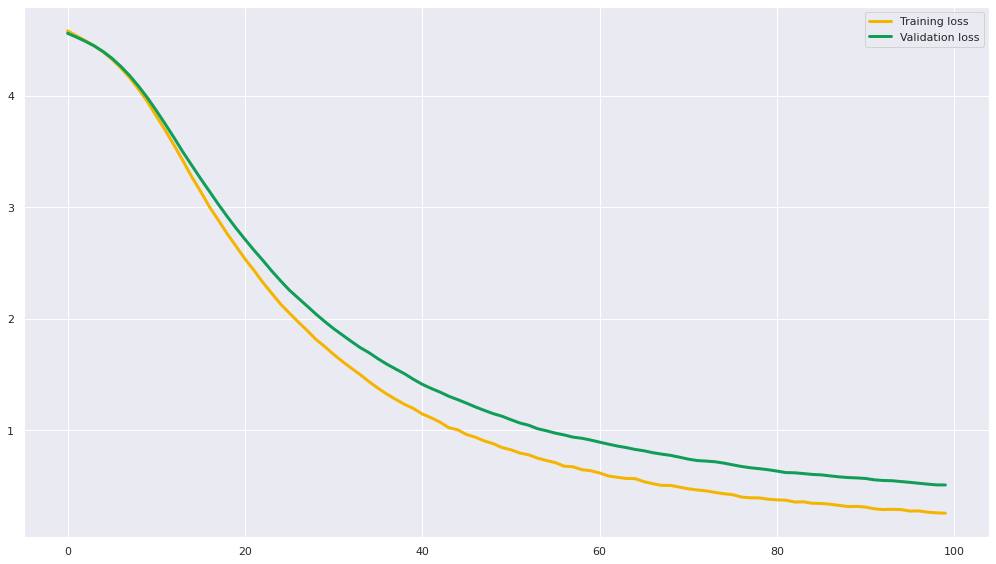

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 36ms/step - loss: 4.5859 - accuracy: 0.0351 - val_loss: 4.5598 - val_accuracy: 0.1125
Epoch 2/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5408 - accuracy: 0.1503 - val_loss: 4.5281 - val_accuracy: 0.1875
Epoch 3/100
12/12 [==============================] - 0s 10ms/step - loss: 4.4991 - accuracy: 0.2388 - val_loss: 4.4949 - val_accuracy: 0.1625
Epoch 4/100
12/12 [==============================] - 0s 10ms/step - loss: 4.4517 - accuracy: 0.2795 - val_loss: 4.4545 - val_accuracy: 0.1875
Epoch 5/100
12/12 [==============================] - 0s 10ms/step - loss: 4.3970 - accuracy: 0.3230 - val_loss: 4.4066 - val_accuracy: 0.2250
Epoch 6/100
12/12 [==============================] - 0s 11ms/step - loss: 4.3342 - accuracy: 0.3272 - val_loss: 4.3482 - val_accuracy: 0.2625
Epoch 7/100
12/12 [==============================] - 0s 9ms/step - loss: 4

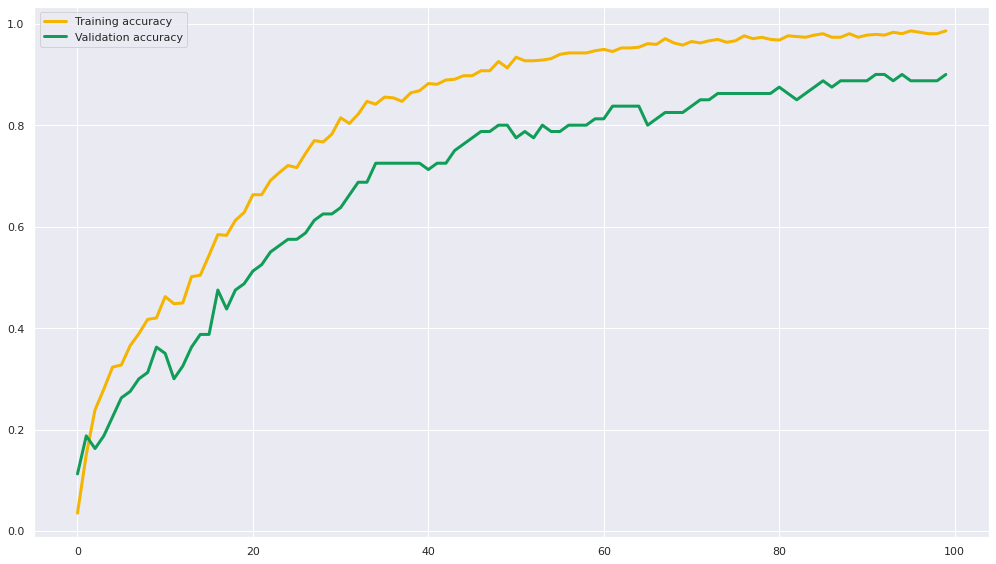

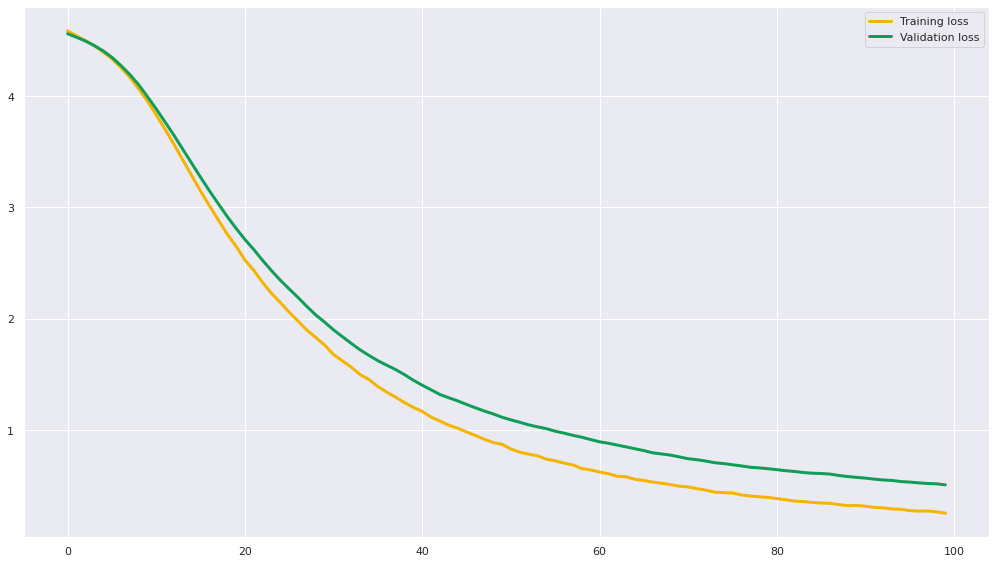

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 29ms/step - loss: 4.5882 - accuracy: 0.0140 - val_loss: 4.5692 - val_accuracy: 0.0875
Epoch 2/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5481 - accuracy: 0.1025 - val_loss: 4.5426 - val_accuracy: 0.1625
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5092 - accuracy: 0.1994 - val_loss: 4.5129 - val_accuracy: 0.2125
Epoch 4/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4705 - accuracy: 0.2865 - val_loss: 4.4804 - val_accuracy: 0.2000
Epoch 5/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4220 - accuracy: 0.3174 - val_loss: 4.4412 - val_accuracy: 0.2125
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.3759 - accuracy: 0.3174 - val_loss: 4.3971 - val_accuracy: 0.2125
Epoch 7/100
12/12 [==============================] - 0s 8ms/step - loss: 4.3150

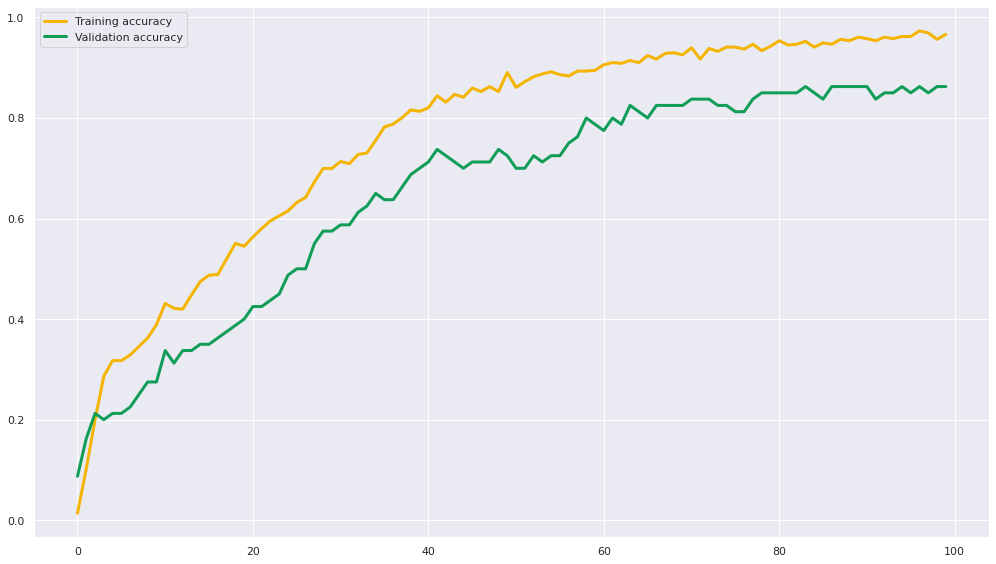

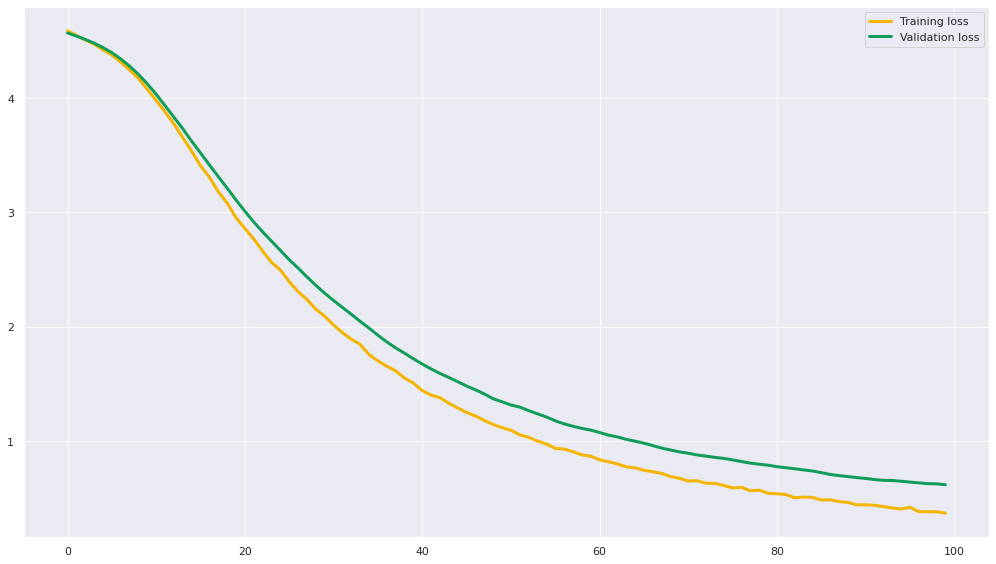

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 23ms/step - loss: 4.5882 - accuracy: 0.0169 - val_loss: 4.5682 - val_accuracy: 0.1000
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5473 - accuracy: 0.0857 - val_loss: 4.5380 - val_accuracy: 0.1500
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5119 - accuracy: 0.1657 - val_loss: 4.5076 - val_accuracy: 0.2000
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4718 - accuracy: 0.2402 - val_loss: 4.4738 - val_accuracy: 0.2250
Epoch 5/100
12/12 [==============================] - 0s 7ms/step - loss: 4.4266 - accuracy: 0.3202 - val_loss: 4.4350 - val_accuracy: 0.2000
Epoch 6/100
12/12 [==============================] - 0s 6ms/step - loss: 4.3814 - accuracy: 0.3202 - val_loss: 4.3890 - val_accuracy: 0.2375
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3193

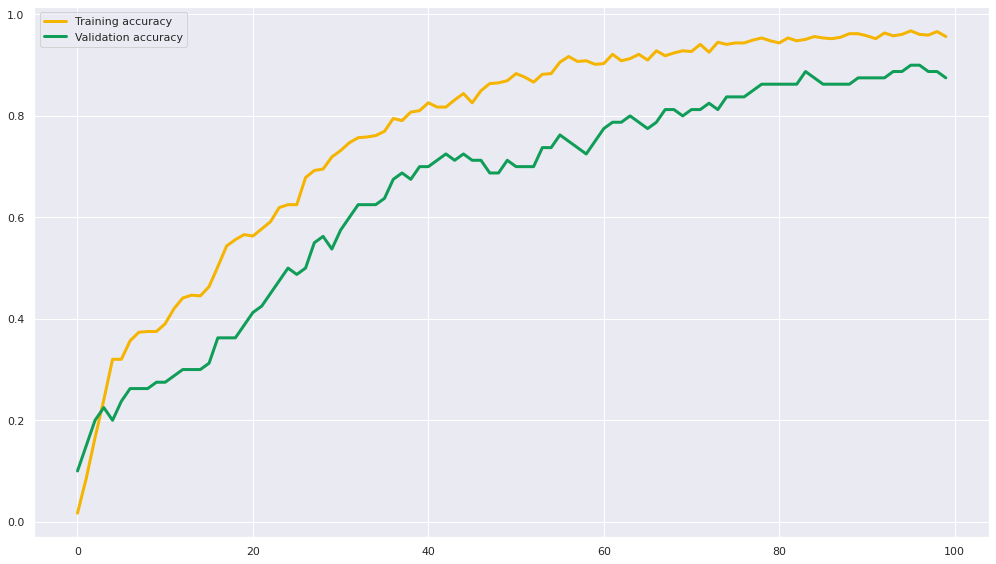

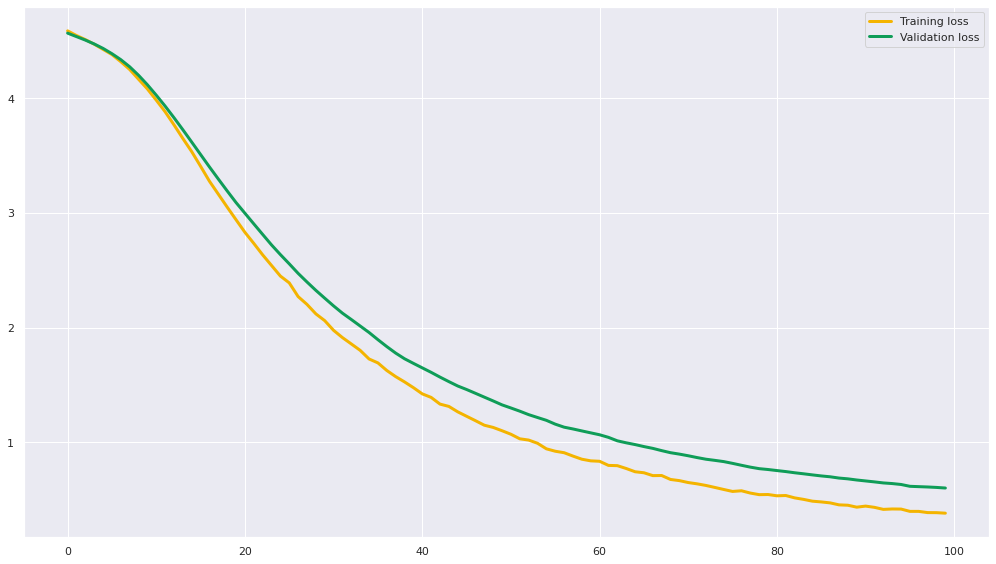

The batch_size is: 64, The hidden_size is: 256, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 25ms/step - loss: 4.5834 - accuracy: 0.0225 - val_loss: 4.5721 - val_accuracy: 0.0750
Epoch 2/100
12/12 [==============================] - 0s 7ms/step - loss: 4.5449 - accuracy: 0.1011 - val_loss: 4.5457 - val_accuracy: 0.1000
Epoch 3/100
12/12 [==============================] - 0s 8ms/step - loss: 4.5059 - accuracy: 0.1699 - val_loss: 4.5175 - val_accuracy: 0.1250
Epoch 4/100
12/12 [==============================] - 0s 6ms/step - loss: 4.4627 - accuracy: 0.2584 - val_loss: 4.4842 - val_accuracy: 0.1500
Epoch 5/100
12/12 [==============================] - 0s 8ms/step - loss: 4.4204 - accuracy: 0.2753 - val_loss: 4.4447 - val_accuracy: 0.2000
Epoch 6/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3687 - accuracy: 0.2921 - val_loss: 4.3989 - val_accuracy: 0.2250
Epoch 7/100
12/12 [==============================] - 0s 7ms/step - loss: 4.3083

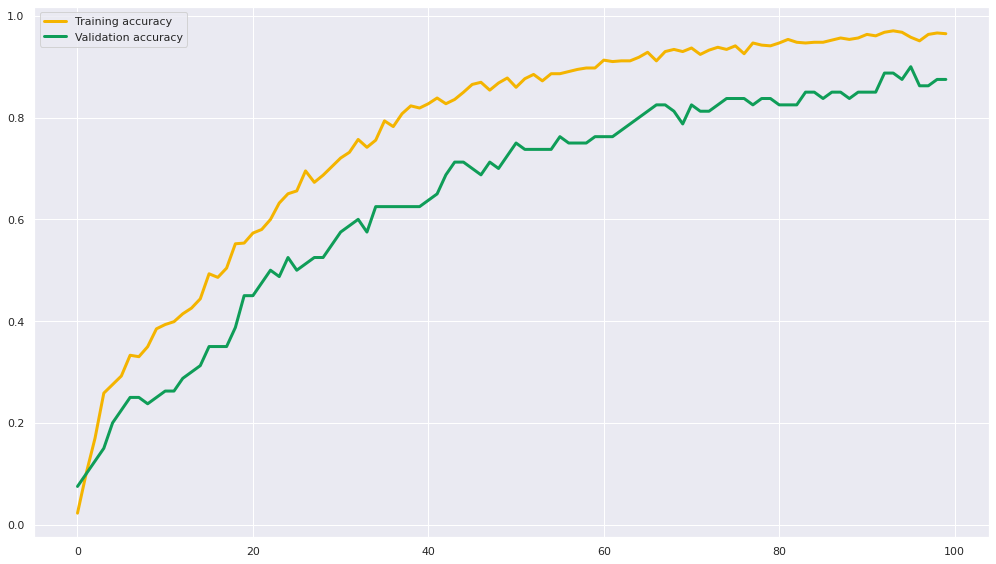

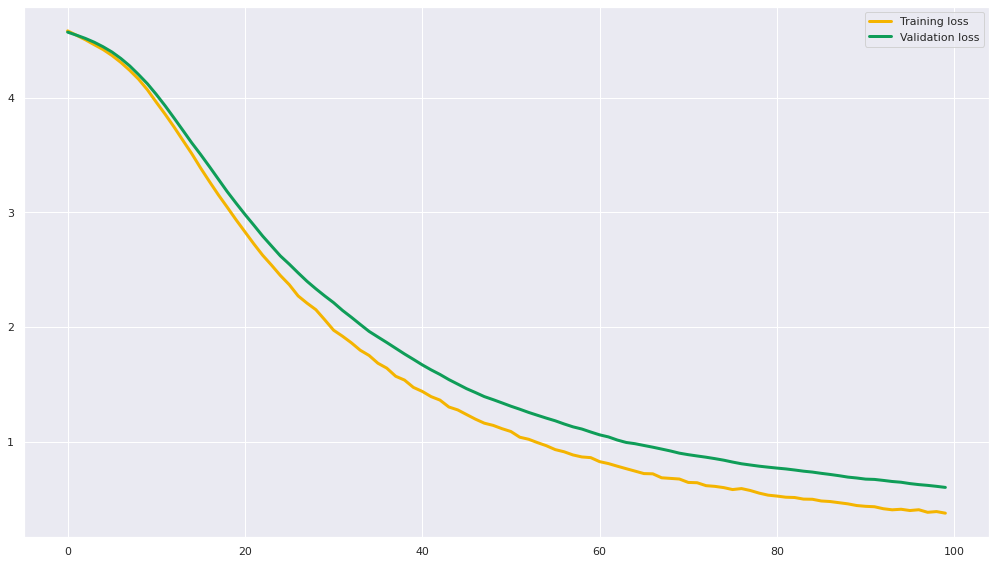

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 27ms/step - loss: 4.5761 - accuracy: 0.0478 - val_loss: 4.5395 - val_accuracy: 0.1375
Epoch 2/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4978 - accuracy: 0.2907 - val_loss: 4.4849 - val_accuracy: 0.2375
Epoch 3/100
12/12 [==============================] - 0s 10ms/step - loss: 4.4210 - accuracy: 0.4045 - val_loss: 4.4185 - val_accuracy: 0.2750
Epoch 4/100
12/12 [==============================] - 0s 9ms/step - loss: 4.3299 - accuracy: 0.4382 - val_loss: 4.3336 - val_accuracy: 0.2625
Epoch 5/100
12/12 [==============================] - 0s 10ms/step - loss: 4.2153 - accuracy: 0.4494 - val_loss: 4.2215 - val_accuracy: 0.3125
Epoch 6/100
12/12 [==============================] - 0s 11ms/step - loss: 4.0760 - accuracy: 0.4747 - val_loss: 4.0858 - val_accuracy: 0.3250
Epoch 7/100
12/12 [==============================] - 0s 10ms/step - loss: 3.

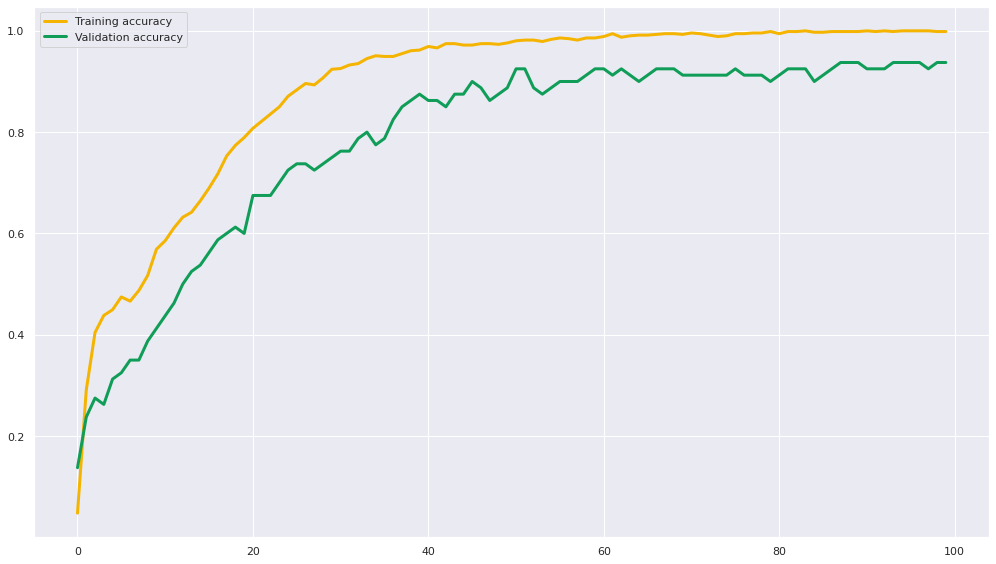

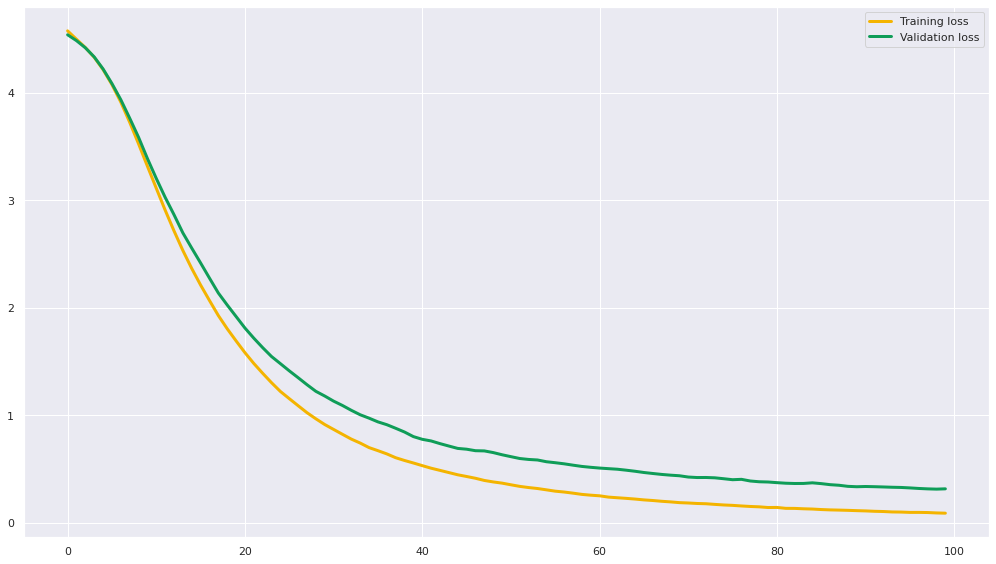

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 31ms/step - loss: 4.5766 - accuracy: 0.0562 - val_loss: 4.5432 - val_accuracy: 0.1375
Epoch 2/100
12/12 [==============================] - 0s 10ms/step - loss: 4.4981 - accuracy: 0.2921 - val_loss: 4.4847 - val_accuracy: 0.1750
Epoch 3/100
12/12 [==============================] - 0s 12ms/step - loss: 4.4208 - accuracy: 0.3104 - val_loss: 4.4203 - val_accuracy: 0.2125
Epoch 4/100
12/12 [==============================] - 0s 15ms/step - loss: 4.3312 - accuracy: 0.3722 - val_loss: 4.3370 - val_accuracy: 0.2500
Epoch 5/100
12/12 [==============================] - 0s 11ms/step - loss: 4.2182 - accuracy: 0.4199 - val_loss: 4.2284 - val_accuracy: 0.3125
Epoch 6/100
12/12 [==============================] - 0s 10ms/step - loss: 4.0841 - accuracy: 0.4775 - val_loss: 4.0940 - val_accuracy: 0.2750
Epoch 7/100
12/12 [==============================] - 0s 9ms/step - loss: 3

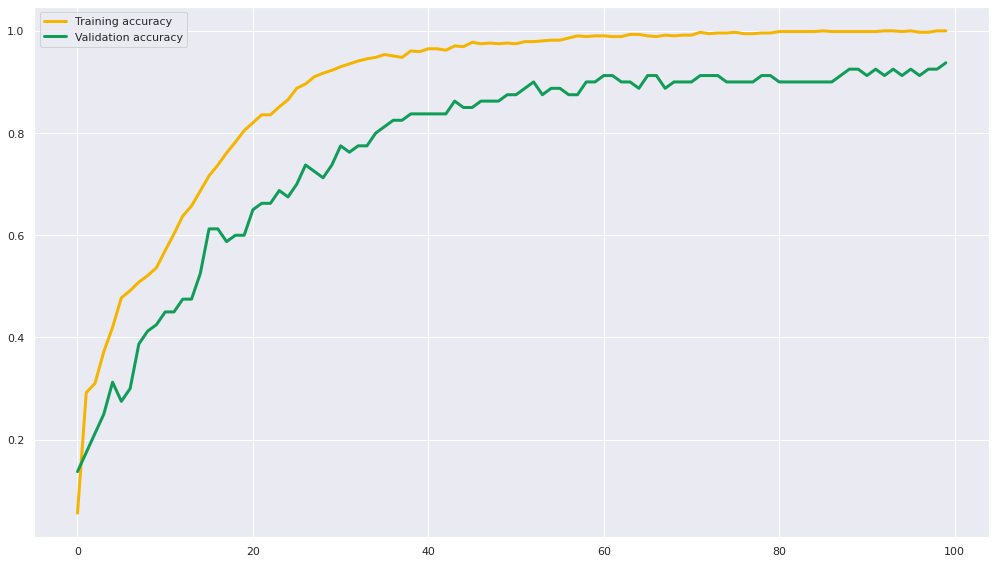

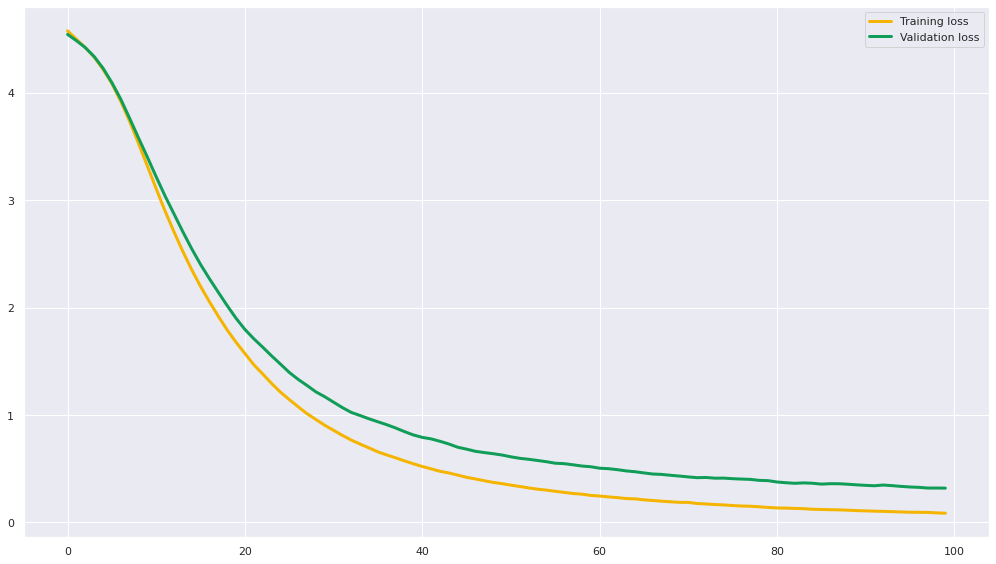

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.1 
Epoch 1/100
12/12 [==============================] - 1s 28ms/step - loss: 4.5770 - accuracy: 0.0506 - val_loss: 4.5457 - val_accuracy: 0.0625
Epoch 2/100
12/12 [==============================] - 0s 14ms/step - loss: 4.4998 - accuracy: 0.2022 - val_loss: 4.4877 - val_accuracy: 0.1500
Epoch 3/100
12/12 [==============================] - 0s 12ms/step - loss: 4.4220 - accuracy: 0.3624 - val_loss: 4.4185 - val_accuracy: 0.2500
Epoch 4/100
12/12 [==============================] - 0s 15ms/step - loss: 4.3311 - accuracy: 0.4087 - val_loss: 4.3354 - val_accuracy: 0.2500
Epoch 5/100
12/12 [==============================] - 0s 14ms/step - loss: 4.2188 - accuracy: 0.4438 - val_loss: 4.2279 - val_accuracy: 0.3125
Epoch 6/100
12/12 [==============================] - 0s 15ms/step - loss: 4.0798 - accuracy: 0.4438 - val_loss: 4.0986 - val_accuracy: 0.2625
Epoch 7/100
12/12 [==============================] - 0s 11ms/step - loss: 

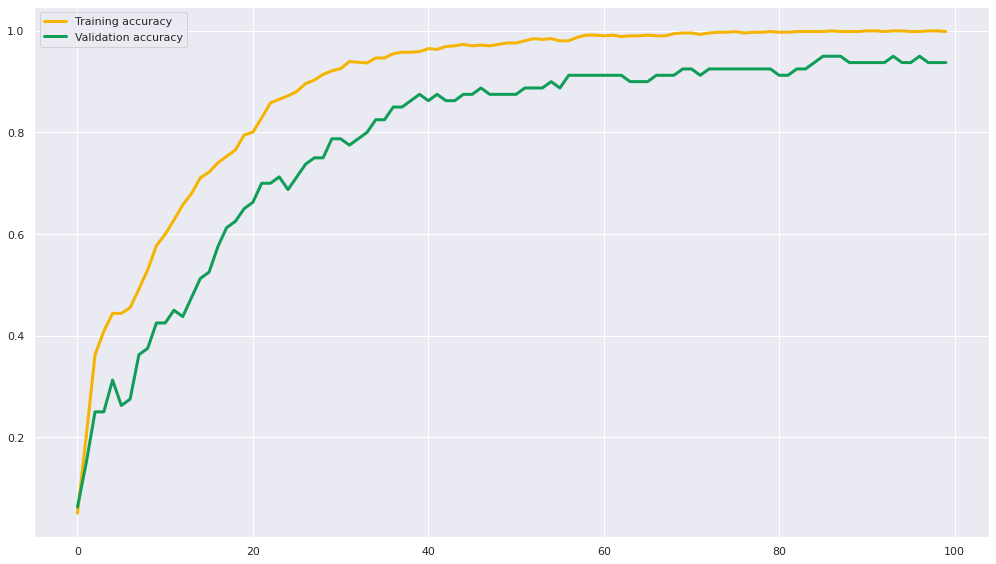

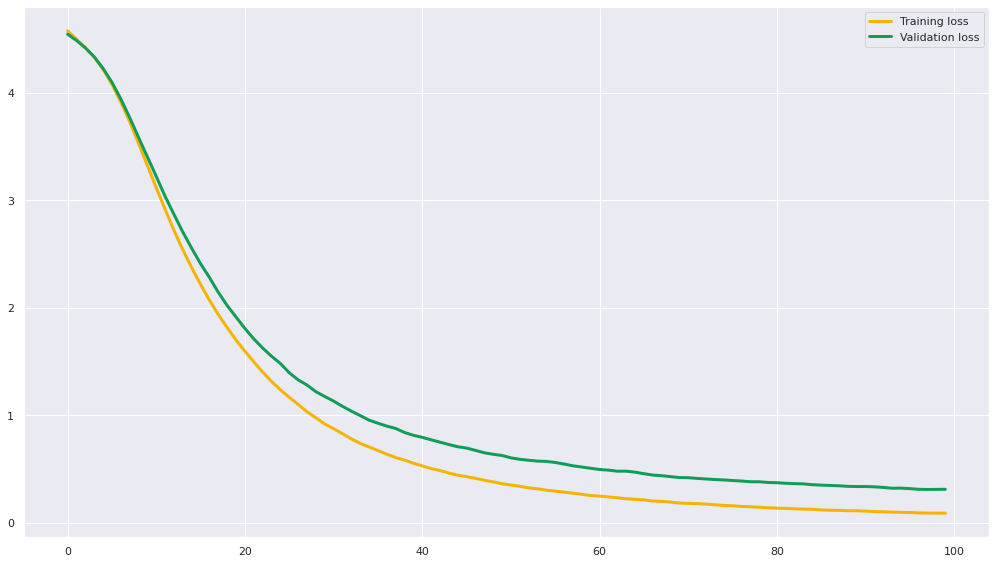

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 30ms/step - loss: 4.5799 - accuracy: 0.0463 - val_loss: 4.5485 - val_accuracy: 0.1500
Epoch 2/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5076 - accuracy: 0.2458 - val_loss: 4.4966 - val_accuracy: 0.2000
Epoch 3/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4384 - accuracy: 0.3455 - val_loss: 4.4300 - val_accuracy: 0.2500
Epoch 4/100
12/12 [==============================] - 0s 10ms/step - loss: 4.3544 - accuracy: 0.4045 - val_loss: 4.3512 - val_accuracy: 0.3125
Epoch 5/100
12/12 [==============================] - 0s 9ms/step - loss: 4.2547 - accuracy: 0.4438 - val_loss: 4.2522 - val_accuracy: 0.3000
Epoch 6/100
12/12 [==============================] - 0s 10ms/step - loss: 4.1301 - accuracy: 0.4508 - val_loss: 4.1360 - val_accuracy: 0.2875
Epoch 7/100
12/12 [==============================] - 0s 9ms/step - loss: 3.98

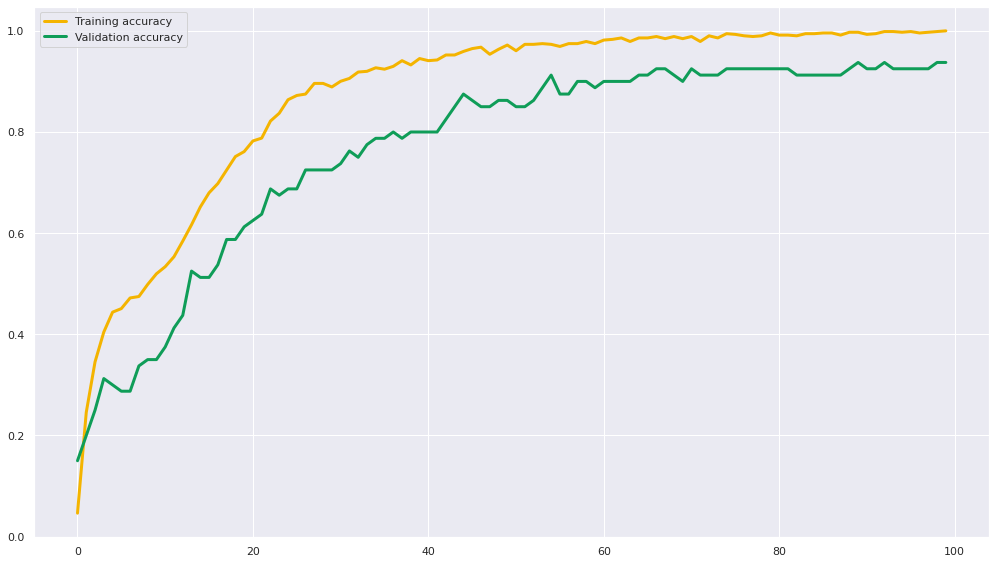

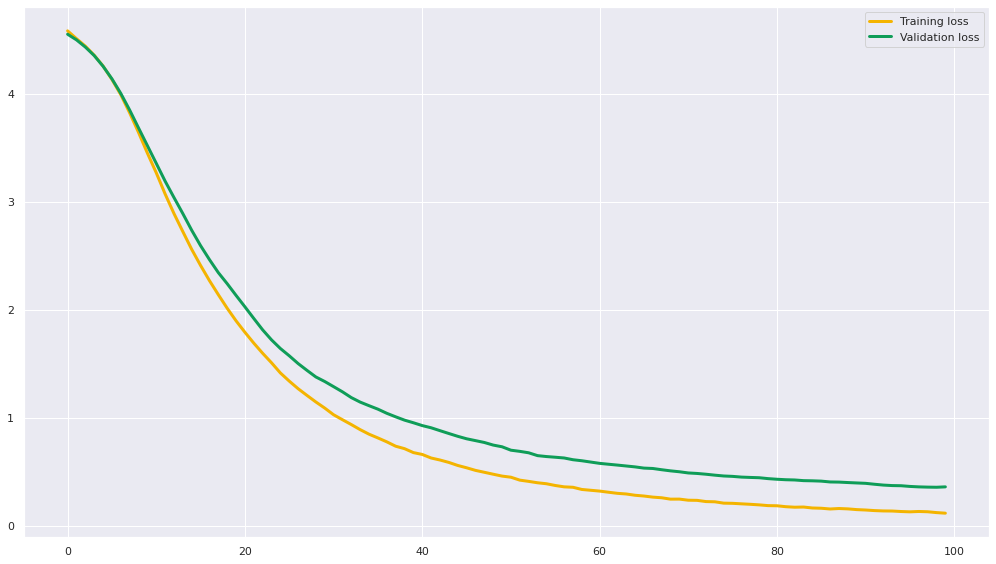

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 28ms/step - loss: 4.5780 - accuracy: 0.0421 - val_loss: 4.5469 - val_accuracy: 0.1375
Epoch 2/100
12/12 [==============================] - 0s 9ms/step - loss: 4.5081 - accuracy: 0.2135 - val_loss: 4.4974 - val_accuracy: 0.1875
Epoch 3/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4398 - accuracy: 0.3216 - val_loss: 4.4375 - val_accuracy: 0.2125
Epoch 4/100
12/12 [==============================] - 0s 9ms/step - loss: 4.3593 - accuracy: 0.3890 - val_loss: 4.3660 - val_accuracy: 0.2500
Epoch 5/100
12/12 [==============================] - 0s 9ms/step - loss: 4.2640 - accuracy: 0.4537 - val_loss: 4.2724 - val_accuracy: 0.2750
Epoch 6/100
12/12 [==============================] - 0s 9ms/step - loss: 4.1426 - accuracy: 0.4551 - val_loss: 4.1586 - val_accuracy: 0.3125
Epoch 7/100
12/12 [==============================] - 0s 10ms/step - loss: 4.004

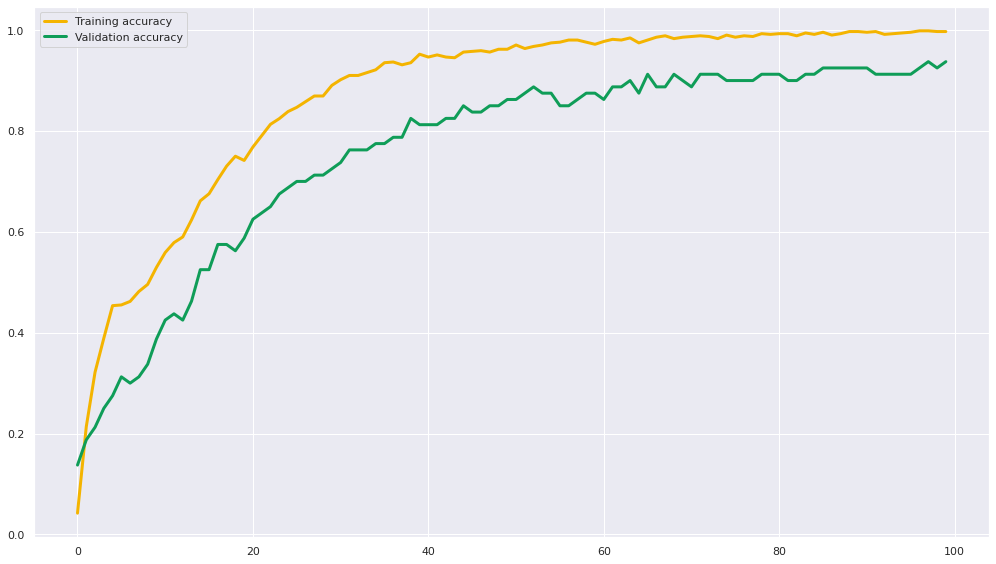

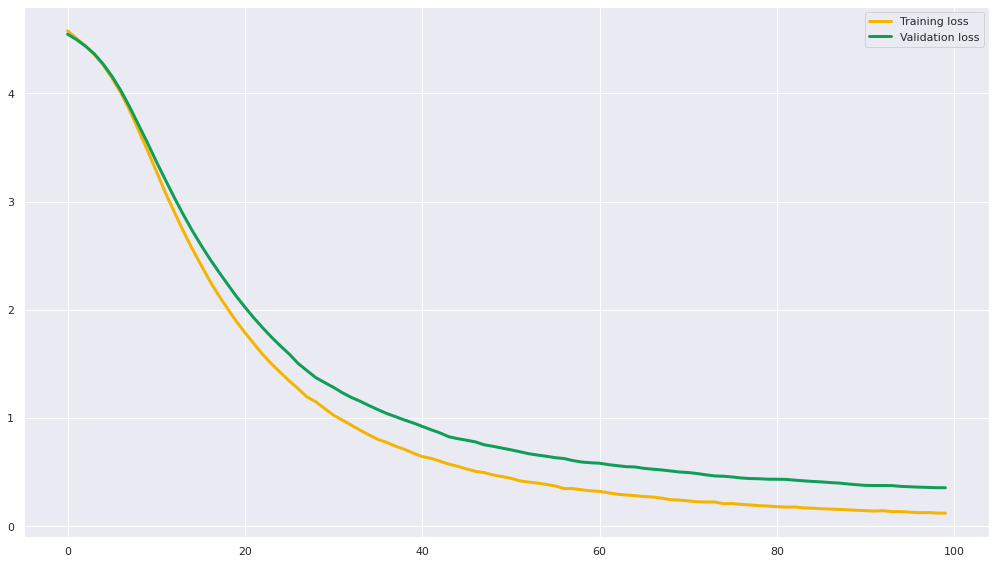

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.3 
Epoch 1/100
12/12 [==============================] - 1s 34ms/step - loss: 4.5778 - accuracy: 0.0548 - val_loss: 4.5390 - val_accuracy: 0.1625
Epoch 2/100
12/12 [==============================] - 0s 14ms/step - loss: 4.5069 - accuracy: 0.1910 - val_loss: 4.4880 - val_accuracy: 0.2000
Epoch 3/100
12/12 [==============================] - 0s 12ms/step - loss: 4.4331 - accuracy: 0.3413 - val_loss: 4.4270 - val_accuracy: 0.3250
Epoch 4/100
12/12 [==============================] - 0s 13ms/step - loss: 4.3550 - accuracy: 0.4115 - val_loss: 4.3506 - val_accuracy: 0.2750
Epoch 5/100
12/12 [==============================] - 0s 14ms/step - loss: 4.2530 - accuracy: 0.4213 - val_loss: 4.2532 - val_accuracy: 0.2875
Epoch 6/100
12/12 [==============================] - 0s 14ms/step - loss: 4.1345 - accuracy: 0.4733 - val_loss: 4.1388 - val_accuracy: 0.3375
Epoch 7/100
12/12 [==============================] - 0s 14ms/step - loss: 

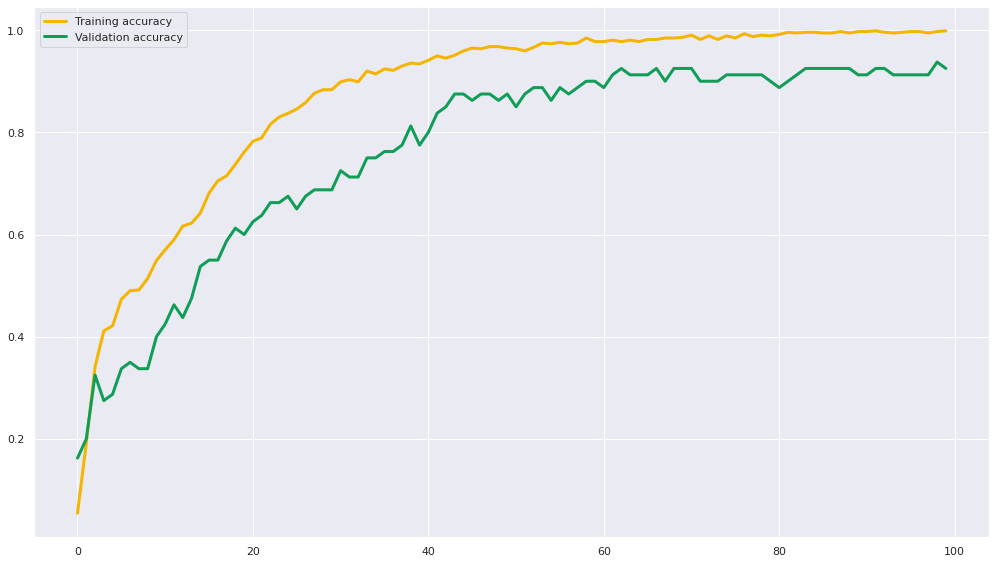

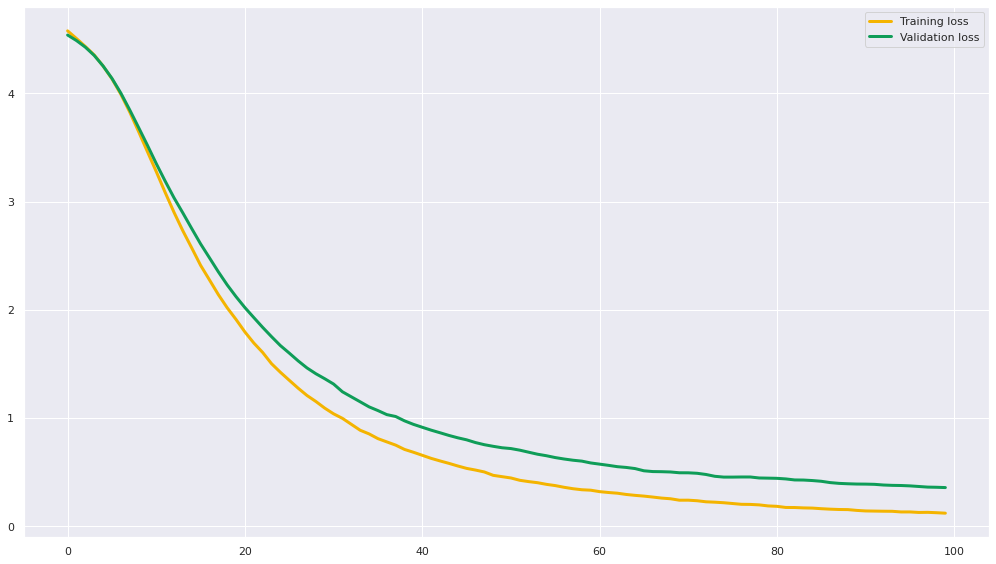

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 28ms/step - loss: 4.5829 - accuracy: 0.0323 - val_loss: 4.5534 - val_accuracy: 0.0875
Epoch 2/100
12/12 [==============================] - 0s 10ms/step - loss: 4.5240 - accuracy: 0.1812 - val_loss: 4.5112 - val_accuracy: 0.2250
Epoch 3/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4626 - accuracy: 0.3160 - val_loss: 4.4621 - val_accuracy: 0.2750
Epoch 4/100
12/12 [==============================] - 0s 8ms/step - loss: 4.3990 - accuracy: 0.3778 - val_loss: 4.4016 - val_accuracy: 0.2625
Epoch 5/100
12/12 [==============================] - 0s 12ms/step - loss: 4.3207 - accuracy: 0.3890 - val_loss: 4.3282 - val_accuracy: 0.3000
Epoch 6/100
12/12 [==============================] - 0s 8ms/step - loss: 4.2261 - accuracy: 0.4663 - val_loss: 4.2399 - val_accuracy: 0.3125
Epoch 7/100
12/12 [==============================] - 0s 11ms/step - loss: 4.1

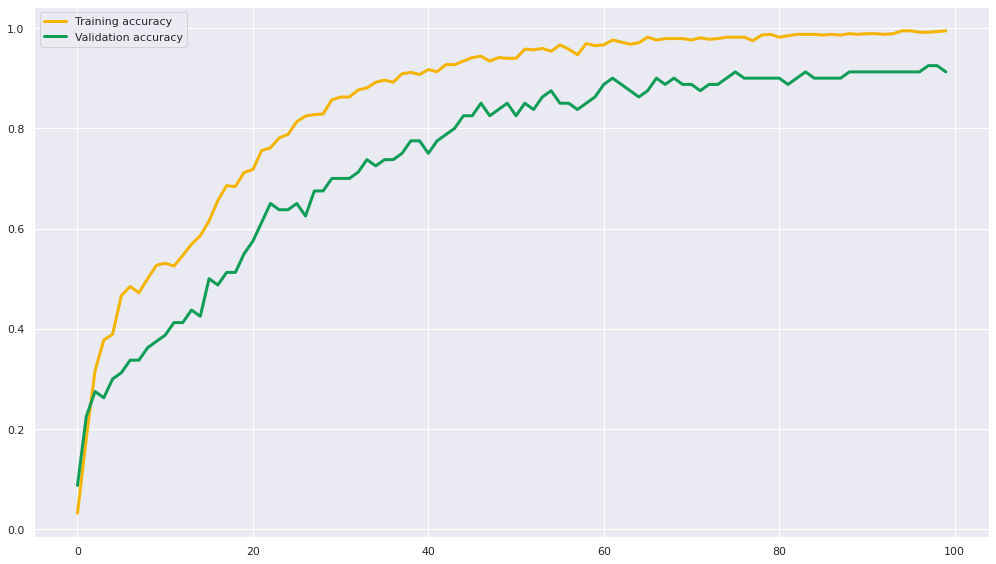

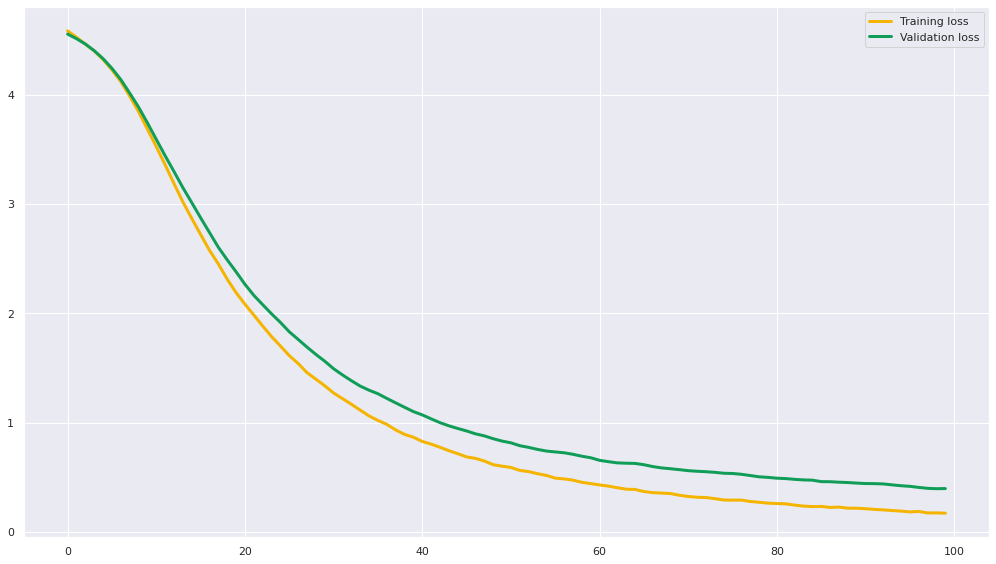

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 25ms/step - loss: 4.5826 - accuracy: 0.0379 - val_loss: 4.5526 - val_accuracy: 0.1000
Epoch 2/100
12/12 [==============================] - 0s 11ms/step - loss: 4.5235 - accuracy: 0.1643 - val_loss: 4.5067 - val_accuracy: 0.2125
Epoch 3/100
12/12 [==============================] - 0s 9ms/step - loss: 4.4650 - accuracy: 0.2823 - val_loss: 4.4569 - val_accuracy: 0.2375
Epoch 4/100
12/12 [==============================] - 0s 11ms/step - loss: 4.3973 - accuracy: 0.3567 - val_loss: 4.4003 - val_accuracy: 0.2500
Epoch 5/100
12/12 [==============================] - 0s 11ms/step - loss: 4.3188 - accuracy: 0.4017 - val_loss: 4.3319 - val_accuracy: 0.2625
Epoch 6/100
12/12 [==============================] - 0s 9ms/step - loss: 4.2272 - accuracy: 0.3848 - val_loss: 4.2437 - val_accuracy: 0.2500
Epoch 7/100
12/12 [==============================] - 0s 11ms/step - loss: 4.

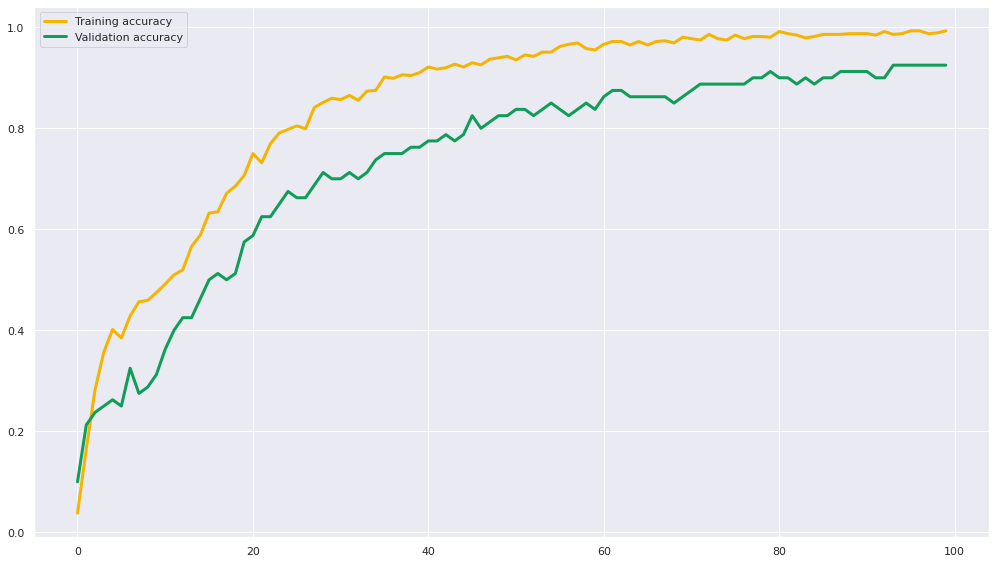

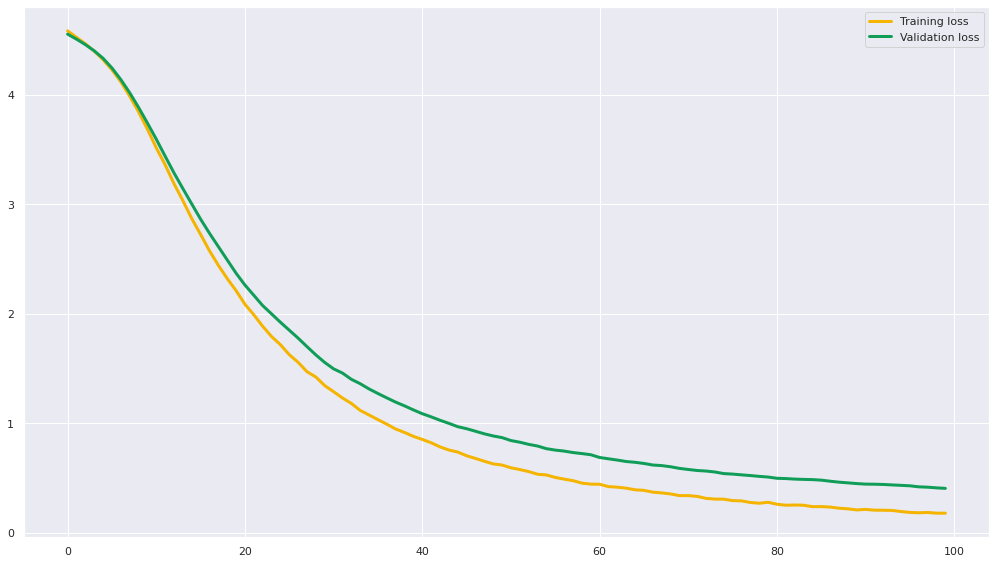

The batch_size is: 64, The hidden_size is: 512, The dropout_rate is: 0.5 
Epoch 1/100
12/12 [==============================] - 1s 41ms/step - loss: 4.5834 - accuracy: 0.0393 - val_loss: 4.5553 - val_accuracy: 0.1000
Epoch 2/100
12/12 [==============================] - 0s 14ms/step - loss: 4.5238 - accuracy: 0.1784 - val_loss: 4.5086 - val_accuracy: 0.1875
Epoch 3/100
12/12 [==============================] - 0s 11ms/step - loss: 4.4636 - accuracy: 0.2753 - val_loss: 4.4577 - val_accuracy: 0.2375
Epoch 4/100
12/12 [==============================] - 0s 14ms/step - loss: 4.3972 - accuracy: 0.3244 - val_loss: 4.4005 - val_accuracy: 0.2375
Epoch 5/100
12/12 [==============================] - 0s 11ms/step - loss: 4.3193 - accuracy: 0.3596 - val_loss: 4.3258 - val_accuracy: 0.2375
Epoch 6/100
12/12 [==============================] - 0s 12ms/step - loss: 4.2249 - accuracy: 0.4045 - val_loss: 4.2403 - val_accuracy: 0.2875
Epoch 7/100
12/12 [==============================] - 0s 13ms/step - loss: 

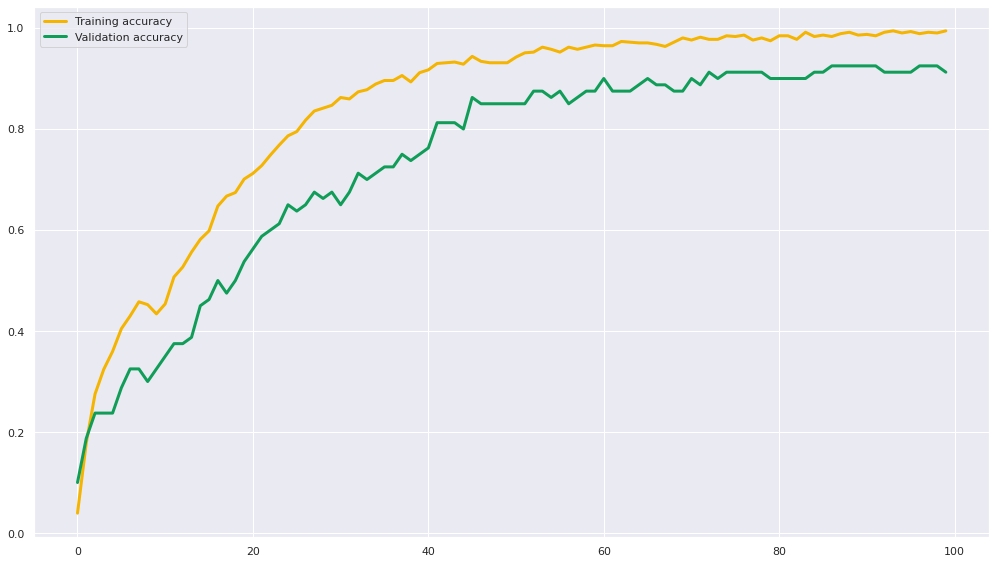

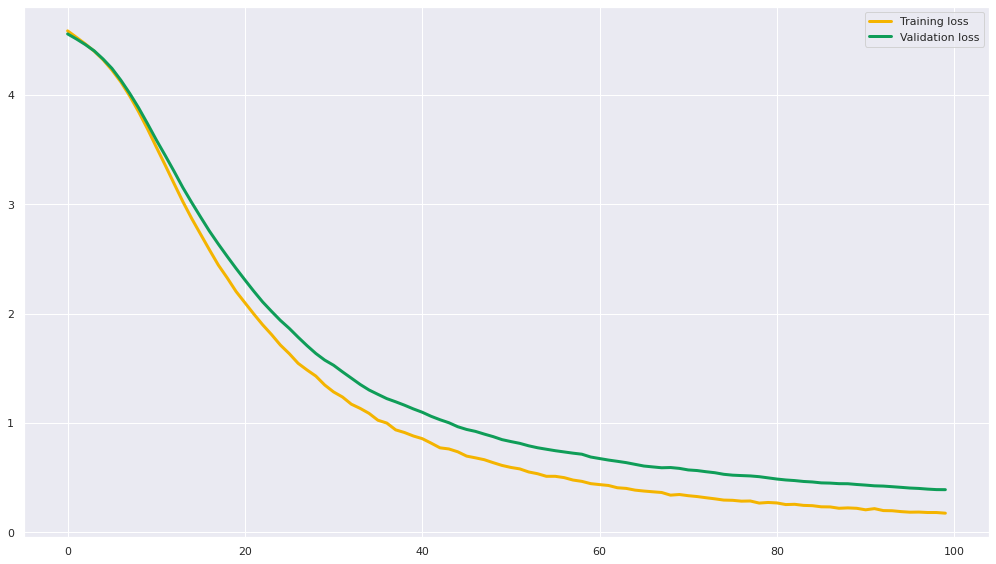

In [80]:
 # Build and train the model with different hyperparameters
for batch_size in [16, 32, 64]:
    for hidden_size in [32, 64, 128, 256, 512]:
        for dropout_rate in [0.1, 0.3, 0.5]:
            for optimizer_name in [SGD, Adam, RMSprop]:
                print(blue(f'The batch_size is: {batch_size}, The hidden_size is: {hidden_size}, The dropout_rate is: {dropout_rate} '))
                model_1, history_1 = MLP_Model( Batch_size = batch_size,  Hidden_size = hidden_size, Dropout_rate = dropout_rate)
                model_1.summary()
                model_1.evaluate(X_test, y_test)
                #virtualization for the training accuracy and validation accuracy throw the epochs number
                Virtualization_Acc(model_1,history_1)
                #virtualization for the training loss and validation loss throw the epochs number
                Virtualization_Loss(model_1,history_1)
                print(blue('============================================================================================================',['bold']))
                    